# Country Reviews_short

##### By Sebastian Rötten

# Index
<a href= '#Regions'>Regions</a> <br>
<a href= '#Data'>0. Data</a> <br>
&nbsp;&nbsp; <a href= '#Sales Dataframe'>0.1 Sales Dataframe</a> <br>
&nbsp;&nbsp; <a href= '#Forecast Dataframe'>0.2 Forecast Dataframe</a> <br>
&nbsp;&nbsp; <a href= '#Activation Dataframe'>0.3 Activation Dataframe</a> <br>
&nbsp;&nbsp;  <a href= '#TAMSAMSOM Dataframe'>0.4 TAMSAMSOM Dataframe</a> <br>
<a href= '#EMEA'>1. EMEA</a> <br>
&nbsp;&nbsp; <a href= '#EMEA Forecasts'>1.1 EMEA Indirect Forecast Overview</a> <br>
&nbsp;&nbsp; <a href= '#EMEA SPA'>1.2 EMEA SPA Overviews</a> <br>
&nbsp;&nbsp; <a href= '#EMEA CQ'>1.3 EMEA Current Quarter Shares</a> <br>
&nbsp;&nbsp; <a href= '#EMEA SellThrough'>1.4 EMEA SellThrough on cycles</a> <br>
&nbsp;&nbsp; <a href= '#EMEA HEMS'>1.5 EMEA HEMS</a> <br>
<a href= '#France'>2. France</a> <br>
<a href= '#Germany'>3.   Germany</a> <br>
<a href= '#Austria'>4. Austria</a> <br>
<a href= '#Switzerland'>5. Switzerland</a> <br>
<a href= '#Netherlands'>6. Netherlands</a> <br>
<a href= '#Belgium'>7. Belgium</a> <br>
<a href= '#Luxembourg'>8. Luxembourg</a> <br>
<a href= '#United Kingdom'>9. United Kingdom</a> <br>
<a href= '#Ireland'>10. Ireland</a> <br>
<a href= '#Italy'>11. Italy</a> <br>
<a href= '#Croatia'>12. Croatia</a> <br>
<a href= '#Spain'>13. Spain</a> <br>
<a href= '#Portugal'>14. Portugal</a> <br>
<a href= '#Sweden'>15. Sweden</a> <br>
<a href= '#Denmark'>16. Denmark</a> <br>
<a href= '#Poland'>17. Poland</a> <br>
<a href= '#Romania'>18. Romania</a> <br>
<a href= '#Czech Republic'>19. Czech Republic</a> <br>
<a href= '#South Africa'>20. South Africa</a> <br>
<a href= '#Greece'>21. Greece</a> <br>
<a href= '#Rest of EMEA'>22. Rest of EMEA</a> <br>
<a href= '#EMEA R2R'>A. EMEA R2R</a> <br>
<a href= '#EMEA Key Accounts'>B. Key Accounts</a> <br>
<a href= '#Global'>C. Account Cleanup</a> <br>
<a href= '#InstallerCountry'>D. Loss when changing to InstallerCountry:</a> <br>
<a href= '#CombiTables'>E. All Installers with POS, KWhr, Activation, TAM, SOW</a> <br>

In [1]:
import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import MO, TU, WE, TH, FR, SA, SU
import matplotlib.font_manager as font_manager
from matplotlib import rcParams
from matplotlib.patches import Rectangle

import functions_eda as eda
import functions_fcst as fcst
import functions_distri as dis
import seaborn as sns
from datetime import datetime, timedelta

#Transfer figure to PPT
from pptx import Presentation
from pptx.util import Inches, Pt
from pptx.dml.color import RGBColor
import os

from colour import Color
from IPython.display import display, HTML

display(HTML("<style>.container { width:90% !important; }</style>"))

In [2]:
# Define decimal places shown in the notebook
pd.options.display.float_format = '{:,.0f}'.format

# Display the whole content of the data frame
pd.set_option('display.max_columns', None)      # Displays all columns
#pd.set_option('display.max_rows', None)       # Displays all rows

# Ignore warnings while plotting
import warnings
warnings.filterwarnings("ignore")

In [3]:
####  Global colour and graph settings:

#Set Enphase Colour Palette
# Create an array with the colors you want to use
colors  = ['#EA6100','#439E58','#FFD02C','#3B999E','#F45270','#2C436F','#DE2100']

# 2 colors:
colors2 = ['#DE2100','#439E58']
blues = ['#3B999E','#2c436f']
orangeteal = ['#3B999E','#EA6100']
reds = ['#DE2100','#EA6100']
orange = '#EA6100'

# 
sunrise3 = ['#FCB571','#F49787','#2C436F']
sunrise7 = ['#fcb571', '#d9a271', '#b78f70', '#947c70', '#716970', '#4f566f', '#2c436f']
brand6 = ['#fcb571','#faaf7e','#f9a98b','#f7a399','#f69da6','#f497b3']

# Set your custom color palette
sunrise = sns.set_palette(sns.color_palette(sunrise7))
enphase = sns.set_palette(sns.color_palette(orangeteal))

# Transparent Visualisations:
plt.rcParams.update({
    "figure.facecolor":  (0.0, 0.0, 0.0, 0.0),  # red   with alpha = 100%
})

In [4]:
plt.rcParams.update({
    "figure.facecolor":  (0.0, 0.0, 0.0, 0.0),  # red   with alpha = 100%
})

In [5]:
Today = pd.Timestamp.today()
CurrWW = pd.Timestamp.today().strftime('%y-%W')
LastWW = (pd.Timestamp.today()- timedelta(days=7)).strftime('%y-%W')
Current = '24 Q4'

<a id='Data'></a>
# 0. Data

- As long as we do not have a data warehouse with SQL interface, the datasets are queried across various systems or self-constructed
- We merge different resources on country - level as long as we do not have a key feature (InstallerCustomerKey)
- Forecasts are only available with the new "Indirect Forecasting" template (DE only so far)
    - Live tracking of forecast only for DE so far
    - Forecast template uses cleaned installer names
- TAMSAMSOM: Too many missing values for reliable analysis
    - SAMs do not now on which parent account they should fill in the data (cleanup)

#### Mapping tables

In [6]:
# Enphase Regions:
dfr = pd.read_excel("/Users/sroetten/Python/Data/EnphaseRegions.xlsx")
dfr.columns = dfr.columns.str.replace(' ', '')

In [7]:
# Enphase quarter
dfq = pd.read_excel("/Users/sroetten/Python/Data/EnphaseQuarters_MAIN.xlsx")

In [8]:
# Enerix
enerix = pd.read_excel("/Users/sroetten/Python/Data/Enerix_Mapping.xlsx")

#enerix = enerix[['InstallerName','InstallerName']]
#enerix = enerix.dropna(subset=['ReportedInstallerName'])

In [9]:
# 1k5
K5 = pd.read_excel("/Users/sroetten/Python/Data/1K5_mappings.xlsx")
K5 = K5[['ReportedInstallerName','InstallerName']]
K5 = K5.dropna()

In [10]:
# ProductGroup - own cluster
PRODUCTS = pd.read_excel("/Users/sroetten/Python/Data/ProductFamily.xlsx")
PRODUCTS.columns = PRODUCTS.columns.str.replace(' ', '')
PRODUCTS.rename(columns={'ProductName': 'SKUName'}, inplace=True)
PRODUCTS=PRODUCTS[["SKUName","ProductGroup"]]

In [11]:
#Mapping table AccountManager
AcMFull = pd.read_csv("/Users/sroetten/Python/Data/Activation_full.csv", encoding='iso-8859-1', decimal='.')
AcMFull.columns = AcMFull.columns.str.replace(' ', '')
AcMFull.groupby(["InstallerId", "SFDC:CustomerKey", "SFDC:AccountName", "SFDC:EnphaseWalletShare"], as_index=False)["SiteType"].sum().to_excel("/Users/sroetten/Python/Data/Activation_map.xlsx",encoding='utf-8-sig',index=False)

In [12]:
AcMNames = AcMFull[['InstallerName', 'Installer_X', "SFDC:CustomerKey", 'SFDC:AccountName']]

In [13]:
# Activation Database SFDC:InstallerKey
AcM = pd.read_excel("/Users/sroetten/Python/Data/Activation_map.xlsx")
AcM = AcM[['InstallerId','SFDC:AccountName','SFDC:CustomerKey','SiteType',"SFDC:EnphaseWalletShare"]]
AcM.rename(columns={'InstallerId' : 'InstallerID',
                    'SFDC:CustomerKey' : 'InstallerCustomerKey',
                    "SFDC:EnphaseWalletShare" : 'SoW',
                    "SiteType" : "SiteCount"
                   }, inplace=True)

In [14]:
# PartnerNames
NAMES = pd.read_excel("/Users/sroetten/Python/Data/PartnerNames.xlsx")
NAMES.columns = NAMES.columns.str.replace(' ', '')

In [15]:
#FR Cluster Enlighten Names:

FR_ENLIGHTEN = pd.read_excel("/Users/sroetten/Python/Data/FR_EnlightenCluster.xlsx")
FR_ENLIGHTEN.columns = FR_ENLIGHTEN.columns.str.replace(' ', '')

In [16]:
#ES Cluster Enlighten Names:

IBERIA = pd.read_excel("/Users/sroetten/Python/Data/IBERIACluster.xlsx")
IBERIA.columns = IBERIA.columns.str.replace(' ', '')

In [17]:
ISO_C = pd.read_excel("/Users/sroetten/Python/Data/RepCountryISO.xlsx")

In [18]:
ZIP = pd.read_excel("/Users/sroetten/Python/Data/EURO_Sales_areas.xlsx")
ZIP.columns = ZIP.columns.str.replace(' ', '')


ZIP.rename(columns={'SAM' : 'InstallerAccountOwner'
                   }, inplace=True)

<a id='Sales Dataframe'></a>
# 0.1 Sales Dataframe

The dataframe is exported on demand via salesforce and contains all Sell-Through data for EMEA on Installer Level

### Incorta Data:

In [19]:
INCORTA = pd.read_csv("/Users/sroetten/Python/Data/Global.csv", encoding='utf-8', decimal='.')
#INCORTA = pd.read_csv("/Users/sroetten/Python/Data/Global_all_owner_features.csv", encoding='utf-8', decimal='.')
INCORTA.columns = INCORTA.columns.str.replace(' ', '')
RAWINC = INCORTA 
INCORTA = INCORTA.query("CHMGeography == 'EMEA' & CHMProductType in ['Microinverter', 'Storage', 'HEMS']")

In [20]:
print('The global data set for all continents except AMER has {0} transactions in the past 2y.'.format(RAWINC.shape[0]))
print('Our EMEA data set (Micro, Storage, HEMS) has {0} transactions.'.format(INCORTA.shape[0]))

The global data set for all continents except AMER has 303956 transactions in the past 2y.
Our EMEA data set (Micro, Storage, HEMS) has 264560 transactions.


CHM Line Status:

In [21]:
INCORTA.CHMLineStatus = INCORTA.CHMLineStatus.fillna('na')
pd.crosstab(INCORTA.CHMLineStatus, INCORTA.CHMInvoiceQuarterYear, values=INCORTA.CHMReportedQuantity, aggfunc='count', margins=True, margins_name="Total").fillna('0')

CHMInvoiceQuarterYear,2023-Q1,2023-Q2,2023-Q3,2023-Q4,2024-Q1,2024-Q2,2024-Q3,2024-Q4,2025-Q1,2025-Q2,2025-Q3,2025-Q4,Total
CHMLineStatus,,,,,,,,,,,,,
DELETED,0,0,0,0,185,16,28,21,11,20,15,2,298
FAILED,0,0,0,0,"4,852","19,714","12,710","3,624",0,0,0,0,40900
PROCESSED,0,0,0,0,"5,804","21,110","10,251","3,434",0,0,0,0,40599
na,"31,433","39,324","40,043","42,087","29,876",0,0,0,0,0,0,0,182763
Total,"31,433","39,324","40,043","42,087","40,717","40,840","22,989","7,079",11,20,15,2,264560


In [22]:
# Customized CHM:

INCORTA.rename(columns={
 'CHMPartnerNameOracle': 'PartnerName',
 'CHMDistributorCustomerKey':'PartnerCustomerKey',
 'CHMGeography':'PartnerRegion',  
 'CHMPartnerCountry':'PartnerCountry',   
 'CHMReportedInstallerCustomerName': 'ReportedInstallerName',
 'CHMInstallerName':'InstallerName',    
 'CHMReportedInstallerCountry': 'ReportedInstallerCountry',
 'CHMEnphaseInstallerCountry':'InstallerCountry',    
 'CHMInstallerCustomerKey':'InstallerCustomerKey',
 'CHMInstallerAccountOwner': 'InstallerAccountOwner_old',
 'OwnerName': 'InstallerAccountOwner',
 'SFDC:Owner': 'InstallerAccountOwner_SFDC',   
 'CHM_Owner_Combi': 'CHM_Owner_Combi',   
 'CHMInstallerPrimaryAccountManager':'AccountManager',
 'CHMReportedInstallerStreetAddress': 'ReportedInstallerStreet1',
 'CHMReportedInstallerCity': 'ReportedInstallerCity',
 'CHMReportedInstallerState': 'ReportedInstallerState',    
# 'CHMReportedZipCode',
 'CHMReportedInstallerZipCode':'ReportedInstallerPostalCode',
 'CHMLineId': 'TransactionNumber',
# 'CHMBatchId',
# 'CHMSourceDb',
# 'CHMLineStatus',
# 'CHMInternalLineStatus',
 'CHMReportedInvoiceDate': 'InvoiceDate',
 'CHMInvoiceWeekDate': 'InvoiceWeekDate',
#                     'CHMInvoiceQuarterYear',
# 'CHMInvoiceQuarterYear',
 'CHMReportedInvoiceNumber': 'PartnerInvoiceNumber',
# 'CHMReportedInvoiceLineNumber',
 'CHMProductType': 'ProductType',
 'CHMProductFamily': 'ProductFamily',
 'CHMReportedPartNumber': 'ReportedProductName',
 'CHMPartNumber':'ProductName',
 'CHMProductDescription': 'ProductDescription',
 'CHMReportedQuantity':'QuantitySold',
#  'ListPrice',
#  'CHMReportedUom',
#  'CHMUom',
  'CHMReportedSpaNumber':'SpaNumber',
#  'CHMSpaNumber',
#  'CHMCreatedBy',
#  'CHMCreationDate',
#  'CHMLastUpdatedBy',
#  'CHMLastUpdatedDate',
#  'CHMFileRecordId',
 'CHMR2rFlag': 'ReporterToReporter'
                      }, inplace=True)   

In [23]:
#INCORTA.loc[INCORTA.InstallerAccountOwner_SFDC=='ClÈment Trasfi', 'InstallerAccountOwner_SFDC'] = 'Clément Trasfi'

In [24]:
INCORTA = INCORTA[['TransactionNumber','InvoiceWeekDate','InvoiceDate','PartnerRegion','PartnerCountry','PartnerName',
   'PartnerCustomerKey','QuantitySold','ProductType','ProductFamily','ProductName','ReportedProductName',
   'ProductDescription','ReportedInstallerName','InstallerName','InstallerCustomerKey','InstallerAccountOwner', #'InstallerAccountOwner_CHM', 'InstallerAccountOwner_SFDC', 'CHM_Owner_Combi',   
   'ReportedInstallerState', 'InstallerCountry','ReportedInstallerCountry', 'ReportedInstallerPostalCode',
   'ReportedInstallerStreet1','ReportedInstallerCity','PartnerInvoiceNumber','ReporterToReporter','SpaNumber','AccountManager']]

In [25]:
eda.missing_values_table(INCORTA)

The selected dataframe has 27 columns.
There are 18 columns that have missing values.


,Missing Values,% of Total Values
AccountManager,239812,91
SpaNumber,192219,73
ReportedInstallerStreet1,155659,59
InstallerAccountOwner,124651,47
PartnerInvoiceNumber,77262,29
ReportedInstallerCity,44469,17
PartnerCustomerKey,40193,15
ProductDescription,39509,15
InstallerName,34180,13
ReportedInstallerState,33956,13


In [26]:
#df = INCORTA.query("InstallerCountry == @Country & 'InvoiceDate' >= '3/15/24'").sort_values("InvoiceDate", ascending=False)
# France SystoSolar Transactions are corrected
INCORTA['QuantitySold'] = INCORTA['QuantitySold'].apply(lambda x: x/1000000 if x >99999 else x) # temporary transformation until France KDI Solar Transactions are corrected
INCORTA['ReporterToReporter'] = INCORTA['ReporterToReporter'].apply(lambda x: 1 if x == 'Y' else 0) # temporary transformation until France KDI Solar Transactions are corrected

INCORTA['QuantitySold'] = INCORTA.QuantitySold.astype('int')
INCORTA['InvoiceDate']= pd.to_datetime(INCORTA['InvoiceDate'])
INCORTA['InvoiceWeekDate']= pd.to_datetime(INCORTA['InvoiceWeekDate'])

# # # Calendarly features:
# INCORTA['Month'] = pd.to_datetime(INCORTA.InvoiceDate).dt.strftime('%m')
# INCORTA['WorkWeek'] = pd.to_datetime(INCORTA.InvoiceDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
# INCORTA['Year'] = pd.to_datetime(INCORTA.InvoiceDate, dayfirst=False).dt.to_period('y').dt.strftime('%y')
# INCORTA['Year_Month'] = INCORTA['Year'] + '-' + INCORTA['Month']

# INCORTA.shape

In [27]:
#df = df.query("InvoiceWeekDate > '2024-03-13' & InvoiceWeekDate <= @Today")
df = INCORTA.query("InvoiceDate <= @Today")
#INCORTA.to_excel("EMEA/EMEA_Incorta.xlsx",encoding='utf-8-sig',index=False)

#### SFDC Data:

In [28]:
print('Our INCORTA data set has {0} observations.'.format(INCORTA.shape[0]))
print('INCORTAs latest invoice date is {0}.'.format(INCORTA.InvoiceDate.iloc[-1]))
print('INCORTAs earliest invoice date is {0}.'.format(INCORTA.InvoiceDate.iloc[0]))

Our INCORTA data set has 264560 observations.
INCORTAs latest invoice date is 2024-10-28 00:00:00.
INCORTAs earliest invoice date is 2023-01-03 00:00:00.


#### Load historic POS

In [29]:
df21 = pd.read_csv("EMEA21.csv", encoding='iso-8859-1', decimal='.')
df21.columns = df21.columns.str.replace(' ', '')

df21['SpaNumber'] = 0
df21['AccountManager'] = 0

df = df.append(df21)

In [30]:
df22 = pd.read_csv("EMEA22.csv", encoding='iso-8859-1', decimal='.')
df22.columns = df22.columns.str.replace(' ', '')

df22['SpaNumber'] = 0
df22['AccountManager'] = 0

df = df.append(df22)

In [31]:
print('Our original data set has {0} observations.'.format(df.shape[0]))
print('The earliest order date is {0}.'.format(df.InvoiceDate.iloc[-1]))
print('The latest order date is {0}.'.format(df.InvoiceDate.iloc[0]))
print('The current workweek is {0}.'.format(CurrWW))

Our original data set has 374106 observations.
The earliest order date is 1/1/2022.
The latest order date is 2023-01-03 00:00:00.
The current workweek is 24-45.


#### Load DACH missing transactions from Sonepar / Direct Installers

In [32]:
Missing = pd.read_excel("/Users/sroetten/Python/Data/EOQ_MissingTransactions.xlsx")
Missing.columns = Missing.columns.str.replace(' ', '')

Missing['InvoiceDate'] = pd.to_datetime(Missing.InvoiceDate, dayfirst=True)

df = df.append(Missing)

pd.crosstab(Missing.InstallerName, Missing.InvoiceWeekDate.dt.strftime('%y-%m'), values=Missing.QuantitySold, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(20)

InvoiceWeekDate,23-04,23-05,23-06,23-07,23-09,23-12,24-01,24-02,24-03,24-04,24-05,24-06,24-07,Total
InstallerName,,,,,,,,,,,,,,
Total,"1,551","2,875",227,"2,423","1,153","3,274","12,111","1,127","1,325","2,594","1,189",164,208,30221
Sonepar,"1,551","2,875",227,"2,423","1,153","3,274",111,"1,127","1,325","2,594","1,189",164,208,18221
Lichtblick (Direct),0,0,0,0,0,0,"12,000",0,0,0,0,0,0,12000


#### Feature Engineering 

We create features for calendar Weeks, Years, Months, Quarters, QuantitySold_K units and KWhr for relevant storage prodcuts.

Eligible Products are:

3.5 KWhr: 'B03-T01-INT00-1-2' , 'B03-T01-INT00-1', '890-00023', 'ENCHARGE-3T-1P-INT' <br/>
5 KWhr: 'IQ BATTERY-5P-1P-INT' <br/>
10.5KWhr: 'ENCHARGE-10T-1P-INT'

In [33]:
df['Month'] = pd.to_datetime(df.InvoiceDate).dt.strftime('%m')

# #Calendarly features:
df['Month'] = pd.to_datetime(df.InvoiceDate).dt.strftime('%m')
df['WorkWeek'] = pd.to_datetime(df.InvoiceDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
df['Year'] = pd.to_datetime(df.InvoiceDate, dayfirst=False).dt.to_period('y').dt.strftime('%y')
df['Year_Month'] = df['Year'] + '-' + df['Month']

#Enphase Quarters
df['InvoiceDate']= pd.to_datetime(df['InvoiceDate'])
df = df.merge(dfq[['Day','InvoiceDate','Week','Quarter']], on='InvoiceDate', how='left')

#Enphase formats
df['InstallerName'] = df['InstallerName'].astype('str')
df['ReportedInstallerName'] = df['ReportedInstallerName'].astype('str')


#FillNaN:
df['SpaNumber'] = df.SpaNumber.fillna(0)
df['AccountManager'] = df.AccountManager.fillna(0)


# Quantities in k Units:
df['QuantitySold_k'] = df['QuantitySold']/1000

# Storage Calulations
df['KWhr'] = df['ProductName'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' 
                                                   or x=='B03-T01-INT00-1' 
                                                   or x=='890-00023'
                                                   or x=='ENCHARGE-3T-1P-INT' 
                                                   else 0) + df['ProductName'].apply(lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0) + df['ProductName'].apply(lambda x:5 if x=='IQBATTERY-5P-1P-INT' or x== 'B05-T02-INT00-1-2' else 0)
df['KWhr'] = df['KWhr'] * df['QuantitySold']
df['MWhr'] = df['KWhr'] / 1000

In [34]:
#dfstor.query("InstallerCountry == 'DE' ").tail(50)

## Temporary replacements / conversion:

In [35]:
df = df.merge(enerix, on='ReportedInstallerName', how = 'left')

In [36]:
df['PartnerCountry'] = df.PartnerCountry.fillna('NaN')

all partners with missing country (not filled in yet:)

In [37]:
df.query("PartnerCountry == 'NaN'").groupby(['PartnerName'], as_index=False)["InstallerName"].count()

,PartnerName,InstallerName
0,KRANNICH SOLAR GMBH & CO.KG,450
1,LIBRA ENERGY BV,1160
2,NATEC SUNERGY BV,3127


In [38]:
# # 03/13/24:
df.loc[df.PartnerName=='MAXEON SOLAR TECHNOLOGIES, PTE. LTD', 'PartnerCountry'] = 'DE'

# # 11/03/23:
df.loc[df.PartnerName=='KRANNICH SOLAR GMBH & CO.KG', 'PartnerCountry'] = 'DE'
df.loc[df.PartnerName=='NATEC SUNERGY BV', 'PartnerCountry'] = 'NL'
df.loc[df.PartnerName=='LIBRA ENERGY BV', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='ESTG', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='CARBOMAT GROUP', 'PartnerCountry'] = 'BE'
# df.loc[df.PartnerName=='CORAB SPOLKA AKCYJNA', 'PartnerCountry'] = 'PL'
# df.loc[df.PartnerName=='GREENSUN SRL', 'PartnerCountry'] = 'IT'
# df.loc[df.PartnerName=='GROUPE SOLUTION ENERGIE INTEGRATION', 'PartnerCountry'] = 'FR'
# df.loc[df.PartnerName=='IBC SOLAR AG', 'PartnerCountry'] = 'DE'
# df.loc[df.PartnerName=='IBC SOLAR BV', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='NOUVELLES ENERGIES DISTRIBUTION', 'PartnerCountry'] = 'FR'
# df.loc[df.PartnerName=='NW TECHNOLOGY GMBH', 'PartnerCountry'] = 'DE'
# df.loc[df.PartnerName=='PROPLAST Sp. z o.o.', 'PartnerCountry'] = 'PL'
# df.loc[df.PartnerName=='REXEL NEDERLAND BV', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='SEN SOLARE ENERGIESYSTEME NORD VERTRIEBSGESELLSCHAFT MBH', 'PartnerCountry'] = 'DE'
# df.loc[df.PartnerName=='SFE SOLAR LOGISITC SL', 'PartnerCountry'] = 'ES'
# df.loc[df.PartnerName=='TECHNISCHE UNIE B.V.', 'PartnerCountry'] = 'NL'

# # 11/10/23:
# df.loc[df.PartnerName=='SOLEXIS SA', 'PartnerCountry'] = 'CH'
# df.loc[df.PartnerName=='TECHNOSOLAR SA', 'PartnerCountry'] = 'CH'
# df.loc[df.PartnerName=='GRID PARITY CONCEPTS', 'PartnerCountry'] = 'BE'

# # 12/18/23
# df.loc[df.PartnerName=='4BLUE', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='ALASKA ENERGIES', 'PartnerCountry'] = 'FR'
# df.loc[df.PartnerName=='AMARA SOLAR ITALIA SRL', 'PartnerCountry'] = 'IT'
# df.loc[df.PartnerName=='AMARA SOLAR RENOVABLES, S.L', 'PartnerCountry'] = 'ES'
# df.loc[df.PartnerName=='APPROSUD ENVIRONNEMENT', 'PartnerCountry'] = 'FR'
# df.loc[df.PartnerName=='BAYWA R.E. SOLAR ENERGY SYSTEMS GMBH', 'PartnerCountry'] = 'DE'
# df.loc[df.PartnerName=='BAYWA R.E. SOLAR SYSTEMS S.A R.L.', 'PartnerCountry'] = 'LU'
# df.loc[df.PartnerName=='BAYWA R.E. SOLAR SYSTEMS S.A.S', 'PartnerCountry'] = 'FR'
# df.loc[df.PartnerName=='BAYWA R.E. SOLAR SYSTEMS SLU', 'PartnerCountry'] = 'ES'
# df.loc[df.PartnerName=='BET SOLAR SL', 'PartnerCountry'] = 'ES'
# df.loc[df.PartnerName=='CEBEO, NV', 'PartnerCountry'] = 'BE'
# df.loc[df.PartnerName=='ELEKTRA, S.A.', 'PartnerCountry'] = 'ES'
# df.loc[df.PartnerName=='ENERGY3000 SOLAR GMBH', 'PartnerCountry'] = 'AT'
# df.loc[df.PartnerName=='HYDRO-SOLAR S.A.M', 'PartnerCountry'] = 'MC'
# df.loc[df.PartnerName=='MIDSUMMER ENERGY LTD', 'PartnerCountry'] = 'GB'
# df.loc[df.PartnerName=='NAVETTO BV', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='PVO INTERNATIONAL B.V.', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='SEN SOLARE ENERGIESYSTEME', 'PartnerCountry'] = 'DE'
# df.loc[df.PartnerName=='SOLARCLARITY BV', 'PartnerCountry'] = 'NL'
# df.loc[df.PartnerName=='SOLARMARKT', 'PartnerCountry'] = 'CH'
# df.loc[df.PartnerName=='SUNTASTIC.SOLAR HANDELS GMBH', 'PartnerCountry'] = 'AT'
# df.loc[df.PartnerName=='SYSTOSOLAR', 'PartnerCountry'] = 'FR'

All partners with missing country (not filled in yet:)

In [39]:
df.query("PartnerCountry == 'NaN'").groupby(['PartnerName'], as_index=False)["InstallerName"].count()

,PartnerName,InstallerName


## Data Cleanup:

#### Cleaned InstallerNames
Missing cleaned InstallerNames are filled with reported InstallerNames

In [40]:
df['InstallerName'] = df['InstallerName'].replace('nan', np.nan)

In [41]:
df['InstallerName_source'] = df['InstallerName']
df['InstallerName'] = df['InstallerName'].fillna(df['ReportedInstallerName'])

# for CEBEO N.V. we need to keep the source names, cause all cleaned are mapped to a single Installer
df.loc[(df['PartnerName'] == 'CEBEO, NV'), 'InstallerName'] = df.ReportedInstallerName

#### Cleaned InstallerNames
Missing cleaned InstallerCountries are filled with reported InstallerCountries

In [42]:
df['InstallerCountry_source'] = df['InstallerCountry']
df['InstallerCountry'] = df['InstallerCountry'].fillna(df['ReportedInstallerCountry'])

In [43]:
df['InstallerName'] = df['InstallerName'].astype('str')

In [44]:
#### Fill missing owners with 'No Owner CHM'

df['InstallerAccountOwner'] = df['InstallerAccountOwner'].fillna('No Owner CHM')

In [45]:
df.InstallerName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)

#### Select final dataframe:

In [46]:
dffull = df

# after changing to enphase quarters we ensure to only have the last 8 Quarters for our graphs:
# We also drop all R2R transactions:
df = dffull.query("Quarter >'22 Q2' & Quarter <= @Current & ReporterToReporter != 1")

print("We lost {} transactions by dropping R2R sales automatically and sales older than 8 Quarters".format(dffull.shape[0]-df.shape[0]))

#print('EMEA\'s QOQ IC development is a {0}% change.'.format(round(((df_IC.InstallerName.iat[-1]/df_IC.InstallerName.iat[-2])-1)*100, 2)))

We lost 69604 transactions by dropping R2R sales automatically and sales older than 8 Quarters


In [47]:
# replace old ReportedInstallerCountry Cleanup
INCORTA.ReportedInstallerCountry.replace(list(ISO_C.ReportedInstallerCountry),list(ISO_C.InstallerCountry), inplace=True)


postals = ['1033 MP', '1087 JA', '1135 TH', '1271 XL', '1328 MA', '1341 BT', '1353 LX', '1431 CN',
 '1445 SC', '1446 AA', '1446 AR', '1446 WL', '1483 GA', '1645 SX', '1681 PK', '1689 ZX', '1704 SL', '1704 SL', '1721 PS', '1812 RR',
 '1822 BG', '1911 LA', '1951 AX', '1981 EH', '2134 TN', '2134 XJ', '2165 BA', '2222 AG', '2231 NL', '2288 AA', '2288 EK', '2801 BX',
 '3165 AM', '3316 EH', '3526 KV', '3584 BH', '3705 TD', '3833 GT', '3846 CE', '4711 NB', '4823 AL', '4827 GE', '5928 RV', '6031 TW',
 '6176 DG', '6534 AJ', '6826 TN', '6827 DD', '6942 JC', '6971 GX', '7008 AS', '7131 MP', '7131 MP', '7311 HZ', '7942 JS', '7944 RN']

df.InstallerCountry.replace(postals,'NL', inplace=True)

# Sub-Distris: InstallerSell Out: 
We drop the following InstallerNames <br/>
We keep them as PartnerNames, to avoid duplicated SellThrough & get a precise IC: <br/>
FR: Voltaneo, Synexiuym, Mavison, Domos <br/>
DE: Beneke GmbH & Co. KG

In [48]:
df = df.query("InstallerName != ['VOLTANEO', 'Mavisun', 'SYNEXIUM Energy', 'Domos Industries']")#.to_excel("France/VoltaneSynMacDomosdrop.xlsx",encoding='utf-8-sig',index=False)

In [49]:
df = df.query("InstallerName != ['Beneke GmbH & Co. KG']")#.to_excel("France/VoltaneSynMacDomosdrop.xlsx",encoding='utf-8-sig',index=False)

## InstallerKeys clean & count of unique InstallerNames
Full list export: to EMEA/EMEA_CleanedKeys&CountNames.xlsx

In [50]:
dfkeys = df.groupby(["InstallerName_source","InstallerCustomerKey"], as_index=False)["ReportedInstallerName"].nunique()

dfkeys.rename(columns={'InstallerName_source': 'InstallerName',
                       'ReportedInstallerName': 'Count_ReportedNames'
                      }, inplace=True)
dfkeys.InstallerCustomerKey = dfkeys.InstallerCustomerKey.astype(int)
dfkeys.to_excel("EMEA/EMEA_CleanedKeys&CountReportedNames.xlsx",encoding='utf-8-sig',index=False)
dfkeys.sort_values('Count_ReportedNames', ascending = False).head(10)

,InstallerName,InstallerCustomerKey,Count_ReportedNames
1413,CEBEO installer POS,3207633,654
4570,Homeowner POS - France,3571473,63
8181,Solar Crew B.V.,1426211,39
1732,City Electrical Factors,125689,35
2382,EDMUNDSON ELECTRICAL LTD,3867058,32
8349,Solard BV,1831712,30
9842,Yesss Electrique Royan,2257179,29
6237,NRGIE Conseil,1713656,28
9665,Warmteservice Groep B.V.,3069604,23
2329,ECO ENERGIE,112782,22


#### InstallerKeys clean & count of unique InstallerNames
Full list export: to EMEA/EMEA_CleanedKeys&CountNames.xlsx

In [51]:
dfkeys.merge(AcM, on ='InstallerCustomerKey', how='left').to_excel("RankingsEMEA/EMEA_Cleanup/CleanedKeys&CountReportedNames&Enlighten.xlsx",encoding='utf-8-sig',index=False)

In [52]:
dfraw = df.groupby(['ReportedInstallerName','ReportedInstallerCountry'], as_index=False)["InstallerName"].count()
dfuncleaned = df.groupby(['ReportedInstallerName','InstallerName_source','InstallerCustomerKey','InstallerCountry', 'InstallerAccountOwner'], as_index=False)["PartnerName"].nunique()
dfuncleaned = dfraw.merge(dfuncleaned, on ='ReportedInstallerName', how='left')
dfuncleaned.InstallerCustomerKey = dfuncleaned.InstallerCustomerKey.fillna(0)
dfuncleaned.InstallerCustomerKey = dfuncleaned.InstallerCustomerKey.astype(int)
dfuncleaned = dfuncleaned.merge(AcM, on ='InstallerCustomerKey', how='left')
dfuncleaned.rename(columns={'InstallerName': 'TransactionCount',
                            'InstallerName_source': 'SFDC:InstallerName',
                            'SFDC:AccountName': 'Enlighten:InstallerName',
                      }, inplace=True)

dfuncleaned[['ReportedInstallerName', 'InstallerAccountOwner','ReportedInstallerCountry','TransactionCount','SFDC:InstallerName','InstallerCustomerKey','InstallerCountry','InstallerID','Enlighten:InstallerName','SoW']]
dfuncleaned.to_excel("RankingsEMEA/EMEA_Cleanup/UncleanedKeys&CountReportedNames.xlsx",encoding='utf-8-sig',index=False)

In [53]:
AcM

,InstallerID,SFDC:AccountName,InstallerCustomerKey,SiteCount,SoW
0,5,Enphase Energy,470,793,> 90%
1,13,Hawaii Energy Connection LLC,634,1,> 90%
2,206,Lighthouse Solar (Austin),39065,1,50% - 90%
3,255,Pacific Energy Company,916,1,50% - 90%
4,327,"Quality First Home Improvement, Inc.",1010,1,> 90%
...,...,...,...,...,...
4510,654266,ANISELEC - CPT1207014,4040079,1,< 25%
4511,654366,SANELI,4041453,1,< 25%
4512,654367,REA POWER,4042030,1,> 90%
4513,654527,Mkgbouw,4044678,1,25% - 50%


<a id='Forecast Dataframe'></a>
# Forecast Dataframes

### BOQ Freeze File (R6Q Country Totals)

In [54]:
BOQ = pd.read_excel("/Users/sroetten/Python/Data/BOQ_Freeze.xlsx", sheet_name='Current Overview')
BOQ.columns = BOQ.columns.str.replace(' ', '')
BOQ = BOQ.fillna('0')
PERC = BOQ

PERC['X_GrowthM'] = round(PERC['X_GrowthM']*100,2).astype(str)+'%'
PERC['X_GrowthS'] = round(PERC['X_GrowthS']*100,2).astype(str)+'%'
PERC

,Region,POSSolarKu,StorageMWh,SolarIC,StorageIC,X_InstallerSizeMicro,X_InstallerSizeStorage,X_GrowthM,X_GrowthS,PrevSolarKu,PrevStorageMWh,MicroTAM,StorageTAM
0,EMEA,365,31,4076,1042,90,30,-16.89%,-9.99%,439,35,"2,588","2,428"
1,Netherlands,97,9,1325,203,73,43,0.12%,15.87%,97,8,145,34
2,France,183,4,1450,180,126,21,-19.86%,6.0%,228,4,165,14
3,Germany,35,10,325,303,108,32,-32.57%,-30.29%,52,14,700,"1,140"
4,Spain,16,0,175,27,91,11,14.83%,19.76%,14,0,90,25
5,UK,22,7,200,60,112,112,40.52%,54.56%,16,4,120,166
6,Belgium,10,1,170,42,59,29,36.13%,15.33%,7,1,37,0
7,Italy,4,1,75,19,47,34,2.16%,-24.42%,3,1,325,459
8,Austria,2,0,45,26,33,8,-24.01%,-52.77%,2,0,126,0
9,Poland,0,0,20,3,25,0,33.69%,-100.0%,0,0,213,100


In [55]:
##################################################################################################################################
###########################################     BOQ R6Q Forecast Data     ########################################################
##################################################################################################################################
BOQ = pd.read_excel("/Users/sroetten/Python/Data/BOQ_Freeze.xlsx", sheet_name='Current Overview')
BOQ.columns = BOQ.columns.str.replace(' ', '')
BOQ.fillna('0')
BOQ.rename(columns={'Region': 'InstallerCountry'}, inplace=True)
pd.options.display.float_format = '{:,.0f}'.format

Region = list(BOQ.InstallerCountry)

BOQ.InstallerCountry.replace(Region,
                             ['EMEA','NL', 'FR', 'DE', 'ES', 'GB', 'BE', 'IT', 'AT', 'PL', 'CH', 'PT', 'HU', 'LU', 'IR', 'DK', 'SE', 'NO', 'FI', 'RO', 'GR', 'ZA','ROE'], inplace=True)

##################################################################################################################################
###########################################     EOQ R6Q Forecast Data     ########################################################
##################################################################################################################################

EOQ = pd.read_excel("/Users/sroetten/Python/Data/EOQ_Freeze.xlsx", sheet_name='Current Overview')
EOQ.columns = EOQ.columns.str.replace(' ', '')
EOQ.fillna('0')
EOQ.rename(columns={'Region': 'InstallerCountry'}, inplace=True)
pd.options.display.float_format = '{:,.0f}'.format

Region = list(EOQ.InstallerCountry)

EOQ.InstallerCountry.replace(Region,
                             ['EMEA','NL', 'FR', 'DE', 'ES', 'GB', 'BE', 'IT', 'AT', 'PL', 'CH', 'PT', 'HU', 'LU', 'IR', 'DK', 'SE', 'NO', 'FI', 'RO', 'GR', 'ZA','ROE'], inplace=True)

In [56]:
##################################################################################################################################
#########################################   BOQ Indirect Forecast Data    ########################################################
##################################################################################################################################

dff = pd.read_excel("/Users/sroetten/Python/Data/IndirectForecast_BOQ4.xlsx", header=2, sheet_name='Euro R6Q Basedata')

dff['Total'] = dff.iloc[:,16:22].sum(axis=1)
dff = dff[dff.Total != 0]
dff.columns = dff.columns.str.replace(' ', '')

# replace old PartnerNames
dff.PartnerName.replace(list(NAMES.PartnerNameOld),list(NAMES.PartnerName), inplace=True)

# # Add/Substract compensation amounts from BOQ forecast
# COMP = pd.read_excel("/Users/sroetten/Python/Data/COMP_BOQ1.xlsx", header=2, sheet_name='Euro R6Q Basedata')
# COMP['Total'] = dff.iloc[:,15:21].sum(axis=1)
# COMP = COMP[COMP.Total != 0]
# COMP.columns = COMP.columns.str.replace(' ', '')
# dff = dff.append(COMP)

# Fill NA with 0
dff.iloc[:,17:23] = dff.iloc[:,17:23].fillna('0')
dff['24_Q4'] = pd.to_numeric(dff['24_Q4'], errors='coerce', downcast= 'integer')
dff['25_Q1'] = pd.to_numeric(dff['25_Q1'], errors='coerce', downcast= 'integer')
dff['25_Q2'] = pd.to_numeric(dff['25_Q2'], errors='coerce', downcast= 'integer')
dff['25_Q3'] = pd.to_numeric(dff['25_Q3'], errors='coerce', downcast= 'integer')
dff['25_Q4'] = pd.to_numeric(dff['25_Q4'], errors='coerce', downcast= 'integer')
dff['26_Q1'] = pd.to_numeric(dff['26_Q1'], errors='coerce', downcast= 'integer')

#Rename recent quarter to goal for
dff.rename(columns={'24_Q4': 'Forecast'}, inplace=True)
dff.rename(columns={'Q3_24': 'QuantitySold_template'}, inplace=True)

dff.InstallerName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)

##################################################################################################################################
###########################################     Storage    #######################################################################
##################################################################################################################################

# Convert all eligible Products to KWhr:
dffkwhr = dff.query("ProductType == 'Storage'")
dffkwhr['KWhr'] = dffkwhr['ProductName'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' 
                                                   or x=='B03-T01-INT00-1' 
                                                   or x=='890-00023'
                                                   or x=='ENCHARGE-3T-1P-INT' 
                                                   else 0) + dffkwhr['ProductName'].apply(lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0)

dffkwhr['Forecast'] = dffkwhr['Forecast'] * dffkwhr['KWhr']
dffkwhr['25_Q1'] = dffkwhr['25_Q1'] * dffkwhr['KWhr']
dffkwhr['25_Q2'] = dffkwhr['25_Q2'] * dffkwhr['KWhr']
dffkwhr['25_Q3'] = dffkwhr['25_Q3'] * dffkwhr['KWhr']
dffkwhr['25_Q4'] = dffkwhr['25_Q4'] * dffkwhr['KWhr']
dffkwhr['26_Q1'] = dffkwhr['26_Q1'] * dffkwhr['KWhr']


#Rename recent quarter to goal for
dffkwhr.iloc[:,17:] = dffkwhr.iloc[:,17:].fillna('0')

In [57]:
##################################################################################################################################
#########################################   EOQ Indirect Forecast Data    ########################################################
##################################################################################################################################


EOQi = pd.read_excel("/Users/sroetten/Python/Data/IndirectForecast_EOQ4.xlsx", header=2, sheet_name='Euro R6Q Basedata')

#EOQi.drop(columns='Q1_22')

EOQi['Total'] = EOQi.iloc[:,16:22].sum(axis=1)
EOQi = EOQi[EOQi.Total != 0]
EOQi.columns = EOQi.columns.str.replace(' ', '')

# replace old PartnerNames
EOQi.PartnerName.replace(list(NAMES.PartnerNameOld),list(NAMES.PartnerName), inplace=True)

# # Add/Substract compensation amounts from BOQ forecast
# COMP = pd.read_excel("/Users/sroetten/Python/Data/COMP_BOQ1.xlsx", header=2, sheet_name='Euro R6Q Basedata')
# COMP['Total'] = EOQi.iloc[:,15:21].sum(axis=1)
# COMP = COMP[COMP.Total != 0]
# COMP.columns = COMP.columns.str.replace(' ', '')
# EOQi = EOQi.append(COMP)

# Fill NA with 0
EOQi.iloc[:,17:23] = EOQi.iloc[:,17:23].fillna('0')
EOQi['24_Q4'] = pd.to_numeric(EOQi['24_Q4'], errors='coerce', downcast= 'integer')
EOQi['25_Q1'] = pd.to_numeric(EOQi['25_Q1'], errors='coerce', downcast= 'integer')
EOQi['25_Q2'] = pd.to_numeric(EOQi['25_Q2'], errors='coerce', downcast= 'integer')
EOQi['25_Q3'] = pd.to_numeric(EOQi['25_Q3'], errors='coerce', downcast= 'integer')
EOQi['25_Q4'] = pd.to_numeric(EOQi['25_Q4'], errors='coerce', downcast= 'integer')
EOQi['26_Q1'] = pd.to_numeric(EOQi['26_Q1'], errors='coerce', downcast= 'integer')

#Rename recent quarter to goal for
EOQi.rename(columns={'24_Q4': 'Forecast'}, inplace=True)
EOQi.rename(columns={'Q3_24': 'QuantitySold_template'}, inplace=True)

EOQi.InstallerName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)

##################################################################################################################################
###########################################     Storage    #######################################################################
##################################################################################################################################

# Convert all eligible Products to KWhr:
EOQikwhr = EOQi.query("ProductType == 'Storage'")
EOQikwhr['KWhr'] = EOQikwhr['ProductName'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' 
                                                   or x=='B03-T01-INT00-1' 
                                                   or x=='890-00023'
                                                   or x=='ENCHARGE-3T-1P-INT' 
                                                   else 0) + EOQikwhr['ProductName'].apply(lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0)

EOQikwhr['Forecast'] = EOQikwhr['Forecast'] * EOQikwhr['KWhr']
EOQikwhr['25_Q1'] = EOQikwhr['25_Q1'] * EOQikwhr['KWhr']
EOQikwhr['25_Q2'] = EOQikwhr['25_Q2'] * EOQikwhr['KWhr']
EOQikwhr['25_Q3'] = EOQikwhr['25_Q3'] * EOQikwhr['KWhr']
EOQikwhr['25_Q4'] = EOQikwhr['25_Q4'] * EOQikwhr['KWhr']
EOQikwhr['26_Q1'] = EOQikwhr['26_Q1'] * EOQikwhr['KWhr']

#Rename recent quarter to goal for
EOQikwhr.iloc[:,17:] = EOQikwhr.iloc[:,17:].fillna('0')

In [58]:
dffInstaller = dff.groupby("InstallerName", as_index=False)["Forecast"].sum()
dffInstaller.rename(columns={'Forecast': 'BOQ'}, inplace=True)
EOQInstaller = EOQi.groupby("InstallerName", as_index=False)["Forecast"].sum()
EOQInstaller.rename(columns={'Forecast': 'EOQ'}, inplace=True)

dffInstaller = EOQInstaller.merge(dffInstaller, on='InstallerName', how='left').fillna(0)
dffInstaller["Delta"] = dffInstaller.EOQ - dffInstaller.BOQ

In [59]:
dffInstaller.sort_values("Delta", ascending = True)

,InstallerName,EOQ,BOQ,Delta
330,Others - Manfred Schmidt,805,"1,005",-200
352,PV Sonne,817,824,-7
0,100% ZONNIG,200,200,0
378,ROUCH ENERGIES,0,0,0
379,Regio Service B.V. (Electro Installaties),105,105,0
...,...,...,...,...
192,France Solar,"1,000","1,000",0
187,Fiegl & Spielberger GmbH,105,105,0
570,zelfenergieopwekken.nu,0,0,0
316,Others - Eberhard Loeffler,645,590,55


<a id='Activation Dataframe'></a>
# Activation Dataframe

#### Micro Activation:

In [60]:
Eligible = ['Verifying (Stage 3)', 'Ready (Stage 4)', 'Final (Stage 5)']

In [61]:
pd.options.display.float_format = '{:,.0f}'.format

dfA = pd.read_csv("/Users/sroetten/Python/Data/ActivationFirst.csv", encoding='utf-8', decimal='.')
dfH = pd.read_csv("/Users/sroetten/Python/Data/ActivationFirst_hist.csv", encoding='utf-8', decimal='.')
dfA = dfA.append(dfH)

# Renaming Columns:
dfA.columns = dfA.columns.str.replace(' ', '')
dfA.rename(columns={'CountofDeviceSerial#': 'Activations',
                   'ï»¿SiteID' : 'SiteID',
                   'ï»¿"SiteID"': 'SiteID'}, inplace=True)

# Append history
dfA = dfA.query("SiteStage == @Eligible")

# Feature Engineering (FirstInterval):
dfA['Month'] = pd.to_datetime(dfA.FirstIntervalDate, dayfirst=False).dt.to_period('M').dt.strftime('%m').astype(str)
dfA['WorkWeek'] = pd.to_datetime(dfA.FirstIntervalDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
dfA['Year'] = pd.to_datetime(dfA.FirstIntervalDate, dayfirst=False).dt.to_period('y').dt.strftime('%y')
dfA['Year_Month'] = dfA['Year'] + '-' + dfA['Month']
dfA['InvoiceDate']= pd.to_datetime(dfA.FirstIntervalDate, dayfirst=True)
dfA = dfA.merge(dfq[['Day','InvoiceDate','Week','Quarter']], on='InvoiceDate', how='left')
dfA["SystemSize"] = dfA.Activations * 420 / 1000
dfA.rename(columns={'Installer': 'InstallerName'}, inplace=True)

# Enphase ProductGroups
dfA = dfA.merge(PRODUCTS, on='SKUName', how='left')

dfA['Country'] = dfA.Country.fillna('NaN')
dfA['Region'] = dfA.Region.fillna('NaN')

In [62]:
dfA.InstallerName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)
dfA.Region.replace('EURO','EMEA', inplace=True)

In [63]:
dfA = dfA.query("Year > '20'")

In [64]:
# Merge SFDC Keys!
#dfA = dfA.merge(AcM, on='InstallerID', how='left')

#### Activation per Country 2024: Absolutes on WorkWeeks:

In [65]:
# dfAInst aller = dfA.query("Quarter >'23 Q4' & SKUName =='IQ8MC-72-M-INT'")
# pd.crosstab(dfAInstaller.InstallerName, dfAInstaller.WorkWeek, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(50)#.to_excel("AdHoc/IQ8MC_InstallernameActivation.xlsx",encoding='utf-8-sig',index=True)

In [66]:
dfAInstaller = dfA.query("Quarter >'23 Q4'")
pd.crosstab(dfAInstaller.Country, dfAInstaller.WorkWeek, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(25)#.to_excel("AdHoc/Global_InstallerActivation.xlsx",encoding='utf-8-sig',index=True)

WorkWeek,24-01,24-02,24-03,24-04,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
Country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,"27,557","57,101","56,206","64,999","73,640","65,187","67,705","68,144","69,528","74,321","77,657","79,089","71,600","61,718","75,691","74,885","77,508","64,326","56,356","72,728","64,608","72,843","70,176","69,263","65,589","70,000","65,748","61,719","61,066","53,456","47,716","39,498","31,535","38,378","45,115","45,352","45,825","49,176","44,043","44,000","40,766","40,667","45,449","39,202","7,006",2594142
FR,"11,672","17,878","19,792","23,369","23,923","21,916","24,138","22,104","22,292","24,235","25,159","27,239","24,466","22,581","25,307","27,667","26,810","20,727","14,604","25,073","24,644","28,753","27,857","28,413","25,785","29,010","28,095","24,851","25,300","23,027","20,091","12,790","7,448","10,802","16,119","18,467","19,032","20,315","16,753","18,156","15,689","16,046","17,543","15,222","2,640",943800
NL,"8,869","21,026","17,858","19,994","24,705","21,349","22,397","22,118","24,175","25,596","26,167","27,983","27,258","20,032","26,289","22,785","25,489","23,367","19,711","23,586","18,931","21,494","19,797","17,816","16,257","17,320","14,930","14,721","14,007","10,723","8,129","6,660","7,564","7,978","10,120","9,370","8,331","9,559","7,911","8,457","7,981","7,662","7,930","7,221","1,094",732717
DE,"1,606","3,662","4,160","6,174","7,777","5,990","6,331","6,919","6,306","6,356","6,396","6,181","5,470","4,563","6,519","6,701","6,979","4,883","5,055","6,830","4,570","5,638","6,390","5,521","5,617","6,039","5,483","5,713","5,135","4,650","4,248","4,817","4,396","4,432","4,538","3,980","3,841","4,187","4,793","2,779","4,010","3,751","4,341","3,682",747,228156
AU,807,"4,319","5,002","4,445","5,537","5,446","4,750","5,960","5,470","5,838","5,407","4,998","4,239","3,364","5,387","5,018","3,964","4,287","4,408","5,150","4,682","4,576","4,071","4,272","4,343","5,085","4,619","4,222","4,118","3,811","4,241","4,999","3,311","3,960","4,281","3,795","4,203","4,084","3,238","3,485","2,988","3,437","4,016","3,567",795,191995
BR,786,"2,218","2,006","1,863","2,622","2,096","1,233","1,951","2,106","2,737","2,839","2,530","1,968","2,723","2,487","2,799","3,793","2,160","3,132","2,483","2,558","2,260","2,932","2,404","3,588","2,151","2,168","1,964","2,556","2,359","2,253","2,133","1,997","1,998","1,698","2,023","1,829","1,459","1,589","1,681","1,332",865,"1,252","1,363",151,95095
ES,820,"1,479","1,058","1,494","1,230",815,"1,130","1,275","1,333","1,152","1,501","1,288",908,"1,411","1,680","1,421","1,375","1,260","1,644","1,132","1,515","1,540","1,411","1,289","1,295","1,443","1,239","1,285","1,343",989,895,874,358,677,638,745,815,"1,008","1,000","1,183",790,837,"1,178",615,160,50528
IN,899,728,721,550,884,666,891,630,982,798,"1,935","1,078",908,"1,328",883,"1,431","1,020","1,020",880,937,"1,010","1,324",844,"1,043","1,056","1,140","1,088","1,200",745,828,716,"1,168",789,"1,340",961,848,930,"1,010","1,094",735,922,893,"1,023",669,210,42755
GB,291,582,"1,157",710,634,757,748,804,642,589,790,628,759,519,617,715,893,"1,066",608,671,751,537,914,897,"1,274",974,"1,067",824,861,"1,059","1,115","1,542","1,116","1,553","1,213","1,076",947,"1,408","1,512","1,550","1,377","1,682","1,607","1,472",78,42586


In [67]:
#dfAInstaller = dfA.query("Quarter >'23 Q4' & Region == 'EMEA'")
dfAInstaller = dfA.query("Quarter > '24 Q1' & InstallerCountry == 'ES'")
dfAInstaller.InstallerState = dfAInstaller.InstallerState.fillna('Not Available')
pd.crosstab(dfAInstaller.InstallerState, dfAInstaller.WorkWeek, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)#.to_excel("AdHoc/DE_InstallerNames_Activation.xlsx",encoding='utf-8-sig',index=False)

WorkWeek,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerState,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,"1,370","1,675","1,401","1,371","1,226","1,631","1,115","1,512","1,533","1,401","1,285","1,285","1,383","1,233","1,283","1,346",993,870,851,325,663,647,755,828,"1,011",998,"1,181",790,826,"1,171",602,157,34718
AND,617,831,638,661,655,631,536,712,649,594,555,468,574,537,661,536,379,269,444,141,256,347,311,402,515,457,617,394,396,524,197,89,15593
CAT,402,353,437,471,251,617,301,484,589,550,442,512,589,446,403,409,379,384,271,69,195,180,182,213,212,279,337,271,277,372,210,36,11123
MAD,150,271,72,81,47,111,107,121,85,71,114,89,81,76,111,214,49,65,34,23,28,45,56,79,120,98,61,57,52,29,94,11,2702
CVA,55,106,65,58,81,78,33,50,89,91,64,25,56,41,53,47,38,49,35,56,71,16,87,31,34,55,31,25,26,48,37,0,1631
IB,74,42,70,10,81,42,74,43,38,17,27,42,39,21,7,38,68,10,1,0,71,22,63,8,20,17,18,20,9,45,11,11,1059
Not Available,0,4,4,0,85,65,12,0,0,18,9,45,0,6,35,67,19,39,6,0,0,0,16,0,11,34,25,6,32,51,22,0,611
GAL,6,0,43,11,0,34,25,1,27,12,12,27,0,24,0,8,0,2,25,0,0,8,17,61,41,0,46,0,7,38,0,0,475
CLM,15,7,3,0,0,22,14,29,10,27,19,12,23,38,0,17,10,7,0,7,12,8,23,14,0,24,1,0,18,0,20,0,380


In [68]:
################################
####### KOEN Clusters ##########
################################


dfAInstaller = dfA.query("Quarter >'21 Q2' & Country == 'NL'")

pd.crosstab(dfAInstaller.Activations, dfAInstaller.Quarter, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)

dfAInstaller['SysSize_CT'] = dfAInstaller['Activations'].apply(lambda x: 15 if x<16
                                                   else 0) + dfAInstaller['Activations'].apply(
                                                   lambda x:16 if x>15 else 0)+ dfAInstaller['Activations'].apply(lambda x:29 if x>45 else 0)

In [69]:
#pd.crosstab(dfAInstaller.SysSize_CT, dfAInstaller.Quarter, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)#.to_excel("AdHoc/KOEN_ACT_Cluster_SUM.xlsx",encoding='utf-8-sig',index=False)

In [70]:
dfAInstaller = dfA.query("Quarter >'22 Q4'")
#dfAInstaller = pd.crosstab(dfAInstaller.InstallerCustomerKey, dfAInstaller.Quarter, values=dfAInstaller.Activations, aggfunc='sum').reset_index().fillna(0)
dfAInstaller = pd.crosstab(dfAInstaller.InstallerName, dfAInstaller.Quarter, values=dfAInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)
dfAInstaller.columns = dfAInstaller.columns.str.replace(' ', '')

#all floats to int:
cols = dfAInstaller.select_dtypes(include=['float64','object'])
for col in cols:
    dfAInstaller[col] = dfAInstaller[col].apply(lambda x: int(x) if x == x else "")

AcM.rename(columns={'SFDC:AccountName' : 'InstallerName'}, inplace=True)

dfAInstaller = dfAInstaller.merge(AcM[['InstallerName','InstallerCustomerKey','SiteCount','SoW']], on='InstallerName' , how='left')
dfAInstaller = dfAInstaller[['InstallerName','InstallerCustomerKey','23Q1','23Q2','23Q3','23Q4','24Q1','24Q2','24Q3','24Q4','SoW']]

In [71]:
#### Storage Activation
pd.options.display.float_format = '{:,.1f}'.format
dfS = pd.read_csv("/Users/sroetten/Python/Data/ActivationStorage.csv", encoding='utf-8-sig', decimal='.')
dfSH = pd.read_csv("/Users/sroetten/Python/Data/ActivationStorage_hist.csv", encoding='utf-8-sig', decimal='.')

dfS = dfS.append(dfSH)

dfS.rename(columns={'Installer': 'InstallerName'}, inplace=True)
dfS.columns = dfS.columns.str.replace(' ', '')

dfS = dfS.query("SiteStage == @Eligible")

In [72]:
dfS.InstallerName = dfS.InstallerName.fillna('blank')

In [73]:
# Renaming Columns:
dfS.columns = dfS.columns.str.replace(' ', '')
dfS.rename(columns={'CountofDeviceSerial#': 'Activations',
                    'Country':'InstallerCountry',
                    'Retired?':'Retired'}, inplace=True)

# Feature Engineering:
dfS['CreatedAt'] = pd.to_datetime(dfS.DeviceCreatedAt, dayfirst=True)
dfS['Month'] = pd.to_datetime(dfS.DeviceCreatedAt, dayfirst=True).dt.to_period('M').dt.strftime('%m').astype(str)
dfS['WorkWeek'] = pd.to_datetime(dfS.DeviceCreatedAt, dayfirst=True).dt.to_period('W').dt.strftime('%y-%W')
dfS['Year'] = pd.to_datetime(dfS.DeviceCreatedAt, dayfirst=True).dt.to_period('W').dt.strftime('%y')

dfS['Year_Month'] = dfS['Year'] + '-' + dfS['Month']
dfS['InvoiceDate']= pd.to_datetime(dfS.DeviceCreatedAt, dayfirst=True)
#dfS = dfS.merge(dfq[['Day','InvoiceDate','Week','Quarter']], on='InvoiceDate', how='left')

dfS['Activation'] = dfS['SKUName'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' or x =='unknown'
                                                   or x=='ENCHARGE-3T-1P-INT' 
                                                   else 0) + dfS['SKUName'].apply(
                                                   lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0)+ dfS['SKUName'].apply(
                                                   lambda x:3.36 if x=='B03-A01-US00-1-3' or x == 'B03-T01-US00-1-3' else 0)+ dfS['SKUName'].apply(
                                                   lambda x:5 if x=='B05-T02-INT00-1-2' or x=='IQBATTERY-5P-1P-INT' else 0)
dfS['Activation'] = dfS['Activation']*dfS['Activations']
dfS = dfS.merge(dfr[['InstallerCountry','CountryName','PartnerRegion']], on='InstallerCountry', how='left')
#dfS.drop(["Total"], axis=1, inplace=True)

In [74]:
# Query for Retired = Normal and fill missing values

dfS = dfS.query("Retired == 'No'")
dfS['InstallerName'] = dfS.InstallerName.fillna('(blank)')
dfS['State'] = dfS.State.fillna('(blank)')
dfSt = dfS.groupby(["SiteID","InstallerName","PartnerRegion","InstallerCountry","State"]).agg(
    WorkWeek = ('WorkWeek','min'),
    Year_Month = ('Year_Month', 'min'),
    Activations = ('Activation','sum')
     ).reset_index()

#dfSt.sort_values(['WorkWeek'], ascending = [False])
#dfSt.drop_duplicates(['SiteID'], keep='first',  inplace=True)

In [75]:
# dfSInstaller = dfS.query("Year >'23'")
# dfSInstaller = dfSInstaller.merge(dfq, on='InvoiceDate', how='left')
# dfSInstaller = pd.crosstab(dfSInstaller.InstallerName, dfSInstaller.Quarter, values=dfSInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)
# dfSInstaller.columns = dfSInstaller.columns.str.replace(' ', '')
# #dfSInstaller

In [76]:
dfSInstaller = dfSt.query("WorkWeek >= '24 30'")
pd.crosstab(dfSInstaller.InstallerCountry, dfSInstaller.WorkWeek, values=dfSInstaller.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)#.to_excel("AdHoc/Global_Storage_InstallerActivation.xlsx",encoding='utf-8-sig',index=True)

WorkWeek,24-01,24-02,24-03,24-04,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerCountry,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,"1,086.3","2,470.4","2,607.2","3,310.9","3,678.0","3,572.4","3,599.5","3,721.5","3,377.0","3,379.4","3,348.7","3,859.2","3,098.0","2,587.1","3,051.5","3,279.0","3,556.4","2,726.9","2,597.0","3,495.6","2,744.0","3,252.0","3,256.0","3,474.8","2,974.7","3,321.7","3,288.0","2,856.5","2,895.0","2,747.9","2,446.5","2,792.0","2,977.1","3,091.0","3,124.0","3,014.6","3,264.5","3,285.5","3,755.0","2,858.0","3,209.5","3,325.5","3,316.2","3,149.0",582.5,"137,403.3"
DE,546.0,"1,316.0","1,403.5","2,047.4","2,415.0","2,079.0","2,306.5","2,310.0","2,201.5","2,128.0","2,100.0","2,331.0","1,715.0","1,452.5","2,040.5","2,219.0","2,296.0","1,536.5","1,543.5","2,072.0","1,620.5","1,963.5","2,040.5","2,005.5","1,771.0","2,041.6","1,802.5","1,872.5","1,785.0","1,543.5","1,151.5","1,379.0","1,578.5","1,676.5","1,547.0","1,386.0","1,491.0","1,449.0","1,617.0",794.5,"1,249.5","1,358.0","1,414.0","1,148.0",304.5,"76,048.9"
NL,28.0,129.5,213.5,252.0,143.5,203.0,231.0,129.5,269.5,209.9,262.5,325.0,241.5,311.0,283.5,227.5,238.0,357.0,259.0,444.5,301.0,297.5,413.0,510.5,395.5,454.5,567.0,409.5,339.5,430.0,455.0,488.5,529.0,521.0,686.5,581.0,659.0,665.5,674.0,637.0,539.5,556.0,495.0,501.0,83.5,"16,948.4"
SE,255.5,294.0,423.5,287.0,343.0,598.5,458.5,385.0,290.5,441.0,276.5,469.0,409.5,339.5,203.0,248.5,294.0,224.0,269.5,287.0,269.5,283.5,105.0,59.5,115.5,161.0,113.0,119.0,108.5,126.0,108.5,175.0,283.5,150.5,126.0,147.0,213.5,190.5,115.5,157.5,280.0,185.5,164.5,203.0,0,"10,758.0"
GB,60.0,160.0,65.0,130.0,165.0,145.0,110.0,190.0,115.0,70.0,130.0,110.0,155.0,55.0,100.0,120.0,175.0,135.0,70.0,100.0,120.0,110.0,100.0,225.0,155.0,165.0,185.0,75.0,180.0,220.0,220.0,285.0,330.0,390.0,265.0,430.0,440.0,470.0,670.0,605.0,585.0,665.0,690.0,705.0,30.0,"10,675.0"
FR,56.0,238.0,220.5,147.0,259.0,108.5,171.5,273.0,210.0,185.5,238.0,223.5,293.5,206.5,171.5,220.5,266.0,209.9,140.0,262.5,161.5,268.5,253.5,257.0,185.5,217.0,272.5,87.5,200.5,241.9,205.0,236.5,85.5,117.5,112.0,209.0,170.5,260.0,363.5,246.5,310.5,286.0,277.5,203.0,58.5,"9,387.7"
BE,7.0,77.0,101.5,129.5,122.5,154.0,147.0,98.0,70.0,94.5,98.0,213.0,99.5,77.0,84.0,77.0,94.5,119.0,133.0,115.5,97.5,84.0,133.0,162.5,192.5,70.0,119.0,52.5,52.5,31.5,80.5,49.0,97.5,94.5,42.0,52.5,94.0,70.5,76.5,91.5,80.0,77.5,45.5,83.5,47.5,"4,189.0"
CH,21.0,63.0,56.0,87.5,77.0,112.0,70.0,87.5,63.0,63.0,63.0,31.5,52.5,63.0,80.5,17.5,73.5,28.0,28.0,59.5,31.5,56.0,56.0,59.5,38.5,24.5,59.5,59.5,77.0,49.0,31.5,28.0,17.5,66.5,77.0,63.0,87.5,63.0,122.5,73.5,77.0,82.0,77.0,168.0,17.5,"2,759.5"
IT,5.0,15.5,5.0,0,0,50.0,0,0,0,30.0,10.0,10.0,30.0,20.0,15.0,30.0,15.0,30.0,35.0,15.0,55.0,70.0,85.0,50.0,55.0,87.0,40.0,90.0,40.0,40.0,100.0,60.0,0,15.0,90.0,50.0,60.0,40.0,60.0,165.0,60.0,35.0,45.0,75.0,20.0,"1,802.5"


<a id='TAMSAMSOM Dataframe'></a>
# TAMSAMSOM Dataframe

In [77]:
TAM = pd.read_csv("/Users/sroetten/Python/Data/TAMSAMSOM.csv", encoding='iso-8859-1', decimal='.')
TAM.columns = TAM.columns.str.replace(' ', '')

TAM.AccountName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)

#### Missing Values:

- high priority!
- we need to start analyzing on cleaned data

In [78]:
eda.missing_values_table(TAM)

The selected dataframe has 22 columns.
There are 18 columns that have missing values.


,Missing Values,% of Total Values
CommercialStorageTAM(annualMWh),108655,99.7
CommercialPVTAM(annualMW),107673,98.8
EnphaseStorageMarketShare(SOM),107041,98.2
ResidentialStorageTAM(annualMWh),106537,97.8
ResidentialPVTAM(annualMW),101931,93.6
EnphaseWalletShare,101364,93.0
SubTerritory,97707,89.7
Phone,86725,79.6
EnphaseResiPVMarketShare(SOM),70702,64.9
SupportEmail,57261,52.6


In [79]:
ALLTIME = df.groupby(["InstallerName"], as_index=False)["QuantitySold_k"].sum().sort_values("InstallerName", ascending=False)

In [80]:
TAM.rename(columns={'AccountName': 'InstallerName',
                    'AccountOwner': 'InstallerAccountOwner',
                    'ResidentialPVTAM(annualMW)':'PV_TAM',
                    'BillingCountry':'InstallerCountry'
                    }, inplace=True)

df_TAM = TAM.groupby(["InstallerName",'InstallerCountry','InstallerAccountOwner','PV_TAM'], as_index=False)["PV_TAM"].mean().sort_values("PV_TAM", ascending=False)
df_TAM = df_TAM.merge(ALLTIME[['InstallerName','QuantitySold_k']], on='InstallerName', how='left').fillna(0)
df_TAM = df_TAM.merge(TAM[['InstallerName','EnphaseWalletShare']], on='InstallerName', how='left').fillna(0)

df_TAM.drop_duplicates(['InstallerName'], keep='first',  inplace=True)

In [81]:
TAM_c = TAM.groupby(['InstallerCountry'], as_index=False)["PV_TAM"].sum().sort_values("PV_TAM", ascending=False)
TAM_c.merge(BOQ[['InstallerCountry','MicroTAM', 'StorageTAM']], on = 'InstallerCountry', how = 'left')

,InstallerCountry,PV_TAM,MicroTAM,StorageTAM
0,DE,"3,386.4",700.0,"1,140.0"
1,NL,"1,502.5",145.0,34.0
2,AT,878.6,126.0,0.0
3,AU,838.6,NaN,NaN
4,BE,668.7,37.0,0.0
...,...,...,...,...
231,KI,0.0,NaN,NaN
232,KN,0.0,NaN,NaN
233,KP,0.0,NaN,NaN
234,KR,0.0,NaN,NaN


In [82]:
df_TAM.query("InstallerCountry == 'DE'")

,InstallerName,InstallerCountry,InstallerAccountOwner,PV_TAM,QuantitySold_k,EnphaseWalletShare
0,Enpal B.V.,DE,Kai Gehrke,400.0,0.0,0
2,Densys PV5 GmbH,DE,Manfred Schmidt,138.0,5.6,0
4,Energiekonzepte Deutschland GmbH,DE,Kai Gehrke,120.0,31.8,0
6,ZOLAR GmbH,DE,Kai Gehrke,108.0,0.0,0
10,Energieversum GmbH & Co. KG,DE,Vahid Parma,90.0,0.0,0
...,...,...,...,...,...,...
7292,DFH Haus GmbH,DE,Vahid Parma,0.0,0.0,0
7296,SB Elektrotechnik GmbH & Co. KG,DE,Manfred Schmidt,0.0,0.0,0
7332,Elosol e.K.,DE,Martin Binzer,0.0,0.0,0
7337,D. Rieke Elektrotechnik,DE,Vahid Parma,0.0,0.0,0


In [83]:
# df_TAM = df_TAM.groupby(["InstallerName",'EnphaseWalletShare','PV_TAM'], as_index=False)["QuantitySold_k"].sum().sort_values("QuantitySold_k", ascending=False)
# df_TAM = df_TAM.sort_values('PV_TAM', ascending = False)

In [84]:
df_TAM.query("InstallerCountry == 'DE'")

,InstallerName,InstallerCountry,InstallerAccountOwner,PV_TAM,QuantitySold_k,EnphaseWalletShare
0,Enpal B.V.,DE,Kai Gehrke,400.0,0.0,0
2,Densys PV5 GmbH,DE,Manfred Schmidt,138.0,5.6,0
4,Energiekonzepte Deutschland GmbH,DE,Kai Gehrke,120.0,31.8,0
6,ZOLAR GmbH,DE,Kai Gehrke,108.0,0.0,0
10,Energieversum GmbH & Co. KG,DE,Vahid Parma,90.0,0.0,0
...,...,...,...,...,...,...
7292,DFH Haus GmbH,DE,Vahid Parma,0.0,0.0,0
7296,SB Elektrotechnik GmbH & Co. KG,DE,Manfred Schmidt,0.0,0.0,0
7332,Elosol e.K.,DE,Martin Binzer,0.0,0.0,0
7337,D. Rieke Elektrotechnik,DE,Vahid Parma,0.0,0.0,0


<a id='Regions'></a>
## Regions
Bad data quality: <br/>
Different SAMs are working in multiple countries. <br/>
"Boomi FullUser" are unmapped sales in various countries?

#### All Installer Names and Installer Counts:

In [85]:
ALL_IC = df.query("Quarter == '24 Q3'").groupby(["InstallerCountry"], as_index=False)["InstallerName"].nunique()
ALL_IC2 = df.query("Quarter == @Current").groupby(["InstallerCountry"], as_index=False)["InstallerName"].nunique()
ALL_IC = ALL_IC.merge(ALL_IC2, on='InstallerCountry', how='left').fillna(0)

ALL_IC.rename(columns={'InstallerName_x': '24_Q3',
                      'InstallerName_y': '24_Q4'}, inplace=True)

<a id='EMEA'></a>
# 1. EMEA

In [86]:
Country = 'EURO'

<a id='EMEA Forecasts'></a>
## 1.1 EMEA Indirect Forecast Overviews

## 1.11 FCSTs Microinverter

#### EOQ Microinverter: Forecast by Country, Owners, Distributors:

In [87]:
pd.options.display.float_format = '{:,.0f}'.format

Countries = list(EOQi.groupby(["InstallerCountry"], as_index=False)["Forecast"].sum().InstallerCountry)

dff_Cm = fcst.Country(EOQi, Countries, 'Microinverter')
dff_Cm.loc[df.index[-1]] = ['EMEA', dff_Cm.Forecast.sum(),  
                                         dff_Cm.Q1_25.sum(), 
                                         dff_Cm.Q2_25.sum(),
                                         dff_Cm.Q3_25.sum(),
                                         dff_Cm.Q4_25.sum(),
                                         dff_Cm.Q1_26.sum()]

dff_Cm.iloc[:,-6:] = dff_Cm.iloc[:,-6:].astype('int')

dff_AOm = fcst.Owners(EOQi, Countries, 'Microinverter')
dff_AOm = dff_AOm.query("Forecast > 0")
dff_AOm.iloc[:,-6:] = dff_AOm.iloc[:,-6:].astype('int')

dff_DISm = fcst.Distri(EOQi, Countries, 'Microinverter')
dff_DISm = dff_DISm.query("Forecast > 0")
dff_DISm.iloc[:,-6:] = dff_DISm.iloc[:,-6:].astype('int')

#eda.display_side_by_side([dff_Cm, dff_AOm, dff_DISm], ['Microinverter Indirect FCST per Country', 'Microinverter Indirect FCST per Owner', 'Microinverter Indirect FCST per Distri'])

BOQ for comparision:

In [88]:
BOQi_AOm = fcst.Owners(dff, Countries, 'Microinverter')
BOQi_AOm = BOQi_AOm.query("Forecast > 0")
BOQi_AOm.iloc[:,-6:] = dff_AOm.iloc[:,-6:].astype('int')

In [89]:
GAP = BOQ[['InstallerCountry', 'POSSolarKu']]
indi = dff_Cm[['InstallerCountry','Forecast']]

GAP = GAP.merge(indi, on='InstallerCountry', how='left').fillna(0)
GAP['Indirect_Forecast'] = GAP['Forecast']/1000
#GAP.rename(columns = {'Forecast':'IndirectForecast'}, inplace=True)
GAP['R6Q_total'] = GAP['POSSolarKu'] 
#GAP = GAP.query("InstallerCountry != 'EURO'")

### EOQ Country:  R6Q Totals vs. Indirect Forecast

If the Country Leader has no personal ambition 100% of the country total must be explained by R6Q


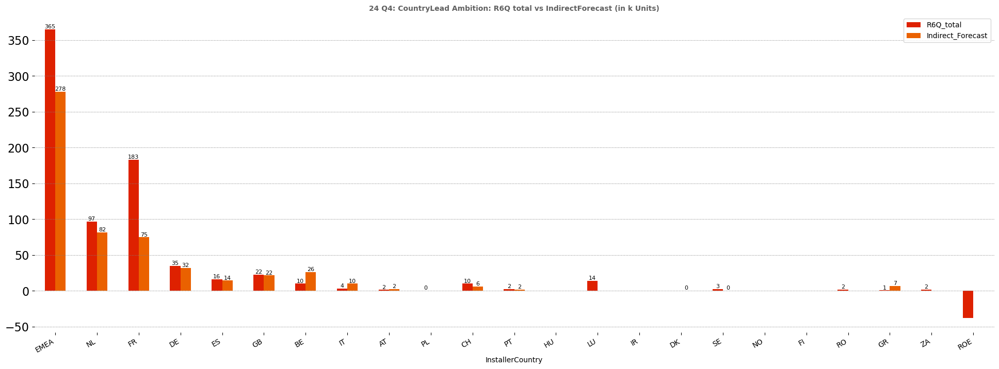

In [90]:
# customize / calculate gaps
eda.X_barchart(GAP, 'InstallerCountry', 'R6Q_total', 'Indirect_Forecast', '24 Q4: CountryLead Ambition: R6Q total vs IndirectForecast (in k Units)', (24,8), reds)

print('If the Country Leader has no personal ambition 100% of the country total must be explained by R6Q')

### Country:  SellThrough vs. Indirect Forecast:

In [91]:
GAP = BOQ[['InstallerCountry', 'POSSolarKu']]
dfC = df.query("Quarter == @Current & ProductType == 'Microinverter'").groupby(["InstallerCountry"], as_index=False)["QuantitySold_k"].sum()
GAP = GAP.merge(dfC, on='InstallerCountry', how='left').fillna(0)
GAP.rename(columns = {'POSSolarKu':'Forecast'}, inplace=True)
GAP = GAP.query("Forecast > 0")
df_C = df.query("ProductType == 'Microinverter'")
GAP.QuantitySold_k.iat[0] = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum().QuantitySold_k.iat[-1]

In [92]:
Country = 'EMEA'

By today EMEA met 39.78% of its BOQ forecast.


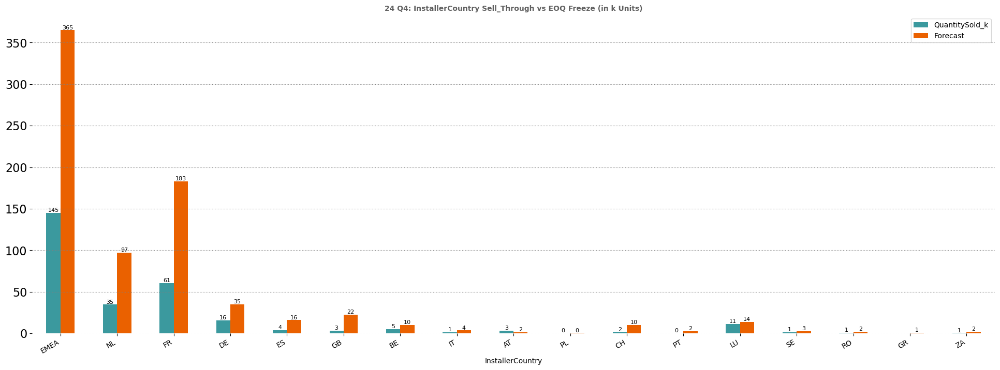

In [93]:
# customize / calculate gaps
eda.X_barchart(GAP, 'InstallerCountry', 'QuantitySold_k', 'Forecast', '24 Q4: InstallerCountry Sell_Through vs EOQ Freeze (in k Units)', (24,8), orangeteal)
print('By today EMEA met {0}% of its BOQ forecast.'.format(round((GAP.query("InstallerCountry == @Country").QuantitySold_k.iat[-1]/GAP.query("InstallerCountry == @Country").Forecast.iat[-1])*100, 2)))

In [94]:
AO_actuals = dis.multidim_crosstab(df, 'InstallerCountry', 'InstallerAccountOwner')

In [95]:
AO_actuals.to_excel("EMEA/AccountOwner_Sales.xlsx",encoding='utf-8-sig',index=False)

### SAM: Actuals vs. Indirect FCST:

In [96]:
dfsam = df.query("ProductType == 'Microinverter'")
df_SAM = dfsam.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

The EMEA total Microinverter SellThrough is 145.1k mic roinverters.
The EMEA Microinverter SellThrough explained by SAM territories is 137.7k microinverters.

Currently 7.5k Microinverters of the EMEA total micro ST are not explained by SAMs.
That represents 5.15% of our total sell through.


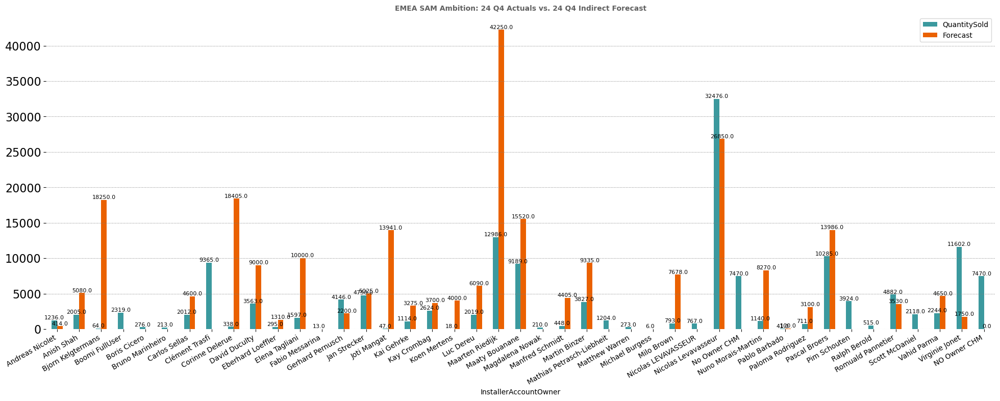

In [97]:
# transform to k units:
dfsam = df.query("Quarter == @Current & ProductType == 'Microinverter'")
df_SAM = dfsam.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold' : df.query("InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.merge(dff_AOm[['InstallerAccountOwner','Forecast']], on='InstallerAccountOwner', how='left')
df_SAM = df_SAM.append(new_row, ignore_index=True)

df_SAM['Ambition'] = round(df_SAM['Forecast']/df_SAM['QuantitySold']*100,2).astype(str) + '%' 
#df_SAM = df_SAM.dropna()

NoOwner = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerAccountOwner == 'No Owner CHM'")
ALL_SAM = dfsam.query("InstallerAccountOwner != 'No Owner CHM'").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

print('The EMEA total Microinverter SellThrough is {0}k mic roinverters.'.format(round(dfsam.QuantitySold.sum()/1000,1)))
print('The EMEA Microinverter SellThrough explained by SAM territories is {0}k microinverters.'.format(round(ALL_SAM.QuantitySold.sum()/1000,1)))
print()
Incorta_SAM_Gap = dfsam.QuantitySold.sum() - ALL_SAM.QuantitySold.sum()
print('Currently {0}k Microinverters of the EMEA total micro ST are not explained by SAMs.'.format(round(Incorta_SAM_Gap/1000,1)))
print('That represents {0}% of our total sell through.'.format(round((Incorta_SAM_Gap/dfsam.QuantitySold.sum())*100 ,2)))

eda.SAM_barchart(df_SAM, 'QuantitySold', "EMEA SAM Ambition: 24 Q4 Actuals vs. 24 Q4 Indirect Forecast", (24,8))

In [98]:
# df['InstallerAccountOwner_CHM'] = df['InstallerAccountOwner_CHM'].fillna('No Owner CHM')
# df['InstallerAccountOwner_SFDC'] = df['InstallerAccountOwner_SFDC'].fillna('No Owner CHM')
# df['CHM_Owner_Combi'] = df['CHM_Owner_Combi'].fillna('No Owner CHM')

# # transform to k units:
# dfsam = df.query("ProductType == 'Microinverter'")
# df_SAM = dfsam.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().reset_index()
# df_SAM1 = dfsam.groupby(["InstallerAccountOwner_CHM"], as_index=False)["QuantitySold"].sum().reset_index()
# df_SAM2 = dfsam.groupby(["InstallerAccountOwner_SFDC"], as_index=False)["QuantitySold"].sum().reset_index()
# df_SAM3 = dfsam.groupby(["CHM_Owner_Combi"], as_index=False)["QuantitySold"].sum().reset_index()

# df_SAM1.rename(columns = {'InstallerAccountOwner_CHM':'InstallerAccountOwner', 'QuantitySold':'OwnerName_CHM'}, inplace=True)
# df_SAM2.rename(columns = {'InstallerAccountOwner_SFDC':'InstallerAccountOwner', 'QuantitySold':'InstallerAccountOwner_SFDC'}, inplace=True)
# df_SAM3.rename(columns = {'CHM_Owner_Combi':'InstallerAccountOwner', 'QuantitySold':'CHM_Owner_Combi'}, inplace=True)

# df_SAM = df_SAM[['InstallerAccountOwner','QuantitySold']].merge(df_SAM1[['InstallerAccountOwner','OwnerName_CHM']], on='InstallerAccountOwner', how='left')
# df_SAM = df_SAM.merge(df_SAM2[['InstallerAccountOwner','InstallerAccountOwner_SFDC']], on='InstallerAccountOwner', how='left')
# df_SAM = df_SAM.merge(df_SAM3[['InstallerAccountOwner','CHM_Owner_Combi']], on='InstallerAccountOwner', how='left')

# # df_SAM.rename(columns = {'QuantitySold_x':'InstallerAccountOwner',
# #                          'QuantitySold_y': '',
# #                          'QuantitySold_x'	QuantitySold_y}, inplace=True)

# new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold' : df.query("InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold.sum(), 'Forecast' : 0.001}
# #new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

# df_SAM = df_SAM.merge(dff_AOm[['InstallerAccountOwner','Forecast']], on='InstallerAccountOwner', how='left')
# #df_SAM = df_SAM.append(new_row, ignore_index=True)

# df_SAM['Ambition'] = round(df_SAM['Forecast']/df_SAM['QuantitySold']*100,2).astype(str) + '%' 
# #df_SAM = df_SAM.dropna()

# NoOwner = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerAccountOwner == 'No Owner CHM'")
# ALL_SAM = dfsam.query("InstallerAccountOwner != 'No Owner CHM'").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

# print('The EMEA total Microinverter SellThrough is {0}k mic roinverters.'.format(round(dfsam.QuantitySold.sum()/1000,1)))
# print('The EMEA Microinverter SellThrough explained by SAM territories is {0}k microinverters.'.format(round(ALL_SAM.QuantitySold.sum()/1000,1)))
# print()
# Incorta_SAM_Gap = dfsam.QuantitySold.sum() - ALL_SAM.QuantitySold.sum()
# print('Currently {0}k Microinverters of the EMEA total micro ST are not explained by SAMs.'.format(round(Incorta_SAM_Gap/1000,1)))
# print('That represents {0}% of our total sell through.'.format(round((Incorta_SAM_Gap/dfsam.QuantitySold.sum())*100 ,2)))

# eda.SAM_barchart(df_SAM, 'QuantitySold', "EMEA SAM Ambition: 24Actuals vs. 24Indirect Forecast", (24,8))

In [99]:
# print(df_SAM.QuantitySold.sum())
# print(df_SAM1.OwnerName_CHM.sum())
# print(df_SAM2.InstallerAccountOwner_SFDC.sum())
# print(df_SAM3.CHM_Owner_Combi.sum())

# eda.display_side_by_side([df_SAM1, df_SAM2, df_SAM3], ['Owner_CHM_current', 'SFDC_batch', 'CHM_source'])

In [100]:
# df_SAM.to_excel("AdHoc/Ownewrship_diff.xlsx",encoding='utf-8-sig',index=False)

#### Installers with no owners - Missing in Incorta

The following SellThrough is the Gap between CountryTotal and sum of territories:

In [101]:
NoOwner = NoOwner.groupby(['InstallerName', 'InstallerCountry', 'ReportedInstallerState'], as_index=False)["QuantitySold"].sum().sort_values('QuantitySold', ascending = False)
NoOwner.head(20)

,InstallerName,InstallerCountry,ReportedInstallerState,QuantitySold
20,AVENA ENERGIES,FR,FR,79
50,SAM Energies renouvelable SAS,FR,FR13,77
56,SolarAllianz Network SAN GmbH,DE,Berlin,77
38,KH ENERGY,FR,FR,72
17,59907,BE,West Flanders,56
54,SOLUTION HABITAT,FR,FR,54
41,MAGNOAC SOLAIRE,FR,FR,41
39,LA2M CHASSIEU,FR,FR,38
27,ES CHAUFFAGE,FR,FR,34
7,1KOMMA5° Kempten GmbH,DE,Bayern,26


In [102]:
def display_side_by_side(dfs:list, captions:list, tablespacing=10):
    """Display tables side by side to save vertical space
    Input:
        dfs: list of pandas.DataFrame
        captions: list of table captions
    """
    output = ""
    for (caption, df) in zip(captions, dfs):
        output += df.style.hide().set_table_attributes("style='display:inline'").set_caption(caption)._repr_html_()
        output += tablespacing * "\xa0"
    display(HTML(output))

In [103]:
eda.display_side_by_side([NoOwner.iloc[0:20], NoOwner.iloc[20:40], NoOwner.iloc[-20:]], ['Microinverter Sales without Owner (Top20)', 'Microinverter Sales without Owner (21-40)', 'Microinverter Sales without Owner (41-60)'])

InstallerName,InstallerCountry,ReportedInstallerState,QuantitySold
AVENA ENERGIES,FR,FR,79
SAM Energies renouvelable SAS,FR,FR13,77
SolarAllianz Network SAN GmbH,DE,Berlin,77
KH ENERGY,FR,FR,72
59907,BE,West Flanders,56
SOLUTION HABITAT,FR,FR,54
MAGNOAC SOLAIRE,FR,FR,41
LA2M CHASSIEU,FR,FR,38
ES CHAUFFAGE,FR,FR,34
1KOMMA5° Kempten GmbH,DE,Bayern,26


### Partners: ST vs Indirect FCST

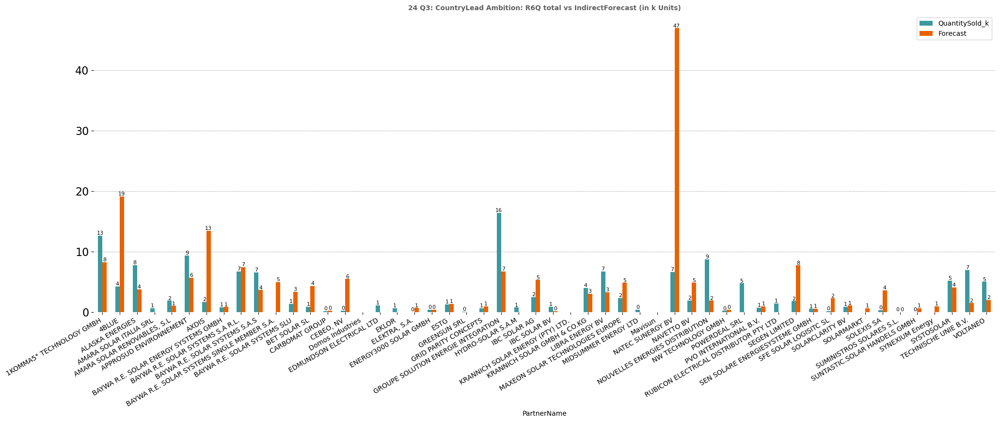

In [104]:
Partners = list(df.query("PartnerRegion == 'EMEA'").groupby(["PartnerName"], as_index=False)["QuantitySold"].sum().PartnerName)
df_Pm = fcst.Partner(df, dff, Countries, 'Microinverter', Partners, Current)

# df_Pm.PartnerName.replace(['1KOMMA5° Hamburg GmbH','BayWa r.e. renewable energy GmbH', 'GSE Intégration','IBC Solar AG','KRANNICH SOLAR GMBH & CO.KG','MAXEON SOLAR TECHNOLOGIES, PTE. LTD','Redpoint newenergy','SEN Solare Energiesysteme Nord Vertriebsgesellschaft mbH','Suntastic.Solar Handels GmbH','4BLUE','Segen LTD (UK) FORECASTABLE DUPLICATE 0061544 Segen LTD','Natec Sunergy','Solarclarity'],
#                             ['1KOMMA5°','BayWa GmbH', ' GSE','IBC Solar','Krannich','Maxeon','Redpoint','SEN Solare','Suntastic.Solar','4BLUE','Segen','Natec Sunergy','Solarclarity'], inplace=True)

eda.X_barchart(df_Pm, 'PartnerName', 'QuantitySold_k', 'Forecast', '24 Q3: CountryLead Ambition: R6Q total vs IndirectForecast (in k Units)', (24,8), orangeteal)

### Details:

In [105]:
eda.display_side_by_side([dff_Cm, dff_AOm, dff_DISm], ['Microinverter Indirect FCST per Country', 'Microinverter Indirect FCST per Owner', 'Microinverter Indirect FCST per Distri'])

InstallerCountry,Forecast,Q1_25,Q2_25,Q3_25,Q4_25,Q1_26
AT,2440,3930,5200,6500,7490,8140
BE,26090,28840,31040,31040,31040,31040
CH,5920,5780,4980,5320,6920,7120
CZ,0,0,0,0,0,0
DE,31770,39925,55930,63305,70255,73905
DK,450,288,972,522,1944,1944
ES,14350,21600,26700,26200,33050,34450
FR,74855,78048,81577,81637,81247,81247
GB,21619,24431,24431,24431,24431,24431
GR,6580,8036,8036,8036,8036,8036


## 1.12 FCSTs Storage

#### BOQ Storage: Forecast by Country, Owners, Distributors:

In [106]:
pd.options.display.float_format = '{:,.0f}'.format

Countries = list(dff.groupby(["InstallerCountry"], as_index=False)["Forecast"].sum().InstallerCountry)

dff_Cs = fcst.Country(dffkwhr, Countries, 'Storage')
dff_Cs = dff_Cs.query("Forecast > 0")
dff_Cs.iloc[:,-6:] = dff_Cs.iloc[:,-6:].astype('int')

dff_AOs = fcst.Owners(dffkwhr, Countries, 'Storage')
dff_AOs = dff_AOs.query("Forecast > 0")
dff_AOs.iloc[:,-6:] = dff_AOs.iloc[:,-6:].astype('int')

dff_DISs = fcst.Distri(dffkwhr, Countries, 'Storage')
dff_DISs = dff_DISs.query("Forecast > 0")
dff_DISs.iloc[:,-6:] = dff_DISs.iloc[:,-6:].astype('int')

eda.display_side_by_side([dff_Cs, dff_AOs, dff_DISs], ['Storage (KWhr) Indirect FCST per Country', 'Storage (KWhr) Indirect FCST per Owner', 'Storage (KWhr) Indirect FCST per Distri'])

InstallerCountry,Forecast,Q1_25,Q2_25,Q3_25,Q4_25,Q1_26
AT,122,70,70,70,70,70
BE,2558,2698,2842,2842,2842,2842
CH,2765,3132,105,0,0,0
DE,5806,2117,2432,2660,2887,2572
DK,35,0,0,0,0,0
ES,210,115,171,210,210,210
FR,430,378,378,378,378,378
GR,927,1225,1225,1225,1225,1225
NL,350,353,350,353,353,353
PT,168,0,0,0,0,0


## 1.13 HEMS FCST

In [107]:
Countries = list(dff.groupby(["InstallerCountry"], as_index=False)["Forecast"].sum().InstallerCountry)

dff_Ch = fcst.Country(dff, Countries, 'HEMS')
dff_Ch = dff_Ch.query("Forecast > 0")
dff_Ch.iloc[:,-6:] = dff_Ch.iloc[:,-6:].astype('int')

dff_AOh = fcst.Owners(dff, Countries, 'HEMS')
dff_AOh = dff_AOh.query("Forecast > 0")
dff_AOh.iloc[:,-6:] = dff_AOh.iloc[:,-6:].astype('int')

dff_DISh = fcst.Distri(dff, Countries, 'HEMS')
dff_DISh = dff_DISh.query("Forecast > 0")
dff_DISh.iloc[:,-6:] = dff_DISh.iloc[:,-6:].astype('int')

#### BOQ HEMS: Forecast by Country, Owners, Distributors:

In [108]:
eda.display_side_by_side([dff_Ch, dff_AOh, dff_DISh], ['HEMS Indirect FCST per Country', 'HEMS Indirect FCST per Owner', 'HEMS Indirect FCST per Distri'])

InstallerCountry,Forecast,Q1_25,Q2_25,Q3_25,Q4_25,Q1_26
DE,299,350,408,450,489,512
InstallerAccountOwner,Forecast,Q1_25,Q2_25,Q3_25,Q4_25,Q1_26
Anish Shah,41,73,102,124,163,186
Jan Strecker,140,140,140,140,140,140
Manfred Schmidt,12,16,21,31,31,31
Martin Binzer,6,9,21,21,21,21
Vahid Parma,100,112,124,134,134,134
PartnerName,Forecast,Q1_25,Q2_25,Q3_25,Q4_25,Q1_26
GROUPE SOLUTION ENERGIE INTEGRATION,4,6,9,9,9,9
IBC SOLAR AG,113,134,154,176,185,196


<a id='EMEA SPA'></a>
## 1.2 SellThrough via SPA:

#### SPA per Country, SAM, Distri

In [109]:
dfSPA = df.query("SpaNumber != 0 & SpaNumber != '0' & SpaNumber != '00'")

In [110]:
dfSPA = dfSPA[['TransactionNumber', 'SpaNumber', 'PartnerCountry', 'InstallerCountry', 'PartnerName', 'InstallerName','InstallerCustomerKey','InstallerAccountOwner', 'QuantitySold', 'QuantitySold_k', 'Quarter']]

In [111]:
dfSPA = df.query("SpaNumber != 0 & SpaNumber != '0' & SpaNumber != '00'")

SPA = dis.multidim_crosstab(dfSPA, 'InstallerCountry', 'InstallerName')
SPA.iloc[:,-14:] = SPA.iloc[:,-14:].astype('int')

cols = list(SPA.iloc[:,-14:].columns)
SPA = SPA.rename(columns={c: c+'_SPA' for c in SPA.columns if c in cols})

#SPA.to_excel("EMEA/SPA_Sales.xlsx",encoding='utf-8-sig',index=False)
SPACountry = dis.multidim_crosstab(dfSPA, 'PartnerCountry', 'InstallerCountry')
SPACountry.iloc[:,-14:] = SPACountry.iloc[:,-14:].astype('int')
#SPA.to_excel("EMEA/SPA_Sales.xlsx",encoding='utf-8-sig',index=False)
SPAOwner = dis.multidim_crosstab(dfSPA, 'InstallerAccountOwner', 'InstallerCountry')
SPAOwner.iloc[:,-14:] = SPAOwner.iloc[:,-14:].astype('int')
#SPA.to_excel("EMEA/SPA_Sales.xlsx",encoding='utf-8-sig',index=False)

In [112]:
eda.display_side_by_side([SPACountry[['PartnerCountry','InstallerCountry','Q324_ST','Q424_ST','Q324_KWhr','Q424_KWhr']].query("Q424_ST >0"), 
                          SPAOwner[['InstallerAccountOwner','InstallerCountry','Q324_ST','Q424_ST','Q324_KWhr','Q424_KWhr']].query("Q424_ST >0")], ['SPA Exports per Country', 'SPA per Owner'])

PartnerCountry,InstallerCountry,Q324_ST,Q424_ST,Q324_KWhr,Q424_KWhr
AT,AT,169,173,45,14
AT,DE,722,101,280,77
BE,BE,263,68,132,25
BE,LU,2772,4536,1213,350
BE,NL,357,144,0,0
CH,CH,440,360,66,70
DE,AT,63,14,77,31
DE,CH,107,72,0,0
DE,DE,30451,3317,3426,500
DE,EE,0,42,0,0


In [113]:
SPAPNIN = dis.multidim_crosstab(dfSPA, 'PartnerName', 'InstallerName')
SPAPNIN.to_excel("EMEA/SPA_PartnerNameInstallerName.xlsx",encoding='utf-8-sig',index=False)

SPAPNIN.sort_values('Q324_ST', ascending = False).head(30)

,PartnerName,InstallerName,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr
772,IBC SOLAR AG,Solarhyp Deutschland GmbH,375,"2,545","3,817",804,116,"10,628","12,110",25,18,896,994,826,28,77,4,0
1043,NATEC SUNERGY BV,Solar Concept BV,"25,848","33,264","14,382","11,340","7,560","5,562","8,316",0,0,0,0,0,84,91,250,196
192,BAYWA R.E. SOLAR SYSTEMS S.A.S,CCL Languedoc,0,"2,882",0,926,"3,312","4,250","7,238",0,0,0,0,0,0,0,0,5
987,NATEC SUNERGY BV,Energiewonen,"6,822","7,290","4,968","7,092","1,638",108,"3,768",0,0,0,0,0,0,0,0,0
1316,SYSTOSOLAR,VST // VENDEE SANIT,0,"1,512","1,512",60,"1,676","3,384","3,402",0,0,0,0,0,4,0,35,4
473,IBC SOLAR AG,CREATON Gmbh,"2,745",526,"1,354",62,18,0,"3,150",0,668,700,0,0,0,0,214,0
1314,SYSTOSOLAR,SolaireEklor,0,0,0,0,936,"2,267","3,120",702,0,0,0,0,0,0,0,0
1197,POWERDEAL SRL,BAUER ENERGIE (LUX),0,0,0,0,0,"1,512","2,772","4,536",0,0,0,0,0,315,"1,214",350
32,ALASKA ENERGIES,ACR DISTRIBUTION,"1,656",450,180,0,756,"2,310","2,562","1,134",0,0,0,0,0,0,0,0
859,IBC SOLAR AG,hagebau Handelsgesellschaft für Baustoffe mbH ...,0,"3,787","1,831",527,"1,575","1,826","2,456",635,0,430,262,77,77,196,238,7


<a id='EMEA CQ'></a>
## 1.3 EMEA Current Quarter Shares:

#### Country Shares Microinverter:

In [114]:
df_micro = df.query("ProductType == 'Microinverter'")
df_pietab = pd.crosstab(df_micro.InstallerCountry, df_micro.Quarter, values=df_micro.QuantitySold_k, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)
#df_pietab

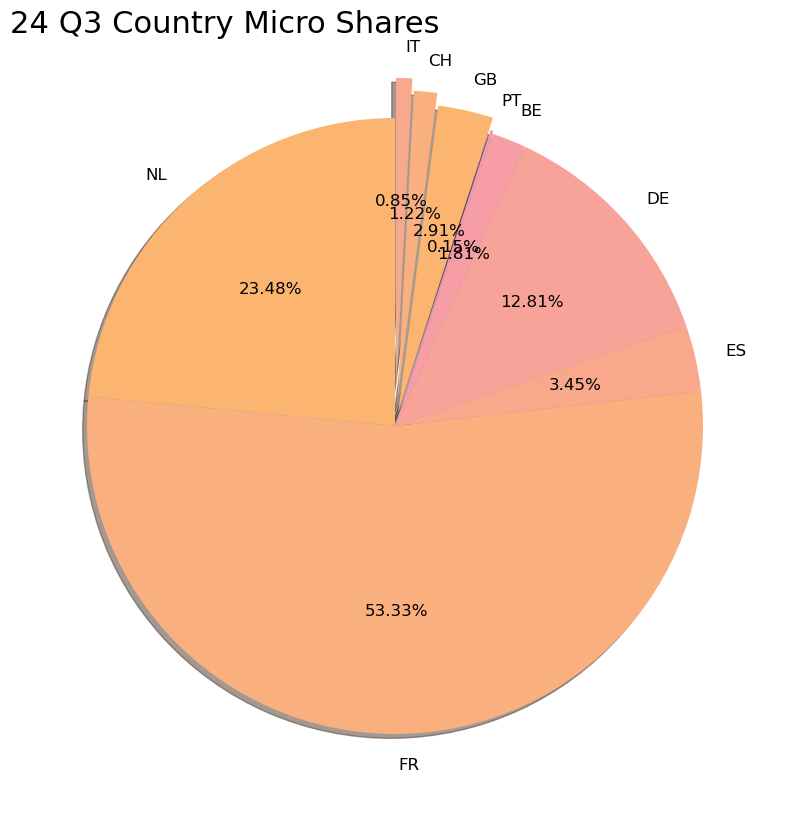

In [115]:
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)
from matplotlib.patches import Shadow

#font = FontProperties()
#font.set_family('serif')
#font.set_name('Times New Roman')
#font.set_style('italic')

pieLabels = 'NL','FR','ES','DE','BE','PT','GB','CH','IT'#,'UU'

popShare = [df_pietab.at['NL','24 Q3'], 
            df_pietab.at['FR','24 Q3'], 
            df_pietab.at['ES','24 Q3'], 
            df_pietab.at['DE','24 Q3'], 
            df_pietab.at['BE','24 Q3'], 
            df_pietab.at['PT','24 Q3'],
            df_pietab.at['GB','24 Q3'],
            df_pietab.at['CH','24 Q3'],
            df_pietab.at['IT','24 Q3'],
#            df_pietab.at['UU','24 Q3']
           ]

explode = (0,0,0,0,0,0.01,0.05,0.09,0.13)
pies = ax.pie(popShare,
        labels=pieLabels,
        explode=explode,
        colors = brand6,
        autopct='%1.2f%%',
        textprops={'fontsize': 12},
        startangle=90) 

for w in pies[0]:
    w.set_gid(w.get_label())
    w.set_edgecolor("none")

for w in pies[0]:
    s = Shadow(w, -0.01, -0.01)
    s.set_gid(w.get_gid() + "_shadow")
    s.set_zorder(w.get_zorder() - 0.1)
    ax.add_patch(s)
    
plt.title('24 Q3 Country Micro Shares', fontsize=22, loc='left')    
plt.savefig('Graphs/Piechart1.png')
plt.show()

#### Country Shares Storage:

In [116]:
df_C = df.query("ProductType == 'Storage'")
#df_pie = df_DE.query("InstallerAccountOwner in ['Anish Shah','Jan Strecker','Manfred Schmidt','Martin Binzer','Vahid Parma','Kai Gehrke'] & ProductType == 'Microinverter'")
df_pietab = pd.crosstab(df_C.InstallerCountry, df_C.Quarter, values=df_C.KWhr, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)

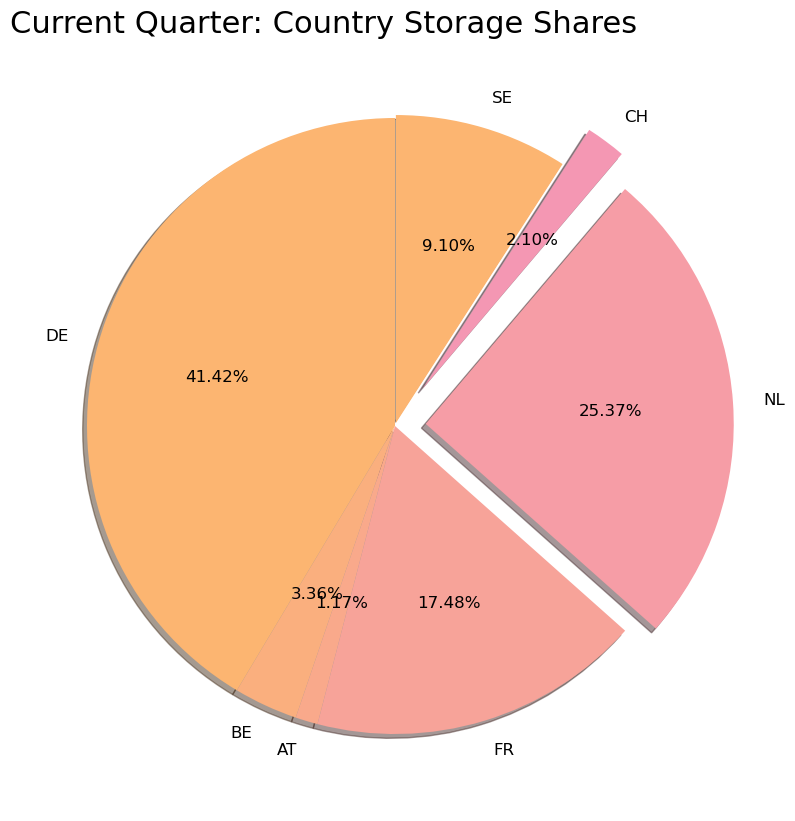

In [117]:
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)
from matplotlib.patches import Shadow

#font = FontProperties()
#font.set_family('serif')
#font.set_name('Times New Roman')
#font.set_style('italic')

pieLabels = 'DE','BE','AT','FR','NL','CH','SE'

popShare = [df_pietab.at['DE',Current], 
            df_pietab.at['BE',Current], 
            df_pietab.at['AT',Current], 
            df_pietab.at['FR',Current], 
            df_pietab.at['NL',Current],
            df_pietab.at['CH',Current],    
            df_pietab.at['SE',Current] 
           ]

explode = (0, 0, 0, 0, 0.1, 0.15, 0.01)

pies = ax.pie(popShare,
        labels=pieLabels,
        explode=explode,
        colors = brand6,
        autopct='%1.2f%%',
        textprops={'fontsize': 12},
        startangle=90) 

for w in pies[0]:
    w.set_gid(w.get_label())
    w.set_edgecolor("none")

for w in pies[0]:
    s = Shadow(w, -0.01, -0.01)
    s.set_gid(w.get_gid() + "_shadow")
    s.set_zorder(w.get_zorder() - 0.1)
    ax.add_patch(s)
    
plt.title('Current Quarter: Country Storage Shares', fontsize=22, loc='left')    
plt.savefig('Graphs/Piechart1.png')
plt.show()

<a id='EMEA SellThrough'></a>
# 1.4. EMEA Sell Through on Cycles
ST on weeks, months, quarters

### ST on weeks
#### Microinverter:

By today EMEA sold 145.13k micro units.
By today EMEA is -12.84k units above/below the quarterly goal.
As a result EMEA met 91.87% of its BOQ forecast for the recent quarter.


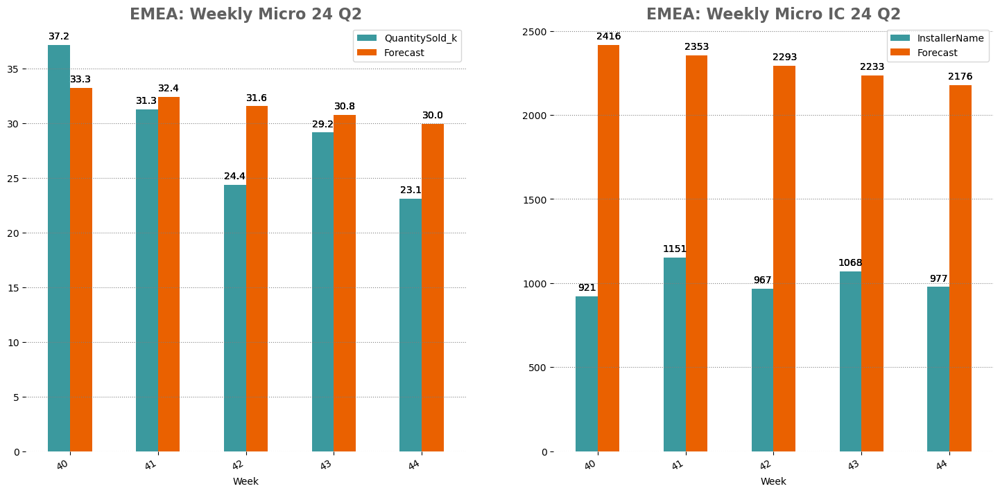

In [118]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast

eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "EMEA: Weekly Micro 24 Q2", "EMEA: Weekly Micro IC 24 Q2", orangeteal)
print('By today EMEA sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today EMEA is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result EMEA met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

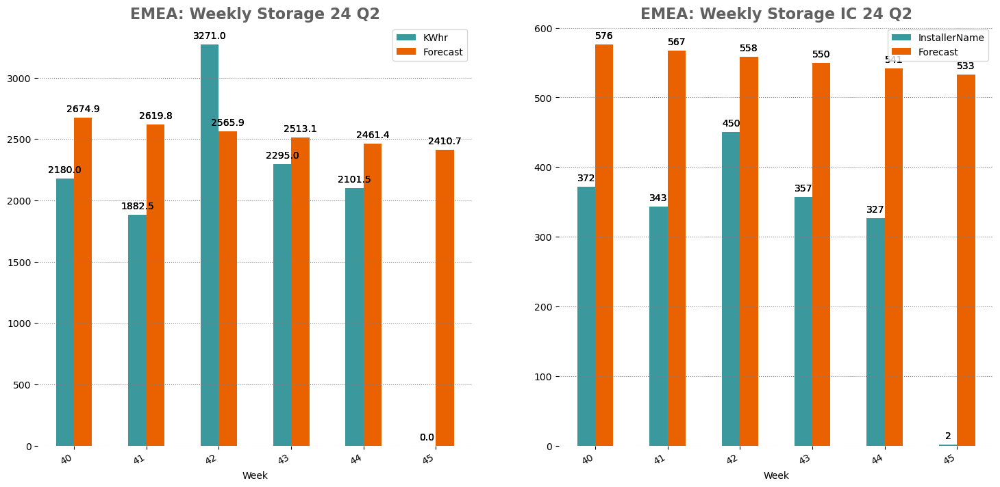

In [119]:
df_s = df.query("ProductType == 'Storage' & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "EMEA: Weekly Storage 24 Q2", "EMEA: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

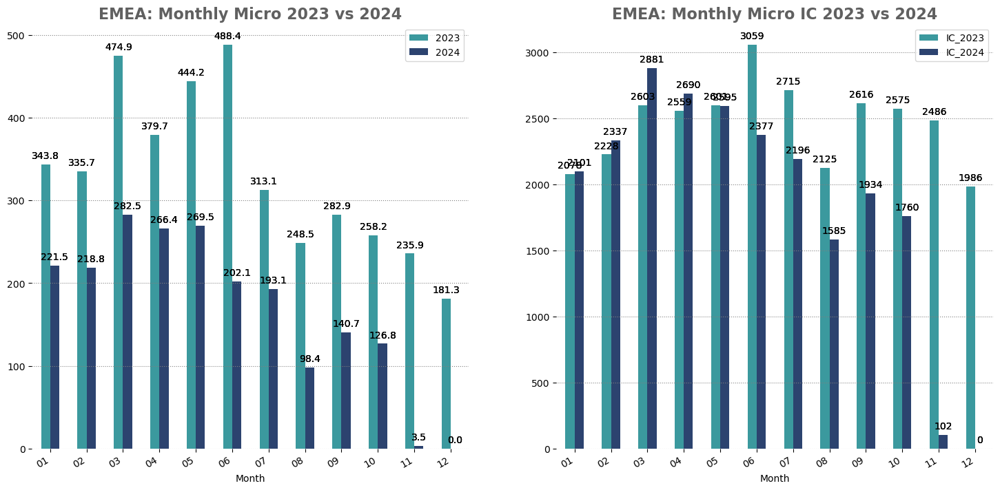

In [120]:
Countries 
df_ST, df_IC = eda.YoY(df, Countries)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "EMEA: Monthly Micro 2023 vs 2024", "EMEA: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

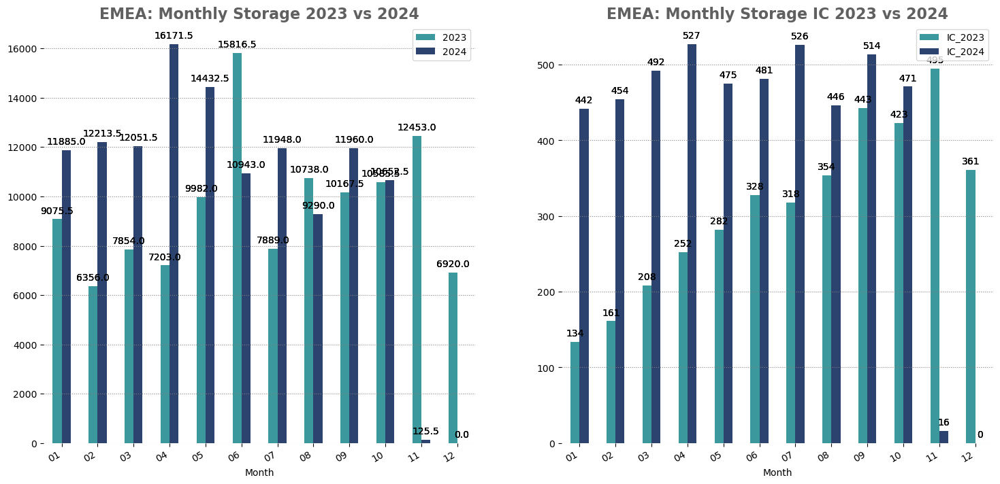

In [121]:
df_ST, df_IC = eda.YoYKWhr(df, Countries)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "EMEA: Monthly Storage 2023 vs 2024", "EMEA: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

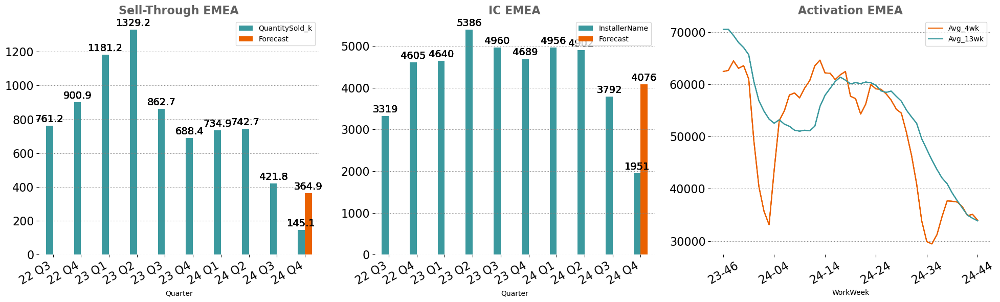

In [122]:
df_C = df.query("ProductType == 'Microinverter'")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAEMEA = dfA.query("Region == 'EMEA'")
dfAEMEA = eda.Averages(dfAEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAEMEA, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through EMEA", "IC EMEA", "Activation EMEA")

#### Storage

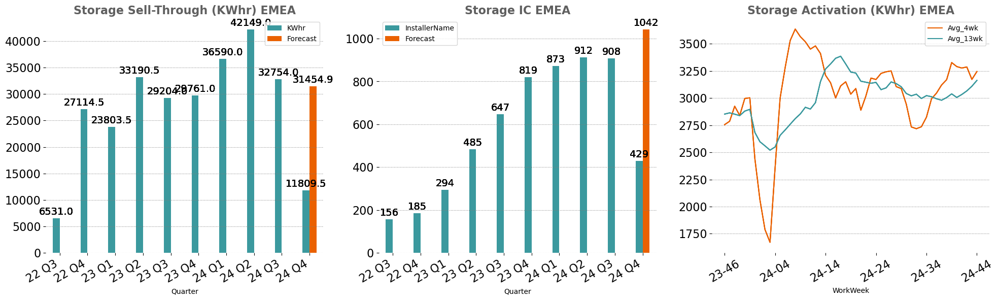

In [123]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("PartnerRegion == 'EMEA'")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) EMEA", "Storage IC EMEA", "Storage Activation (KWhr) EMEA")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [124]:
dfTAM = TAM.groupby(["InstallerName","InstallerAccountOwner"], as_index=False)["PV_TAM"].mean().sort_values('PV_TAM', ascending = False)
dfTAM.drop_duplicates(['InstallerName'], keep='first',  inplace=True)

In [125]:
def Installers(dff, Type):
    dff_p = dff.query("ProductType == @Type")
    dff_p = dff_p.groupby(["InstallerName"]).agg(
         MFCST = ('Forecast','sum'), 
         MFCST_Q1_25 = ('25_Q1','sum'),        
         MFCST_Q2_25 = ('25_Q2','sum'),      
         MFCST_Q3_25 = ('25_Q3','sum'),
         MFCST_Q4_25 = ('25_Q4','sum'),
         MFCST_Q1_26 = ('26_Q1','sum'),
         ).reset_index()
    dff_p.append(dff_p.sum(numeric_only=True), ignore_index=True)
    dff_p = dff_p.replace('NaN','Total')
    #dff_p.style.hide_index()
    return dff_p

In [126]:
dff_i = Installers(dff, 'Microinverter')

In [127]:
# Indirect Forecast on Installer Level
dfICIN = dis.multidim_crosstab(df, 'InstallerCountry', 'InstallerName')

dfkeys.drop_duplicates(['InstallerName'], keep='first',  inplace=True)

dff_i = Installers(dff, 'Microinverter')

# Merge other DBs
dfICIN = dfICIN.merge(dfAInstaller[['InstallerName','23Q1','23Q2','23Q3','23Q4','24Q1','24Q2','24Q3','24Q4','SoW']], on = 'InstallerName', how='left')
dfICIN = dfICIN.merge(dfkeys, on = 'InstallerName', how='left')
dfICIN = dfICIN.merge(dff_i, on = 'InstallerName', how='left')
dfICIN = dfICIN.merge(dfTAM[['InstallerName','InstallerAccountOwner', 'PV_TAM']], on = 'InstallerName', how='left')
dfICIN = dfICIN.merge(SPA[['InstallerName','Q424_ST_SPA']], on = 'InstallerName', how='left')         #SPA dropped

dfICIN.rename(columns={'23Q1': '23Q1_Activations',
                       '23Q2': '23Q2_Activations',
                       '23Q3': '23Q3_Activations',
                       '23Q4': '23Q4_Activations',
                       '24Q1': '24Q1_Activations',
                       '24Q2': '24Q2_Activations',
                       '24Q3': '24Q3_Activations',
                       '24Q4': '24Q4_Activations',
                      }, inplace=True)

# Feature Engineering:
dfICIN["Micro_Achievement_CQ"] = round((dfICIN["Q324_ST"] / dfICIN["MFCST"])*100,2).astype(str)+'%'
dfICIN['PV_TAM_Units'] = (dfICIN['PV_TAM']*1000000 / 420)
dfICIN['ST_24'] = dfICIN['Q124_ST']+dfICIN['Q224_ST']+dfICIN['Q324_ST']+dfICIN['Q424_ST']
dfICIN['Enph_SoW%'] =  (dfICIN['ST_24'] / dfICIN['PV_TAM_Units'] * ((int(pd.Timestamp.today().strftime('%W')) / 52)) * 100).fillna(0)

dfICIN['InstallerCustomerKey'] = dfICIN.InstallerCustomerKey.fillna(0).astype('int')
dfICIN['SPA'] = dfICIN['Q424_ST_SPA'].apply(lambda x: 1 if x > 0 else 0)

dfICIN = dfICIN[['InstallerCountry','InstallerAccountOwner','InstallerName','InstallerCustomerKey','Count_ReportedNames',
                 'Q123_ST','Q223_ST','Q323_ST','Q423_ST','Q124_ST','Q224_ST','Q324_ST','Q424_ST',
                 'Q123_KWhr','Q223_KWhr','Q323_KWhr','Q423_KWhr','Q124_KWhr','Q224_KWhr','Q324_KWhr','Q424_KWhr',
                 '23Q1_Activations','23Q2_Activations','23Q3_Activations','23Q4_Activations','24Q1_Activations','24Q2_Activations','24Q3_Activations','24Q4_Activations',
                 'ST_24','PV_TAM','Enph_SoW%','SPA','Micro_Achievement_CQ','MFCST','MFCST_Q1_25','MFCST_Q2_25','MFCST_Q3_25','MFCST_Q4_25','MFCST_Q1_26']]

dfICIN.to_excel("EMEA/EMEA_InstallerName_All_Combi.xlsx",encoding='utf-8-sig',index=False)

#### Top 20 biggest accounts:

In [128]:
dfICIN.sort_values('Q424_ST', ascending = False).head(20)

,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
8645,FR,Nicolas Levavasseur,Voltaneo,4877921,2,0,0,0,0,"7,946","25,532","13,450","7,652",0,0,0,0,66,105,130,175,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"54,580",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9885,LU,Virginie Jonet,BAUER ENERGIE (LUX),4224890,3,0,0,0,"1,854","3,468","4,789","2,772","4,557",0,0,0,0,354,886,"1,308",350,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"15,586",9,63,1,inf%,0,0,0,0,0,0
9,AT,Gerhard Pernusch,AF Green Trading GmbH,4932825,1,0,0,0,0,0,0,756,"3,024",0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,780",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
10671,NL,Pascal Broers,1K5° Deventer,0,NaN,"13,176","12,636","5,184","3,924","4,320","6,660",0,"2,808",0,0,0,21,192,"1,340","1,650",0,"3,625","3,883","1,511","1,960","2,706","3,373","1,412",496,"13,788",12,42,0,0.0%,"3,500","4,000","4,500","4,500","4,500","4,500"
2226,DE,Jan Strecker,1K5° Hamburg,3967811,11,"1,656","4,020","1,053",180,"3,384","3,559",472,"2,806",182,777,532,21,714,"1,351",973,368,901,"1,285","1,924","1,932","3,123","3,365","2,004",831,"10,221",3,124,0,104.89%,450,450,450,450,450,450
1519,BE,Virginie Jonet,S.E.Belgique,2538742,1,0,0,0,0,739,756,378,"2,436",0,0,0,0,24,66,28,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"4,309",NaN,0,0,inf%,0,0,0,0,0,0
15179,NL,NaN,PVO INTERNATIONAL B.V.,3865611,1,0,0,0,0,0,0,0,"2,268",0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,268",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
2414,DE,Martin Binzer,CREATON Gmbh,1459054,2,"9,543","8,198","5,170","2,510","2,736","3,672","5,094","2,268","2,174","2,734",402,"1,348",906,791,"1,074",105,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"13,770",16,31,1,inf%,0,0,0,0,0,0
7845,FR,Nicolas Levavasseur,REXEL Vaulx en Velin,1670904,1,"17,659","16,540","3,170","14,170","13,620","20,874","15,534","1,904",0,242,182,186,178,256,376,185,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"51,932",NaN,0,0,inf%,0,0,0,0,0,0
5981,FR,Nicolas Levavasseur,COURANT,2915275,2,"4,182","3,590","3,297","7,120","3,744","4,128","1,538","1,813",0,0,0,0,0,0,5,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"11,223",NaN,0,1,21.97%,"7,000","8,500","8,500","8,500","8,500","8,500"


#### Customer Heatmap

In [129]:
#ES Cluster Enlighten Names:
EXTALL = pd.read_excel("EMEA/EMEA_CustomerHealth.xlsx")
EXTALL.columns = EXTALL.columns.str.replace(' ', '')

In [130]:
EXTALL[['24Q1_Acti','24Q2_Acti','24Q3_Acti','24Q4_Acti']] = round(EXTALL[['24Q1_Acti','24Q2_Acti','24Q3_Acti','24Q4_Acti']]/2).astype('int')

In [131]:
# SAM = list(df.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)

# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)

# # EXT = eda.ExtCustHealth(CURR, LAST, df_TAM, dfAInstaller, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# # EXT.to_excel("EMEA/EMEA_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# # EXT

# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.fillna(0)
# EXT.to_excel("EMEA/EMEA_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)


# EXTALL.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [132]:
emea = EXTALL

new_row = {'InstallerCountry':'EMEA', 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': EXTALL.PV_TAM.sum(), 'PV_TAM_Units': EXTALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(EXTALL['Enph_SoW%'].mean(),0),
           'ST_Total':EXTALL.ST_Total.sum(), 'ST_23':EXTALL.ST_23.sum(), 'ST_24': EXTALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': EXTALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(EXTALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':EXTALL.Q124_ST.sum(), 'Q224_ST':EXTALL.Q224_ST.sum(), 'Q324_ST': EXTALL.Q324_ST.sum(), 'Q424_ST': EXTALL.Q424_ST.sum(), 
           '24Q1_Acti': EXTALL['24Q1_Acti'].sum(), '24Q2_Acti': EXTALL['24Q2_Acti'].sum(), '24Q3_Acti': EXTALL['24Q3_Acti'].sum(), '24Q4_Acti': EXTALL['24Q4_Acti'].sum(),
           'Activation_Trend%': EXTALL['Activation_Trend%'].mean(), 'BOQ': EXTALL.BOQ.sum(), 'EOQ': EXTALL.EOQ.sum(), 'Delta': EXTALL.Delta.sum(), 'SPA': EXTALL.SPA.sum()}

emea = emea.append(new_row, ignore_index=True)
emea['Enph_SoW%'] = emea['Enph_SoW%'].astype('int')
emea['Wkly_Trend%'] = emea['Wkly_Trend%'].astype('int')
emea['Activation_Trend%'] = emea['Activation_Trend%'].astype('int')
emea.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
EMEA,All,All,All,8464,22029313,16,3756667,1835816,997351,24-45,10089,0,332151,360092,193798,56379,195088,187954,118687,40372,46,86426,86426,0,128
DE,Enpal B.V.,0,0,400,952381,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Svea Solar AB,0,0,200,476190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Densys PV5 GmbH,Manfred Schmidt,1622505,138,328571,2,5581,0,5581,24-35,132,-100,1214,3311,968,0,0,0,0,0,0,0,0,0,0
NL,Zonneplan b.v.,Pascal Broers,1508469,130,309524,0,12,12,0,23-40,12,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Energiekonzepte Deutschland GmbH,Kai Gehrke,2816069,120,285714,0,31765,19732,78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,ZOLAR GmbH,0,0,108,257143,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
FR,EDF ENR,Nicolas Levavasseur,8225,105,250000,0,124,0,124,24-44,18,225,0,92,0,27,343,412,553,218,20,0,0,0,0
AU,Sunboost,0,0,100,238095,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Energieversum GmbH & Co. KG,Vahid Parma,3034889,90,214286,0,2,0,2,24-06,2,0,2,0,0,0,402,291,119,18,-28,0,0,0,0


# Enlighten Stats: 
### Enphase Sys Sizes:

In [133]:
Country = 'EMEA'

In 2024 we activated 235607 systems in EMEA.


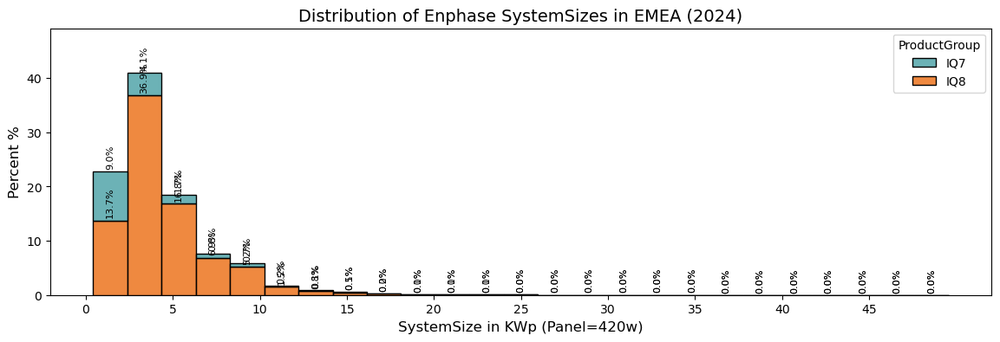

In [134]:
EMEA = df.groupby(['InstallerCountry'], as_index=False)['QuantitySold'].sum().sort_values('QuantitySold').InstallerCountry.tolist()
dfAy = dfA.query("Year == '24' & Country in @EMEA")
print('In 2024 we activated {0} systems in EMEA.'.format(dfAy.query("Country in @EMEA").shape[0]))

eda.SysSizes(dfAy, EMEA, 50, 25, 'Distribution of Enphase SystemSizes in EMEA (2024)')

In [135]:
dfc = df.query("ProductType == 'Microinverter' & Year == '24'")
dfAGG = dfA.query("Year == '24'  & SiteStage == 'Final (Stage 5)'")

dfAGG = dfAGG.groupby(["SiteID","SiteStage","SiteStatus","InstallerID","InstallerName","Country","Region","DeviceType"], as_index=False)["Activations"].sum()

# Sell-Through Micro
df_ST = dfc.groupby(["InstallerCountry"], as_index=False)["QuantitySold"].sum()

# Sys Count Micro
Sys_Count = dfAGG.groupby(["Country"], as_index=False)["Activations"].count()
Sys_Count.rename(columns={'Country': 'InstallerCountry',
                          'Activations' : 'SystemsCount'}, inplace=True)
# Activation Micro
df_AC = dfAGG.groupby(["Country"], as_index=False)["Activations"].sum()
df_AC.rename(columns={'Country': 'InstallerCountry'}, inplace=True)


# Merges
df_ST = df_ST.merge(df_AC, on='InstallerCountry', how='left')
df_ST = df_ST.merge(Sys_Count, on='InstallerCountry', how='left')
df_ST['øSysSize'] = df_ST['Activations'] / df_ST['SystemsCount']

df_ST['QuantitySold'].astype('int')
df_ST['Activations'] = df_ST['Activations'].fillna(0)
df_ST['Activations'] = df_ST['Activations'].astype('int')
df_ST['SystemsCount'] = df_ST['SystemsCount'].fillna(0)
df_ST['SystemsCount'] = df_ST['SystemsCount'].astype('int')
df_ST['øSysSize'] = df_ST['øSysSize'].fillna(0)
df_ST['øSysSize'] = round(df_ST['øSysSize'],1)

df_ST = df_ST.query("QuantitySold > 1000")


dfAym = dfA.query("Region == @Country")
dfAym = dfAym.groupby(['Year_Month'], as_index=False)['Activations'].sum()
dfAym['MoMgrowth'] = round((dfAym['Activations'].pct_change())*100, 2).astype(str)+ '%'
print("All EMEA Activations with MoM-Growth")
dfAym.tail(25)

eda.display_side_by_side([dfAym.tail(25), df_ST], ['Activations with MoM-Growth:', 'SysSizes in EMEA - Split on Countries:'])

All EMEA Activations with MoM-Growth


Year_Month,Activations,MoMgrowth
22-11,304237,8.6%
22-12,258476,-15.04%
23-01,293979,13.74%
23-02,357736,21.69%
23-03,426441,19.21%
23-04,389991,-8.55%
23-05,442327,13.42%
23-06,462037,4.46%
23-07,393654,-14.8%
23-08,292634,-25.66%


## IC Activation

In [136]:
Country

'EMEA'

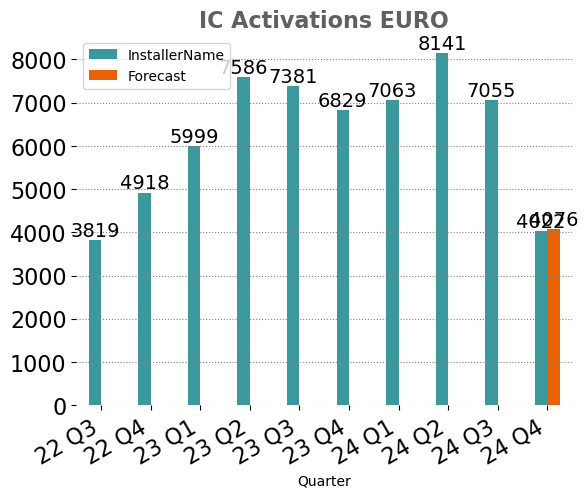

In [137]:
dfAc = dfA.query("Region == @Country & Quarter > '22 Q2'")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations EURO", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,36178,"37,453","37,686"
197,24-41,33547,"36,553","36,303"
198,24-42,33748,"34,856","34,932"
199,24-43,36912,"35,096","34,355"
200,24-44,31629,"33,959","33,861"


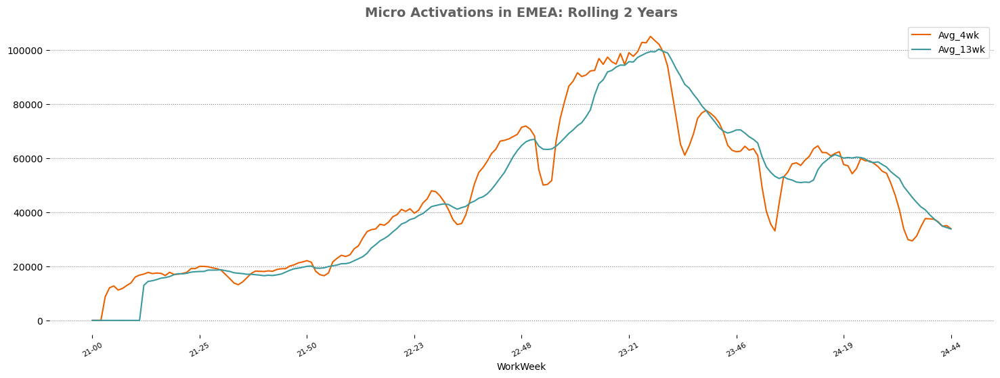

In [138]:
dfAEMEA = dfA.query("Region == @Country")
dfAEMEA = eda.Averages(dfAEMEA, "Activations").iloc[:-1]
eda.ActivationsWide(dfAEMEA, "Micro Activations in EMEA: Rolling 2 Years", (18,6))
dfAEMEA.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAEMEA.WorkWeek.iat[-1]))
dfAEMEA.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  38392 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
We do not load be missing reports b.o. SOX compliance.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


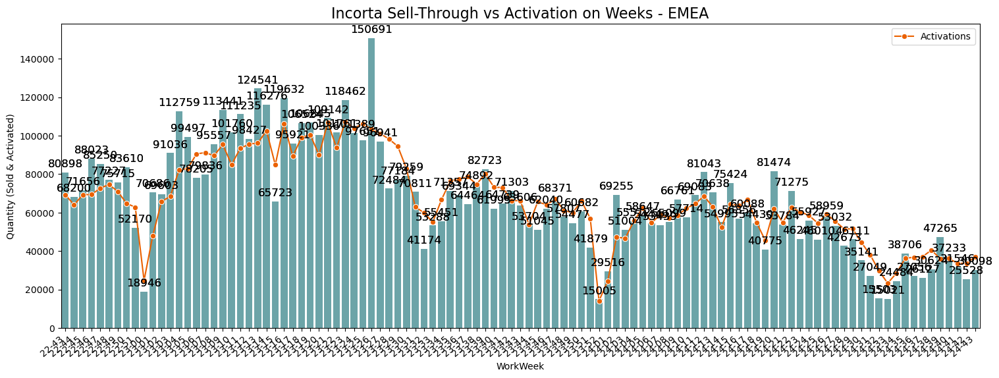

In [139]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0")

dfAEMEA = dfA.query("Region == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAEMEA.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('We do not load be missing reports b.o. SOX compliance.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - EMEA', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,242738,238357
38,24-03,272773,289670
39,24-04,270662,272201
40,24-05,253520,276900
41,24-06,235612,207141
42,24-07,225639,195646
43,24-08,132894,102074
44,24-09,157390,144208
45,24-10,160470,130923
46,24-11,10206,3482


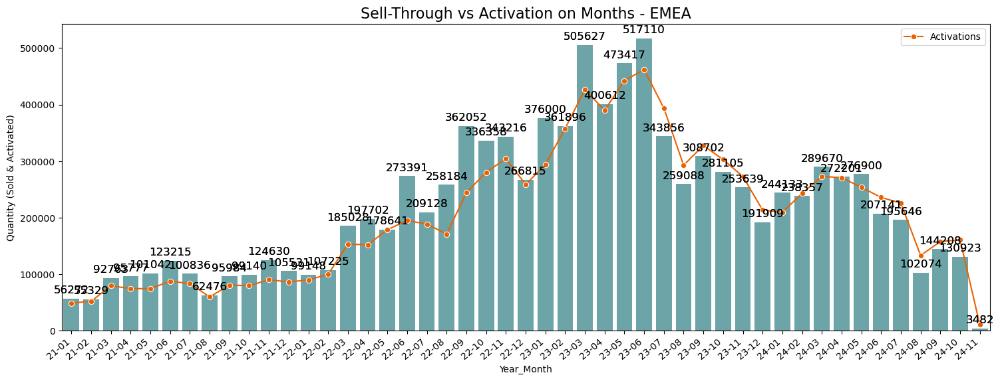

In [140]:
dfAC = dfA.query("Region == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - EMEA', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [141]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Region == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(20)

WorkWeek,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,425,"49,989","62,044","61,388","64,593","52,749","42,194","59,761","52,635","60,734","58,283","56,516","52,803","56,955","53,543","49,920","49,410","42,557","36,703","28,060","21,773","27,165","34,736","35,592","36,046","39,198","34,959","34,845","32,550","32,666","35,728","30,532","5,133",1392185
GLATCHI NANCY (1) - CPT0612718,0,761,948,831,741,774,569,784,718,955,893,843,868,998,950,762,692,598,633,425,374,381,560,845,820,905,886,819,684,775,698,716,120,23326
Solar Concept BV,11,385,568,516,574,554,509,599,568,501,582,539,642,483,437,461,346,154,186,91,356,297,408,244,96,262,256,268,293,152,220,133,8,11699
Solux group,0,302,388,318,335,242,434,411,437,504,512,478,263,292,491,326,792,603,342,0,1,0,89,171,407,580,437,396,571,293,494,586,79,11574
Courant Naturel,3,253,341,323,324,272,106,359,311,435,407,310,382,432,381,341,332,312,305,311,191,333,307,316,281,309,326,409,356,329,331,286,61,10075
PRIM’ENR - CPT0794923,0,270,328,306,301,229,204,316,312,315,327,357,339,307,367,243,343,219,296,149,151,223,248,258,319,309,361,308,286,285,305,284,48,8913
Octopus Energy Services,0,0,0,6,0,0,0,0,0,0,0,0,0,23,20,0,90,137,208,230,357,489,282,484,503,558,807,778,733,899,928,834,33,8399
Coolblue BV,0,299,392,341,390,312,174,395,289,349,274,323,421,234,247,216,210,167,192,161,227,171,124,195,105,121,78,93,163,154,176,160,33,7186
EnergieWonen,0,211,314,278,366,360,142,208,206,234,251,257,292,170,239,246,247,156,147,7,0,111,193,219,224,209,237,251,245,326,304,350,34,7034


<a id='EMEA HEMS'></a> 
##  1.5 EMEA HEMS Sell Out

In [142]:
GAP = dff_Ch[['InstallerCountry', 'Forecast']]
dfC = df.query("Quarter == @Current & ProductType == 'HEMS'").groupby(["InstallerCountry"], as_index=False)["QuantitySold"].sum()
GAP = dfC.merge(GAP, on='InstallerCountry', how='left').fillna(0)
#GAP[Country] = GAP.iloc[:,1:2].sum(axis=1)
GAP.loc[-1]= GAP.iloc[:,1:3].sum(axis=0)
GAP.loc[GAP.index[-1], 'InstallerCountry'] = Country
GAP = GAP.sort_values("QuantitySold", ascending = False)

In [143]:
GAP = GAP.sort_values("QuantitySold", ascending = False)

By today EMEA met 39.46% of its BOQ forecast.


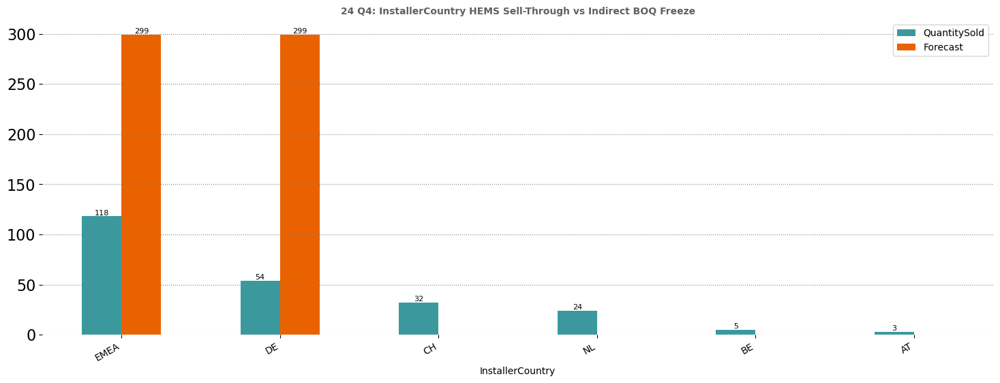

In [144]:
# customize / calculate gaps
eda.X_barchart(GAP, 'InstallerCountry', 'QuantitySold', 'Forecast', '24 Q4: InstallerCountry HEMS Sell-Through vs Indirect BOQ Freeze', (18,6), orangeteal)
print('By today EMEA met {0}% of its BOQ forecast.'.format(round((GAP.query("InstallerCountry == @Country").QuantitySold.iat[-1]/GAP.query("InstallerCountry == @Country").Forecast.iat[-1])*100, 2)))

In [145]:
# dfhems = RAWINC.query("CHMProductType == 'HEMS'")
# dfhems.to_excel("EMEA/HEMS_rawinc.xlsx",encoding='utf-8-sig',index=False)
# df_HEMS = dfhems.groupby(["CHMInstallerAccountOwner", "CHMInstallerName"], as_index=False)["CHMReportedQuantity"].sum()

In [146]:
dfhems = df.query("ProductType == 'HEMS'")
dfhems.to_excel("EMEA/HEMS_raw.xlsx",encoding='utf-8-sig',index=False)
df_HEMS = dfhems.groupby(["InstallerAccountOwner", "InstallerName"], as_index=False)["QuantitySold"].sum()

#### 1.41 HEMS Forecasts

In [147]:
#Eligible SAM Sell-Through in Germany:
SAM = list(df.query("ProductType == 'HEMS'").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)

df_SAM  = dfhems.query("Quarter == @Current")
df_SAM = df_SAM.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

# transform KWhr to MWhr:
df_SAM = df_SAM.merge(dff_AOh, on='InstallerAccountOwner', how='left').fillna(0)

#### SAM Forecast:

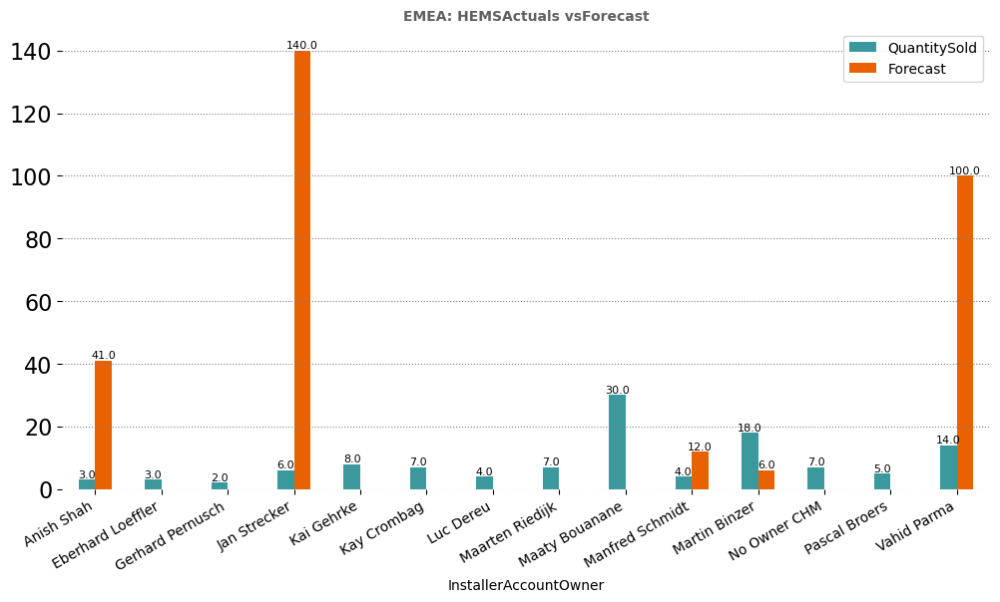

In [148]:
eda.SAM_barchart(df_SAM, 'QuantitySold', "EMEA: HEMSActuals vsForecast",(12,6))

#### Product Sell-Out :

In [149]:
Products = ['HEMS-GW-01', 'HEMS-HP-01']
dff_Ph = fcst.Product(df, dff, Countries, 'HEMS', Products,[Current])

dff_Ph['Forecast'] = dff_Ph['Forecast']*1000
dff_Ph['QuantitySold'] = dff_Ph['QuantitySold_k']*1000

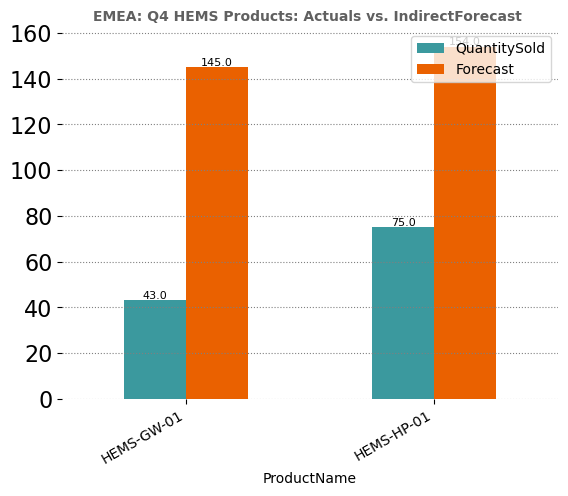

In [150]:
eda.Product_barchart(dff_Ph, 'QuantitySold', "EMEA: Q4 HEMS Products: Actuals vs. IndirectForecast ")

#### Sell-Through vs Forecast quarterly

In [151]:
df_hems = df.query("InstallerCountry == @Countries & ProductType == 'HEMS' & Quarter > '23 Q2'")
df_ST = df_hems.groupby(["Quarter"], as_index=False)["QuantitySold"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = dff_Ph.Forecast.sum()

# Installer Count Micro:
df_IC = df_hems.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# Forecast from Indirect
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = 75

By today EMEA sold 1701 units of HEMS products.


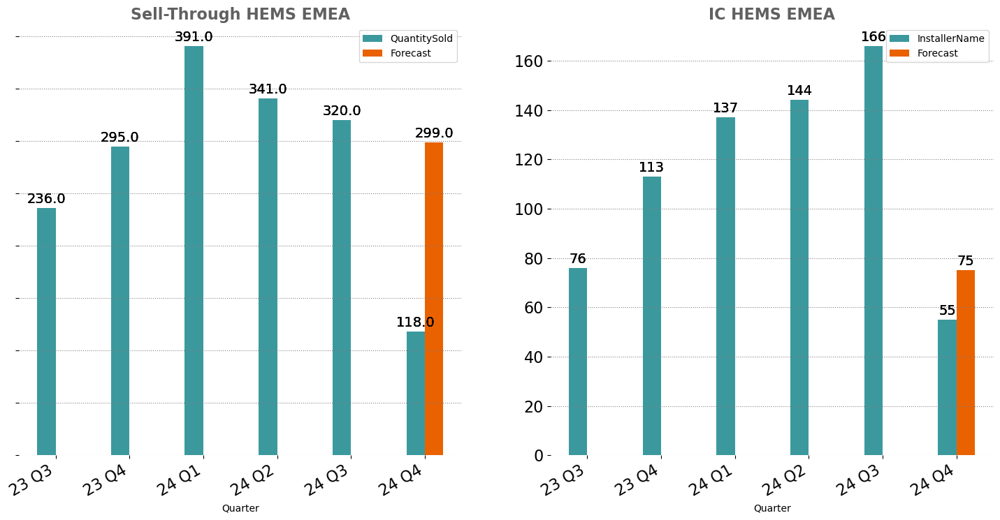

In [152]:
eda.POS2IC(df_ST, df_IC, 'Quarter', 'QuantitySold', 'InstallerName', 
        "Sell-Through HEMS EMEA", "IC HEMS EMEA")

print('By today EMEA sold {0} units of HEMS products.'.format((df_ST.QuantitySold.sum())))

#### HEMS-HP-01

In [153]:
df_hemspr = df.query("InstallerCountry == @Countries & ProductName == 'HEMS-HP-01'")
df_ST = df_hemspr.groupby(["Quarter"], as_index=False)["QuantitySold"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = dff_Ph.loc[dff_Ph['ProductName'] == 'HEMS-HP-01', 'Forecast'].iat[-1]

# Installer Count Micro:
df_IC = df_hemspr.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# Forecast from Indirect
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = 75

By today EMEA sold 900 units of HEMS products.
By today EMEA met 48.7% of its BOQ forecast.
EMEA's BOQ forecast is a -8.33% change QoQ.
EMEA's QOQ Sell-Through development is a -55.36% change.


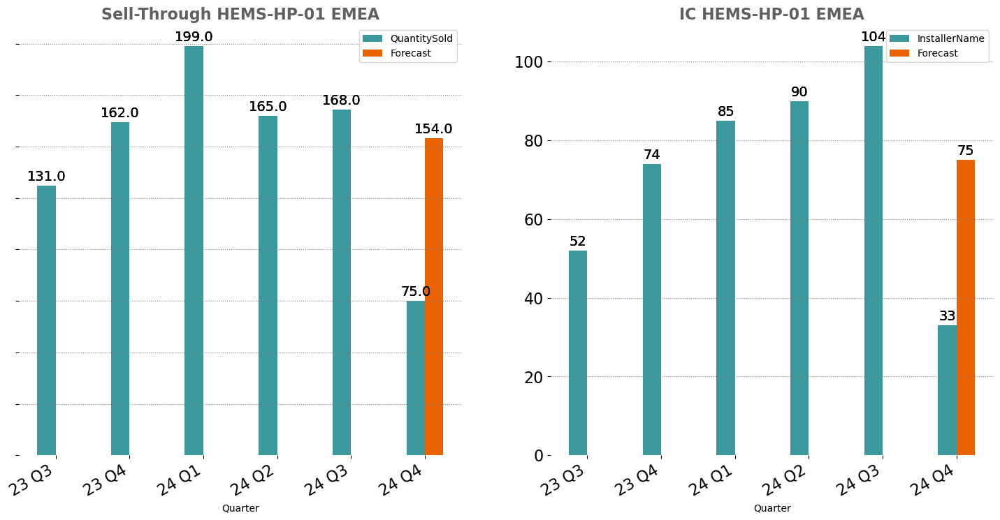

In [154]:
eda.POS2IC(df_ST, df_IC, 'Quarter', 'QuantitySold', 'InstallerName', 
        "Sell-Through HEMS-HP-01 EMEA", "IC HEMS-HP-01 EMEA")

print('By today EMEA sold {0} units of HEMS products.'.format((df_ST.QuantitySold.sum())))
print('By today EMEA met {0}% of its BOQ forecast.'.format(round((df_ST.QuantitySold.iat[-1]/df_ST.Forecast.iat[-1])*100, 2)))
print('EMEA\'s BOQ forecast is a {0}% change QoQ.'.format(round(((df_ST.Forecast.iat[-1]/df_ST.QuantitySold.iat[-2])-1)*100, 2)))
print('EMEA\'s QOQ Sell-Through development is a {0}% change.'.format(round(((df_ST.QuantitySold.iat[-1]/df_ST.QuantitySold.iat[-2])-1)*100, 2)))

#### HEMS-GW-01

In [155]:
df_hemspr = df_hems.query("InstallerCountry == @Countries & ProductName == 'HEMS-GW-01'")
df_ST = df_hemspr.groupby(["Quarter"], as_index=False)["QuantitySold"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = dff_Ph.loc[dff_Ph['ProductName'] == 'HEMS-GW-01', 'Forecast'].iat[-1]

# Installer Count Micro:
df_IC = df_hemspr.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# Forecast from Indirect
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = 75

By today EMEA met 29.66% of its BOQ forecast.
EMEA's BOQ forecast is a -4.61% change QoQ.
EMEA's QOQ Sell-Through development is a -71.71% change.


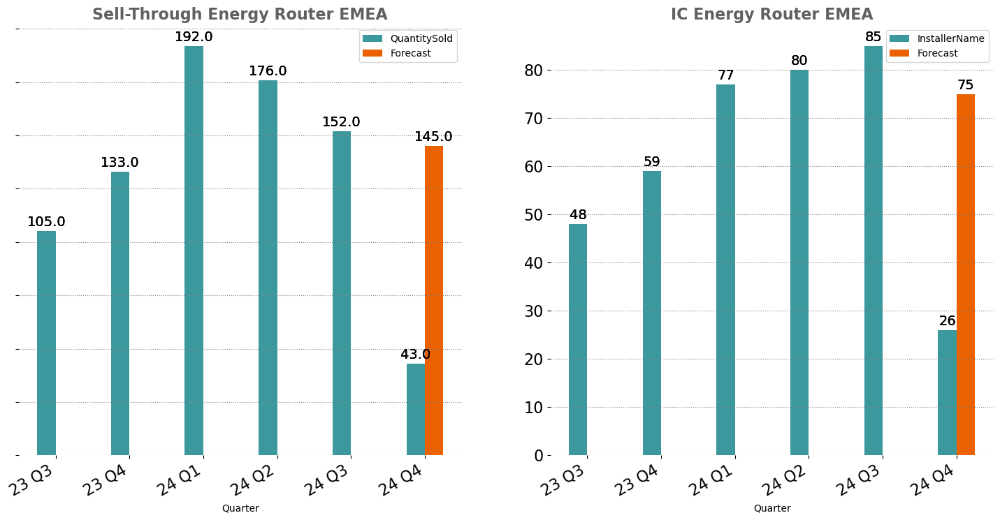

In [156]:
eda.POS2IC(df_ST, df_IC, 'Quarter', 'QuantitySold', 'InstallerName', 
        "Sell-Through Energy Router EMEA", "IC Energy Router EMEA")

print('By today EMEA met {0}% of its BOQ forecast.'.format(round((df_ST.QuantitySold.iat[-1]/df_ST.Forecast.iat[-1])*100, 2)))
print('EMEA\'s BOQ forecast is a {0}% change QoQ.'.format(round(((df_ST.Forecast.iat[-1]/df_ST.QuantitySold.iat[-2])-1)*100, 2)))
print('EMEA\'s QOQ Sell-Through development is a {0}% change.'.format(round(((df_ST.QuantitySold.iat[-1]/df_ST.QuantitySold.iat[-2])-1)*100, 2)))

In [157]:
# HEMS = dis.hems_crosstab(df_hems, 'InstallerAccountOwner', 'InstallerName')
# HEMS.to_excel("EMEA/HEMS_Owner_InstallerName.xlsx",encoding='utf-8-sig',index=False)
# print("All HEMS Products on Installer Name / Account Owner level")
# HEMS 

In [158]:
# HEMS = dis.hems_crosstab(df_hems, 'InstallerCountry', 'InstallerName')
# HEMS['Total'] = HEMS.iloc[:,3:].sum(axis=1)
# HEMS.to_excel("EMEA/HEMS_Country_Name.xlsx",encoding='utf-8-sig',index=False)
# print("All Hems Products on Installer Country / Name level:")
# HEMS.sort_values('Total', ascending = False).head(10)

In [159]:
# HEMS = dis.hems_crosstab(df_hems, 'PartnerName', 'InstallerName')
# HEMS['Total'] = HEMS.iloc[:,3:].sum(axis=1)
# HEMS.to_excel("EMEA/HEMS_PartnerName_InstallerName.xlsx",encoding='utf-8-sig',index=False)
# print("All Hems Products on PartnerName / InstallerName level:")
# HEMS.sort_values('Total', ascending = False)

In [160]:
pd.crosstab(df_hems.ProductName, df_hems.Quarter, values=df_hems.QuantitySold, aggfunc='sum', margins=True, margins_name="Total")

Quarter,23 Q3,23 Q4,24 Q1,24 Q2,24 Q3,24 Q4,Total
ProductName,,,,,,,
HEMS-GW-01,105,133,192,176,152,43,801
HEMS-HP-01,131,162,199,165,168,75,900
Total,236,295,391,341,320,118,1701


<a id='France'></a>
# 2. France
## Micros

# EMEA Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [161]:
Country = 'FR'

In [162]:
def SAM_POS(df, dff, Country, Type, SAM, CQ):
    dff_p = dff.query("InstallerCountry == @Country & InstallerAccountOwner == @SAM & ProductType == @Type")
    dff_p = dff_p.groupby(["InstallerAccountOwner"]).agg(
         Forecast = ('Forecast','sum'), 
         Q1_25 = ('25_Q1','sum'),        
         Q2_25 = ('25_Q2','sum'),     
         Q3_25 = ('25_Q3','sum'),
         Q4_25 = ('25_Q4','sum'),
         Q1_26 = ('26_Q1','sum'),
    ).reset_index()
    dff_p.append(dff_p.sum(numeric_only=True), ignore_index=True)
    dff_p = dff_p.replace('NaN','Total')
    #dff_p.style.hide_index()
    
    #Eligible Product POS:
    dfP =[]
    dfc = df.query("InstallerCountry == @Country & InstallerAccountOwner in @SAM & Quarter == @CQ  & ProductType == @Type")
    df_Prod = dfc.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold_k"].sum()

    # transform KWhr to MWhr:
    dff_p = df_Prod.merge(dff_p, on='InstallerAccountOwner', how='left').fillna(0)
    df_Prod = dff_p[['InstallerAccountOwner','QuantitySold_k','Forecast']]
    dfP = df_Prod.query("InstallerAccountOwner != 'Total'")
    dfP['Forecast'] = dfP.Forecast/1000
    return dfP

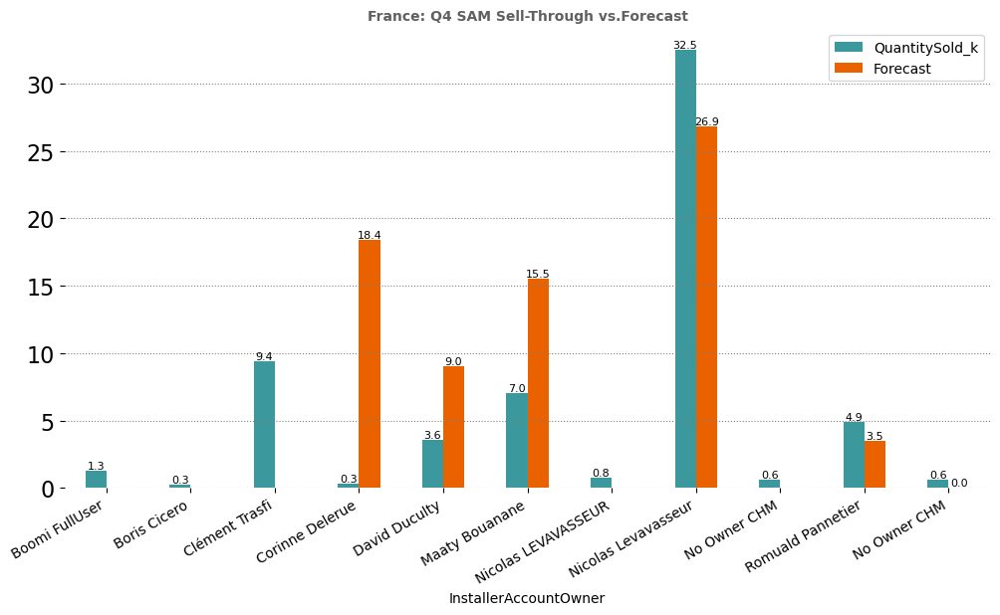

In [163]:
#SAM = ['Anish Shah','Jan Strecker','Manfred Schmidt','Martin Binzer','Vahid Parma','Kai Gehrke','Mathias Petrasch-Liebheit']
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == '24 Q3'").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = SAM_POS(df, dff, Country, 'Microinverter', SAM, '24 Q4')

new_row = {'InstallerAccountOwner':'No Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "France: Q4 SAM Sell-Through vs.Forecast", (12,6))

By today France sold 60.6k micro units.
By today France is -20.32k units above/below the quarterly goal.
As a result France met 74.88% of its BOQ forecast for the recent quarter.


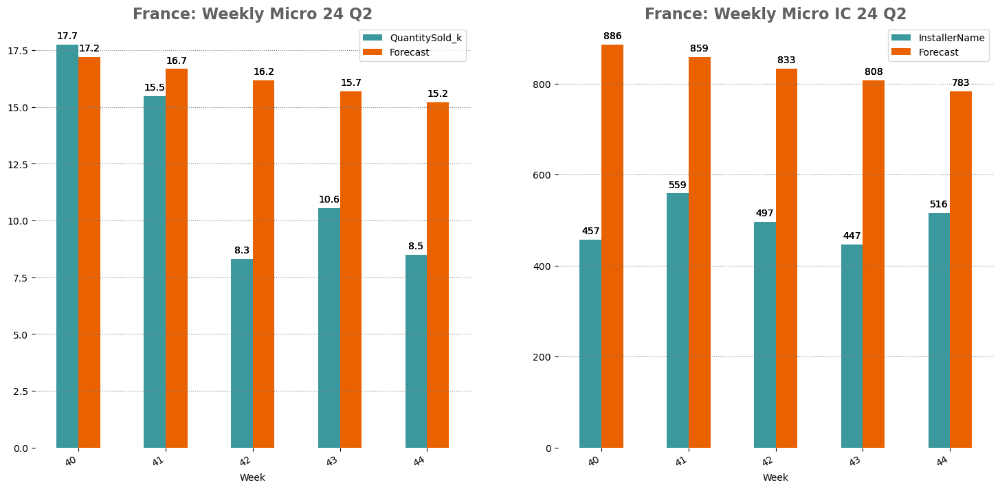

In [164]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "France: Weekly Micro 24 Q2", "France: Weekly Micro IC 24 Q2", orangeteal)
print('By today France sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today France is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result France met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

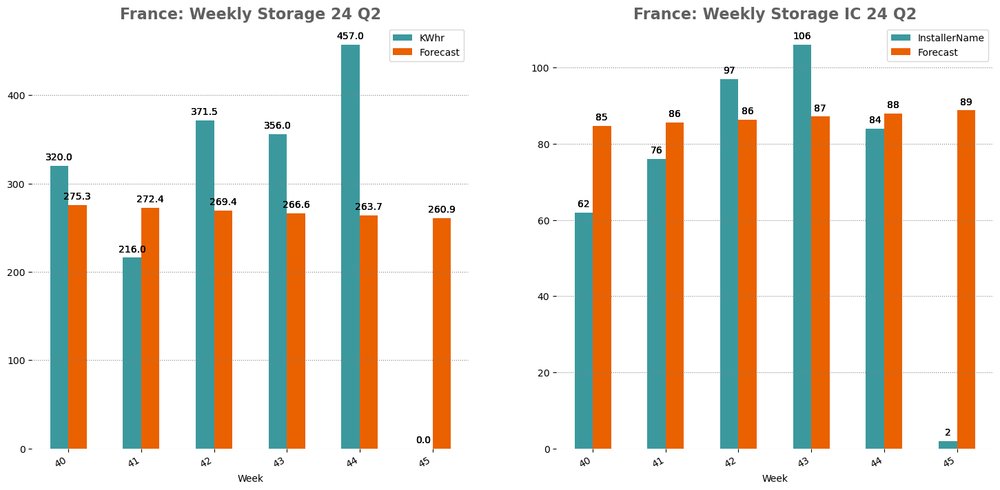

In [165]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "France: Weekly Storage 24 Q2", "France: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

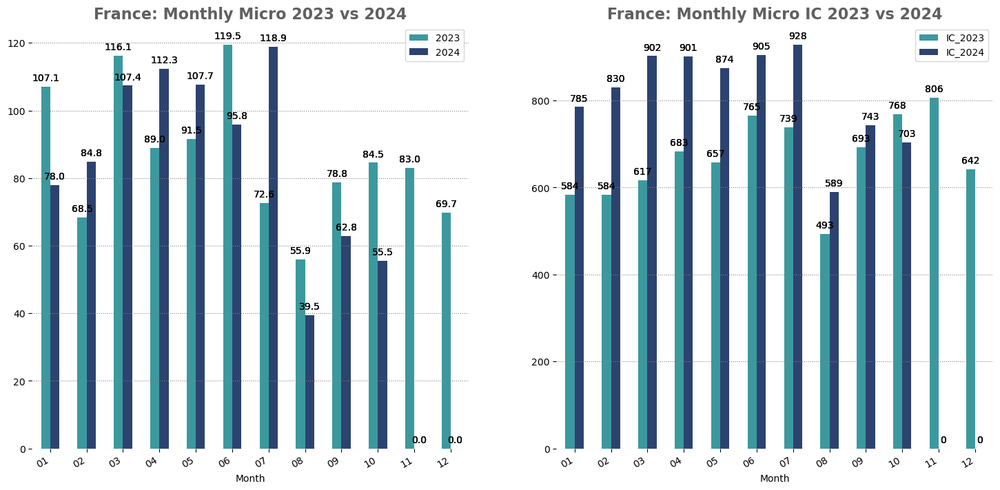

In [166]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "France: Monthly Micro 2023 vs 2024", "France: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

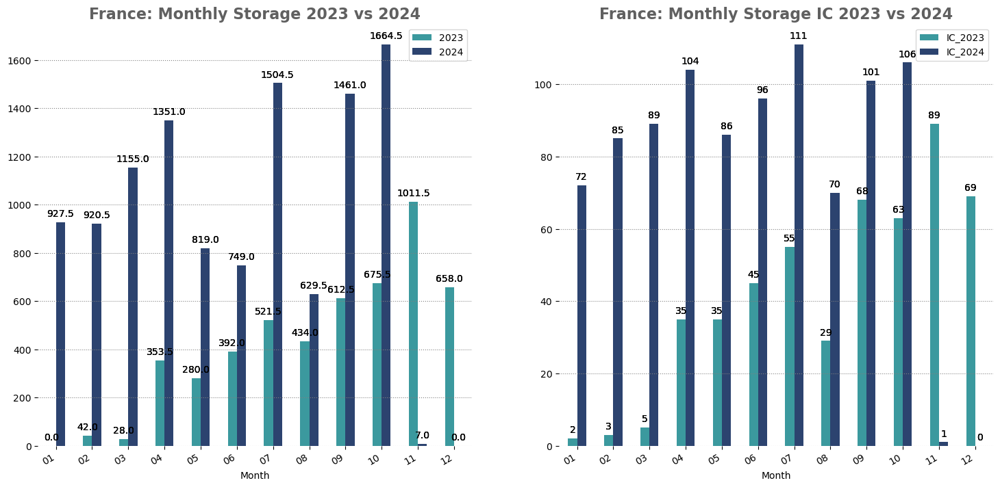

In [167]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "France: Monthly Storage 2023 vs 2024", "France: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

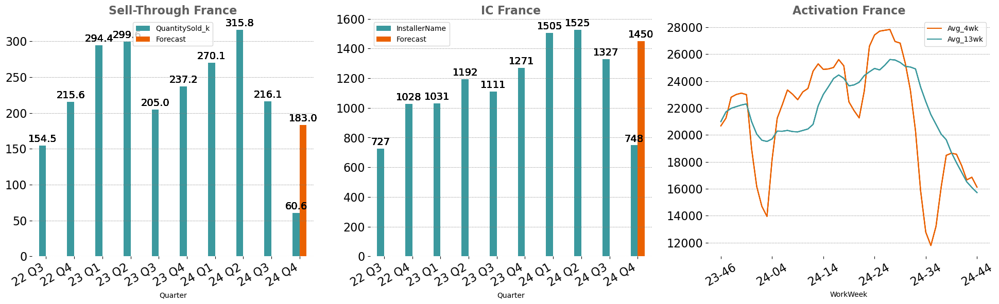

In [168]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through France", "IC France", "Activation France")

#### Storage

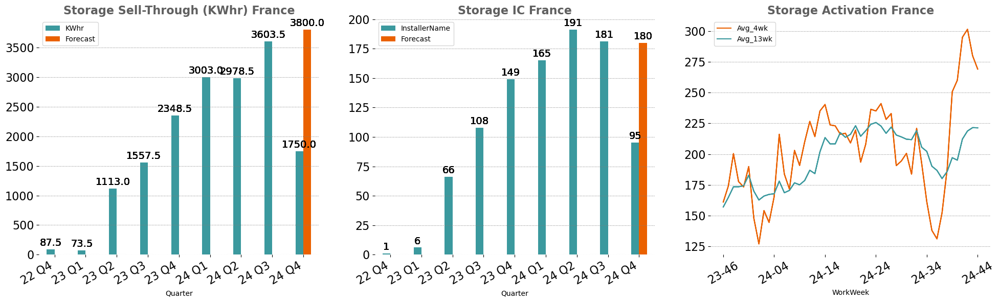

In [169]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) France", "Storage IC France", "Storage Activation France")

## France Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [170]:
print("20 Biggest Installer France (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer France (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
7845,FR,Nicolas Levavasseur,REXEL Vaulx en Velin,1670904,1,"17,659","16,540","3,170","14,170","13,620","20,874","15,534","1,904",0,242,182,186,178,256,376,185,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"51,932",NaN,0,0,inf%,0,0,0,0,0,0
8645,FR,Nicolas Levavasseur,Voltaneo,4877921,2,0,0,0,0,"7,946","25,532","13,450","7,652",0,0,0,0,66,105,130,175,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"54,580",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
8422,FR,Nicolas Levavasseur,Sonepar France,3238878,1,0,0,0,0,434,"2,888","8,011","1,261",0,0,0,0,14,91,48,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"12,594",NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
5788,FR,NaN,CCL Languedoc,194691,3,460,"3,144",0,926,"3,312","4,250","7,238",0,0,0,0,7,4,14,28,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"14,800",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
8851,FR,Nicolas Levavasseur,tereva,3550283,3,"1,060","1,348","1,408","2,698","3,334","7,878","5,974","1,333",0,0,18,10,35,84,156,52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"18,519",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
5283,FR,NaN,APPROSUD ENVIRONNEMENT,3866307,2,"4,868","12,668","8,120","1,846","12,145","9,458","3,649",167,0,0,0,0,0,18,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"25,419",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
8628,FR,Romuald Pannetier,VST // VENDEE SANIT,2108386,5,"1,541","2,574","1,530",114,"1,780","3,384","3,492",180,0,4,38,10,21,28,46,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"8,836",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
8371,FR,Boomi FullUser,SolaireEklor,4673683,1,0,0,0,0,942,"2,267","3,120",702,0,0,0,0,0,0,0,0,0,0,0,0,0,12,0,0,"7,031",NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
7284,FR,NaN,Lahera Productions,1606220,1,"8,473","7,572","3,060","4,536","3,258","1,530","3,024",0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"7,812",NaN,0,0,inf%,0,0,0,0,0,0
8367,FR,Nicolas Levavasseur,Solair'Forez,1690202,1,0,0,0,0,"1,008","1,153","2,981",432,0,0,0,14,0,10,0,0,"1,158","1,358",810,887,"1,334","2,231",964,501,"5,574",1,203,0,inf%,0,0,0,0,0,0


#### Customer Heatmap

In [171]:
Country = "FR"

In [172]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
FR,All,All,All,469,1305399,59,705322,326865,243788,24-45,2566,0,76022,85719,63071,16282,61636,63167,44579,15667,36,13645,13645,0,1
FR,EDF ENR,Nicolas Levavasseur,8225,105,250000,0,124,0,124,24-44,18,225,0,92,0,27,343,412,553,218,20,0,0,0,0
FR,TucoEnergie,Nicolas Levavasseur,1507359,30,71429,0,1616,1488,103,24-31,16,0,56,31,16,0,30,17,10,8,-44,0,0,0,0
FR,France Pac Environnement,0,0,12,28571,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
FR,ENGIE MyPower,Nicolas Levavasseur,1474171,10,23810,30,15252,5148,6220,24-44,203,20,1673,1655,1961,929,188,250,662,486,32,500,500,0,1
FR,NRGIE Conseil,Maaty Bouanane,1713656,8,19048,0,5135,800,7,24-14,2,0,0,2,0,0,13,4,1,2,-73,0,0,0,0
FR,Sibel Energie,Nicolas Levavasseur,1371503,8,18571,25,16774,11447,4026,24-39,8,-100,1469,2175,358,0,1723,570,74,10,-67,0,0,0,0
FR,A+ ENERGIES,Clément Trasfi,1420206,7,16667,1,170,47,75,24-35,15,-100,16,37,22,0,2,0,0,0,-100,0,0,0,0
FR,EnergyGO,Nicolas Levavasseur,445922,6,13571,0,64,18,12,24-39,12,-100,0,0,12,0,20,46,34,10,133,0,0,0,0
FR,Groupe Solution Energie (SVH),Romuald Pannetier,390559,6,13095,35,8792,4397,3994,24-44,59,-11,1345,1126,1146,377,6,22,12,9,267,0,0,0,0


In [173]:
COUNTRYALL.query("InstallerAccountOwner == 'Maaty Bouanane'").style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
FR,NRGIE Conseil,Maaty Bouanane,1713656,8,19048,0,5135,800,7,24-14,2,0,0,2,0,0,13,4,1,2,-73,0,0,0,0
FR,Groupee Verlaine,Maaty Bouanane,3472765,3,6667,26,1485,0,1485,24-44,2,-76,454,932,93,6,0,0,0,0,0,0,0,0,1
FR,Activ'Environnement,Maaty Bouanane,126888,2,4286,121,12068,6154,4492,24-43,90,199,1554,1906,546,486,567,686,398,102,21,1500,1500,0,0
FR,Sun-R Solutions,Maaty Bouanane,1822458,2,4048,4,151,0,151,24-38,75,-100,0,0,150,0,536,552,492,206,3,0,0,0,0
FR,DOMOSOLARIS,Maaty Bouanane,1946082,2,3571,98,7663,4177,3017,24-44,50,2,966,959,839,228,522,602,532,170,15,0,0,0,1
FR,Sam énergies renouvelables,Maaty Bouanane,2010589,2,5952,57,8960,4423,2943,24-37,118,-100,1135,955,853,0,551,482,242,80,-13,0,0,0,0
FR,Charpente couverture photovoltaïque du var,Maaty Bouanane,1670281,2,5238,16,745,0,745,24-39,6,-100,0,739,6,0,670,538,490,243,-20,0,0,0,0
FR,AZUR SYSTEME SOLAIRE,Maaty Bouanane,103199,2,5714,14,1570,785,679,24-42,38,-4,243,220,114,74,142,161,65,35,13,0,0,0,0
FR,AVENIR ELEC,Maaty Bouanane,1484332,2,4762,0,110,1,0,23-00,32,0,0,0,0,0,0,0,0,0,0,0,0,0,0
FR,Green Pro Elec,Maaty Bouanane,1367975,1,1905,97,4856,2094,1602,24-44,22,59,734,561,210,97,583,493,312,54,-15,200,200,0,0


# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 316656 systems in France.


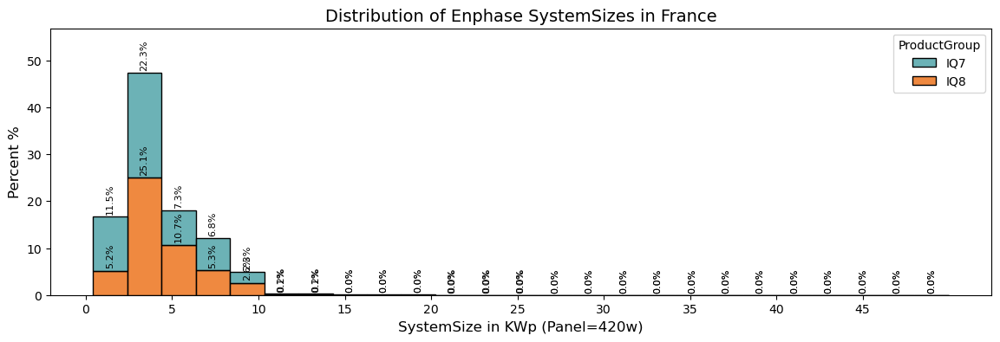

In [174]:
print('Since 2021 we activated {0} systems in France.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, 'FR', 50, 25, 'Distribution of Enphase SystemSizes in France')

## IC Activation

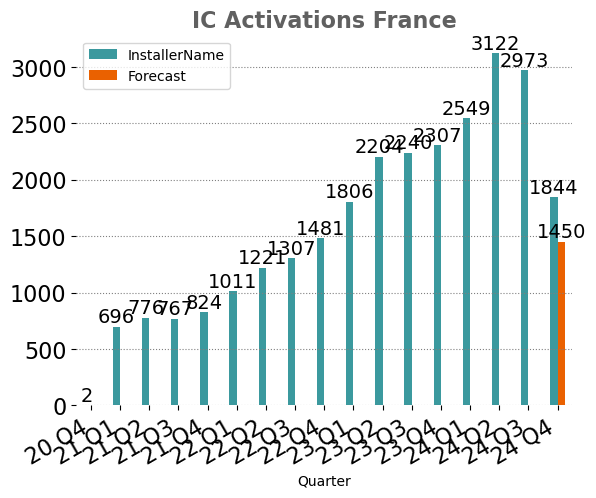

In [175]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == 'FR', 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations France", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,18156,"18,564","17,935"
197,24-41,15689,"17,728","17,230"
198,24-42,16046,"16,661","16,518"
199,24-43,17543,"16,858","16,096"
200,24-44,15222,"16,125","15,722"


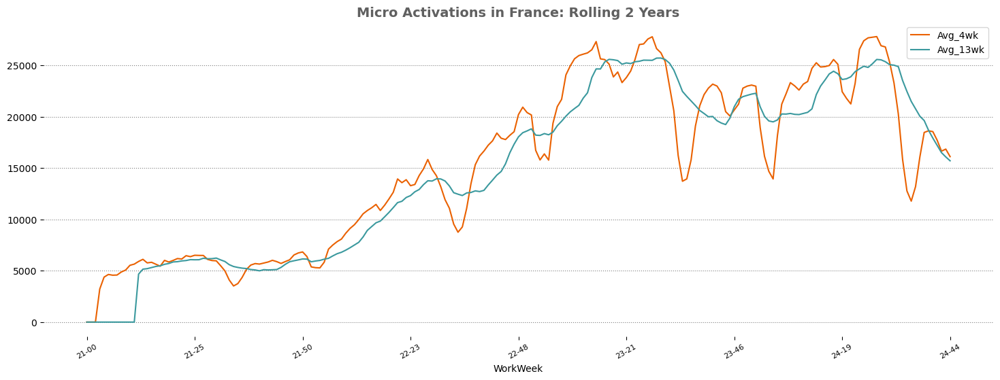

In [176]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[:-1]
eda.ActivationsWide(dfAC, "Micro Activations in France: Rolling 2 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

In [593]:
Country = 'FR'

Since Incorta intro we activated  12691 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


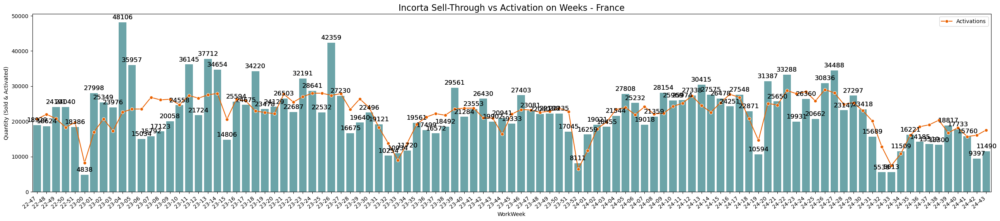

In [594]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2010 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-102:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-35:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - France', (32,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,95401,"98,221"
38,24-03,105813,"113,449"
39,24-04,112183,"115,704"
40,24-05,102827,"113,938"
41,24-06,112221,"97,789"
42,24-07,113530,"120,913"
43,24-08,54786,"42,007"
44,24-09,78199,"64,883"
45,24-10,77862,"57,819"
46,24-11,4009,NaN


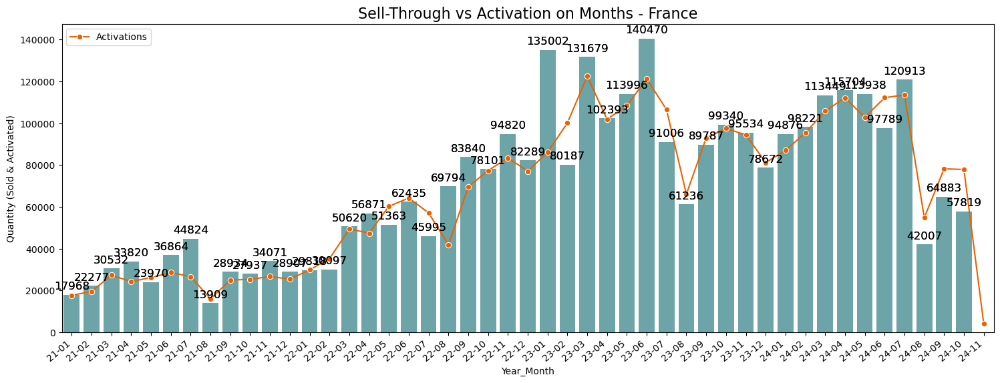

In [179]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - France', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [180]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(20)

WorkWeek,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,171,"21,314","23,981","26,394","25,610","19,767","12,803","23,997","23,493","27,467","26,528","27,164","24,745","27,829","26,948","23,848","24,133","22,017","19,187","11,778","6,488","9,960","15,126","17,840","18,295","19,462","16,091","17,382","15,119","15,336","16,927","14,514","2,571",624285
GLATCHI NANCY (1) - CPT0612718,0,761,948,831,741,774,569,784,718,955,893,843,868,998,950,762,692,598,633,425,374,381,560,845,820,905,886,819,684,775,698,716,120,23326
Courant Naturel,3,253,341,323,324,272,106,359,311,435,407,310,382,432,381,341,332,312,305,311,191,333,307,316,281,309,326,409,356,329,331,286,61,10075
PRIM’ENR - CPT0794923,0,270,328,306,301,229,204,316,312,315,327,357,339,307,367,243,343,219,296,149,151,223,248,258,319,309,361,308,286,285,305,284,48,8913
CGN ENERGIES - CPT0985390,0,193,224,190,225,234,212,226,209,259,293,261,320,321,310,202,271,204,198,239,200,173,233,183,216,172,155,184,130,123,72,99,37,6568
KAUFF ENERGY - CPT0686646,0,203,179,194,275,212,190,210,229,239,285,237,216,221,236,225,200,155,160,148,134,0,0,144,189,166,130,151,163,168,149,123,49,5580
Maisolia,0,108,200,184,164,191,128,116,112,154,124,248,204,209,145,144,216,112,96,52,104,151,183,203,256,132,140,231,163,172,208,146,24,5020
Rhone solaire pro,0,154,209,197,156,153,97,159,233,215,222,187,174,186,159,236,213,152,107,0,0,188,172,168,152,152,76,111,42,113,121,98,34,4636
CR2P,0,114,144,198,206,209,118,188,174,164,200,202,208,104,193,135,162,118,122,68,72,112,140,124,109,137,118,137,187,80,94,72,13,4422


<a id='Germany'></a>
# 3. Germany

# Germany Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [181]:
Country = 'DE'

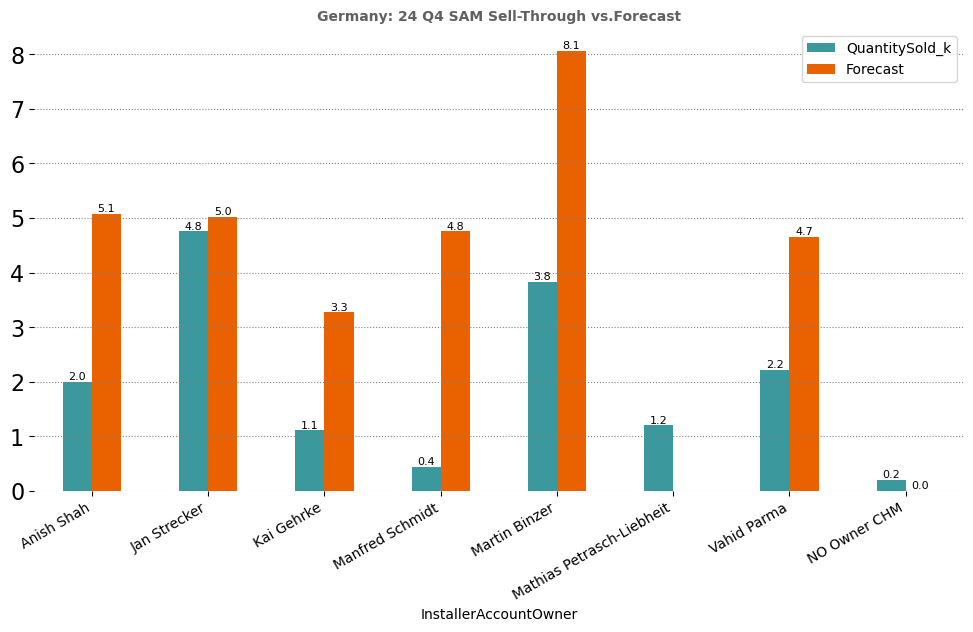

In [182]:
#SAM = ['Anish Shah','Jan Strecker','Manfred Schmidt','Martin Binzer','Vahid Parma','Kai Gehrke','Mathias Petrasch-Liebheit']
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)
df_SAM['Ambition'] = round(df_SAM['Forecast']/df_SAM['QuantitySold_k']*100,2).astype(str) + '%' 
df_SAM['Achievement'] = round(df_SAM['QuantitySold_k']/df_SAM['Forecast']*100,2).astype(str) + '%' 

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Germany: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Germany sold 15.87k micro units.
By today Germany is -1.09k units above/below the quarterly goal.
As a result Germany met 93.57% of its BOQ forecast for the recent quarter.


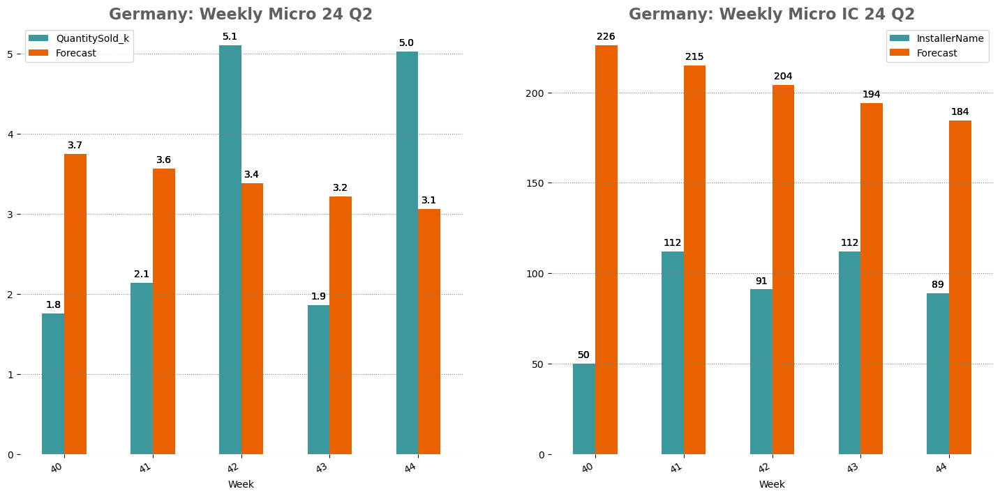

In [183]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Germany: Weekly Micro 24 Q2", "Germany: Weekly Micro IC 24 Q2", orangeteal)
print('By today Germany sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Germany is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Germany met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

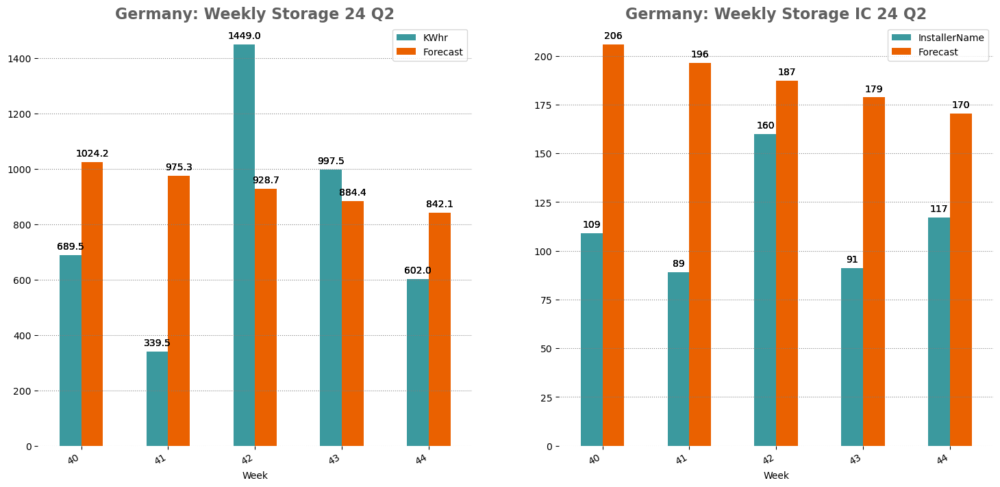

In [184]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Germany: Weekly Storage 24 Q2", "Germany: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

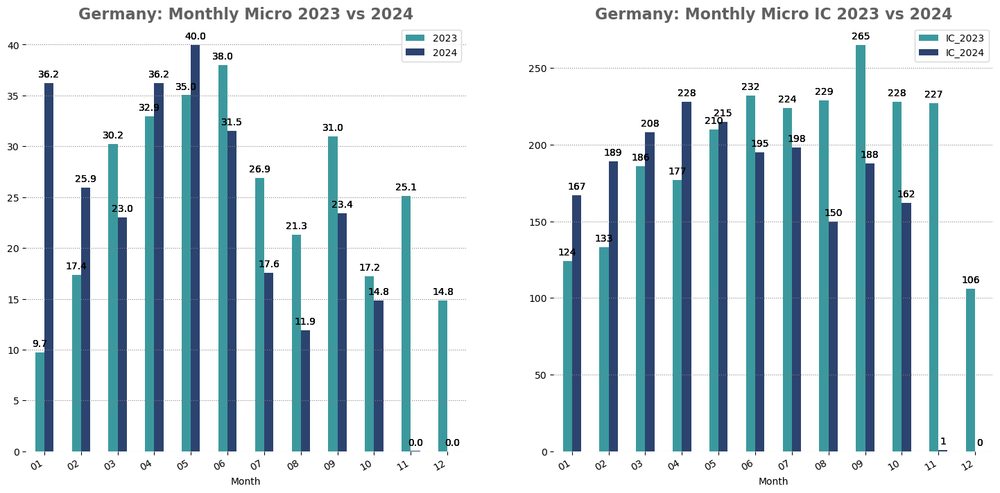

In [185]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Germany: Monthly Micro 2023 vs 2024", "Germany: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

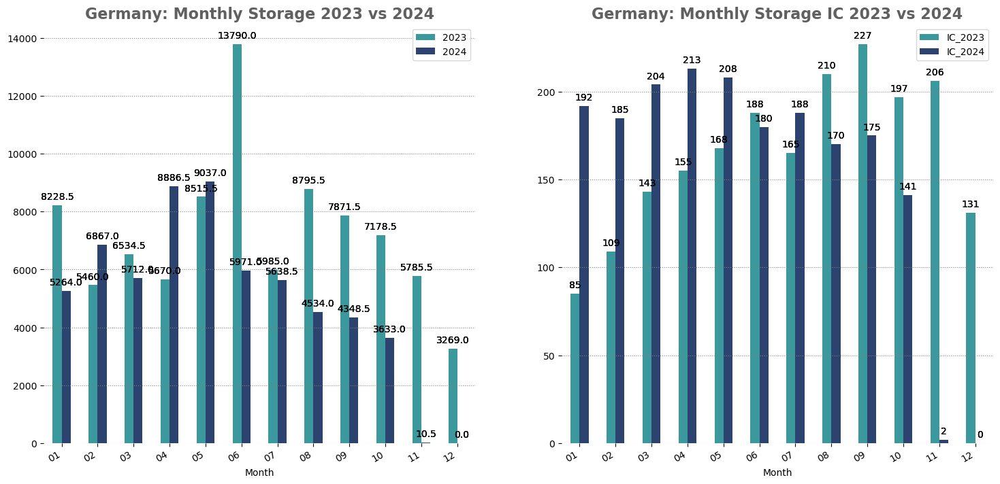

In [186]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Germany: Monthly Storage 2023 vs 2024", "Germany: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

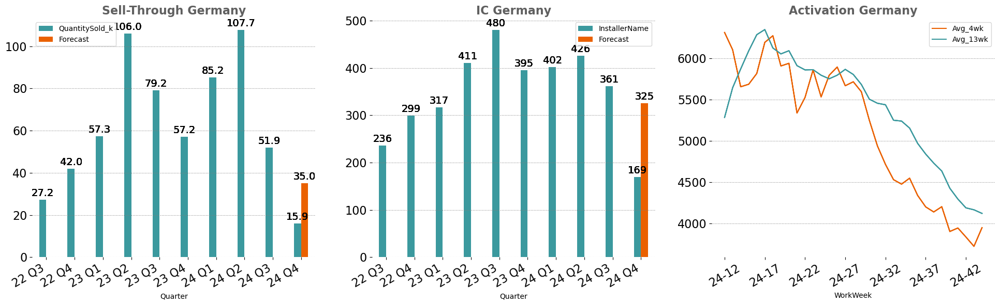

In [187]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-34:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Germany", "IC Germany", "Activation Germany")

#### Storage

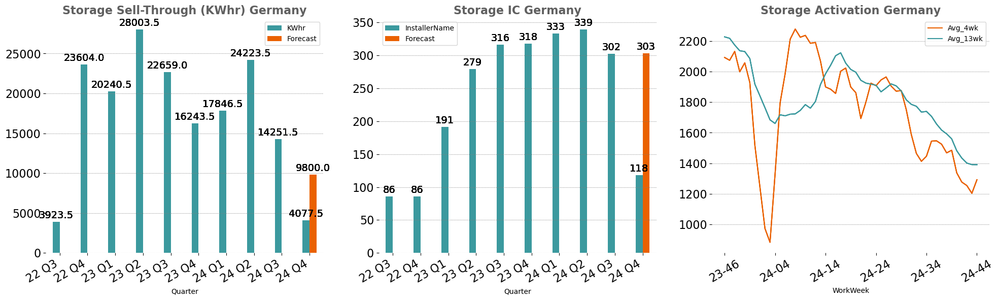

In [188]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Germany", "Storage IC Germany", "Storage Activation Germany")

## Germany Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [189]:
print("20 Biggest Installer Germany (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q224_ST", ascending = False).head(20)

20 Biggest Installer Germany (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
2503,DE,Manfred Schmidt,EDV und Elektrotechnik Hardy Barth GmbH,2407612,2,0,0,0,0,0,"16,080",0,30,0,0,0,0,0,0,0,0,112,340,311,138,61,223,140,95,"16,110",8,78,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
2885,DE,Vahid Parma,Green TC GmbH,3760269,4,0,0,165,"1,081","11,600","13,770",450,0,0,0,60,28,301,238,242,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"25,820",20,47,0,inf%,0,0,0,0,0,0
3548,DE,Vahid Parma,Solarhyp Deutschland GmbH,2873343,2,"2,291","4,936","3,817","1,013",424,"11,344","12,426",25,38,"1,274",994,886,301,168,7,0,87,912,"3,544","3,025","1,409",850,368,21,"24,219",10,88,1,3550.29%,350,400,400,400,400,400
2414,DE,Martin Binzer,CREATON Gmbh,1459054,2,"9,543","8,198","5,170","2,510","2,736","3,672","5,094","2,268","2,174","2,734",402,"1,348",906,791,"1,074",105,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"13,770",16,31,1,inf%,0,0,0,0,0,0
2226,DE,Jan Strecker,1K5° Hamburg,3967811,11,"1,656","4,020","1,053",180,"3,384","3,559",472,"2,806",182,777,532,21,714,"1,351",973,368,901,"1,285","1,924","1,932","3,123","3,365","2,004",831,"10,221",3,124,0,104.89%,450,450,450,450,450,450
2475,DE,Manfred Schmidt,Densys PV5 GmbH,1622505,2,0,0,0,0,"1,214","3,311",968,0,0,0,0,0,18,94,0,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"5,493",138,1,0,inf%,0,0,0,0,0,0
2239,DE,Vahid Parma,1K5° Remscheid,3952760,7,756,756,"1,592",18,"1,926","3,024",0,396,102,416,126,315,315,805,0,158,"1,174","1,138","1,260","1,256","1,072",773,930,348,"5,346",2,78,0,nan%,0,500,"1,500","1,500","1,500","1,500"
2228,DE,Jan Strecker,1K5° Hildesheim,3967812,4,612,"3,024","2,268",0,0,"3,024",0,0,276,"1,278",665,0,70,682,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,024",NaN,0,0,0.0%,225,225,225,225,225,225
3569,DE,Vahid Parma,Soly Germany,3298724,5,161,"2,958","4,322","3,865","3,011","2,995",579,172,0,956,"1,110","1,232",994,826,220,119,0,"1,224","4,625","4,103","3,120","2,447","1,122",370,"6,757",8,31,0,57.9%,"1,000","1,500","2,500","3,000","3,500","3,500"
2235,DE,Vahid Parma,1K5° Münster,3952755,6,"1,065","3,846","3,097","2,222","5,292","2,557",0,486,186,728,584,900,"1,886","2,184",0,455,"1,971","2,130","2,980","3,478","3,724","2,983","2,347",709,"8,335",4,67,0,nan%,0,500,"3,000","4,000","5,000","5,000"


#### Customer Heatmap: PV_TAM 

In [190]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# #SAM = ['Anish Shah']
# LAST = eda.CustHealth(df,TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Germany_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.fillna(0)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

In [191]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
DE,All,All,All,3048,7962095,5,564214,269260,238842,24-45,3777,-1,60236,95736,41946,11918,21982,21421,16616,4961,53,14036,14036,0,1
DE,Enpal B.V.,0,0,400,952381,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Densys PV5 GmbH,Manfred Schmidt,1622505,138,328571,2,5581,0,5581,24-35,132,-100,1214,3311,968,0,0,0,0,0,0,0,0,0,0
DE,Energiekonzepte Deutschland GmbH,Kai Gehrke,2816069,120,285714,0,31765,19732,78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,ZOLAR GmbH,0,0,108,257143,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Energieversum GmbH & Co. KG,Vahid Parma,3034889,90,214286,0,2,0,2,24-06,2,0,2,0,0,0,402,291,119,18,-28,0,0,0,0
DE,Solar-Energie Andresen GmbH,0,0,75,178571,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Svea Solar Deutschland GmbH,Vahid Parma,3413135,44,104762,0,215,0,215,24-44,15,-1,0,0,123,54,0,0,18,16,0,0,0,0,1
DE,DZ-4 GmbH,0,0,34,80952,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
DE,Thermondo GmbH,0,0,30,71429,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [192]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Anish Shah', 'Jan Strecker', 'Kai Gehrke', 'Manfred Schmidt', 'Martin Binzer', 'Mathias Petrasch-Liebheit', 'Vahid Parma']
# LAST = eda.CustHealth(df,TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Germany_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.fillna(0)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

#### Customer Heatmap: SellThrough_Total

In [193]:
EXTALL.query("InstallerCountry == @Country").sort_values("ST_Total", ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)
#.style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

,InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
59,DE,CREATON Gmbh,Martin Binzer,1459054,16,38095,47,45297,29835,15462,24-44,378,39,2736,3672,5094,2268,0,0,0,0,0,0,0,0,1
108,DE,Solarhyp Deutschland GmbH,Vahid Parma,2873343,10,23810,118,38452,14012,24374,24-44,25,-99,424,11344,12426,25,704,425,184,10,-40,353,353,0,1
4,DE,Energiekonzepte Deutschland GmbH,Kai Gehrke,2816069,120,285714,0,31765,19732,78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
51,DE,Green TC GmbH,Vahid Parma,3760269,20,47619,63,27367,1329,26038,24-32,450,-100,11600,13770,450,0,0,0,0,0,0,0,0,0,0
157,DE,Soly Germany,Vahid Parma,3298724,8,19048,54,24321,15457,8864,24-43,82,-6,3011,2995,579,172,1560,1224,561,185,-22,1000,1000,0,0
273,DE,1K5° Münster,Vahid Parma,3952755,5,11905,106,23918,11393,10899,24-42,486,225,5292,2557,0,486,1862,1492,1174,354,-20,0,0,0,0
567,DE,1K5° Hamburg,Jan Strecker,3967811,3,7143,219,23211,8104,13551,24-44,2436,204,3384,3559,472,2806,1562,1682,1002,416,8,512,512,0,0
402,DE,1K5° Göttingen,Jan Strecker,3967806,4,9524,24,19557,15620,1946,23-51,756,0,0,0,0,0,1276,1459,1074,352,14,245,245,0,0
119,DE,ESS Kempfle,Martin Binzer,3381093,10,23810,8,17557,11167,1672,24-10,306,0,1452,0,0,0,0,0,0,0,0,0,0,0,0
149,DE,EDV und Elektrotechnik Hardy Barth GmbH,Manfred Schmidt,2407612,8,17857,104,16120,0,16120,24-42,30,225,0,16080,0,30,30,112,70,48,266,0,0,0,1


# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 32231 systems in Germany.


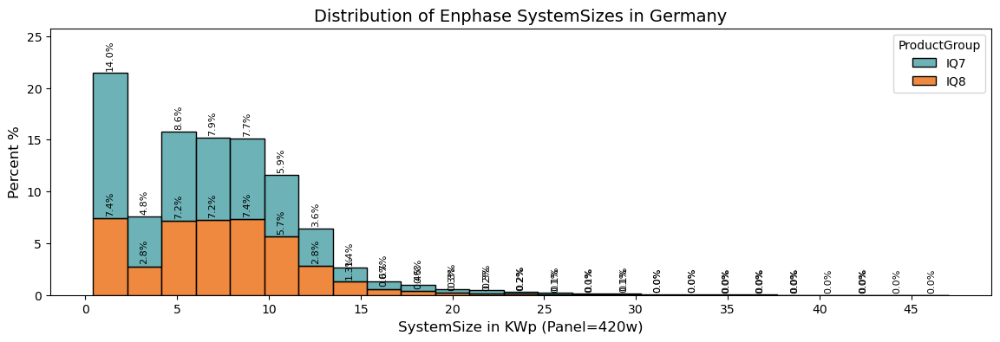

In [194]:
print('Since 2021 we activated {0} systems in Germany.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Germany')

## IC Activation

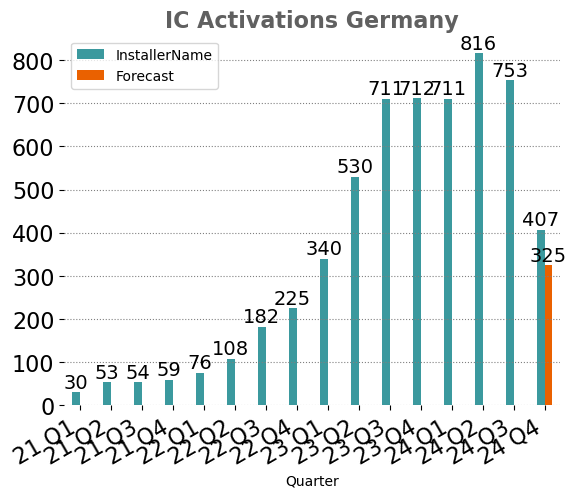

In [195]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Germany", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
193,24-40,2779,"3,900","4,424"
194,24-41,4010,"3,942","4,293"
195,24-42,3751,"3,833","4,186"
196,24-43,4341,"3,720","4,163"
197,24-44,3682,"3,946","4,119"


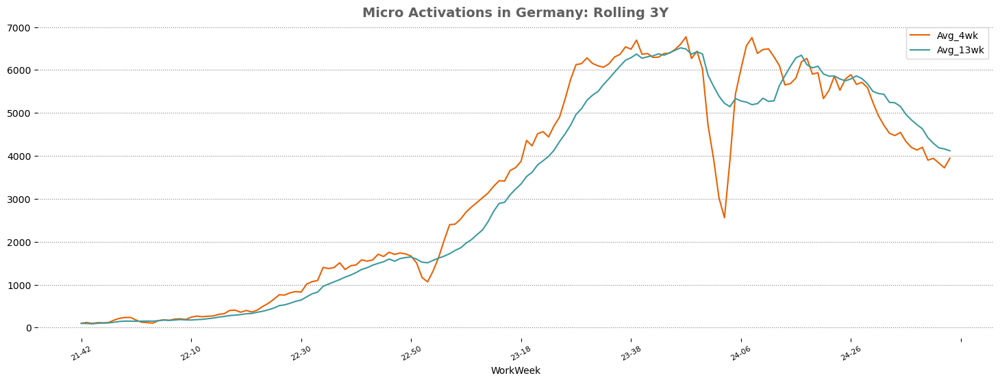

In [196]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Germany: Rolling 3Y", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

In [197]:
# # Enphase Regions:
# MaStR = pd.read_excel("/Users/sroetten/Python/Data/DE_Total_Enph_1K5_Activation.xlsx")
# MaStR.columns = MaStR.columns.str.replace(' ', '')


# ###########################################################################
# ###################       Group for monthly x - axis:   ###################
# ###########################################################################

# dfq['WorkWeek'] = pd.to_datetime(dfq.InvoiceDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
# dfq['Year_Month'] = pd.to_datetime(dfq.InvoiceDate, dayfirst=False).dt.to_period('M').dt.strftime('%y-%m')
# # keepfirst or duplicated averages!
# MaStR = MaStR.merge(dfq, on= 'WorkWeek', how='left')
# MaStR.drop_duplicates(['WorkWeek'], keep='first',  inplace=True)    


# ###########################################################################
# ###################       Group for monthly x - axis:   ###################
# ###########################################################################

# MaStR_group = MaStR.groupby(["Year_Month"]).agg(
#     QuantitySold = ('QuantitySold','sum'),    
#     K5_Activations = ('1K5_Activations','sum'),
#     DEActivations = ('DEActivations', 'sum'),
#     MaStR_TAM  = ('MaStRMWp(<10KWp)','sum')
#      ).reset_index()

# MaStR_group.rename(columns={'MaStR_TAM' : 'MaStR_TAM (MWp)',
#                             'K5_Activations':'1K5°_Activation'}, inplace =True)


# ###########################################################################
# ########### add MaStR data / other data sources manually:  ################
# ###########################################################################

# # MaStR_group['MaStRTAM(Units)'] = [891208.7912087913, 654139.1941391942, 592490.8424908426, 649084.249084249, 477069.59706959716, 459597.06959706964, 608150.1831501832, 501355.31135531137,
# #                                   512014.652014652, 640842.4908424908, 503992.673992674, 496582.41758241755, 611089.5691609978, 476190.4761904762]

# MaStR_group['MaStR_TAM'] = [370, 360, 320, 280, 260, 160, 230, 220, 230, 250, 240, 240, 250, 240]
# MaStR_group['MaStR_TAM_Linear(Units)'] = [880952, 857142.4615, 833332.9231, 809523.3846, 785713.8462, 761904.3077, 738094.7692, 714285.2308, 690475.6923, 666666.1538, 642856.6154, 619047.0769, 595237.5385, 571428]
# df_lagk5['MaStR_TAM_22'] = [140, 200, 180, 160, 140, 90, 300, 220, 320, 250, 300, 300, 280]



# # function (hardcoded!)

# def Act_ST_Graphs(df_lag, header, SIZE, COUNT, METRIC):
#     fig, ax1 = plt.subplots(figsize=SIZE)

#     f1 = sns.lineplot(data = df_lag, x='Year_Month', y='DEActivations', marker='o', label='Activations', sort = False, color='#EA6100', ax=ax1)
#     f1.set_xticklabels(f1.get_xticklabels(),fontsize=22 ,rotation=40, ha="right");
#     f1.set_title(header, fontsize=20)

#     f3 = sns.lineplot(data = df_lag, x='Year_Month', y='1K5°_Activation', marker='o', label='1K5°_Activation', sort = False, color='#541E87', ax=ax1)
#     f3.set_xticklabels(f3.get_xticklabels(),fontsize=22 ,rotation=40, ha="right");
#     f3.set_title(header, fontsize=20)
    
#     plt.yticks(fontsize=14)
#     ax2 = ax1.twinx()
    
#     f4 = sns.lineplot(data = df_lag, x='Year_Month', y='MaStR_TAM (MWp)', marker='o', label='MaStr_Activations (Sys<10kWp)', sort = False, color='#FFD02C', ax=ax2)
#     f4.set_xticklabels(f4.get_xticklabels(),fontsize=22 ,rotation=40, ha="right");
    
#     f2 = sns.barplot(data = df_lag, y=METRIC, x='Year_Month',alpha=0.8, label='QuantitiesSold', color= '#3B999E', ax=ax1)
#     #f2.set_xticklabels(f2.get_xticklabels(),fontsize=22 ,rotation=40, ha="right");
    
#     ax1.set_ylabel('Quantity (Sold & Activated)', fontsize = 18)
#     ax2.set_ylabel('MaStR TAM (MWp)', fontsize = 18)
#     ax1.set_xlabel('Year_Month', fontsize = 18)
    
#     plt.yticks(fontsize=16)

#     sns.move_legend(f1, "upper left", bbox_to_anchor=(.03, .42))
#     sns.move_legend(f4, "upper left", bbox_to_anchor=(.11, .99))
    
#     if COUNT == 1:

#         for p in f4.patches:
#                 left, bottom, width, height = p.get_bbox().bounds
#                 if height != 0.0:
#                         f4.annotate(format(p.get_height(), '.0f'), 
#                        (p.get_x() + p.get_width() / 2., p.get_height()), 
#                         ha = 'center', va = 'center', 
#                         xytext = (0, 9), 
#                         fontsize=12,            
#                         textcoords = 'offset points')
                        
#         for p in f3.patches:
#                 left, bottom, width, height = p.get_bbox().bounds
#                 if height != 0.0:
#                         f3.annotate(format(p.get_height(), '.0f'), 
#                        (p.get_x() + p.get_width() / 2., p.get_height()), 
#                         ha = 'center', va = 'center', 
#                         xytext = (0, 9), 
#                         fontsize=12,            
#                         textcoords = 'offset points')     
        
#         for p in f2.patches:
#                 left, bottom, width, height = p.get_bbox().bounds
#                 if height != 0.0:
#                         f2.annotate(format(p.get_height(), '.0f'), 
#                        (p.get_x() + p.get_width() / 2., p.get_height()), 
#                         ha = 'center', va = 'center', 
#                         xytext = (0, 9), 
#                         fontsize=12,            
#                         textcoords = 'offset points')      
#         for p in f1.patches:
#                 left, bottom, width, height = p.get_bbox().bounds
#                 if height != 0.0:
#                         f1.annotate(format(p.get_height(), '.0f'), 
#                        (p.get_x() + p.get_width() / 2., p.get_height()), 
#                         ha = 'center', va = 'center', 
#                         xytext = (0, 9), 
#                         fontsize=12,            
#                         textcoords = 'offset points') 
#     else:     
#         return df_lag.tail(5)

   
     
# ##### run function:
# Act_ST_Graphs(MaStR_group, 'Incorta Sell-Through vs Activation on Months - Germany', (22,6), 1, "QuantitySold")    




# ###########################################################################
# ############################     2022-2023    #############################
# ###########################################################################


# df_lagk5.rename(columns={'Activations_x' : 'DEActivations',
#                          'Activations_y' : '1K5°_Activation',
#                          'QuantitySold_x' : 'QuantitySold',
#                          'QuantitySold_y' : 'QuantitySold_1K5°'}, inplace =True)
# df_lagk5['MaStR_TAM'] = [140, 200, 180, 160, 140, 90, 300, 220, 320, 250, 300, 300, 280]
# df_lagk5

# Act_ST_Graph(df_lagk5, 'Sell-Through vs Activation on Months 2022 - Germany vs 1K5°', (22,6), 1, "QuantitySold")


# df_lagk5['MaStR_TAM_22'] = [140, 200, 180, 160, 140, 90, 300, 220, 320, 250, 300, 300, 280]

Rolling last 13 weeks intro we activated  4430.0 micros more than we sold to installers.
Some possible explanations:
- We could still be missing the reports to those transactions.
- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).
- We could also have to many transactions flagged as R2R


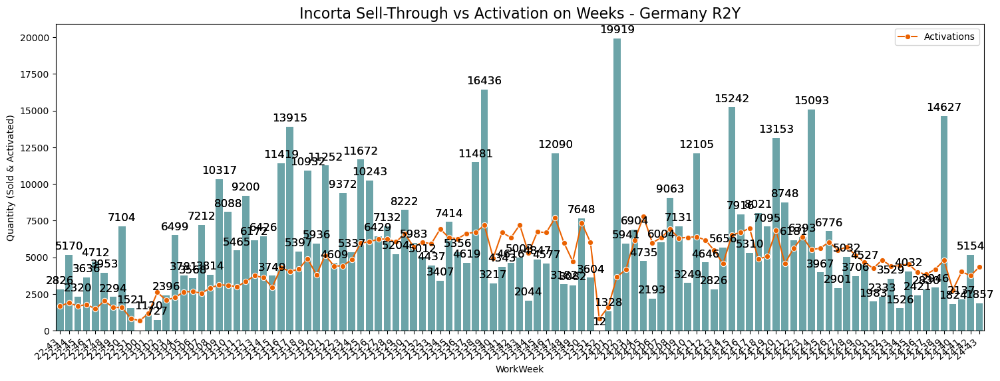

In [198]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

#dfAC = dfA.query("Country == @Country & InvoiceDate > 2023 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
dfAC = dfA.query("Country == @Country & WorkWeek > '21-00' & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()

df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Rolling last 13 weeks intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-13:-1].Gap.sum()))
print('Some possible explanations:')
print('- We could still be missing the reports to those transactions.')
print('- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).')
print('- We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Germany R2Y', (18,6), 1, "QuantitySold")

In [595]:
Country = 'DE'

Since Incorta intro we activated  -11696.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


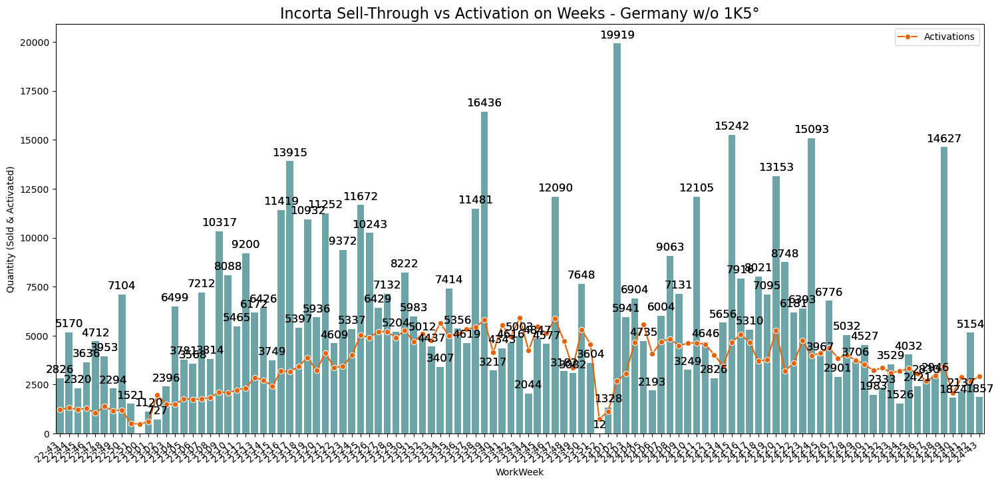

In [598]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW & InstallerName != @K5Names").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Germany w/o 1K5°', (18,8), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,27612,25946
38,24-03,25956,23386
39,24-04,27373,37070
40,24-05,24201,40252
41,24-06,23731,32229
42,24-07,23199,17577
43,24-08,20177,11992
44,24-09,17438,23856
45,24-10,17381,14944
46,24-11,1328,18


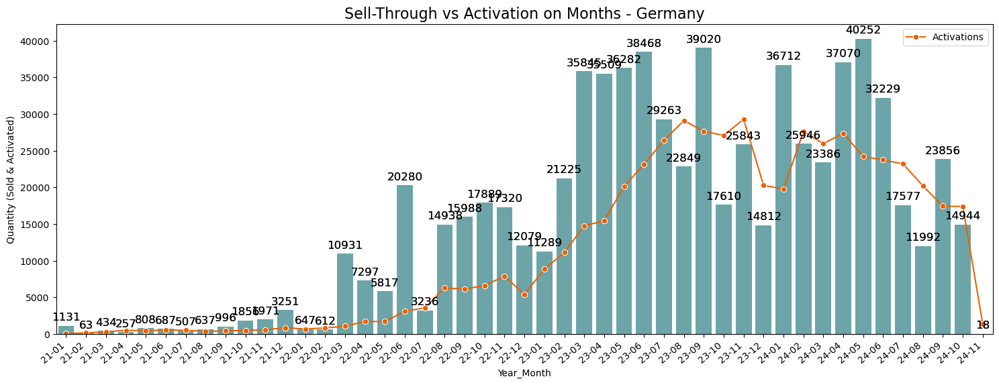

In [199]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Germany', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [200]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(20)

WorkWeek,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,3,"4,522","6,418","6,571","6,817","4,722","4,925","6,779","4,331","5,555","6,270","5,381","5,506","5,847","5,334","5,611","4,922","4,415","4,179","4,728","4,354","4,276","4,383","3,818","3,796","4,090","4,711","2,641","3,939","3,687","4,209","3,566",741,151047
1K5° Hamburg,0,216,205,266,320,246,234,221,161,403,268,241,278,306,217,135,221,138,197,154,156,48,124,175,142,145,152,54,102,257,219,138,61,6200
1K5° Münster,0,258,207,173,318,222,216,174,209,281,262,176,132,355,274,268,160,101,122,272,139,234,178,120,139,173,167,91,122,124,142,199,31,6039
LichtBlick SE,0,191,269,221,404,176,262,247,146,186,271,275,276,410,226,142,207,45,200,163,193,197,185,146,177,145,106,57,50,32,195,54,38,5892
1K5° Göttingen,0,74,209,272,392,140,194,151,141,380,156,196,325,288,214,218,131,133,117,63,223,126,162,219,185,115,241,60,103,94,253,169,24,5768
1K5° Rosenheim,0,137,241,155,305,86,135,175,119,126,157,114,141,146,125,181,104,148,139,155,60,165,113,1,207,183,114,50,222,61,147,24,60,4296
Soly Germany,0,167,148,187,194,235,201,286,295,83,163,174,127,187,156,156,39,37,101,132,134,48,45,78,27,95,74,23,165,52,88,42,0,3939
ESS Kempfle GmbH,0,87,212,141,111,71,178,123,104,124,150,145,90,138,104,133,65,121,80,123,56,0,2,84,142,219,30,37,68,92,121,16,0,3167
1K5° Weimar,0,60,149,90,110,67,55,80,96,106,80,108,30,19,0,60,72,0,97,26,108,121,44,44,97,128,50,49,51,139,74,9,16,2235


##  Germany HEMS Sell Through

In [201]:
dfhems = df.query("ProductType == 'HEMS' & InstallerCountry == @Country")
df_HEMS = dfhems.groupby(["InstallerAccountOwner", "InstallerName"], as_index=False)["QuantitySold"].sum()

#### HEMS Forecasts

In [202]:
#Eligible SAM Sell-Through in Germany:
SAM = list(df.query("ProductType == 'HEMS' & InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)

df_SAM  = dfhems.query("Quarter == @Current")
df_SAM = df_SAM.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum()

# transform KWhr to MWhr:
df_SAM = df_SAM.merge(dff_AOh, on='InstallerAccountOwner', how='left').fillna(0)

#### SAM Forecast:

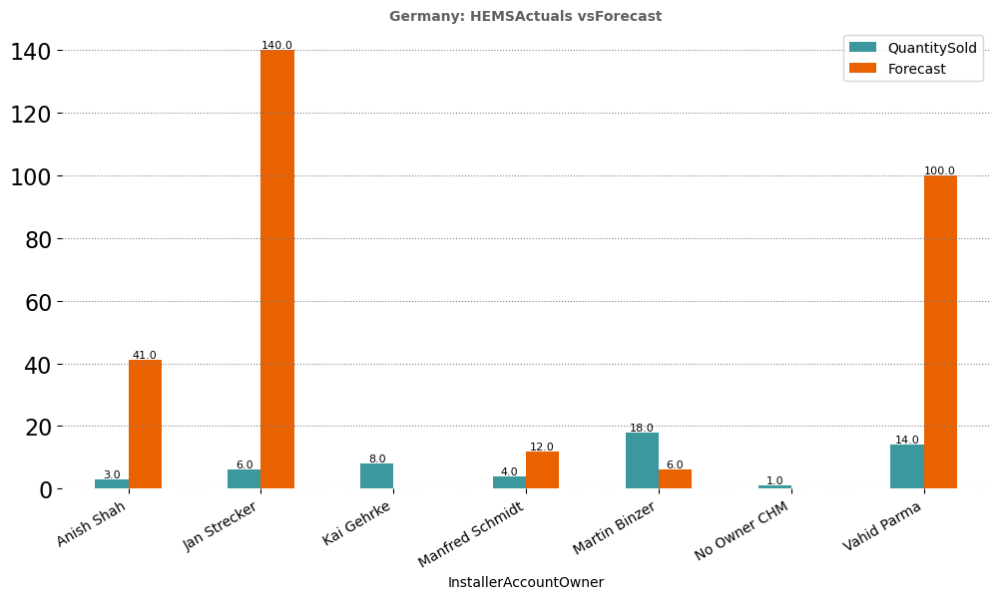

In [203]:
eda.SAM_barchart(df_SAM, 'QuantitySold', "Germany: HEMSActuals vsForecast",(12,6))

#### Product Sell-Out :

In [204]:
Products = ['HEMS-GW-01', 'HEMS-HP-01']
dff_Ph = fcst.Product(df, dff, Country, 'HEMS', Products, [Current])

dff_Ph['Forecast'] = dff_Ph['Forecast']*1000
dff_Ph['QuantitySold'] = dff_Ph['QuantitySold_k']*1000

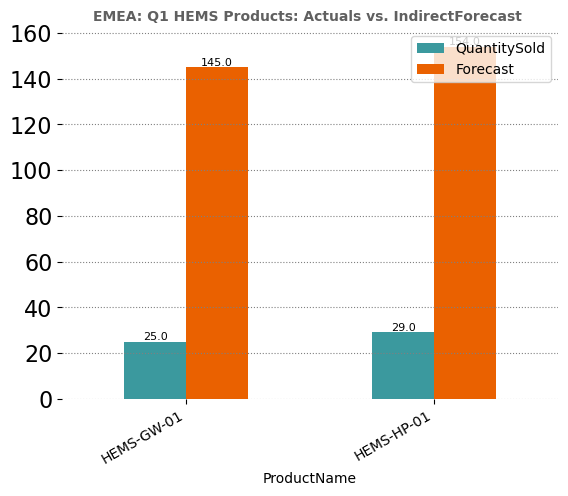

In [205]:
eda.Product_barchart(dff_Ph, 'QuantitySold', "EMEA: Q1 HEMS Products: Actuals vs. IndirectForecast ")

#### Sell-Through vs Forecast quarterly

In [206]:
df_hems = df.query("InstallerCountry == @Country & ProductType == 'HEMS' & Quarter > '23 Q2'")
df_ST = df_hems.groupby(["Quarter"], as_index=False)["QuantitySold"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = dff_Ph.Forecast.sum()

# Installer Count Micro:
df_IC = df_hems.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# Forecast from Indirect
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = 75

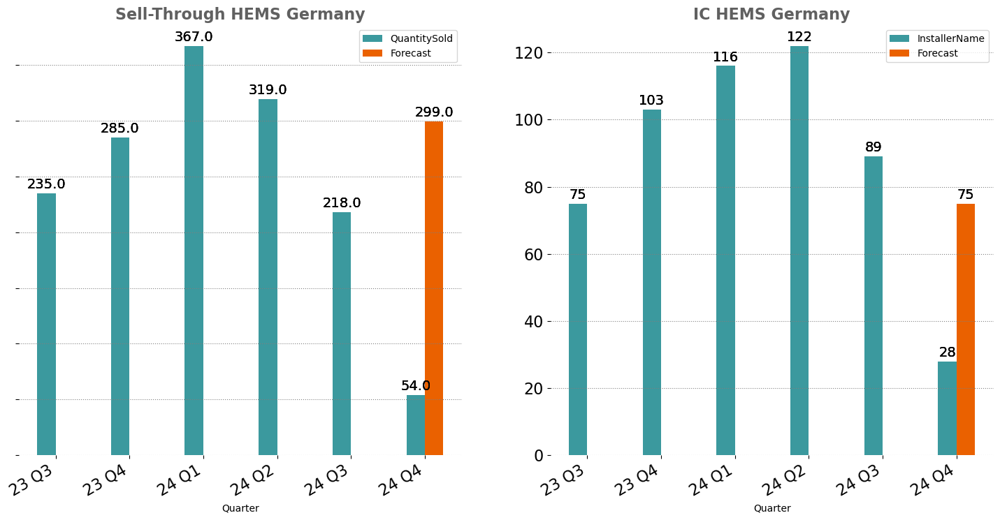

In [207]:
eda.POS2IC(df_ST, df_IC, 'Quarter', 'QuantitySold', 'InstallerName', 
        "Sell-Through HEMS Germany", "IC HEMS Germany")

<a id='Austria'></a>
# 4. Austria

# Austria Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [208]:
Country = 'AT'

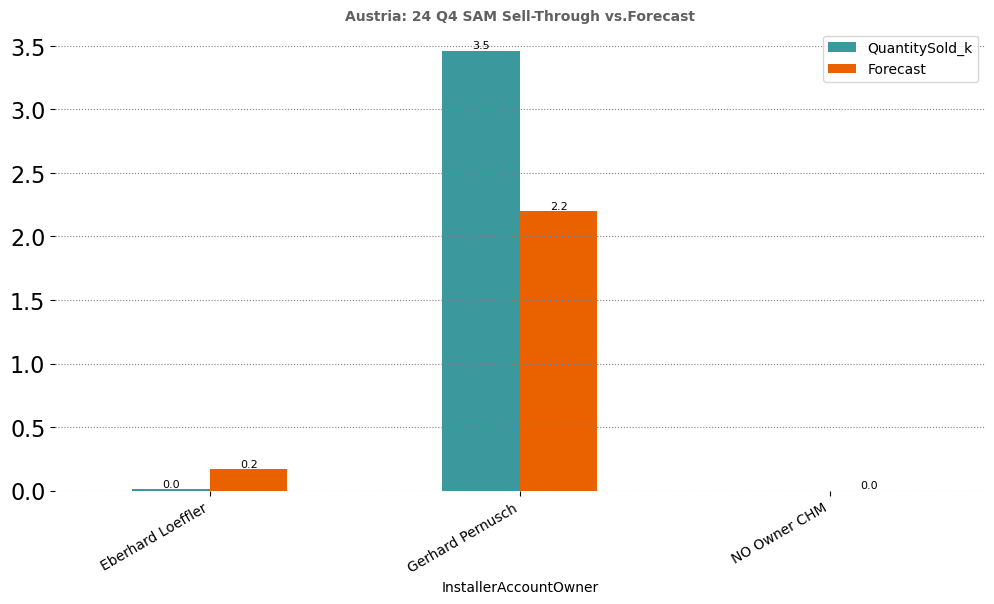

In [209]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Austria: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Austria sold 3.48k micro units.
By today Austria is 2.79k units above/below the quarterly goal.
As a result Austria met 508.58% of its BOQ forecast for the recent quarter.


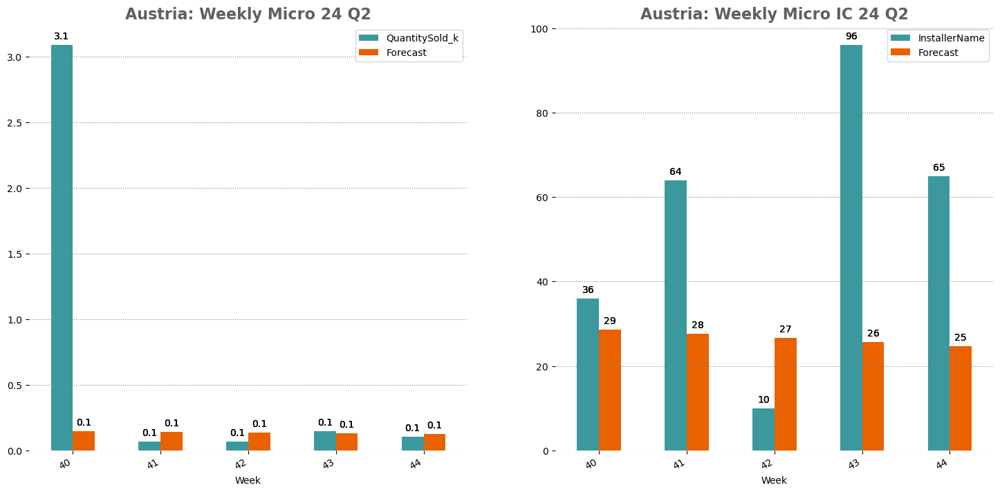

In [210]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Austria: Weekly Micro 24 Q2", "Austria: Weekly Micro IC 24 Q2", orangeteal)
print('By today Austria sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Austria is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Austria met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))


#### Storage:

In [211]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Austria: Weekly Storage 24 Q2", "Austria: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

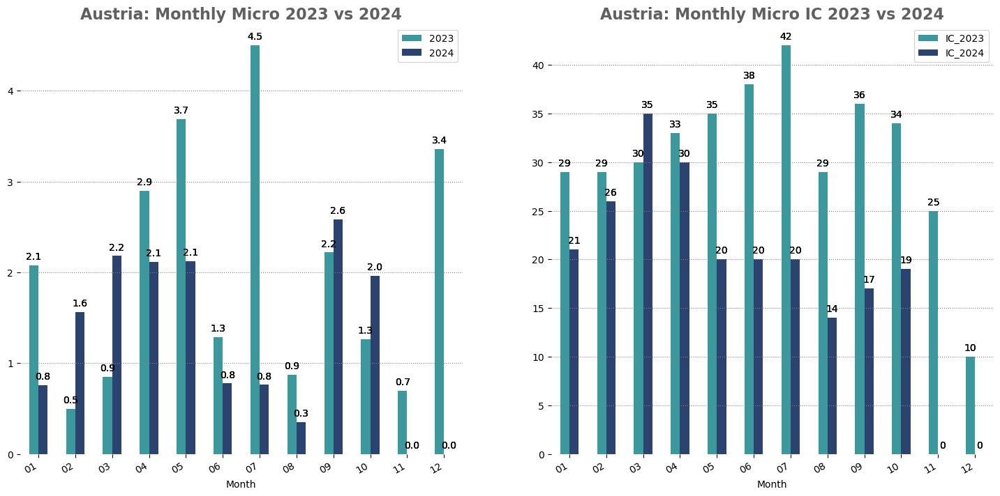

In [212]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Austria: Monthly Micro 2023 vs 2024", "Austria: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

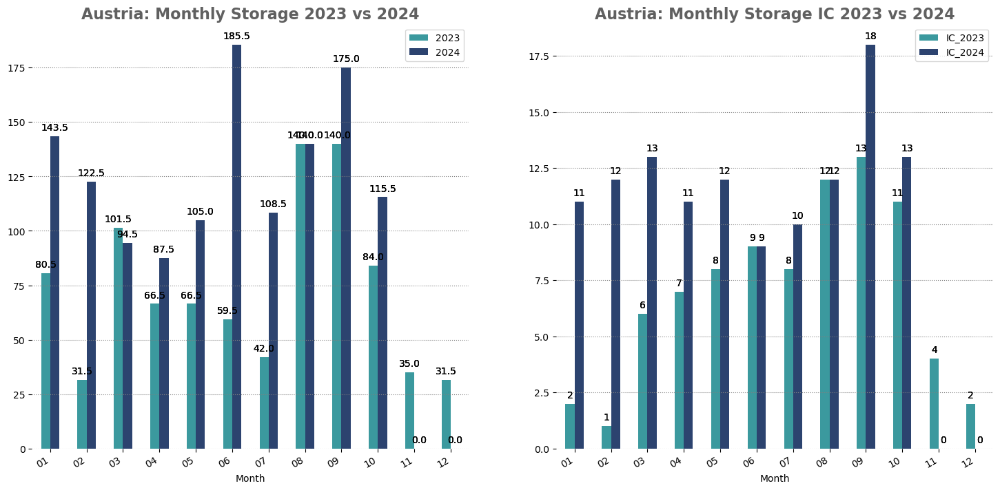

In [213]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Austria: Monthly Storage 2023 vs 2024", "Austria: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

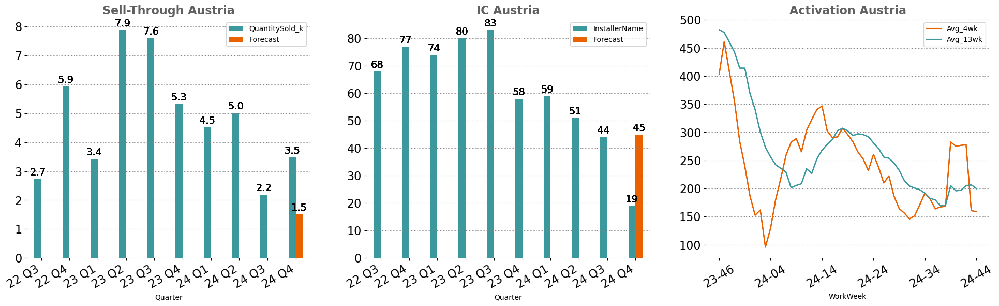

In [214]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Austria", "IC Austria", "Activation Austria")

#### Storage

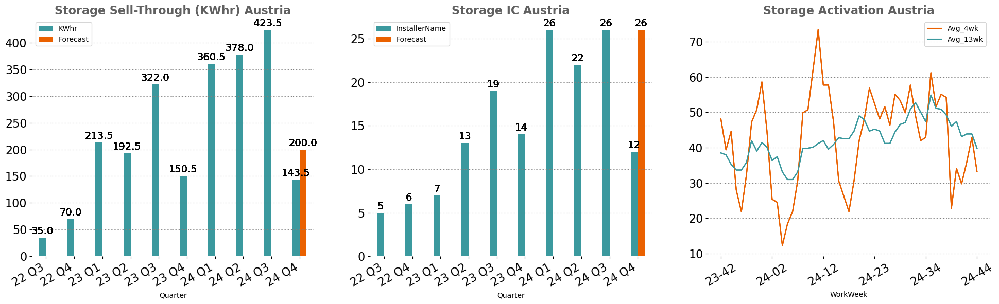

In [215]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Austria", "Storage IC Austria", "Storage Activation Austria")

## Austria Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [216]:
print("20 Biggest Installer Austria (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Austria (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9,AT,Gerhard Pernusch,AF Green Trading GmbH,4932825,1,0,0,0,0,0,0,756,"3,024",0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,780",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
284,AT,Nicolas Levavasseur,Sonepar,3335694,1,0,"4,653","3,576","3,199","2,440","2,629",208,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"5,277",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
283,AT,Gerhard Pernusch,Soly Austria,4698871,2,0,0,0,0,0,0,109,77,0,0,0,0,0,0,46,21,0,0,0,0,0,0,41,85,186,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
27,AT,Gerhard Pernusch,Bau MA Energiesysteme,4676280,1,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100,0,7,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
102,AT,Gerhard Pernusch,Elektrohaus GABRIEL GmbH,2543487,7,162,36,54,54,100,112,90,36,56,10,24,21,0,60,32,32,114,122,253,132,32,89,109,4,338,2,6,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
39,AT,Gerhard Pernusch,Chargewell GmbH,3262508,2,972,756,"1,038",0,126,216,83,113,77,21,0,0,46,38,0,0,0,107,175,26,202,262,74,0,538,10,2,1,166.0%,50,50,50,100,100,100
323,AT,Gerhard Pernusch,energie + licht Payerhofer GmbH,4095896,2,0,0,0,0,0,39,65,0,0,0,0,0,0,0,0,0,0,0,0,0,0,39,65,0,104,1,4,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
213,AT,Gerhard Pernusch,NextGen Energy GmbH,3968988,4,0,0,0,81,4,32,51,0,0,0,0,10,14,18,7,0,0,0,0,26,59,32,16,0,87,1,3,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
136,AT,Gerhard Pernusch,Ferk Elektrotechnik,3574481,2,0,3,0,0,0,0,51,24,0,0,0,0,0,0,32,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,75,1,3,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
294,AT,Gerhard Pernusch,Strombox E-Mobilitäts GmbH,2808197,2,0,34,0,0,0,138,44,38,0,14,0,0,4,0,21,7,1,36,13,0,15,21,77,24,220,2,5,0,inf%,0,0,0,0,0,0


#### Customer Heatmap

In [217]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
AT,All,All,All,859,2081435,1,25616,12087,5606,24-45,102,0,1740,1904,1077,328,1147,1170,1011,235,36,1640,1640,0,1
AT,Solarimpuls erneuerbare Energien GmbH,0,0,70,166667,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
AT,Rhomberg Bau GmbH,0,0,70,166667,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
AT,e2 elektro Gmbh,Gerhard Pernusch,3335693,50,119048,0,138,109,29,24-09,8,0,29,0,0,0,0,0,0,0,0,0,0,0,0
AT,DCC Energy Austria GmbH,Gerhard Pernusch,3574432,30,71429,0,72,72,0,23-19,72,0,0,0,0,0,0,0,0,0,0,0,0,0,0
AT,Energieversorgung Kleinwalsertal,Eberhard Loeffler,4316613,25,59524,0,27,0,27,24-31,25,0,0,0,25,0,38,0,0,0,-100,0,0,0,0
AT,Krone Sonne GmbH,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
AT,Andreas Steiner Systemtechnik GmbH,Gerhard Pernusch,2220155,20,47619,0,48,0,48,24-36,36,-100,0,0,36,0,0,0,0,0,0,0,0,0,0
AT,Solarel GmbH,Gerhard Pernusch,3972815,20,47619,0,130,22,108,24-42,6,225,0,69,33,6,0,11,24,0,999,0,0,0,1
AT,ET-König GmbH,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [218]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Gerhard Pernusch', 'Eberhard Loeffler']
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Austria_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 3091 systems in Austria.


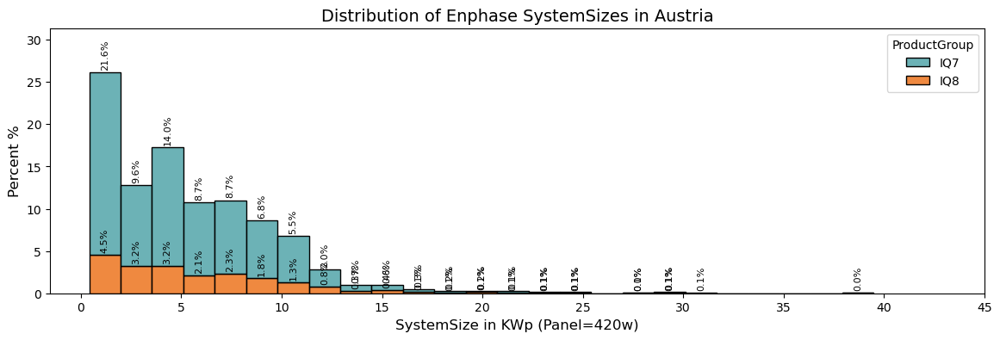

In [219]:
print('Since 2021 we activated {0} systems in Austria.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Austria')

## IC Activation

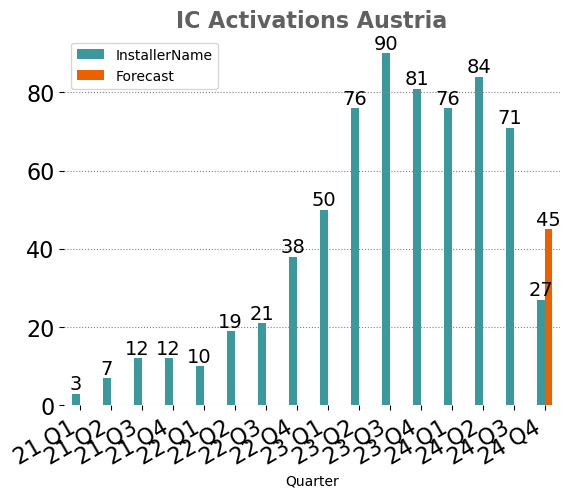

In [220]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Austria", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
182,24-40,106,275,196
183,24-41,197,277,197
184,24-42,208,278,205
185,24-43,132,161,206
186,24-44,98,159,200


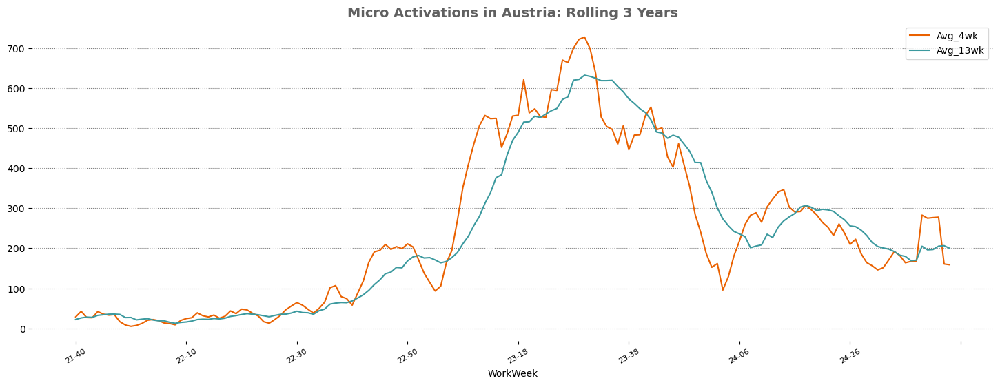

In [221]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Austria: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -2365.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


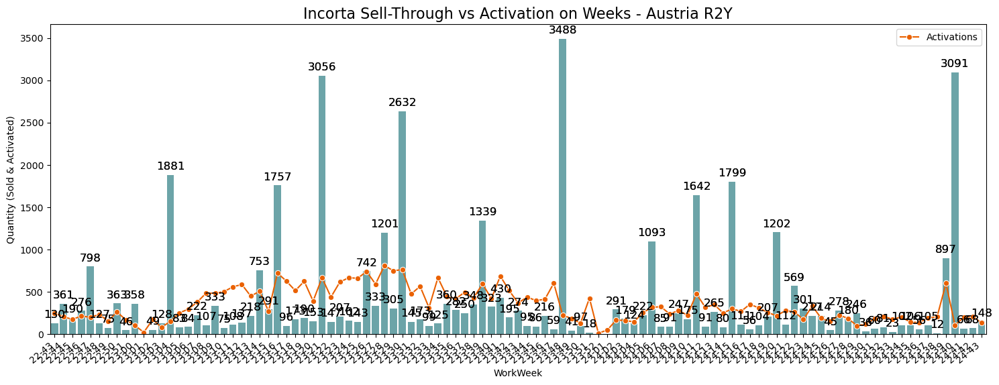

In [222]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Austria R2Y', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,1087,"1,565"
38,24-03,1540,"2,181"
39,24-04,1215,"2,117"
40,24-05,1269,"2,123"
41,24-06,841,777
42,24-07,762,762
43,24-08,773,350
44,24-09,1163,"2,582"
45,24-10,692,"1,963"
46,24-11,23,NaN


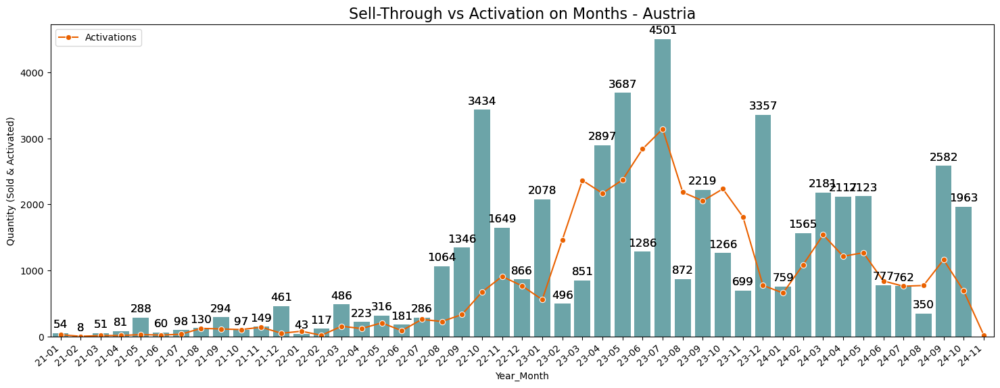

In [223]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Austria', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [224]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(20)

WorkWeek,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,199,299,250,330,305,255,215,278,252,155,327,178,127,206,166,97,102,177,205,175,194,142,126,183,204,593,106,197,186,132,85,6,6452
Plus PV GmbH,0,0,0,0,0,22,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,424,0,0,45,2,0,0,493
Liebert Elektrotechnik GmbH.,0,1,0,60,38,13,0,6,12,22,31,28,0,0,0,20,0,0,0,14,0,17,0,9,42,20,88,0,25,16,0,0,462
Ledermüller Peter,0,29,19,21,79,0,12,15,12,56,0,0,14,0,0,15,44,27,12,50,0,20,0,0,8,0,0,12,0,0,16,0,461
Chargewell GmbH,0,0,7,10,16,0,0,56,69,51,30,0,23,0,14,0,1,0,0,0,0,0,0,0,0,59,0,0,0,0,0,0,336
HalloSonne GmbH,14,12,0,7,0,22,9,36,51,0,0,10,12,35,26,10,0,8,12,0,0,1,0,16,0,0,0,18,0,11,0,0,310
Katzenberger Energie GmbH,0,32,0,17,0,0,0,0,0,2,52,0,20,33,27,0,0,0,0,0,0,0,0,17,0,0,0,23,0,22,0,0,245
Fiegl + Spielberger,0,10,12,0,0,0,17,0,14,0,25,20,0,6,41,0,0,20,0,0,18,0,0,32,0,0,0,0,0,0,0,0,215
Elektrohaus GABRIEL GmbH,0,11,18,10,0,0,13,0,16,3,0,18,0,12,0,0,0,41,13,0,3,0,0,0,40,0,0,0,0,4,0,0,202


<a id='Switzerland'></a>
# 5. Switzerland

# Switzerland Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [225]:
Country = 'CH'

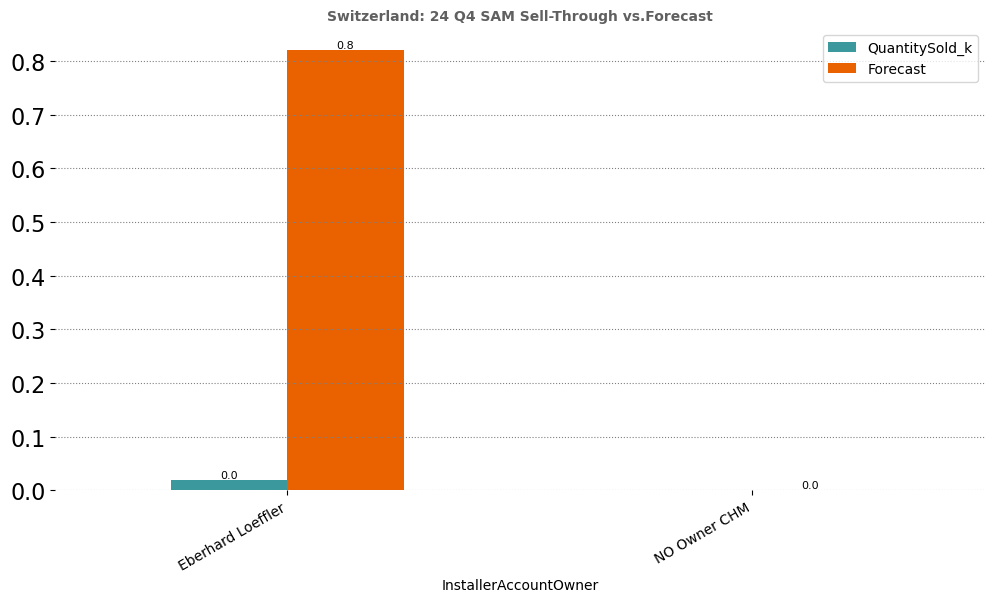

In [226]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Switzerland: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Switzerland sold 1.71k micro units.
By today Switzerland is -1.17k units above/below the quarterly goal.
As a result Switzerland met 59.28% of its BOQ forecast for the recent quarter.


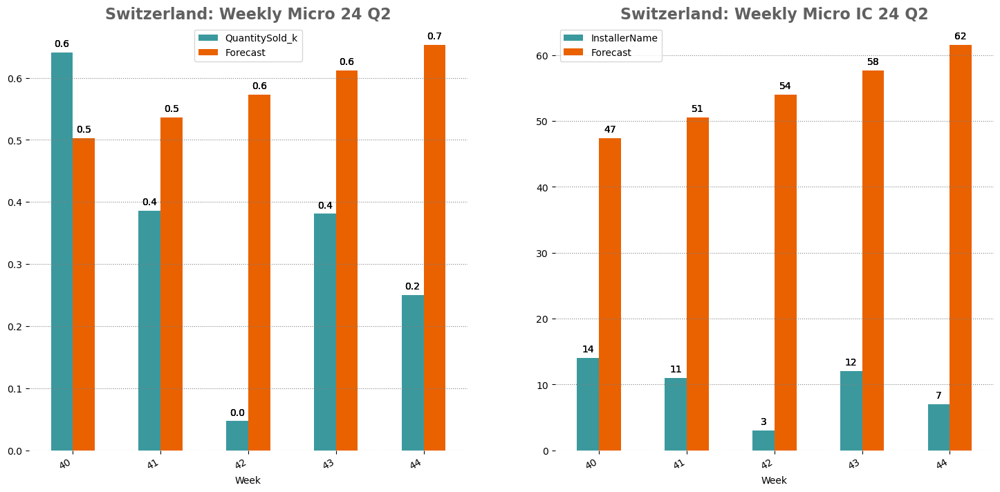

In [227]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Switzerland: Weekly Micro 24 Q2", "Switzerland: Weekly Micro IC 24 Q2", orangeteal)
print('By today Switzerland sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Switzerland is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Switzerland met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))


#### Storage:

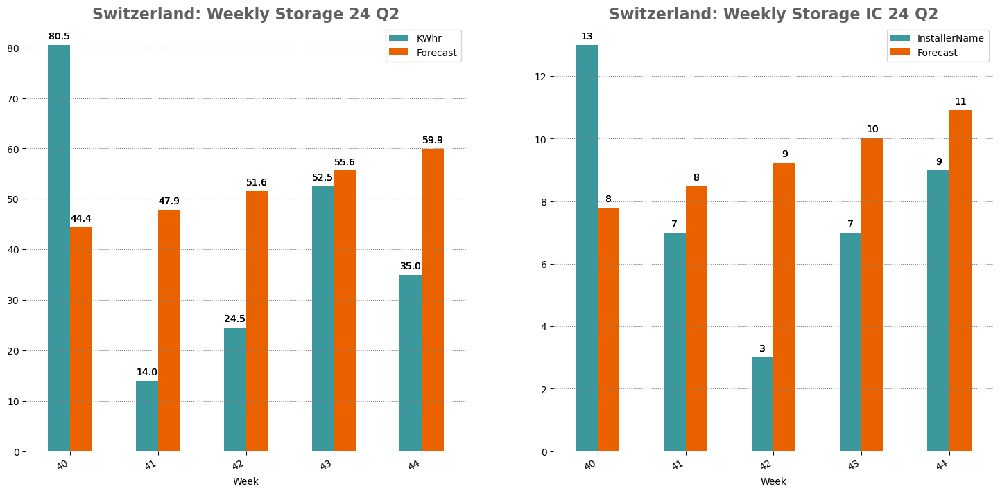

In [228]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Switzerland: Weekly Storage 24 Q2", "Switzerland: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

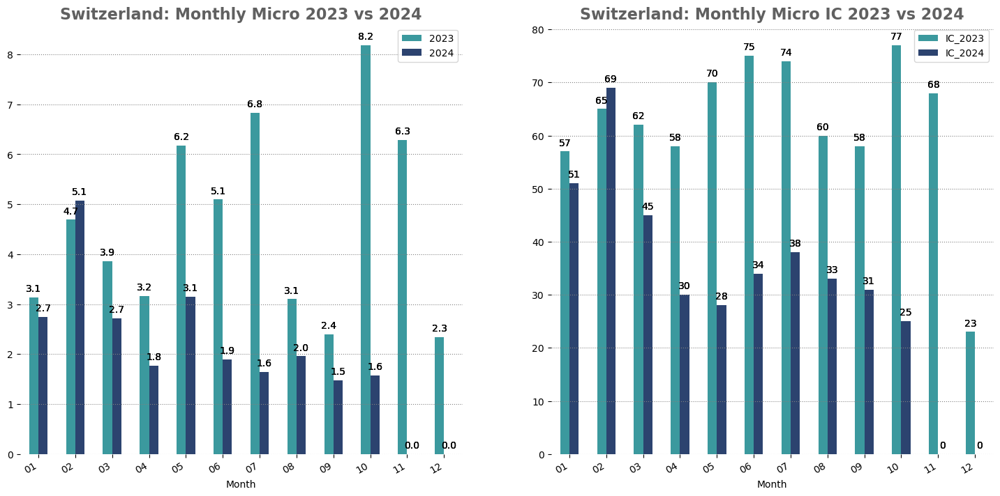

In [229]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Switzerland: Monthly Micro 2023 vs 2024", "Switzerland: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

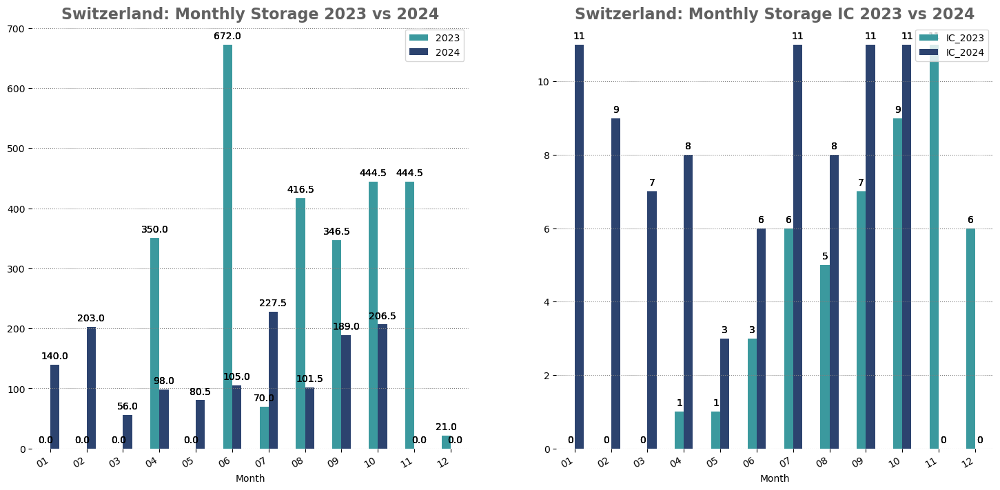

In [230]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Switzerland: Monthly Storage 2023 vs 2024", "Switzerland: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

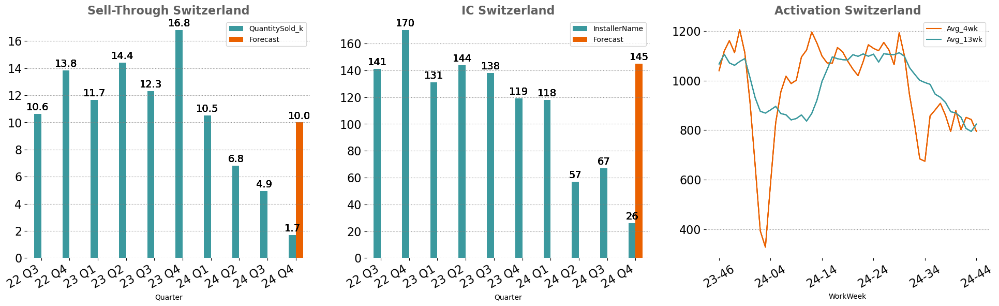

In [231]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Switzerland", "IC Switzerland", "Activation Switzerland")

#### Storage

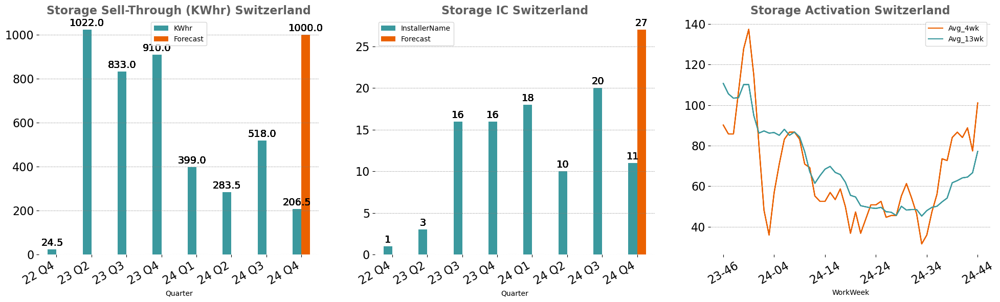

In [232]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Switzerland", "Storage IC Switzerland", "Storage Activation Switzerland")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [233]:
print("20 Biggest Installer Switzerland (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Switzerland (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
2025,CH,Maaty Bouanane,Photosun,463717,2,"3,005","2,992","1,346","3,160","1,342",880,984,106,0,0,0,0,0,0,0,14,"3,181","2,847","1,562","1,449","1,278","1,201","1,262",476,"3,312",4,31,0,inf%,0,0,0,0,0,0
1932,CH,Maaty Bouanane,Hélios Energies SA,426831,2,0,0,0,160,596,0,486,234,0,0,0,0,0,0,0,0,639,"1,399","1,160","1,272","1,450","1,549",951,495,"1,316",2,27,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1930,CH,Maaty Bouanane,Home Performance SA,2772804,3,154,138,238,207,260,400,450,162,0,0,28,66,88,182,70,42,80,187,123,279,303,270,409,171,"1,272",NaN,0,0,inf%,0,0,0,0,0,0
1722,CH,Maaty Bouanane,AbelArti Groupe SA,4748249,1,0,0,0,0,0,0,401,226,0,0,0,0,0,0,98,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,627,NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1967,CH,Maaty Bouanane,La Maison des Energies SA,1594449,3,0,300,396,0,126,0,200,10,0,0,0,0,0,0,0,0,553,850,652,660,711,751,413,134,336,2,5,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
2147,CH,Maaty Bouanane,Technic Home SARL,1728431,2,250,328,769,"1,226",802,684,184,0,0,35,35,0,0,0,154,0,261,704,777,879,698,886,458,156,"1,670",NaN,0,0,10.51%,"1,750",250,250,250,250,250
2093,CH,Bruno Marinheiro,SWISS TECHNIK GROUP,4410223,1,445,574,338,396,178,222,183,78,0,0,0,0,0,0,10,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,661,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1990,CH,Maaty Bouanane,MY SOLAR BATTERY SNC,2676015,1,0,0,0,0,71,126,166,145,0,0,0,0,0,0,0,0,154,255,240,183,215,239,126,59,508,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1939,CH,Bruno Marinheiro,INFINICON GMBH,4410257,3,575,380,15,0,78,116,129,4,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,327,NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
2060,CH,Maaty Bouanane,SCENERGY SA,2810890,3,38,21,131,150,231,273,126,52,0,0,0,0,4,0,10,0,36,18,48,169,195,217,86,26,682,NaN,0,0,inf%,0,0,0,0,0,0


#### Customer Heatmap

In [234]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
CH,All,All,All,100,261420,75,57273,32988,11111,24-45,65,8,3872,1619,1789,435,2973,3356,2805,1054,101,3900,3900,0,1
CH,SHB Grosshandel AG,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
CH,Homsphere SA,0,0,15,35714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
CH,Helion Energy AG,Maaty Bouanane,191786,10,23810,0,36,0,36,24-24,36,0,0,36,0,0,0,5,13,0,999,0,0,0,0
CH,CKW Solartechnik,Eberhard Loeffler,2727912,6,14286,0,8,5,3,24-23,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0
CH,Planeco GmbH,0,1974227,5,11905,0,2,0,2,24-43,2,225,0,0,0,0,0,0,0,0,0,0,0,0,0
CH,Photosun,Maaty Bouanane,463717,4,9286,41,18612,10603,3324,24-43,54,-65,1342,880,984,106,639,600,631,238,-6,0,0,0,0
CH,STG-ENERGY,0,0,4,8333,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
CH,ABC Solar Sàrl,Maaty Bouanane,78489,3,6190,16,14059,8908,860,24-08,756,0,756,0,0,0,460,524,560,194,14,2700,2700,0,0
CH,Solstis SA,Maaty Bouanane,63929,3,7143,3,1052,579,208,24-44,18,225,51,0,0,0,83,50,217,26,-40,600,600,0,0


In [235]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [236]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Bruno Marinheiro', 'Eberhard Loeffler', 'Hannes Peters']
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Switzerland_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 12196 systems in Switzerland.


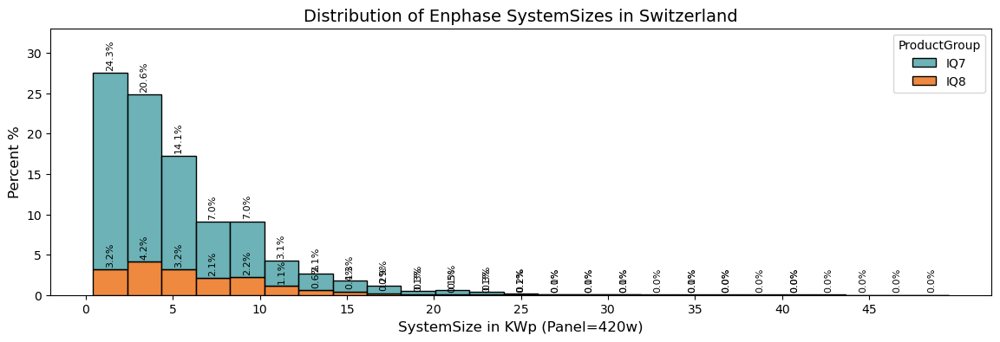

In [237]:
print('Since 2021 we activated {0} systems in Switzerland.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Switzerland')

## IC Activation

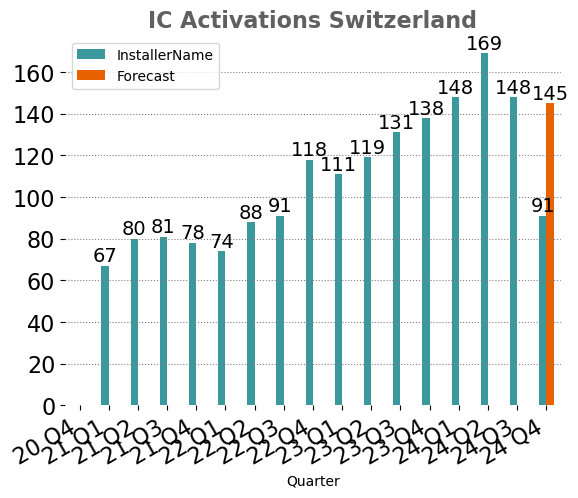

In [238]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Switzerland", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,924,879,869
197,24-41,744,802,852
198,24-42,911,851,806
199,24-43,792,843,795
200,24-44,732,795,824


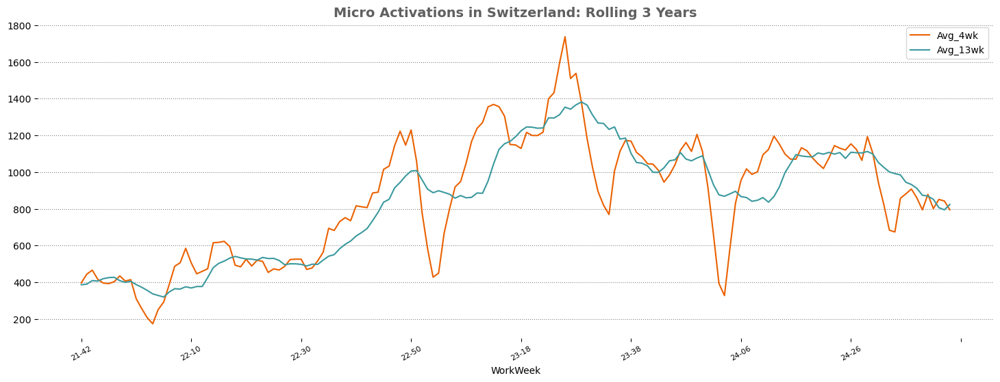

In [239]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Switzerland: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  4570.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


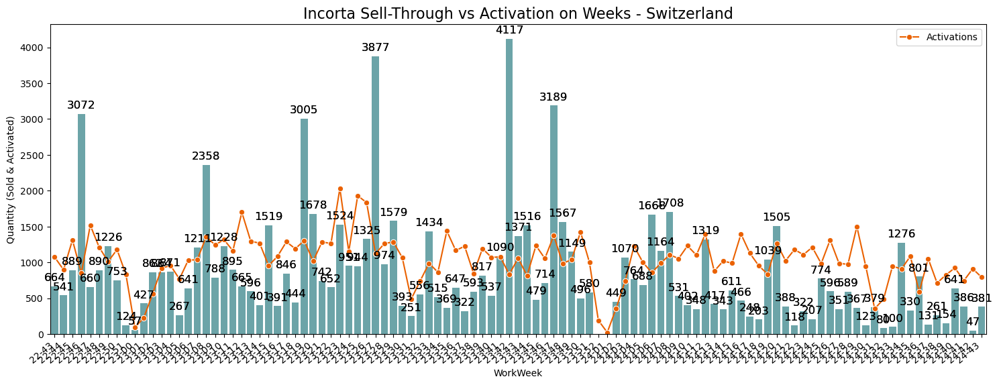

In [240]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Switzerland', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,4356,"5,069"
38,24-03,4742,"2,714"
39,24-04,4944,"1,773"
40,24-05,4706,"3,148"
41,24-06,4755,"1,899"
42,24-07,4714,"1,639"
43,24-08,3472,"1,956"
44,24-09,3358,"1,476"
45,24-10,3832,"1,576"
46,24-11,219,NaN


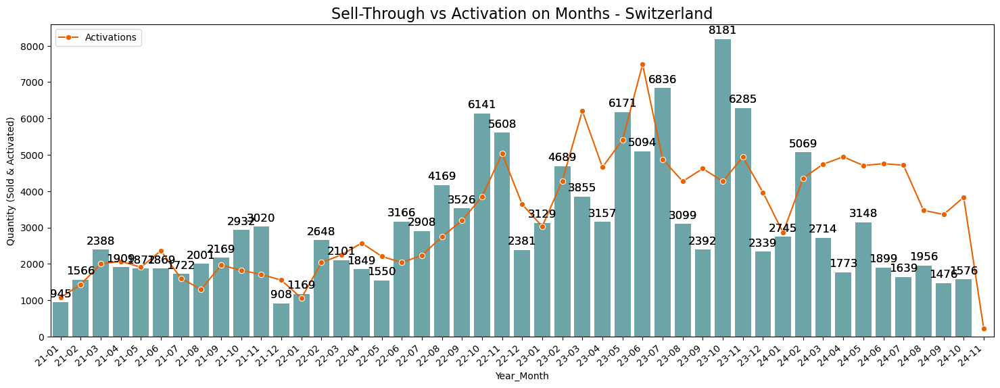

In [241]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Switzerland', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [242]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,1,"1,005",948,"1,344","1,125",951,801,"1,211",983,"1,172","1,083","1,178",976,"1,306",949,956,"1,453",940,352,470,896,887,"1,050",581,"1,051",707,824,870,725,902,790,731,128,29346
Hélios Energies SA,0,283,104,92,126,113,84,65,142,115,169,38,115,103,88,64,102,20,38,87,13,37,323,0,103,53,16,70,94,101,116,97,0,2971
Photosun,0,106,118,131,124,113,89,110,125,104,66,93,0,22,207,170,180,70,0,0,74,73,80,102,135,102,69,137,117,95,71,52,4,2939
ABC Solar Sàrl,0,52,112,45,63,132,101,46,83,52,65,73,141,83,89,65,84,91,74,59,32,184,105,62,84,42,150,76,77,82,59,75,20,2558
Technic Home SARL,0,79,71,109,47,116,48,104,40,26,114,33,21,78,21,16,46,36,1,0,53,34,61,34,54,13,89,10,25,35,57,0,29,1500
La Maison des Energies SA,0,16,47,74,87,51,24,93,24,42,62,77,108,46,44,20,55,26,0,0,0,44,12,23,55,74,60,45,0,50,27,12,0,1298
Home Performance SA,0,0,10,0,42,39,30,49,7,12,16,0,54,11,18,22,20,70,10,10,0,10,46,18,46,41,98,26,48,17,46,34,0,850
Sunkraft SA,0,37,22,19,2,0,0,12,5,22,25,0,1,103,0,57,4,22,0,0,0,35,43,66,28,34,24,28,18,35,38,0,18,698
Swiss Green Solutions AG,0,0,62,0,14,0,0,29,32,0,0,110,21,115,0,0,203,22,0,0,0,56,0,0,0,0,0,0,0,0,0,0,1,665


<a id='Netherlands'></a>
# 6. Netherlands

# Netherlands Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [243]:
Country = 'NL'

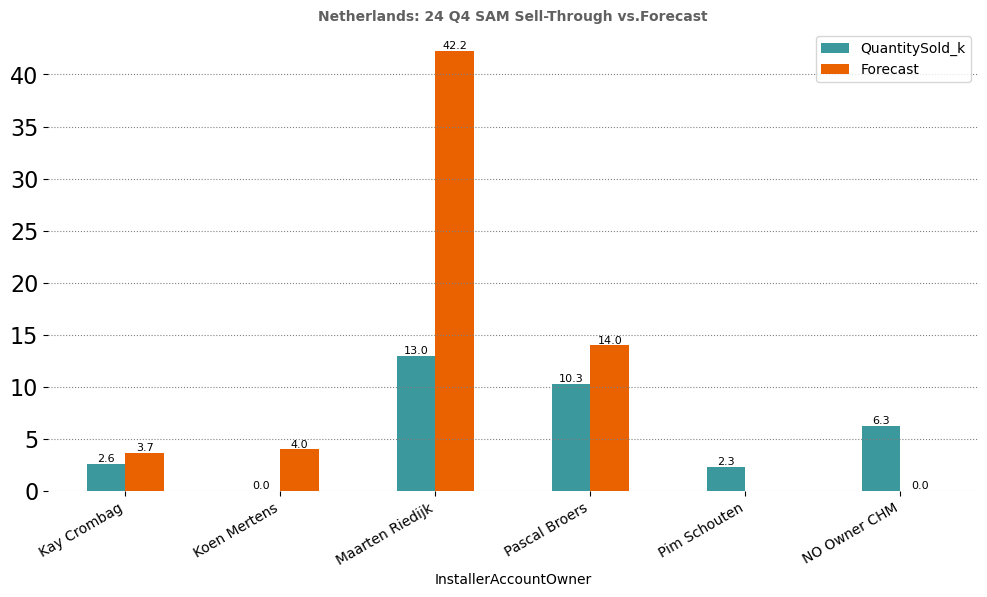

In [244]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Netherlands: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today NL sold 34.59k micro units.
By today NL is -2.68k units above/below the quarterly goal.
As a result NL met 92.81% of its BOQ forecast for the recent quarter.


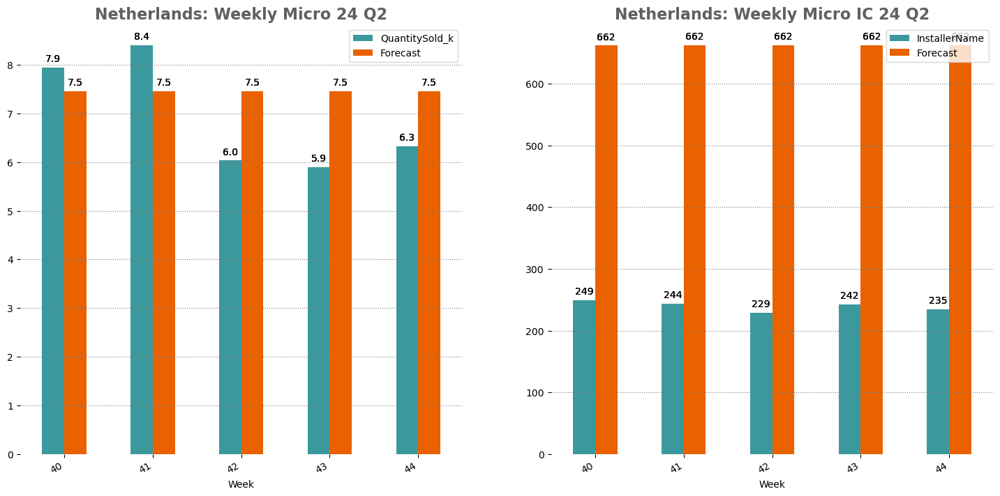

In [245]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Netherlands: Weekly Micro 24 Q2", "Netherlands: Weekly Micro IC 24 Q2", orangeteal)
print('By today NL sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today NL is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result NL met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))


#### Storage:

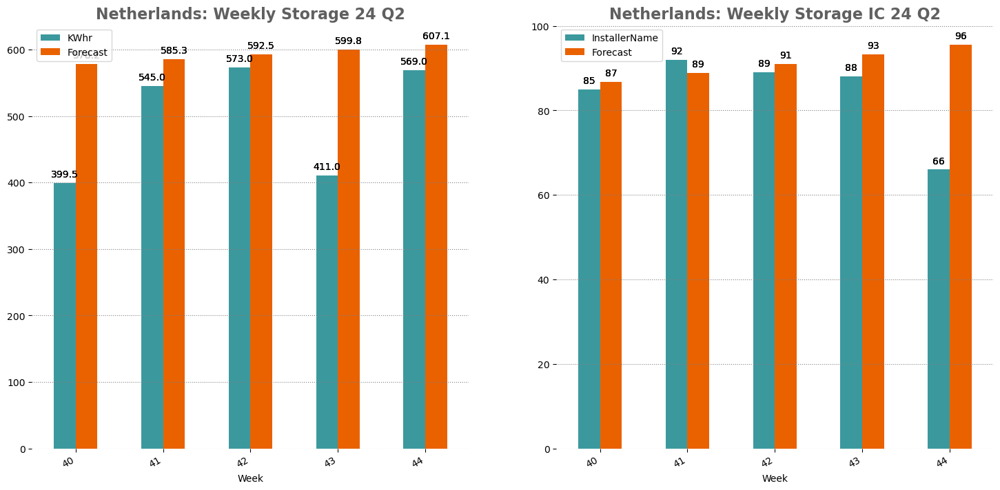

In [246]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Netherlands: Weekly Storage 24 Q2", "Netherlands: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

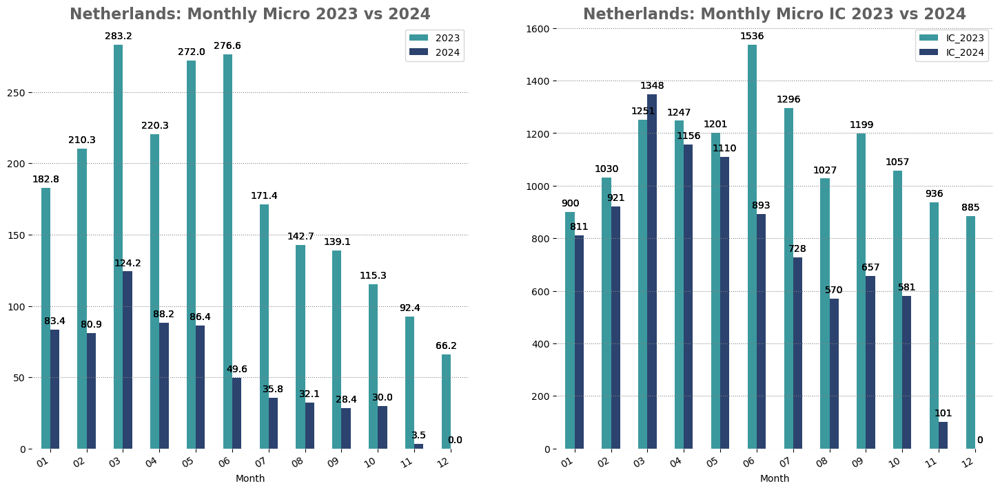

In [247]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Netherlands: Monthly Micro 2023 vs 2024", "Netherlands: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

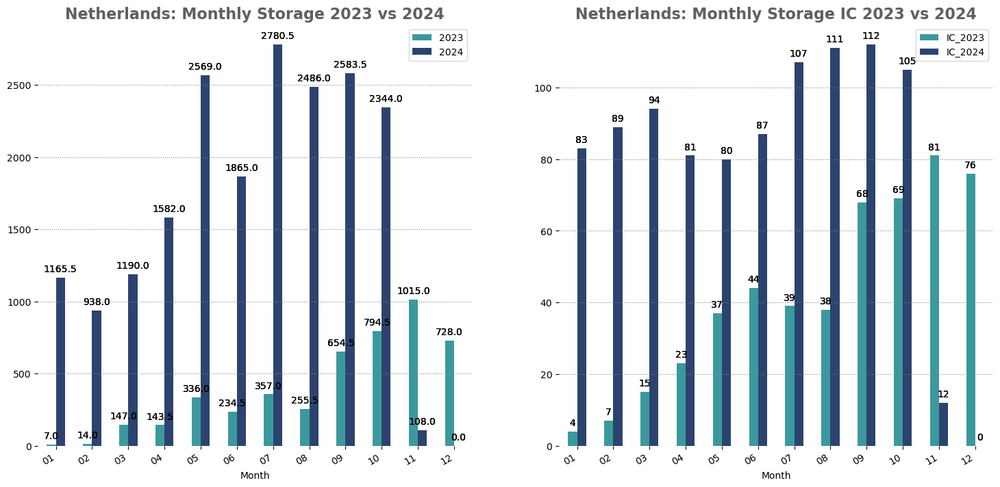

In [248]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Netherlands: Monthly Storage 2023 vs 2024", "Netherlands: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

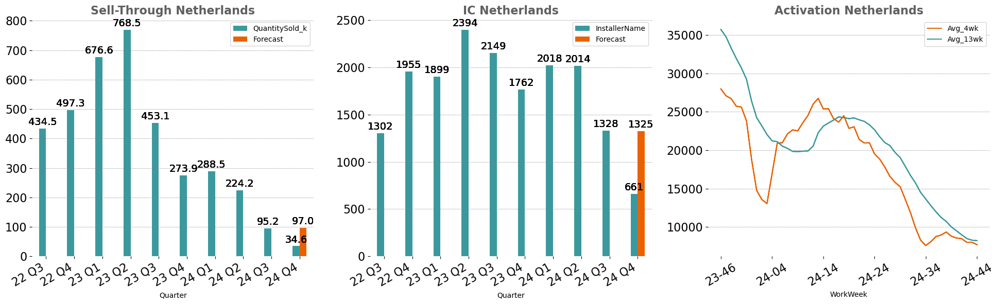

In [249]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Netherlands", "IC Netherlands", "Activation Netherlands")

#### Storage

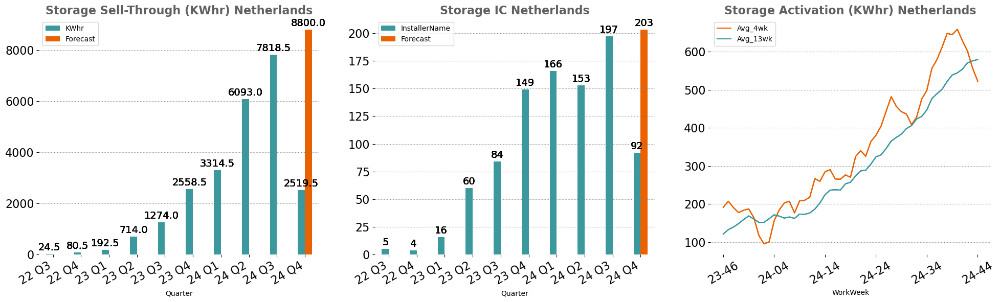

In [250]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Netherlands", "Storage IC Netherlands", "Storage Activation (KWhr) Netherlands")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [251]:
print("20 Biggest Installer Netherlands (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Netherlands (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
15558,NL,Maarten Riedijk,Solar Concept BV,791366,8,"27,355","33,272","14,382","11,340","7,830","5,562","8,352",0,0,0,0,0,147,91,264,196,"21,504","28,340","19,175","10,600","6,501","7,031","3,594","1,074","21,744",29,27,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
14158,NL,Pascal Broers,Energiewonen,110336,2,"6,822","7,290","4,968","7,110","1,638",108,"3,768",0,0,0,0,0,0,0,0,0,16,0,0,0,0,0,0,0,"5,514",26,8,0,188.4%,"2,000","2,500","3,000","3,000","3,000","3,000"
15849,NL,Maarten Riedijk,Team Wattco.nl,55629,4,"6,780","3,492","3,510","1,344","2,796","1,541","3,024",756,0,0,0,0,0,10,32,0,"3,217","4,399","3,313","2,009","1,661","1,361",868,143,"8,117",3,98,0,504.0%,600,600,600,600,600,600
12391,NL,NaN,41993272,0,NaN,0,0,0,0,0,0,"2,340",0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,340",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16351,NL,Pim Schouten,Zonnepaneel Kampioen,4588129,2,0,0,0,0,0,"1,224","1,890",0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,114",5,23,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
12212,NL,NaN,41985501,0,NaN,0,0,0,0,0,"1,692","1,572",0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,264",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
15651,NL,Maarten Riedijk,Solarite.nl,2740374,6,"4,302","11,682","3,780","5,814","2,650","2,268","1,530",360,0,0,0,0,0,0,57,112,"4,235","8,070","7,727","5,747","2,285","2,271","1,725",552,"6,808",5,49,1,87.43%,"1,750","2,000","2,500","2,500","2,500","2,500"
13567,NL,Maarten Riedijk,BeSolar,1547266,6,0,"5,923","8,272","2,165","3,510","2,412","1,368",162,0,0,0,0,0,0,0,0,"7,548","9,745","7,905","3,019","2,959","2,705","1,259",380,"7,452",7,39,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
15485,NL,Pascal Broers,Samenstromen,1730926,19,"2,103","1,491","1,350",524,"1,099","1,674","1,301",230,0,0,0,0,0,0,116,20,"2,125","2,326","1,721","1,486","1,453","1,529",594,101,"4,304",8,18,1,inf%,0,0,0,0,0,0
14875,NL,Maarten Riedijk,Lumex Zon BV,2667750,6,"5,184","5,364",990,702,"2,200","2,274","1,260",324,0,0,0,0,0,0,0,0,"4,755","3,425","1,957",906,"1,493","1,925","1,435",367,"6,058",2,88,1,157.5%,800,"1,000","1,250","1,000","1,000","1,000"


#### Customer Heatmap

In [252]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Maarten Riedijk', 'Pascal Broers', 'Kay Crombag', 'Koen Mertens']
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Netherlands_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

In [253]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
NL,All,All,All,1391,3555876,33,1999037,1058230,367292,24-45,2573,-2,160258,124333,57964,13917,92441,83662,38771,11847,54,36548,36548,0,1
NL,Zonneplan b.v.,Pascal Broers,1508469,130,309524,0,12,12,0,23-40,12,0,0,0,0,0,0,0,0,0,0,0,0,0,0
NL,Solar Concept BV,Maarten Riedijk,791366,29,69048,37,146650,86350,21951,24-35,6804,-100,7830,5562,8352,0,3250,3516,1797,537,8,0,0,0,0
NL,Energiewonen,Pascal Broers,110336,26,61905,10,41989,26190,5514,24-38,144,-100,1638,108,3768,0,0,0,0,0,0,2000,2000,0,0
NL,VDK Groep,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
NL,Nieuwe Installaties,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
NL,Zonnemarkt,Pascal Broers,575348,20,47619,26,72661,31514,10595,24-20,2268,0,1520,9072,0,0,96,88,58,46,-8,100,100,0,0
NL,Greenchoice,Maarten Riedijk,597641,18,42857,2,37057,23778,630,24-13,414,0,630,0,0,0,782,574,206,25,-27,0,0,0,0
NL,Saman Groep B.V.,Maarten Riedijk,1304531,18,42857,19,7863,0,7137,24-44,18,19,2890,4585,909,263,1780,1581,905,262,-11,7500,7500,0,1
NL,Koolen Industries Solar,Pascal Broers,1831036,16,38095,9,38585,23119,3100,24-20,72,0,2376,702,0,0,0,0,0,0,0,0,0,0,0


In [254]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 494666 systems in Netherlands.


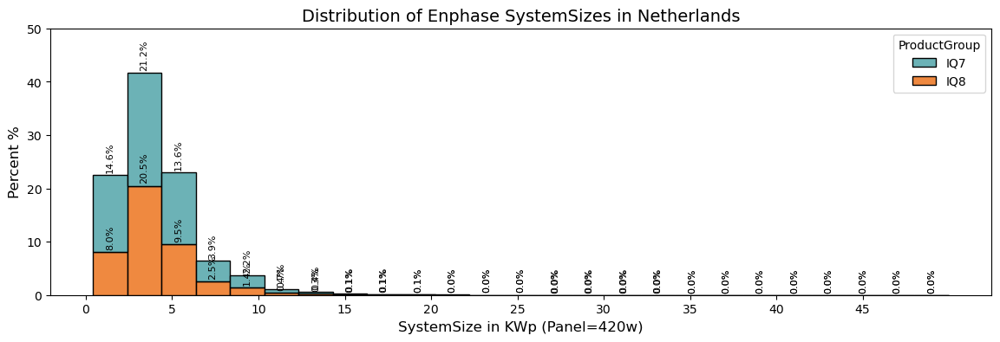

In [255]:
print('Since 2021 we activated {0} systems in Netherlands.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Netherlands')

## IC Activation

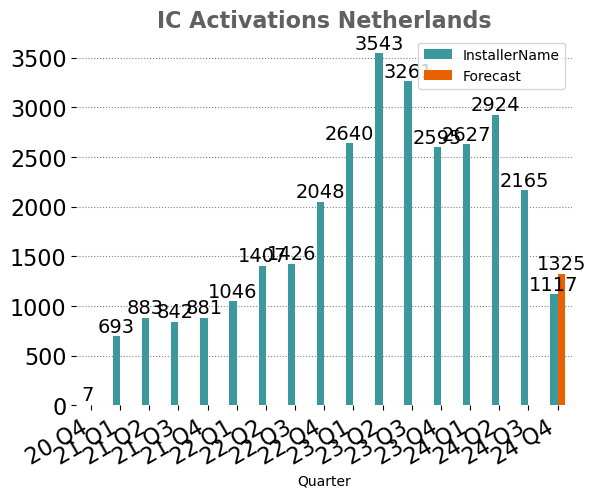

In [256]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Netherlands", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,8457,"8,564","9,502"
197,24-41,7981,"8,477","8,984"
198,24-42,7662,"8,003","8,496"
199,24-43,7930,"8,008","8,281"
200,24-44,7221,"7,698","8,211"


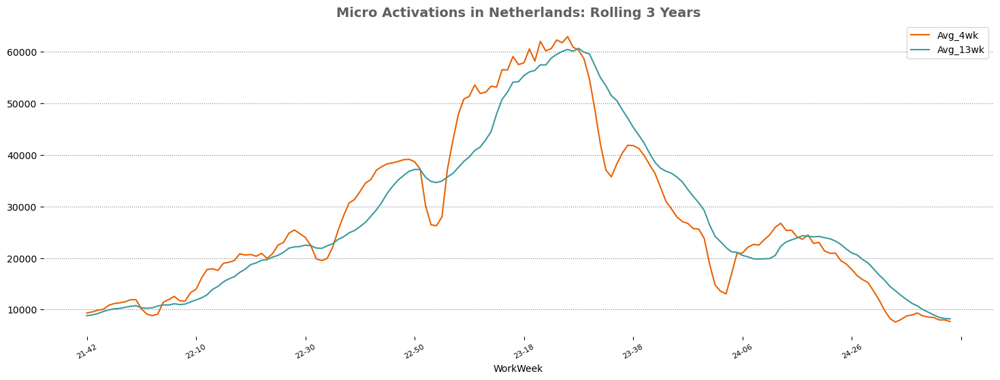

In [257]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Netherlands: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  10505.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


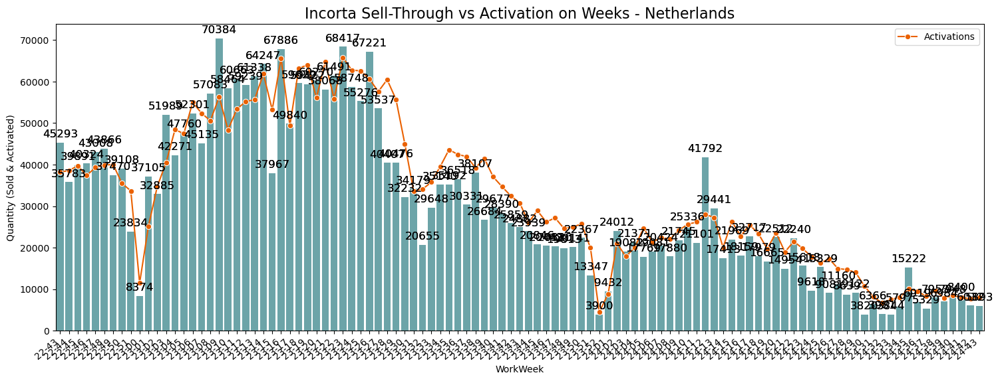

In [258]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Netherlands', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,94664,80911
38,24-03,113593,124197
39,24-04,103049,88205
40,24-05,97478,86403
41,24-06,72347,49646
42,24-07,58820,35801
43,24-08,35911,32150
44,24-09,36792,28364
45,24-10,35741,29952
46,24-11,3084,3464


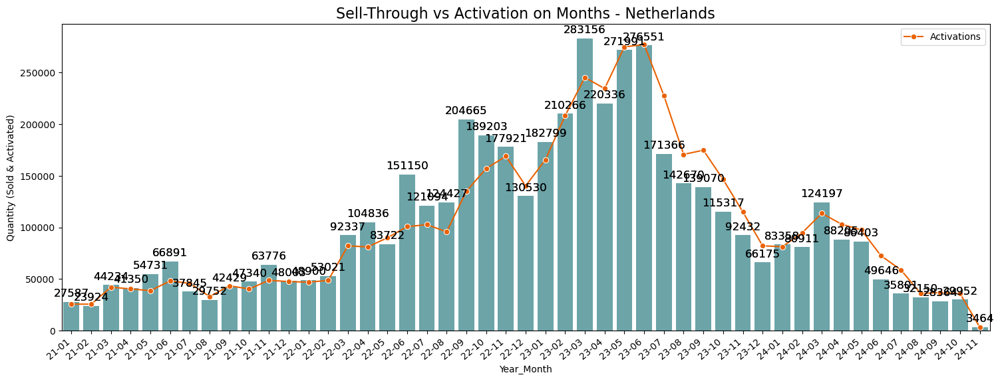

In [259]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Netherlands', 'Year_Month', orange)

In [260]:
Country = 'NL'

### Top 20 Activation on InstallerNames:

In [261]:
InstallerActivation = dfA.query("Quarter >'23 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,23-13,23-14,23-15,23-16,23-17,23-18,23-19,23-20,23-21,23-22,23-23,23-24,23-25,23-26,23-27,23-28,23-29,23-30,23-31,23-32,23-33,23-34,23-35,23-36,23-37,23-38,23-39,23-40,23-41,23-42,23-43,23-44,23-45,23-46,23-47,23-48,23-49,23-50,23-51,23-52,24-01,24-02,24-03,24-04,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,907,"59,583","51,362","63,968","47,741","61,093","62,260","54,117","62,853","54,011","64,002","60,938","60,964","59,017","55,974","58,969","54,223","43,660","32,580","32,816","34,626","38,440","42,652","41,515","40,752","38,263","40,428","36,287","33,866","31,638","30,093","25,663","28,490","25,748","26,670","24,200","24,584","25,275","19,589","3,992","8,479","20,520","17,595","19,619","24,115","20,901","21,844","21,648","23,545","24,685","25,285","27,202","26,222","19,038","25,467","22,007","24,876","22,418","18,554","22,788","18,232","21,062","19,233","17,325","15,753","16,614","14,387","14,338","13,390","10,164","7,904","6,261","7,243","7,713","9,842","9,062","8,072","9,304","7,737","8,199","7,753","7,458","7,644","7,031","1,058",2363396
Solar Concept BV,26,"2,052","1,759","2,589","1,608","2,609","1,897","1,953","2,499","2,213","2,754","2,403","1,958","2,054","1,875","1,857","1,802","1,495","1,404","1,225",990,"1,498","1,677","1,543","1,302","1,102","1,371","1,297","1,246","1,187","1,009",919,883,741,932,554,601,607,614,10,188,530,466,524,722,604,328,518,567,470,466,600,529,385,568,516,574,554,509,599,568,501,582,539,642,483,437,461,346,154,186,91,356,297,408,244,96,262,256,268,293,152,220,133,8,76315
Soly,31,"1,073","1,045","1,287","1,324","1,691","1,658","1,503","1,538","1,499","1,575","1,477","1,818","1,335","1,135","1,437","1,238","1,046",729,630,588,573,686,566,505,625,621,444,480,516,418,367,295,348,303,263,304,292,158,70,52,100,204,248,214,207,122,177,129,136,144,138,148,121,185,187,89,88,63,41,132,133,129,174,104,149,81,204,112,37,103,68,87,51,50,43,28,69,87,117,69,66,10,65,4,38456
Saman Groep B.V.,0,686,756,"1,013",568,916,745,568,890,693,820,843,598,897,732,928,552,590,410,500,581,662,695,636,738,479,949,696,866,650,599,565,622,580,499,462,540,537,230,12,110,454,335,326,294,242,244,264,231,237,260,305,258,157,303,249,354,258,143,164,230,318,354,228,184,220,212,246,201,159,110,144,156,92,137,84,81,117,71,95,134,83,72,121,18,34358
Coolblue BV,0,785,647,754,574,614,785,612,798,738,854,608,867,515,484,649,589,549,453,536,448,627,616,425,493,443,356,379,317,363,528,284,300,306,238,220,302,264,209,0,241,261,293,297,333,277,366,317,426,421,281,501,453,299,392,341,390,312,174,395,289,349,274,323,421,234,247,216,210,167,192,161,227,171,124,195,105,121,78,93,163,154,176,160,33,31182
Solarite.nl,0,548,480,647,407,479,648,619,792,635,685,702,688,740,667,690,785,701,580,568,684,613,536,519,459,443,482,531,462,535,436,445,526,405,499,365,502,496,467,78,16,217,242,170,190,203,170,176,120,202,148,254,177,164,170,152,141,150,216,158,224,201,217,150,156,165,165,114,148,100,79,87,135,192,133,254,110,114,93,113,123,88,117,104,7,28369
BeSolar,0,"1,029",659,793,535,838,660,628,803,557,818,743,843,839,668,605,579,575,539,767,747,788,487,552,557,526,515,431,368,282,297,163,300,233,213,197,213,197,125,0,116,204,215,220,193,227,271,215,251,255,302,263,227,215,231,153,214,252,188,326,263,279,207,136,142,99,91,128,103,191,155,137,86,58,116,58,40,51,45,62,70,145,56,25,22,27972
Nieuwe Installaties,1,939,803,977,917,"1,112",980,972,858,752,693,676,546,469,402,516,499,363,354,479,511,392,436,616,538,558,523,604,490,430,291,193,150,235,161,186,170,126,143,46,75,155,156,153,186,161,287,156,212,206,225,223,164,100,147,157,167,96,87,103,132,171,91,124,67,72,33,56,87,55,49,33,43,15,5,47,60,75,39,28,40,38,65,89,2,24839
EWIS,0,435,36

<a id='Belgium'></a>
# 7. Belgium

# Belgium Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [262]:
Country = 'BE'

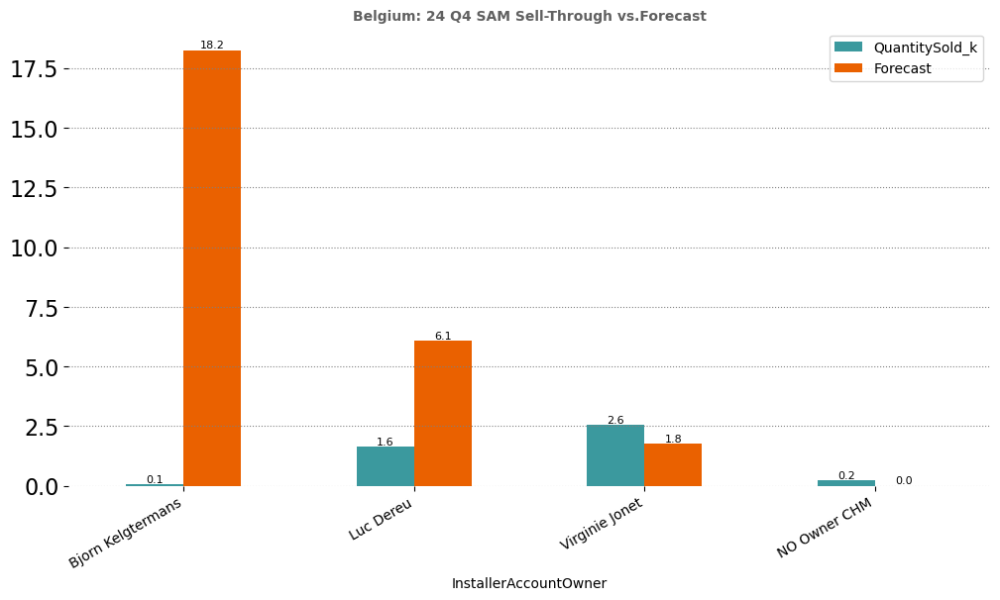

In [263]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Belgium: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Belgium sold 5.24k micro units.
By today Belgium is 2.23k units above/below the quarterly goal.
As a result Belgium met 173.87% of its BOQ forecast for the recent quarter.


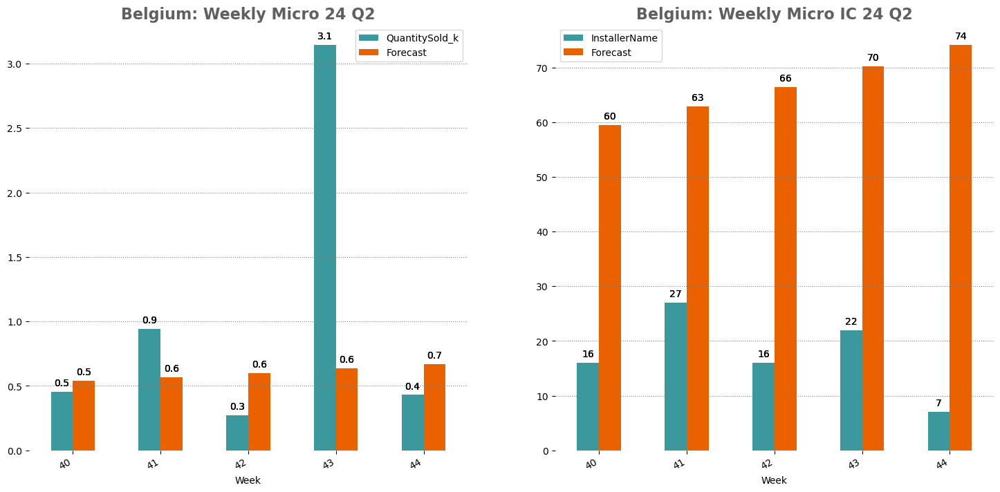

In [264]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Belgium: Weekly Micro 24 Q2", "Belgium: Weekly Micro IC 24 Q2", orangeteal)
print('By today Belgium sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Belgium is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Belgium met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))


#### Storage:

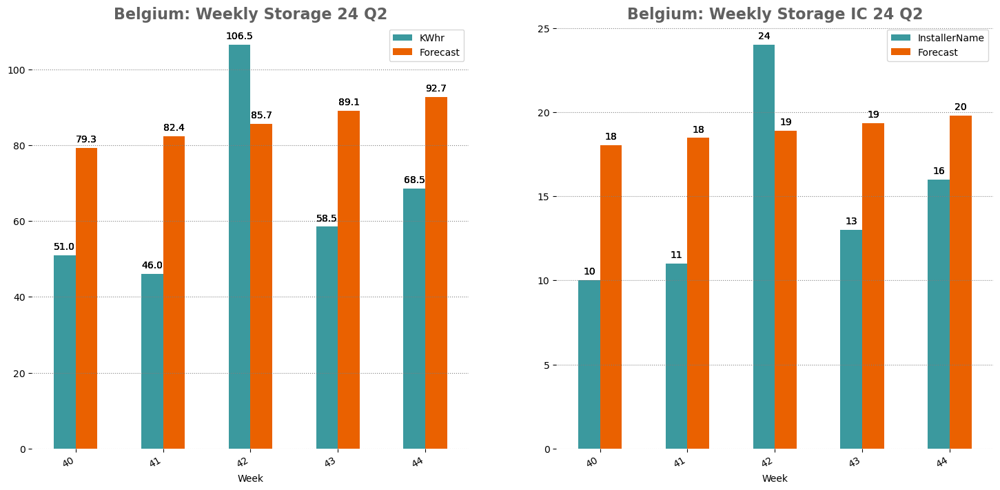

In [265]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Belgium: Weekly Storage 24 Q2", "Belgium: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

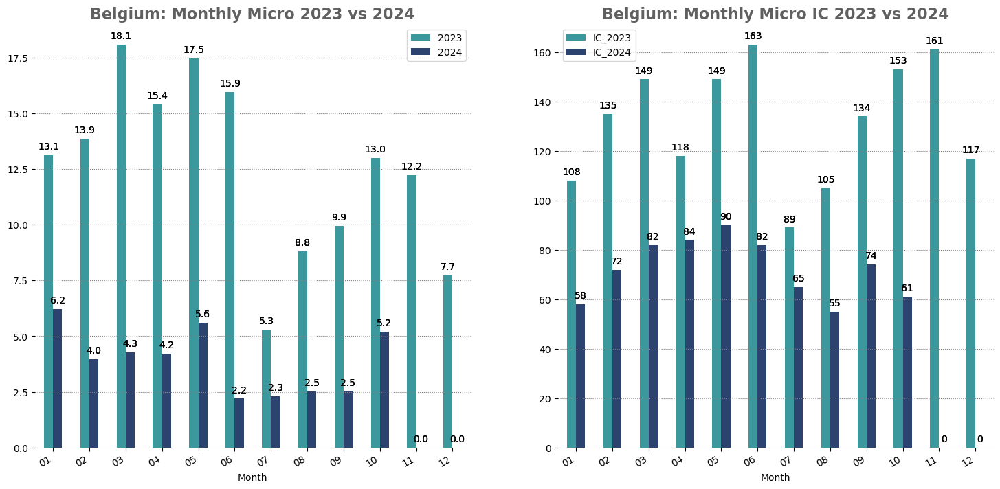

In [266]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Belgium: Monthly Micro 2023 vs 2024", "Belgium: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

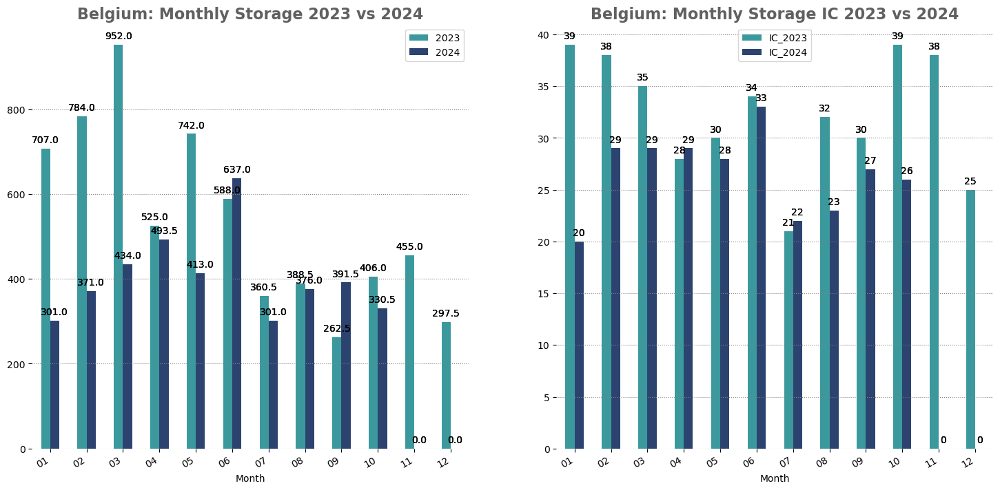

In [267]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Belgium: Monthly Storage 2023 vs 2024", "Belgium: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

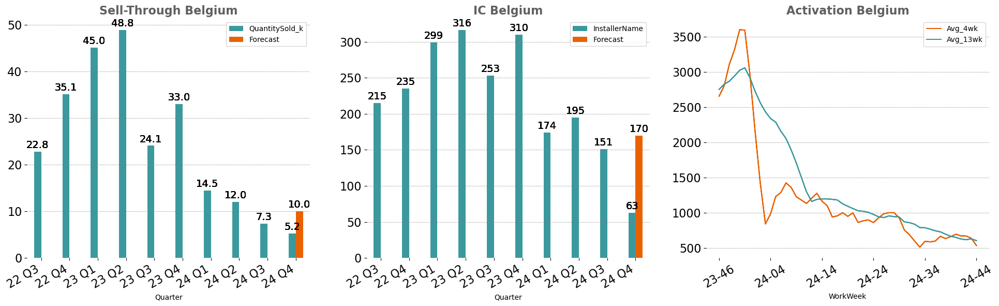

In [268]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Belgium", "IC Belgium", "Activation Belgium")

#### Storage

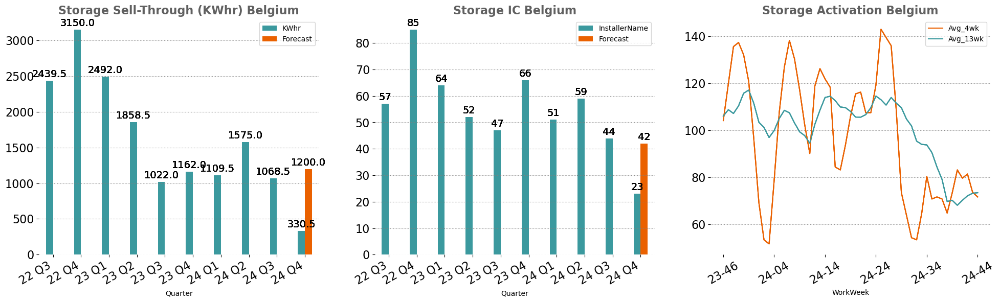

In [269]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Belgium", "Storage IC Belgium", "Storage Activation Belgium")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [270]:
print("20 Biggest Installer Belgium (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Belgium (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
1314,BE,Bjorn Kelgtermans,EnergyKing,1593604,4,756,"2,322","2,790","3,656","2,574","1,680",810,0,88,158,74,186,105,164,16,0,986,"2,003","2,661","2,662","2,280",978,470,130,"5,064",9,20,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1387,BE,Luc Dereu,K.L. electro Bvba,34896,5,0,0,0,0,378,150,504,144,0,0,0,0,0,0,28,21,"1,445","1,398",714,"1,225",572,593,448,172,"1,176",1,71,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
696,BE,Luc Dereu,Alelek,4040724,6,301,180,72,252,378,190,408,180,21,70,7,21,4,168,190,59,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,156",NaN,0,0,inf%,0,0,0,0,0,0
1519,BE,Virginie Jonet,S.E.Belgique,2538742,1,0,0,0,0,739,756,378,"2,436",0,0,0,0,24,66,28,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"4,309",NaN,0,0,inf%,0,0,0,0,0,0
1402,BE,Luc Dereu,Koning bvba,1303992,1,0,0,0,0,0,0,288,300,0,0,0,0,0,0,30,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,588,NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1560,BE,Luc Dereu,SolarPro BV,1814201,5,0,0,50,15,0,62,255,0,14,4,0,7,0,10,0,0,126,59,88,30,0,60,0,0,317,3,3,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1420,BE,Luc Dereu,Luca Dereu,3758769,2,0,24,0,0,22,222,248,80,0,0,0,0,0,28,10,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,572,1,20,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1470,BE,Luc Dereu,Noww BV,4751448,1,0,0,0,0,0,0,244,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,244,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1572,BE,Virginie Jonet,Solution Energie Belgique,425713,1,0,0,0,0,0,0,216,0,0,0,0,0,0,0,0,0,12,0,0,0,0,0,0,0,216,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
1276,BE,Luc Dereu,Eco-Tronic,3428859,2,0,54,216,0,360,0,216,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,576,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [271]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
BE,All,All,All,618,1591390,7,134169,84682,20891,24-45,106,-1,7628,6457,3549,800,5271,3808,2490,765,45,7349,7349,0,1
BE,G&D Energy,Bjorn Kelgtermans,1530933,90,214286,0,23,23,0,23-46,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0
BE,Opteco,Bjorn Kelgtermans,550681,22,52381,0,9,0,9,24-17,9,0,0,9,0,0,0,0,0,0,0,0,0,0,0
BE,BeliVert,Luc Dereu,1362110,20,47619,1,2542,1576,306,24-43,54,122,85,130,30,61,118,77,41,6,-35,0,0,0,0
BE,Insaver,0,0,18,42857,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
BE,MR Group Bv,Bjorn Kelgtermans,2020039,18,42857,2,15246,14459,787,24-05,724,0,400,0,0,0,0,0,0,0,0,1959,1959,0,0
BE,Waas Solar,0,0,13,30952,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
BE,ADVENSO BVBA,Luc Dereu,144977,12,28571,0,19,0,19,24-22,18,0,0,18,0,0,77,86,46,16,12,0,0,0,0
BE,Powergreen,Luc Dereu,3391885,10,23810,1,560,369,191,24-42,10,-29,28,117,36,10,18,34,16,16,97,0,0,0,0
BE,IZEN Energy Systems,0,0,10,23810,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [272]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [273]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Luc Dereu', 'Virginie Jonet', 'Bjorn Kelgtermans']
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Belgium_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 30983 systems in Belgium.


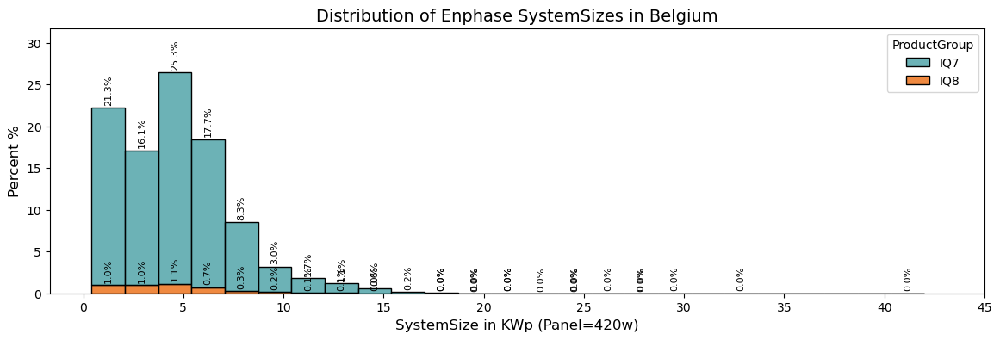

In [274]:
print('Since 2021 we activated {0} systems in Belgium.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Belgium')

## IC Activation

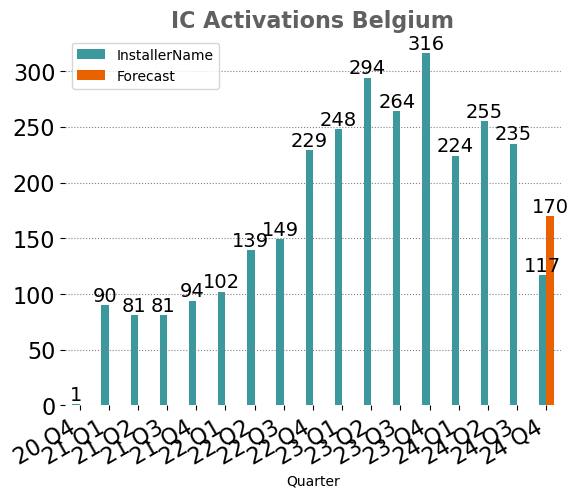

In [275]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Belgium", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,723,692,648
197,24-41,593,669,625
198,24-42,623,668,614
199,24-43,603,636,628
200,24-44,315,534,602


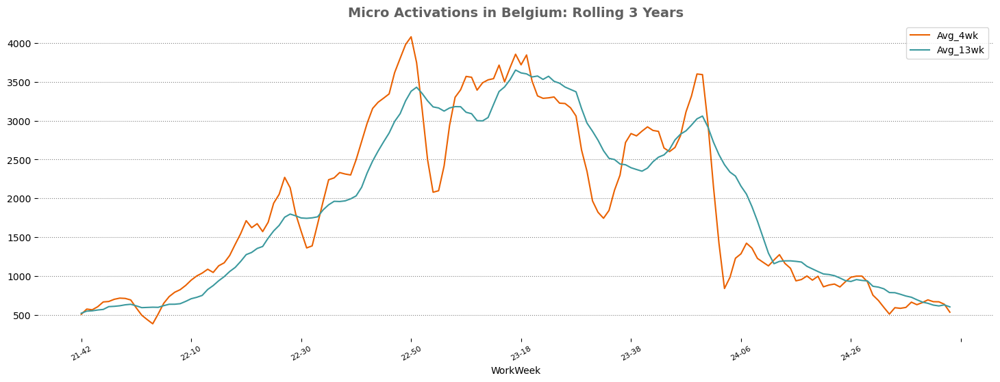

In [276]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Belgium: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  486.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


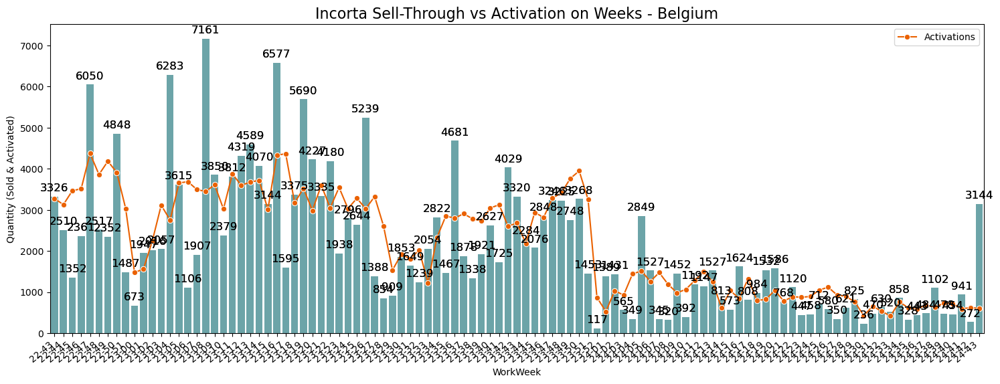

In [277]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Belgium', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,5380,"3,979"
38,24-03,5328,"4,283"
39,24-04,4187,"4,218"
40,24-05,3922,"5,590"
41,24-06,3974,"2,197"
42,24-07,3435,"2,310"
43,24-08,2542,"2,528"
44,24-09,2728,"2,535"
45,24-10,2701,"5,213"
46,24-11,132,NaN


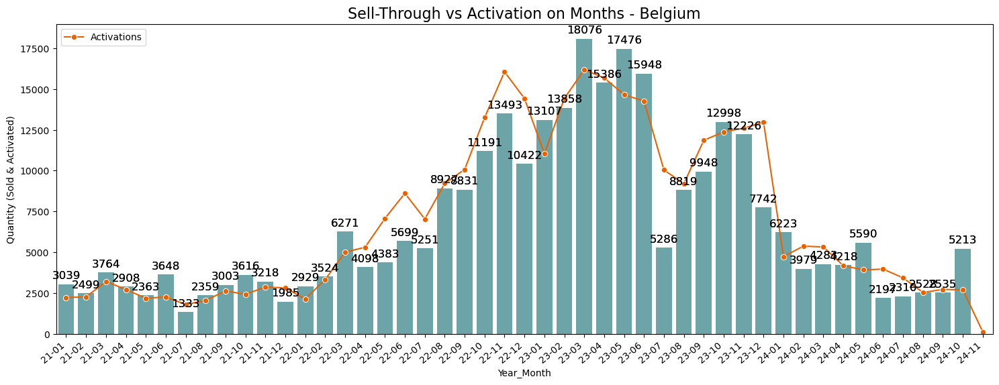

In [278]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Belgium', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [279]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,24-13,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,2,612,"1,030",807,"1,325",724,769,994,770,867,859,876,"1,011","1,044",919,891,699,414,651,510,413,747,601,551,673,606,730,661,579,614,549,304,49,22851
JRB Energy,0,49,93,80,100,36,45,29,49,41,87,20,39,80,85,77,50,56,47,50,36,47,53,56,73,50,36,43,43,59,14,1,16,1640
EnergyKing,0,98,153,83,99,41,95,55,37,139,57,70,1,53,68,12,12,30,30,0,77,53,49,65,19,15,37,25,36,1,29,39,0,1578
Groupe Solution Energie (SVH) Belgique,0,67,24,47,122,66,43,19,0,34,37,84,10,96,51,73,93,31,18,17,0,40,0,22,38,90,9,144,71,11,16,20,14,1407
K.L. electro Bvba,0,0,52,29,64,77,59,47,40,20,22,70,85,28,76,0,4,14,87,31,4,46,0,31,83,8,64,68,28,49,12,15,0,1213
EURO ENERGY.BE,0,72,32,41,51,49,9,38,48,44,58,21,95,28,48,37,16,28,56,44,0,1,22,23,1,26,26,10,47,44,1,25,0,1041
Solarnova BV,0,12,56,0,57,20,22,84,15,17,34,49,56,36,47,46,38,51,50,52,34,32,41,0,22,0,18,27,0,41,0,0,0,957
MR Group,0,13,12,19,52,31,51,31,26,30,51,18,9,3,22,43,24,13,0,0,26,5,12,17,5,8,14,14,0,1,0,0,2,552
Total Energy Projects,0,10,16,26,40,21,32,33,16,51,12,30,0,36,17,15,9,20,0,8,20,65,25,0,0,1,0,0,10,12,0,0,0,525


<a id='Luxembourg'></a>
# 8. Luxembourg

# Luxembourg Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [280]:
Country = 'LU'

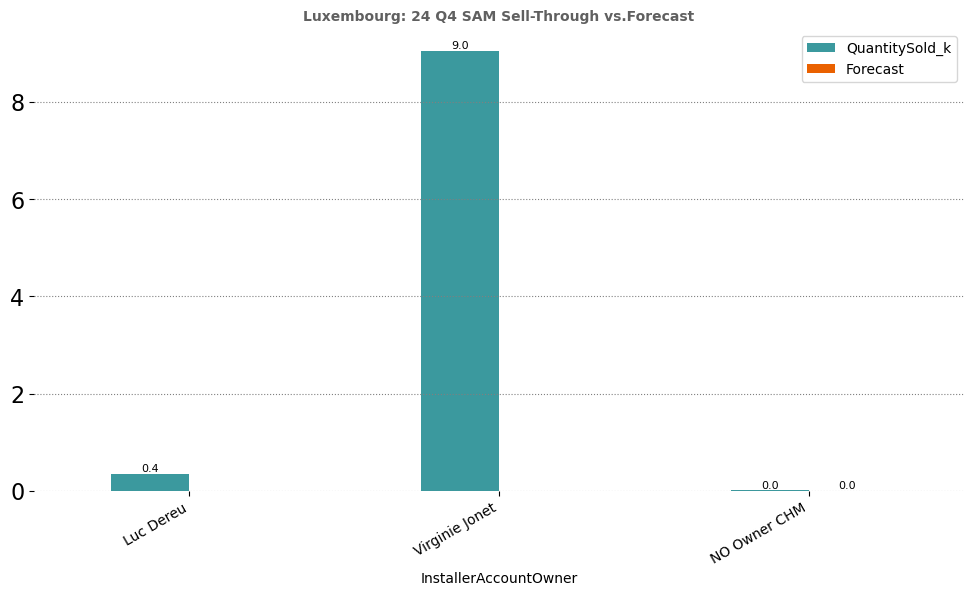

In [281]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Luxembourg: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Luxembourg sold 11.12k micro units.
By today Luxembourg is 7.26k units above/below the quarterly goal.
As a result Luxembourg met 288.31% of its BOQ forecast for the recent quarter.


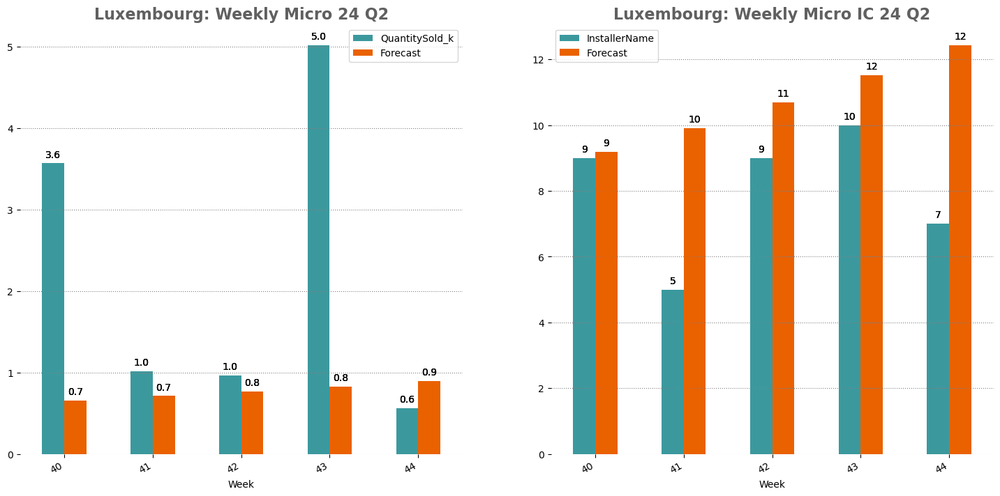

In [282]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Luxembourg: Weekly Micro 24 Q2", "Luxembourg: Weekly Micro IC 24 Q2", orangeteal)
print('By today Luxembourg sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Luxembourg is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Luxembourg met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

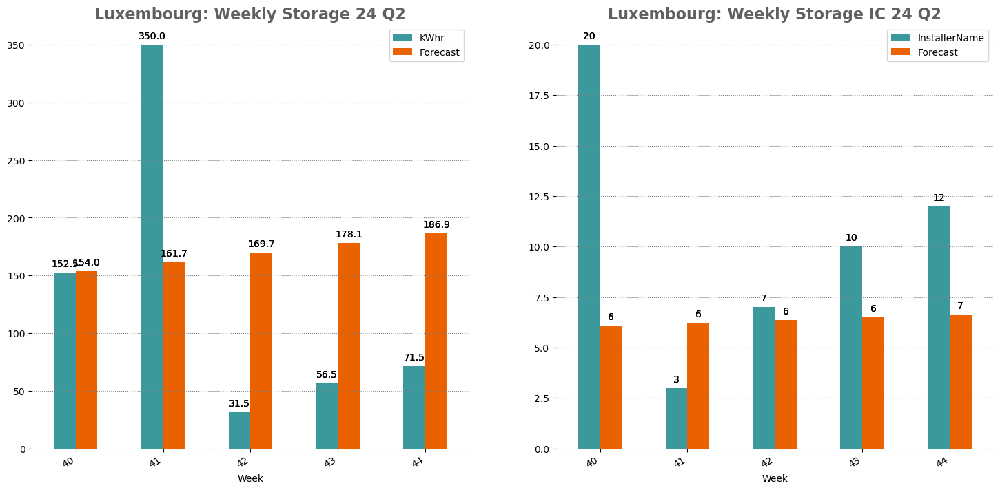

In [283]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Luxembourg: Weekly Storage 24 Q2", "Luxembourg: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

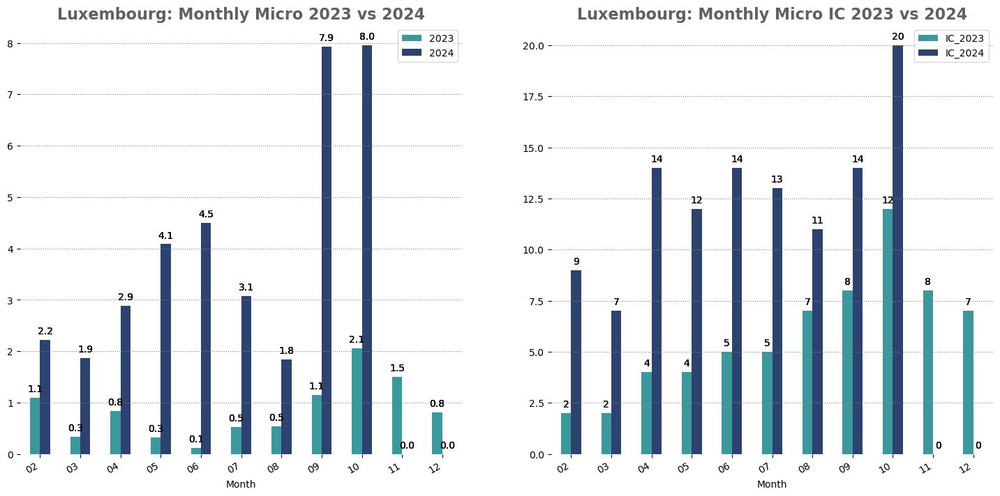

In [284]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Luxembourg: Monthly Micro 2023 vs 2024", "Luxembourg: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

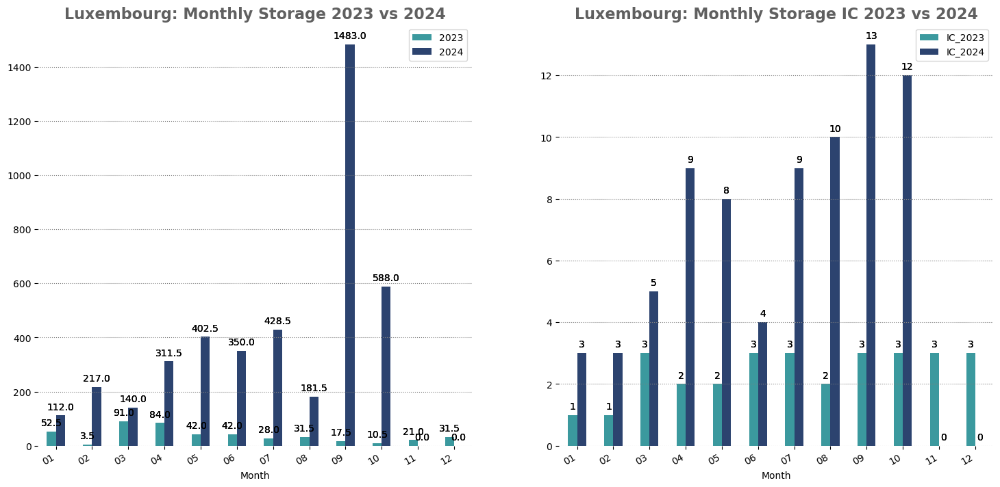

In [285]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Luxembourg: Monthly Storage 2023 vs 2024", "Luxembourg: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

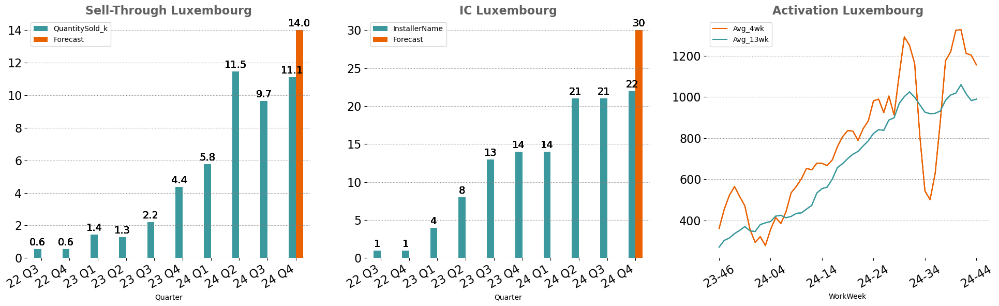

In [286]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Luxembourg", "IC Luxembourg", "Activation Luxembourg")

#### Storage

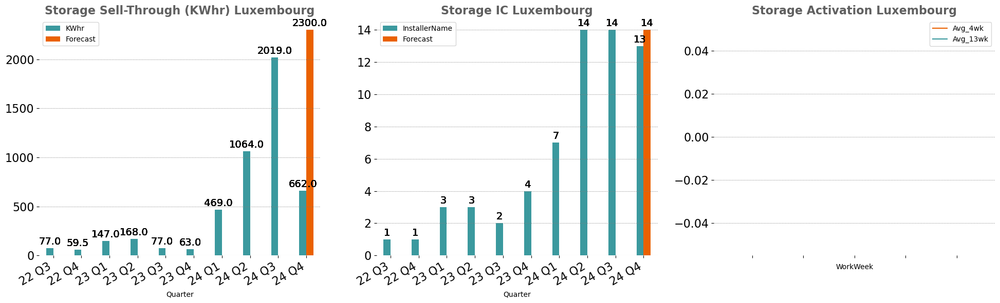

In [287]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Storage Sell-Through (KWhr) Luxembourg", "Storage IC Luxembourg", "Storage Activation Luxembourg")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [288]:
print("20 Biggest Installer Luxembourg (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Luxembourg (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9885,LU,Virginie Jonet,BAUER ENERGIE (LUX),4224890,3,0,0,0,"1,854","3,468","4,789","2,772","4,557",0,0,0,0,354,886,"1,308",350,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"15,586",9,63,1,inf%,0,0,0,0,0,0
9895,LU,Virginie Jonet,ECOSPHERE HOME SRL,4064334,3,0,0,0,0,0,744,"2,032",648,0,0,0,0,0,10,206,0,0,0,0,45,330,669,965,472,"3,424",2,50,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9924,LU,Virginie Jonet,SOLUTION ENERGIE LUXEMBOURG,3931992,3,0,0,0,0,0,"1,552","1,746","1,512",0,0,0,18,0,10,126,35,0,0,113,328,"1,686","1,907","2,339","1,196","4,810",4,44,0,inf%,0,0,0,0,0,0
9901,LU,Luc Dereu,ENR LUX,4503547,1,0,0,0,0,130,"1,185",770,355,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,440",1,89,0,inf%,0,0,0,0,0,0
9898,LU,Virginie Jonet,ELECTRICITE SCORPION Sàrl,3051370,2,300,0,0,658,486,486,486,486,35,0,0,18,0,4,79,14,66,244,385,524,544,438,592,214,"1,944",1,118,0,inf%,0,0,0,0,0,0
9886,LU,NaN,BAYWA R.E. SOLAR SYSTEMS S.A R.L.,3865234,1,0,0,0,0,0,0,324,"1,566",0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,890",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9923,LU,Virginie Jonet,SOLAR DEPOT LU,4572375,1,0,0,0,0,0,180,270,"1,116",0,0,0,0,0,0,115,86,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,566",0,inf,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9920,LU,Virginie Jonet,R.D-Luxembourg,4524290,3,0,0,0,0,0,385,224,22,0,0,0,0,0,0,21,0,0,0,0,0,0,154,333,38,631,2,14,0,inf%,0,0,0,0,0,0
9909,LU,Virginie Jonet,HOME-ELEC SARL,4593106,2,0,0,0,0,0,89,218,0,0,0,0,0,0,0,52,0,0,0,0,0,0,35,118,59,307,0,112,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9916,LU,Virginie Jonet,Minusines,2997698,2,800,1,100,83,418,589,160,0,10,10,0,0,42,32,10,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,167",5,8,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [289]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
LU,All,All,All,43,105239,51,43491,6782,36709,24-45,453,11,4544,9575,6800,8356,1538,2012,2727,1184,78,0,0,0,1
LU,BAUER ENERGIE (LUX),Virginie Jonet,4224890,9,21429,94,19307,1863,17444,24-43,2268,13,3468,4789,2772,4557,0,0,0,0,0,0,0,0,1
LU,Ecoclima,0,0,6,14286,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
LU,Minusines,Virginie Jonet,2997698,5,11905,12,2212,995,1217,24-38,60,-100,418,589,160,0,0,0,0,0,0,0,0,0,0
LU,SOLUTION ENERGIE LUXEMBOURG,Virginie Jonet,3931992,4,9524,60,4927,10,4917,24-43,756,98,0,1552,1746,1512,843,954,1170,598,13,0,0,0,0
LU,Serenity Solution SARL,0,0,2,4762,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
LU,R.D-Luxembourg,Virginie Jonet,4524290,2,3810,21,682,0,682,24-40,22,-100,0,0,41,0,0,77,166,19,999,0,0,0,0
LU,ENRLUX,0,0,2,3810,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
LU,enersun Sàrl,0,0,2,4762,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
LU,ECOSPHERE HOME SRL,Virginie Jonet,4064334,2,5952,88,4520,0,4520,24-42,150,-54,0,0,0,0,165,334,482,236,103,0,0,0,1


In [290]:
# EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [291]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ['Virginie Jonet']
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Virginie_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 2740 systems in Luxembourg.


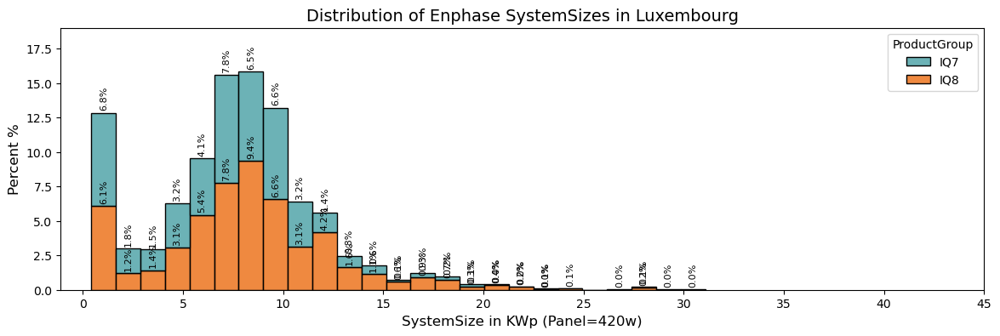

In [292]:
print('Since 2021 we activated {0} systems in Luxembourg.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Luxembourg')

## IC Activation

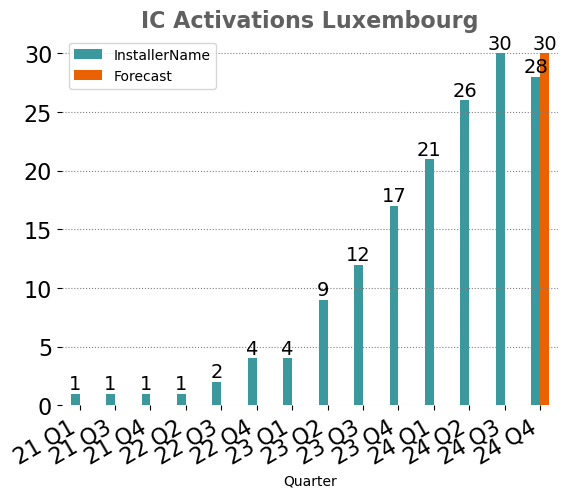

In [293]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations Luxembourg", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
118,24-40,1355,"1,324","1,019"
119,24-41,1309,"1,328","1,060"
120,24-42,1106,"1,212","1,016"
121,24-43,1043,"1,203",983
122,24-44,1169,"1,157",990


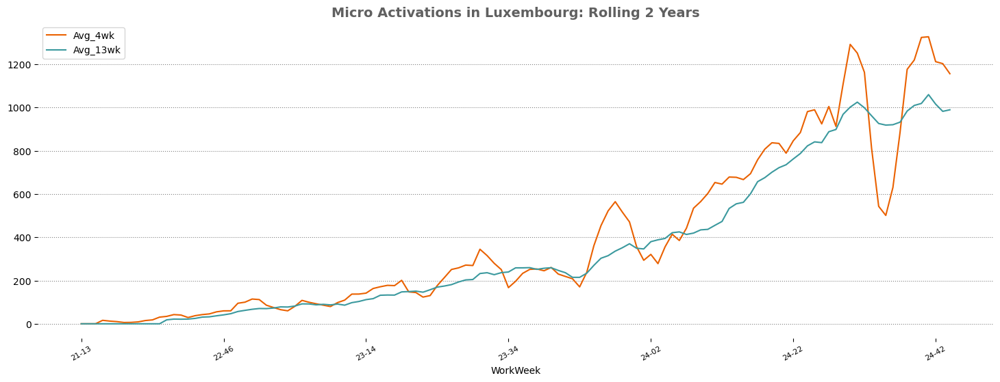

In [294]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Luxembourg: Rolling 2 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -1357.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


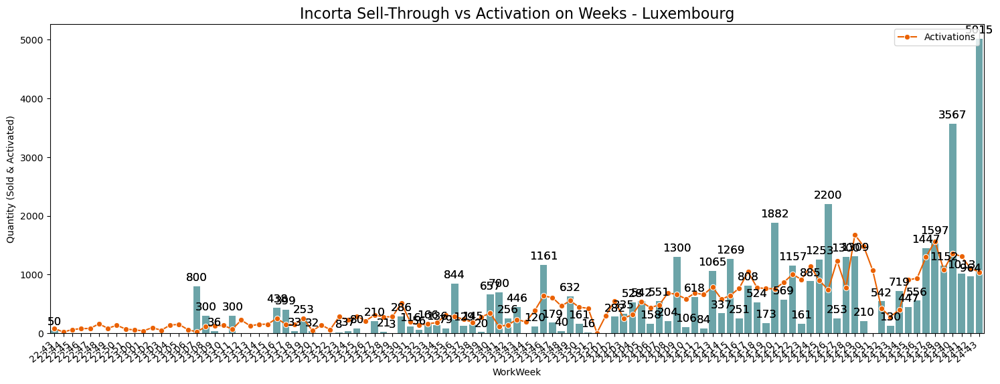

In [295]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Luxembourg', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
25,24-02,2377,"2,215"
26,24-03,2870,"1,873"
27,24-04,3440,"2,887"
28,24-05,3691,"4,083"
29,24-06,3762,"4,499"
30,24-07,5894,"3,072"
31,24-08,2354,"1,838"
32,24-09,5050,"7,922"
33,24-10,5739,"7,952"
34,24-11,273,NaN


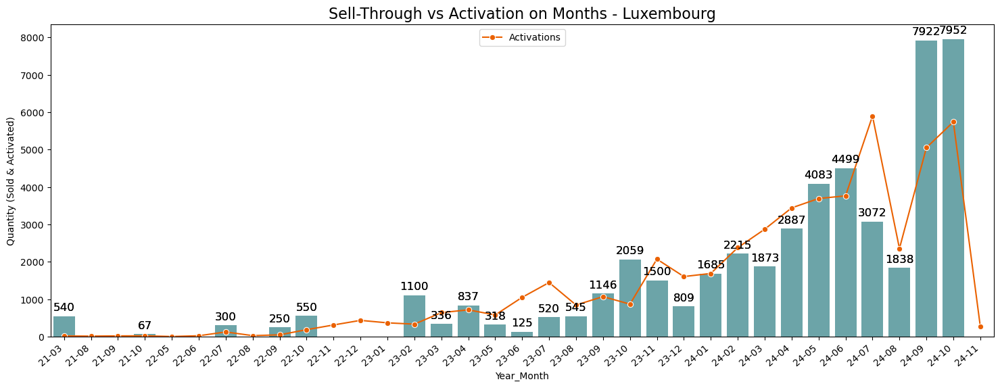

In [296]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Luxembourg', 'Year_Month', orange)

### Top 20 Activation on InstallerNames:

In [297]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,580,642,768,"1,045",775,741,756,865,"1,002",913,"1,144",898,742,"1,236",776,"1,679","1,478","1,075",420,279,399,906,937,"1,297","1,564","1,080","1,355","1,309","1,106","1,042","1,169",199,30177
Solux group,302,365,318,335,242,434,395,437,504,512,478,263,292,491,326,792,603,342,0,0,0,89,171,407,580,431,396,571,293,494,586,79,11528
SOLUTION ENERGIE LUXEMBOURG,116,182,162,160,96,115,125,114,172,126,163,234,142,200,128,154,196,209,164,82,126,167,245,272,249,147,331,289,177,141,218,40,5442
ENRLUX,86,76,63,46,33,32,87,81,101,69,78,73,55,148,0,196,107,146,65,0,0,0,0,49,132,154,144,121,156,140,84,0,2522
ECOSPHERE HOME SRL,0,0,10,189,84,46,53,60,15,0,87,89,36,0,35,81,92,81,20,38,0,204,29,196,116,73,137,91,133,3,76,32,2106
HR GROUP SARL,32,2,86,28,68,0,16,32,74,58,12,19,38,39,44,49,64,115,23,40,81,180,284,71,44,56,102,0,86,65,86,3,1897
ELECTRICITE SCORPION Sàrl,0,2,77,69,111,46,0,23,0,89,21,0,0,100,22,104,24,2,0,0,64,58,0,50,118,50,3,68,75,36,32,0,1244
Home Hybrid Building,32,0,37,22,0,31,43,50,36,0,80,20,57,95,0,75,88,40,0,0,31,42,0,27,63,67,31,24,54,13,14,0,1072
SCAY ENERGIE,0,0,0,0,42,8,15,0,0,0,0,30,5,0,0,89,90,75,18,61,0,33,112,56,107,42,48,0,22,31,24,1,909


<a id='United Kingdom'></a>
# 9. United Kingdom

# United Kingdom Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [298]:
Country = 'GB'

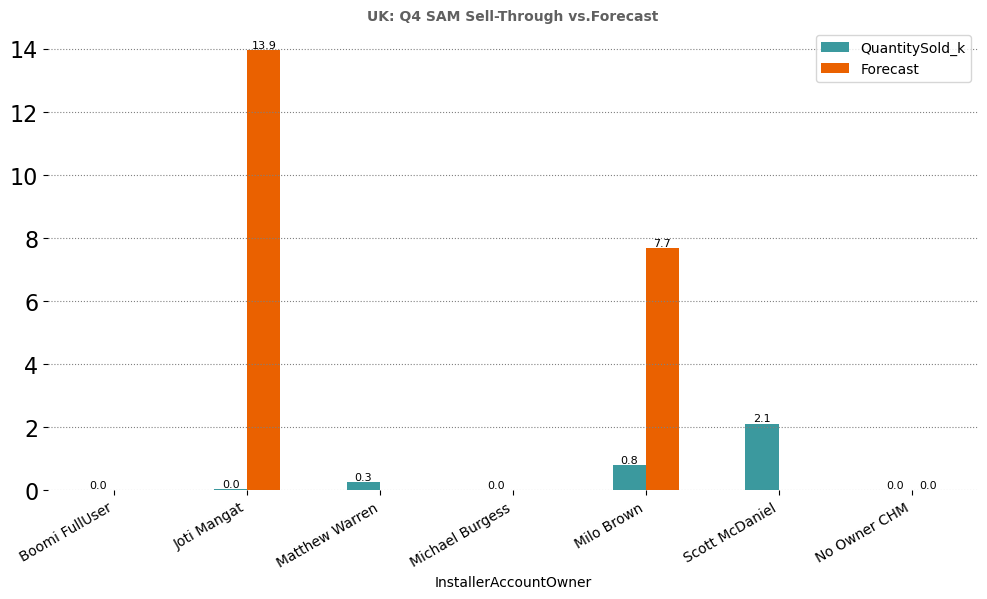

In [299]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == '24 Q3'").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = SAM_POS(df, dff, Country, 'Microinverter', SAM, '24 Q4')

new_row = {'InstallerAccountOwner':'No Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "UK: Q4 SAM Sell-Through vs.Forecast", (12,6))

In [300]:
# SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

# new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
# #new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

# df_SAM = df_SAM.append(new_row, ignore_index=True)
# #df_SAM = df_SAM.append(new_row2, ignore_index=True)

# eda.SAM_barchart(df_SAM, 'QuantitySold_k', "United Kingdom: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today the United Kingdom sold 3.28k micro units.
By today the United Kingdom is -3.31k units above/below the quarterly goal.
As a result the United Kingdom met 49.71% of its BOQ forecast for the recent quarter.


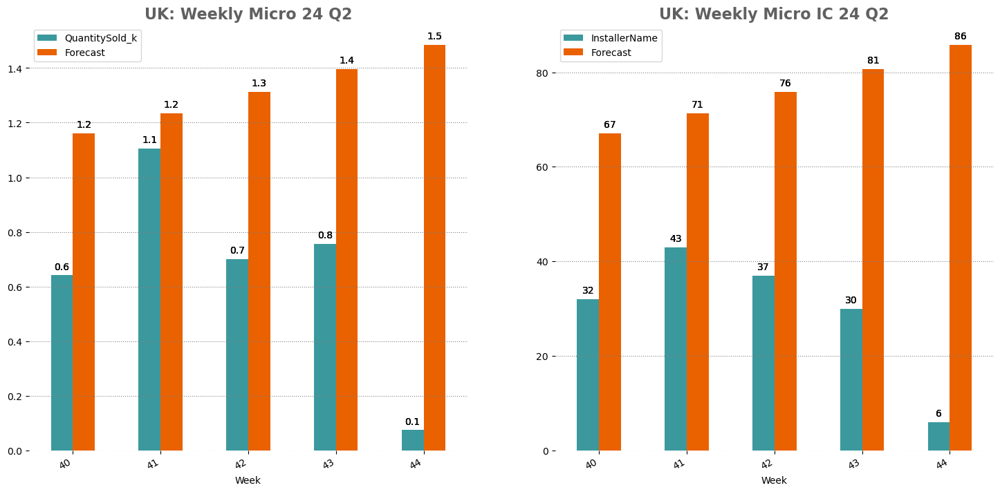

In [301]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "UK: Weekly Micro 24 Q2", "UK: Weekly Micro IC 24 Q2", orangeteal)
print('By today the United Kingdom sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today the United Kingdom is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result the United Kingdom met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

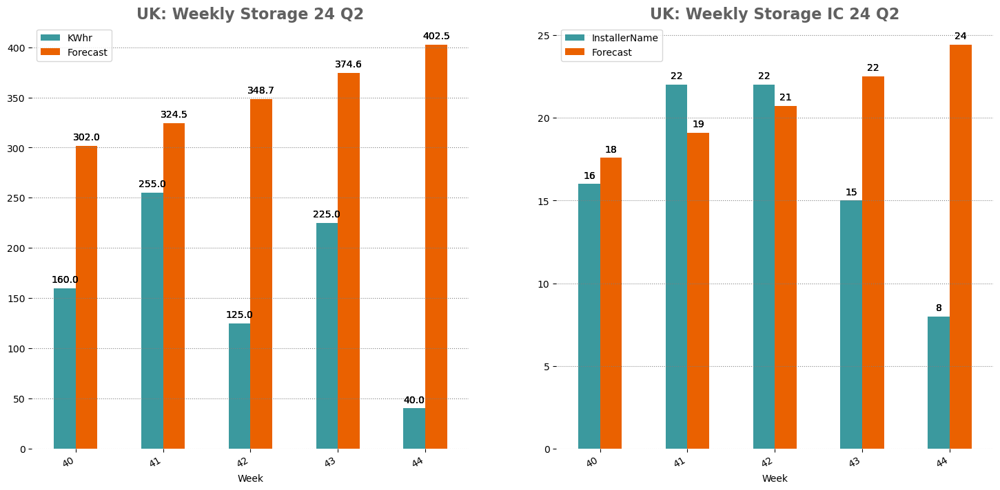

In [302]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "UK: Weekly Storage 24 Q2", "UK: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

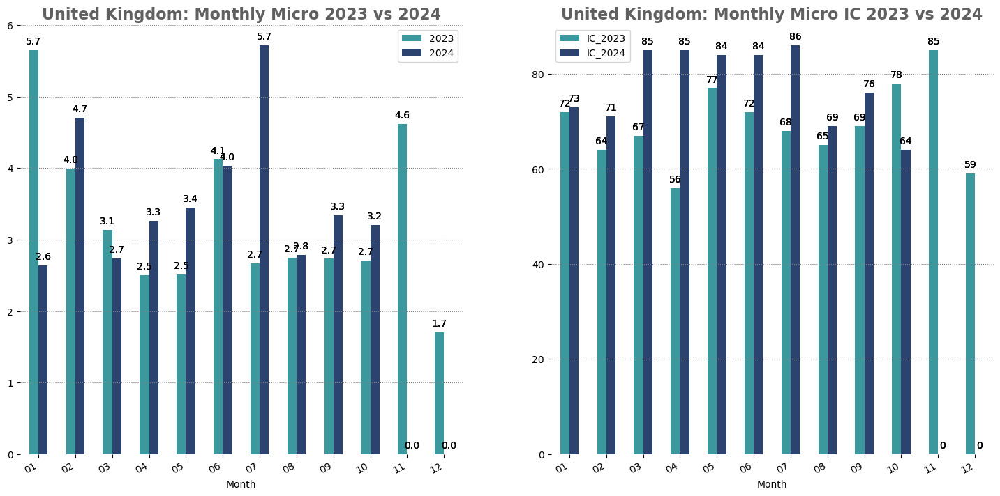

In [303]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "United Kingdom: Monthly Micro 2023 vs 2024", "United Kingdom: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

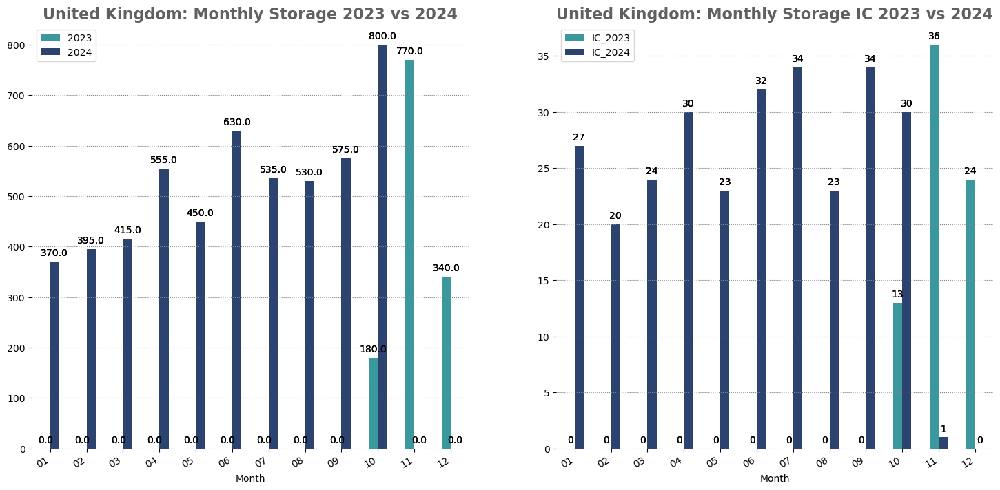

In [304]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "United Kingdom: Monthly Storage 2023 vs 2024", "United Kingdom: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

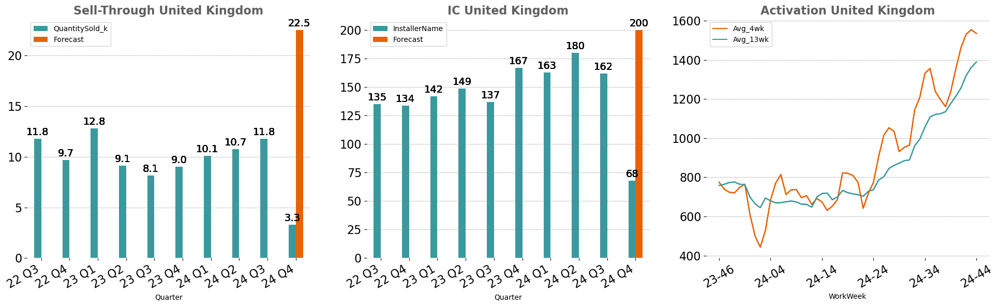

In [305]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through United Kingdom", "IC United Kingdom", "Activation United Kingdom")

#### Storage

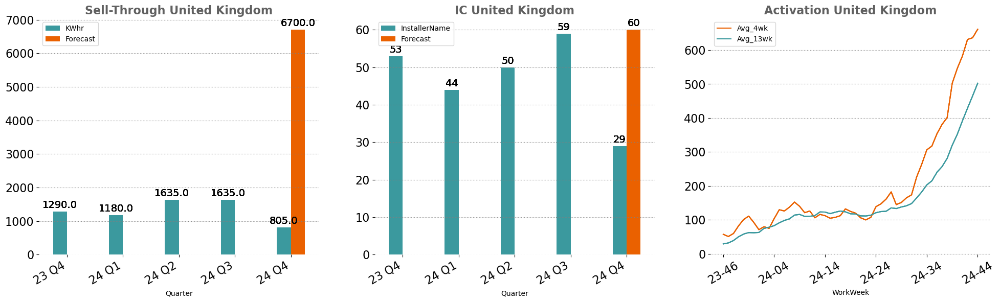

In [306]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through United Kingdom", "IC United Kingdom", "Activation United Kingdom")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [307]:
print("20 Biggest Installer United Kingdom (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer United Kingdom (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9549,GB,Scott McDaniel,Trust solar wholesale,3429230,4,0,0,0,"1,230","1,404","1,260","1,648",778,0,0,0,270,135,210,70,110,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"5,090",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9431,GB,Scott McDaniel,SOLY UK OPERATIONS LIMITED - Delete,4134207,3,0,0,0,24,"1,185","1,132","1,073",364,0,0,0,5,490,475,455,210,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,754",NaN,0,0,inf%,0,0,0,0,0,0
9364,GB,Scott McDaniel,PV Plus Ltd,107792,1,0,0,0,0,45,697,874,240,0,0,0,0,0,0,0,0,0,0,15,0,0,0,0,0,"1,856",0,675,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9200,GB,Matthew Warren,HDM Worldwide Ltd,3679529,8,0,16,9,4,0,141,792,18,0,0,0,0,0,0,220,180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,951,NaN,0,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9061,GB,NaN,EDMUNDSON ELECTRICAL LTD,3865265,8,"1,548",191,884,886,661,866,738,461,0,0,0,175,5,80,145,60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,726",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
8985,GB,Scott McDaniel,CITY PLUMBING SUPPLIES HOLDINGS LTD,2400579,2,162,36,0,0,0,67,702,14,0,0,0,0,0,0,25,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,783,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9587,GB,Milo Brown,[DO NOT USE] UK Greentech Middlesborough,3679332,13,0,34,0,913,376,"1,052",511,233,0,0,0,75,20,55,80,55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,172",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9224,GB,Matthew Warren,In2gr8ted Solutions Ltd,82195,3,103,35,5,33,116,72,484,12,0,0,0,50,20,45,50,15,172,72,24,42,115,116,478,15,684,1,25,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9009,GB,Scott McDaniel,City Electrical Factors,125689,35,42,11,0,0,71,70,431,87,0,0,0,0,10,35,65,15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,659,0,48,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9315,GB,Scott McDaniel,Midsummer retail,2884164,12,8,12,22,6,3,300,343,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,646,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [308]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
GB,All,All,All,255,813010,6,29336,9405,11913,24-45,0,0,3965,3636,3611,817,2078,2298,4225,2743,30,202,202,0,1
GB,Octopus Energy Services,Joti Mangat,3683355,40,95238,0,154,99,55,24-21,2,0,8,17,0,0,4,14,2082,2102,314,0,0,0,0
GB,E.ON UK,0,0,15,35714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GB,Green Building Renewables,Matthew Warren,3503714,8,19048,0,29,0,29,24-20,29,0,0,29,0,0,9,0,0,0,-100,0,0,0,0
GB,MVVM LTD,Scott McDaniel,157314,7,16667,0,41,0,41,24-14,41,0,0,41,0,0,62,70,16,10,11,0,0,0,0
GB,Soly United Kingdom,0,0,7,16667,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GB,Next Generation Utilities,0,0,5,11905,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GB,fresh electrical solar,Scott McDaniel,4044779,5,11905,0,20,0,20,24-38,20,-100,0,0,20,0,0,0,0,0,0,0,0,0,0
GB,Green generation renewable services,0,0,5,11905,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GB,SMS Plc,0,0,5,11905,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [309]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [310]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# SAM = ["Aiden O'Gorman", 'Joti Mangat', 'Michael Burgess', 'Milo Brown']

# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/UK_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 13431 systems in United Kingdom.


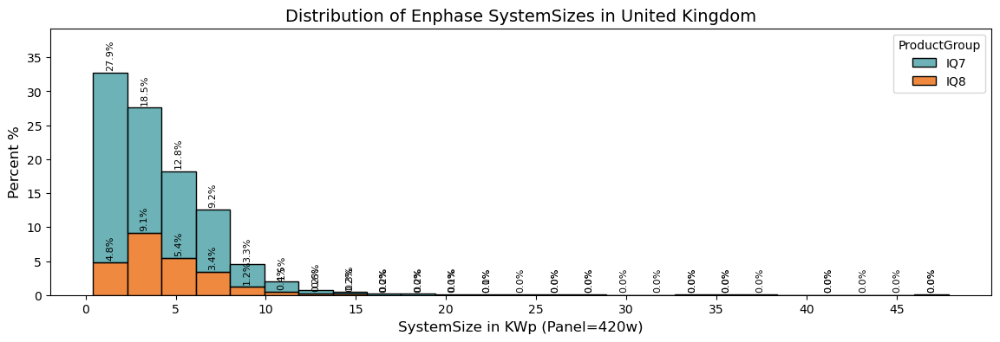

In [311]:
print('Since 2021 we activated {0} systems in United Kingdom.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in United Kingdom')

## IC Activation

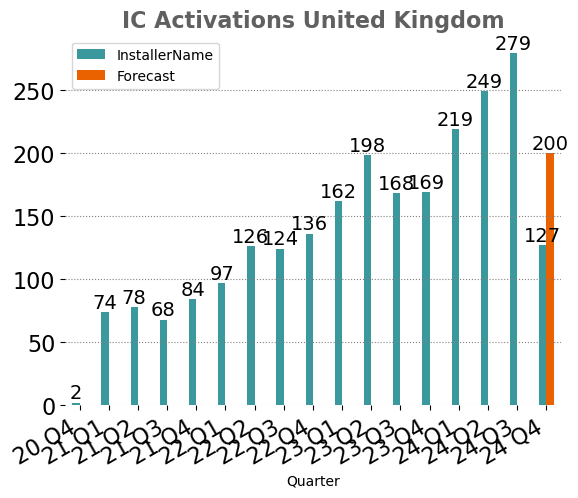

In [312]:
dfAc = dfA.query("Country == @Country")
df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# Installer Count Micro:
df_I['Forecast'] = 0
df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

eda.IC_barchart(df_I, "InstallerName", "IC Activations United Kingdom", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,1550,"1,354","1,214"
197,24-41,1377,"1,462","1,256"
198,24-42,1682,"1,530","1,319"
199,24-43,1607,"1,554","1,361"
200,24-44,1472,"1,534","1,389"


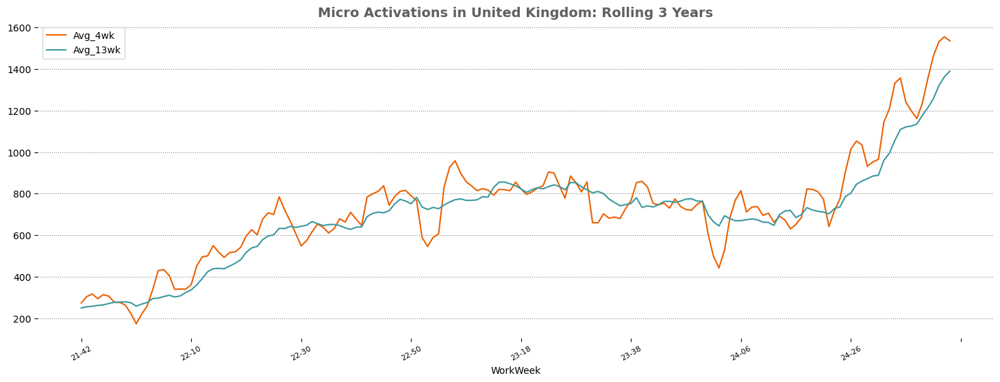

In [313]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in United Kingdom: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  6482.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


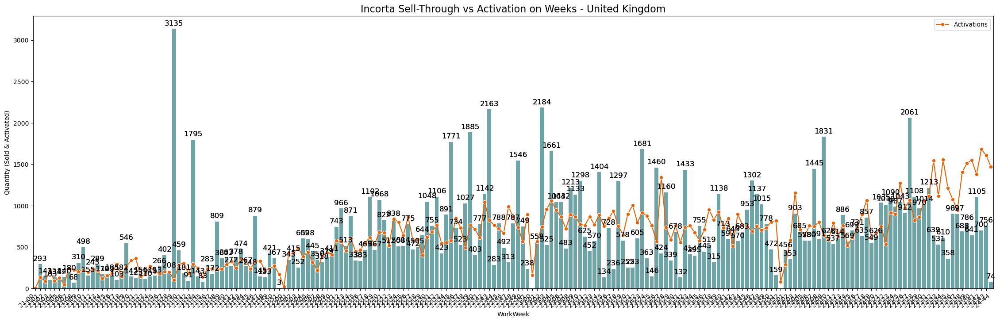

In [314]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left')

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - United Kingdom', (28,8), 1, "QuantitySold")

Since Incorta intro we activated  21.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


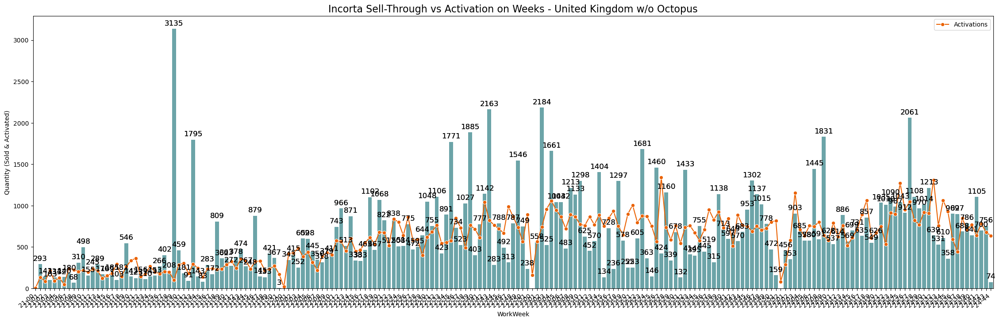

In [315]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW & InstallerName != 'Octopus Energy Services'").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left')

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - United Kingdom w/o Octopus', (28,8), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,3140,"4,709"
38,24-03,2965,"2,735"
39,24-04,3114,"3,265"
40,24-05,3209,"3,446"
41,24-06,4113,"4,032"
42,24-07,4442,"5,718"
43,24-08,5898,"2,786"
44,24-09,5029,"3,342"
45,24-10,7104,"3,207"
46,24-11,586,NaN


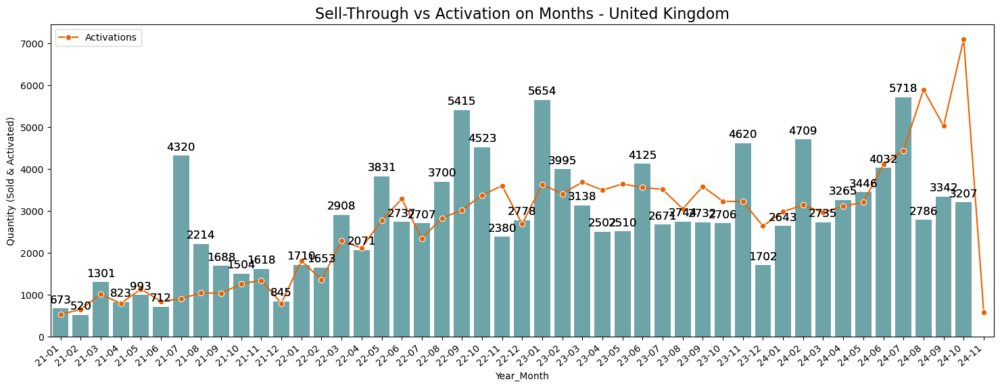

In [316]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - United Kingdom', 'Year_Month', orange)

#### Top 20: Activation InstallerNames:

In [317]:
UKInstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(UKInstallerActivation.InstallerName, UKInstallerActivation.WorkWeek, values=UKInstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,492,577,689,860,"1,022",567,642,713,495,886,845,"1,246",944,986,769,836,"1,033","1,017","1,511","1,073","1,512","1,184","1,050",926,"1,355","1,490","1,541","1,313","1,646","1,573","1,469",68,32330
Octopus Energy Services,0,0,6,0,0,0,0,0,0,0,0,0,23,20,0,90,137,208,230,357,489,282,484,503,558,807,778,733,899,928,834,33,8399
Heatable,82,114,72,73,85,93,129,42,41,99,100,88,115,164,101,39,82,32,60,26,41,52,35,13,61,110,45,51,93,68,74,0,2280
Soly United Kingdom,50,44,12,117,36,41,91,102,39,89,23,92,71,79,97,58,56,52,85,98,80,72,84,11,44,101,54,99,89,65,78,0,2109
JPS Renewable Energy Ltd,65,26,39,76,97,38,73,30,61,65,86,106,58,103,76,69,111,61,58,57,86,31,62,35,26,85,38,63,86,61,139,17,2084
The Solar People,6,37,51,30,29,0,12,29,20,41,52,24,38,19,26,28,26,12,21,18,52,18,18,0,0,29,47,14,46,44,0,0,787
Gess Limited,41,19,28,33,114,34,12,67,5,0,13,7,31,25,2,1,13,41,24,12,0,20,19,25,11,36,29,5,4,1,47,1,720
Greenscape Energy Ltd,15,24,9,36,26,43,40,23,35,56,2,59,30,11,30,59,39,0,22,29,29,0,9,0,6,8,17,29,0,0,11,0,697
Techfor Energy,21,24,5,14,0,0,1,0,0,13,27,292,0,0,0,15,24,45,30,14,0,8,0,18,4,13,37,7,21,15,26,0,674


<a id='Ireland'></a>
# 10. Ireland

# Ireland Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [318]:
Country = 'IE'

In [319]:
# SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

# new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
# #new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

# df_SAM = df_SAM.append(new_row, ignore_index=True)
# #df_SAM = df_SAM.append(new_row2, ignore_index=True)

# eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Ireland: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

In [320]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")
df_m
# # Sell-Through Micro
# df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####

# # Sell-Through Micro
# df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Ireland: Weekly Micro 24 Q2", "Ireland: Weekly Micro IC 24 Q2", orangeteal)
# print('By today Ireland sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
# print('By today Ireland is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
# print('As a result Ireland met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))


,TransactionNumber,InvoiceWeekDate,InvoiceDate,PartnerRegion,PartnerCountry,PartnerName,PartnerCustomerKey,QuantitySold,ProductType,ProductFamily,ProductName,ReportedProductName,ProductDescription,ReportedInstallerName,InstallerName,InstallerCustomerKey,InstallerAccountOwner,ReportedInstallerState,InstallerCountry,ReportedInstallerCountry,ReportedInstallerPostalCode,ReportedInstallerStreet1,ReportedInstallerCity,PartnerInvoiceNumber,ReporterToReporter,SpaNumber,AccountManager,ReportedProgramID,MatchedProgramID,CurrencyCode,Month,WorkWeek,Year,Year_Month,Day,Week,Quarter,QuantitySold_k,KWhr,MWhr,Enerix_CI,InstallerName_source,InstallerCountry_source


#### Storage:

In [321]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Ireland: Weekly Storage 24 Q2", "Ireland: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

In [322]:
# Countries 
# df_ST, df_IC = eda.YoY(df, Country)

# eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Ireland: Monthly Micro 2023 vs 2024", "Ireland: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

In [323]:
# df_ST, df_IC = eda.YoYKWhr(df, Country)

# eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Ireland: Monthly Storage 2023 vs 2024", "Ireland: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

In [324]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
# df_C
# # Sell-Through Micro
# df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# # Forecast from Indirect
# df_ST['Forecast'] = 0
# df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# # Installer Count Micro:
# df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# df_IC['Forecast'] = 0
# df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# # Activation Averages 
# dfAC = dfA.query("Country == @Country")
# dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# # 3x1
# eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Ireland", "IC Ireland", "Activation Ireland")

#### Storage

In [325]:
# df_C = df.query("ProductType == 'Storage' & KWhr > 0")

# # Sell-Through Micro
# df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# # Forecast from Indirect
# df_ST['Forecast'] = 0
# df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# # Installer Count Storage
# df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
# df_IC['Forecast'] = 0
# df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# # Activation Averages 
# dfStEMEA = dfSt.query("InstallerCountry == @Country")
# dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# # 3x1
# eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Ireland", "IC Ireland", "Activation Ireland")

## EMEA Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [326]:
print("20 Biggest Installer Ireland (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q424_ST", ascending = False).head(50)

20 Biggest Installer Ireland (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9637,IE,Sean Collier,Activ8 Solar Energies,96101,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,8,2,0,18,0,2,0,0,5,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9638,IE,Scott McDaniel,Cubicm3,1748871,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9639,IE,Scott McDaniel,KIRRA LIMITED,3428867,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9640,IE,Scott McDaniel,Pv-green,164271,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,28,29,67,84,605,"1,137",433,0,2,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9641,IE,Scott McDaniel,SolarShare,1617124,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,18,27,16,29,0,0,0,0,0,0,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [327]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
IE,Pv-green,Scott McDaniel,164271,2,5952,0,162,0,0,24-08,36,0,147,0,0,0,42,302,568,216,620,0,0,0,0
IE,All,All,All,2,8332,0,176,0,0,24-45,0,0,147,0,0,0,42,302,568,216,103,0,0,0,0
IE,Cubicm3,Scott McDaniel,1748871,0,238,0,14,0,0,22-43,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IE,Kellihers Electrical,0,0,0,238,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IE,EcoVolt Ltd,0,0,0,714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IE,SolarShare,Scott McDaniel,1617124,0,476,0,0,0,0,23-45,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IE,Savememoney Wind and Solar Ltd,0,0,0,714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [328]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Ireland_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 551 systems in Ireland.


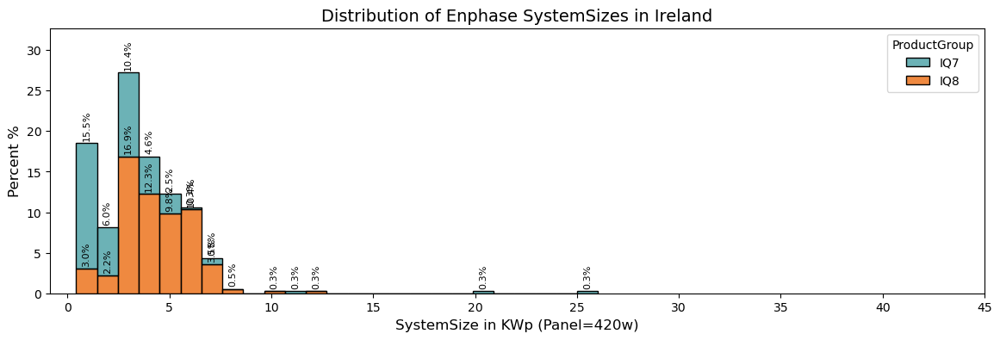

In [329]:
print('Since 2021 we activated {0} systems in Ireland.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Ireland')

## IC Activation

In [330]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Ireland", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
150,24-40,50,98,89
151,24-41,62,84,89
152,24-42,110,86,92
153,24-43,109,83,95
154,24-44,131,103,95


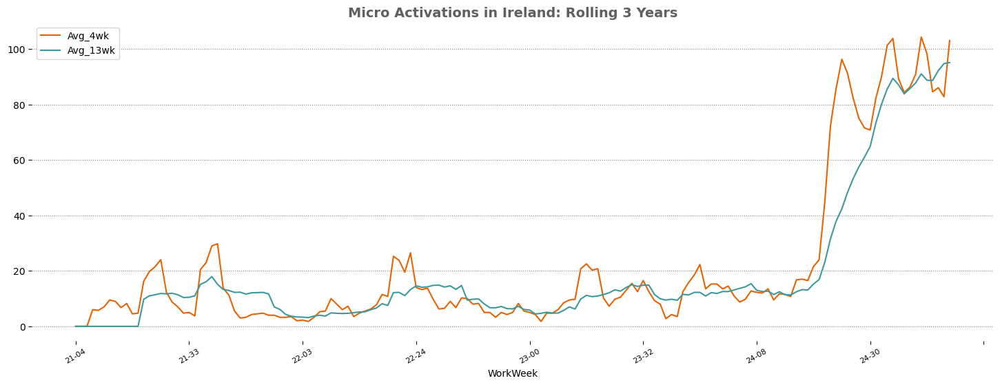

In [331]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Ireland: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  0.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


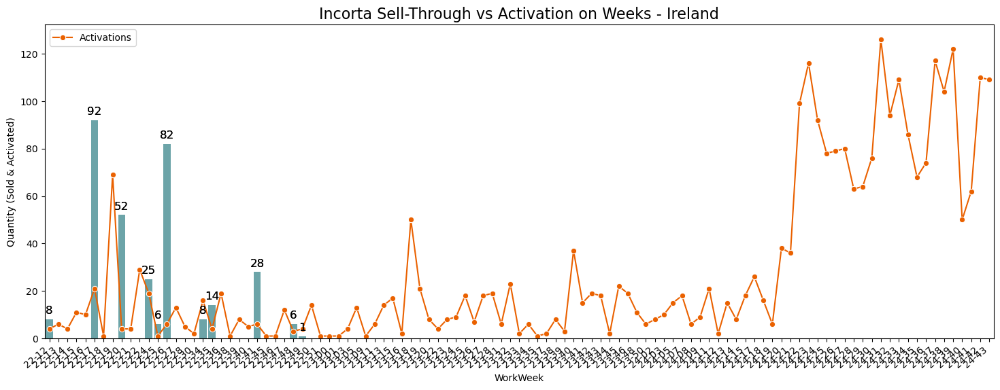

In [332]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Ireland', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
36,24-02,33,NaN
37,24-03,38,NaN
38,24-04,59,NaN
39,24-05,188,NaN
40,24-06,365,NaN
41,24-07,380,NaN
42,24-08,386,NaN
43,24-09,447,NaN
44,24-10,380,NaN
45,24-11,58,NaN


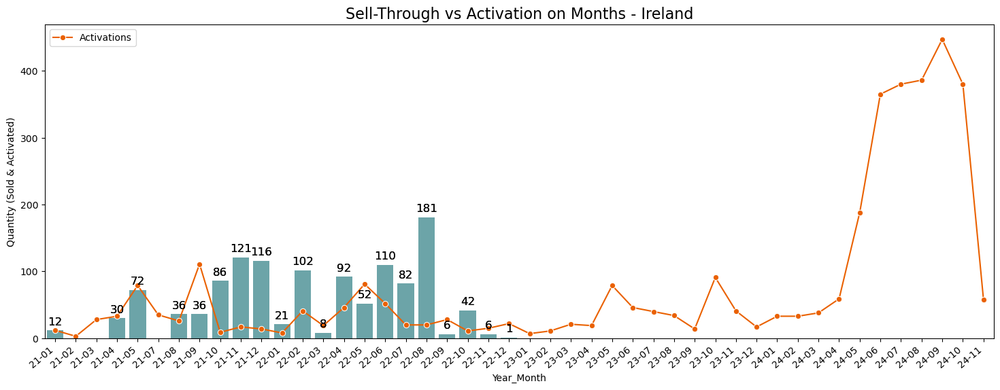

In [333]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Ireland', 'Year_Month', orange)

<a id='Italy'></a>
# 11. Italy

# Italy Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [334]:
Country = 'IT'

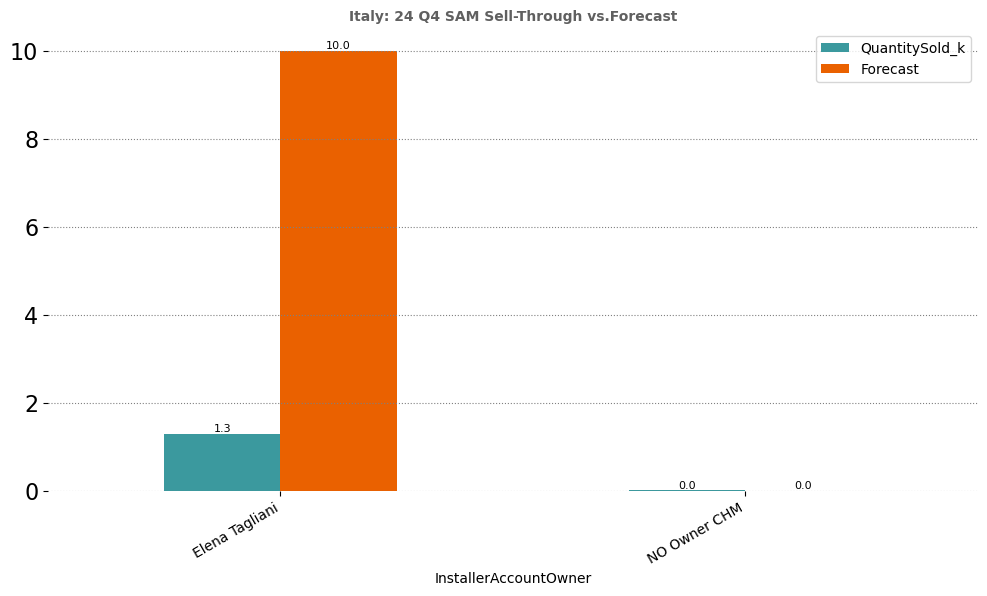

In [335]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Italy: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Italy sold 1.33k micro units.
By today Italy is -0.0k units above/below the quarterly goal.
As a result Italy met 99.98% of its BOQ forecast for the recent quarter.


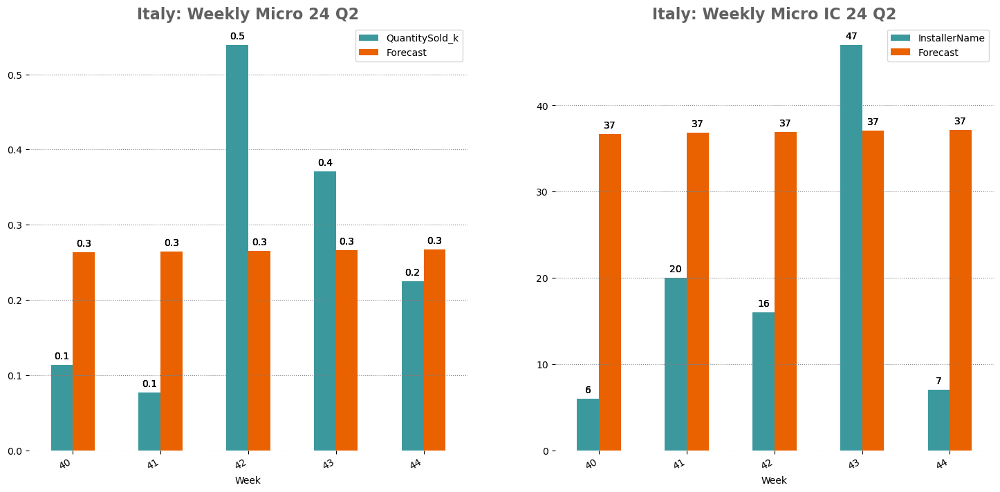

In [336]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Italy: Weekly Micro 24 Q2", "Italy: Weekly Micro IC 24 Q2", orangeteal)
print('By today Italy sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Italy is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Italy met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

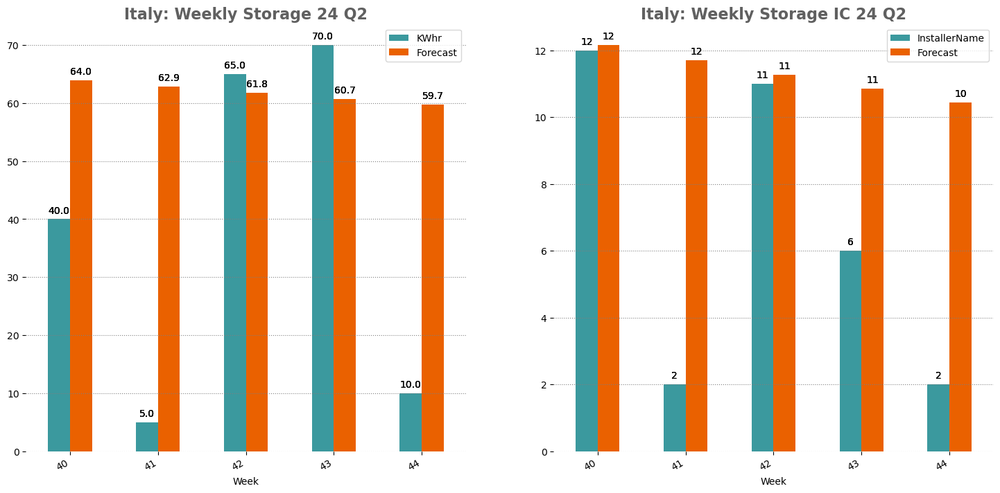

In [337]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Italy: Weekly Storage 24 Q2", "Italy: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

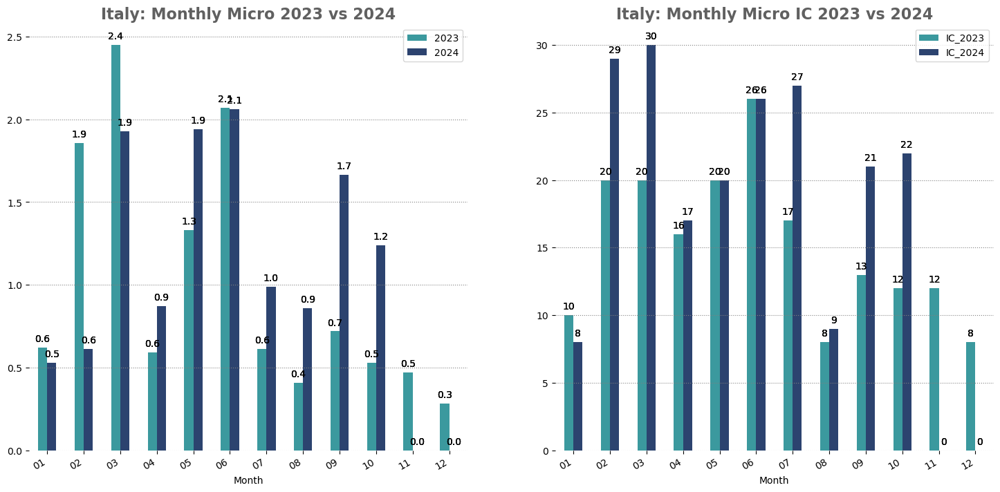

In [338]:
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Italy: Monthly Micro 2023 vs 2024", "Italy: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

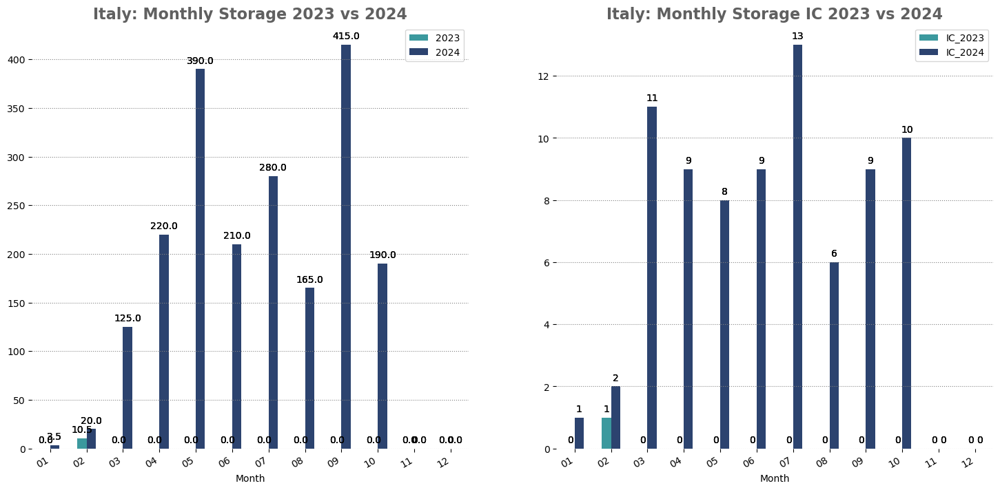

In [339]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Italy: Monthly Storage 2023 vs 2024", "Italy: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

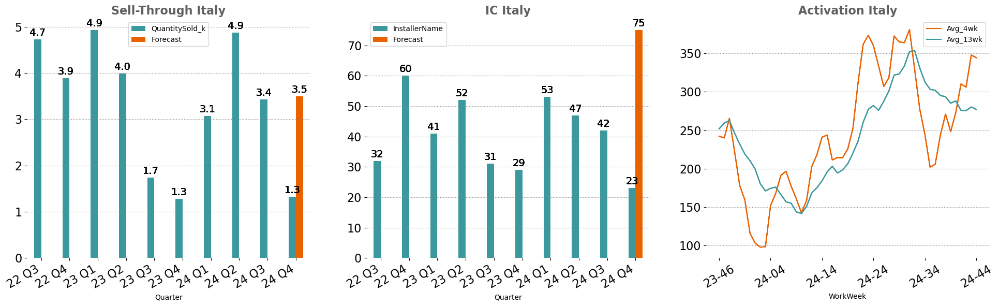

In [340]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Italy", "IC Italy", "Activation Italy")

#### Storage

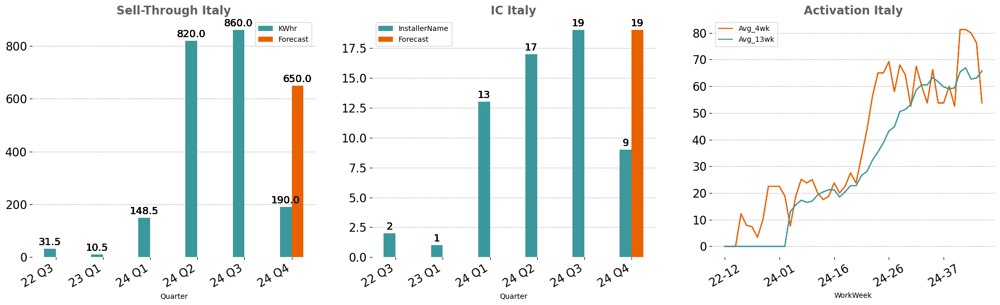

In [341]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Italy", "IC Italy", "Activation Italy")

## Italy Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [342]:
print("20 Biggest Installer Italy (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Italy (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9841,IT,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,117,"1,766","1,724",391,0,0,0,0,40,480,580,90,0,0,0,0,122,829,791,428,"3,998",NaN,0,0,inf%,0,0,0,0,0,0
9842,IT,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,117,"1,766","1,724",391,0,0,0,0,40,480,580,90,0,0,0,0,122,829,791,428,"3,998",NaN,0,0,inf%,0,0,0,0,0,0
9839,IT,Elena Tagliani,Solevento Service srl,4500787,2,0,0,0,0,78,364,234,78,0,0,0,0,0,0,10,0,0,0,0,0,0,122,102,78,754,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9667,IT,Elena Tagliani,CERT ELETTRONICA,61035,4,360,0,180,0,558,36,176,36,0,0,0,0,25,10,20,15,99,174,236,106,56,88,159,162,806,1,29,0,inf%,0,0,0,0,0,0
9659,IT,Vahid Parma,BSS Solar Systeme GmbH & Co. KG,2237688,5,0,0,0,0,0,0,140,0,0,0,0,0,0,0,0,0,252,116,167,200,295,179,89,2,140,1,5,0,280.0%,50,200,200,200,200,200
9840,IT,Elena Tagliani,Soluzioni Green,2136915,2,0,14,7,14,172,194,130,0,0,0,0,0,0,0,0,0,23,0,5,14,2,59,0,0,496,NaN,0,0,inf%,0,0,0,0,0,0
9742,IT,Elena Tagliani,IS ENERGY SRL,2492300,3,200,150,0,50,100,100,107,0,0,0,0,0,0,0,0,0,154,185,166,90,124,154,102,9,307,1,9,0,inf%,0,0,0,0,0,0
9682,IT,Elena Tagliani,ELETTRO IMPIANTI SRLS,4489585,1,0,0,0,0,0,0,102,0,0,0,0,0,0,60,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,102,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9724,IT,Elena Tagliani,Global Technologies S.r.l.,4126489,2,0,0,0,0,0,0,80,0,0,0,0,0,0,0,15,0,0,0,0,0,42,28,0,50,80,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9651,IT,NaN,APPROSUD ENVIRONNEMENT,3866307,2,0,0,0,0,0,0,75,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,75,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [343]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
IT,All,All,All,107,337588,1,19585,8565,4109,24-45,67,5,1277,1259,523,226,530,664,745,302,36,0,0,0,1
IT,Otovo srl,Elena Tagliani,3293006,8,17857,0,110,35,75,24-42,30,225,35,0,6,30,0,0,0,0,0,0,0,0,0
IT,VIP Energy,Elena Tagliani,2394965,5,11905,0,262,262,0,23-20,12,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,Sustech,0,0,5,11429,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,Bioenergia srl,0,0,4,9524,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,Solevento,0,0,4,9524,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,Iren Mercato SpA,Elena Tagliani,2441629,3,7143,0,990,0,0,22-38,756,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,VALORE SOLARE SRL,Elena Tagliani,2286324,3,7857,11,2220,950,719,24-44,42,192,0,0,0,4,60,111,124,16,87,0,0,0,0
IT,Espe Srl,0,0,3,7143,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
IT,Unica S.p.A.,Elena Tagliani,2510466,2,3571,0,313,263,4,23-25,140,0,0,0,0,0,0,0,30,3,0,0,0,0,0


In [344]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [345]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Italy_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 4264 systems in Italy.


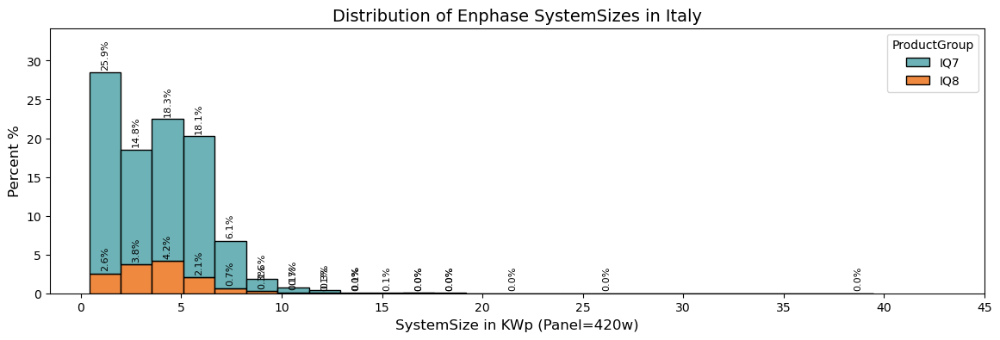

In [346]:
print('Since 2021 we activated {0} systems in Italy.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Italy')

## IC Activation

In [347]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Italy", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
171,24-40,421,273,288
172,24-41,355,310,276
173,24-42,258,306,276
174,24-43,358,348,280
175,24-44,407,344,277


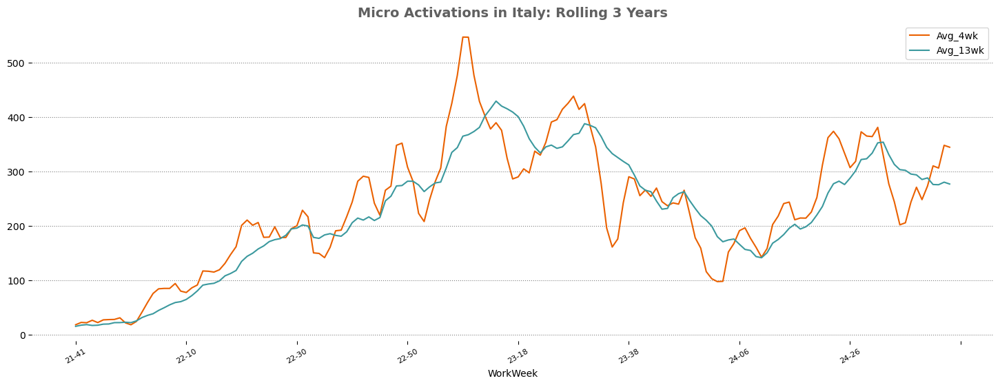

In [348]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Italy: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -518.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


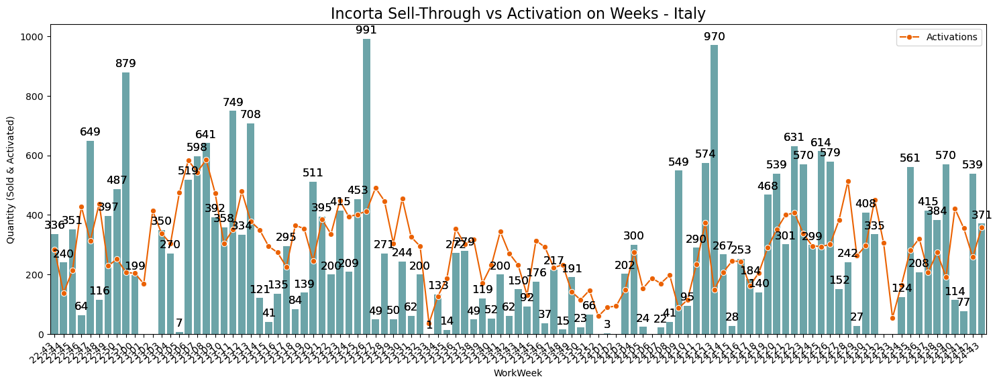

In [349]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Italy', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
36,24-02,698,612
37,24-03,872,"1,929"
38,24-04,989,872
39,24-05,1504,"1,939"
40,24-06,1247,"2,062"
41,24-07,1810,989
42,24-08,905,860
43,24-09,1074,"1,665"
44,24-10,1635,"1,238"
45,24-11,139,NaN


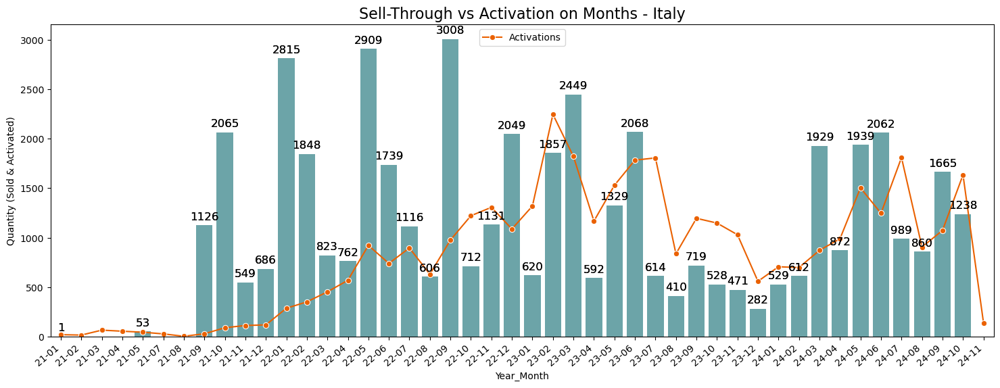

In [350]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Italy', 'Year_Month', orange)

<a id='Croatia'></a>
# 12. Croatia

# Croatia Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [351]:
Country = 'HR'

In [352]:
# SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

# new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
# #new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

# df_SAM = df_SAM.append(new_row, ignore_index=True)
# #df_SAM = df_SAM.append(new_row2, ignore_index=True)

# eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Croatia: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

In [353]:
# df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# # Sell-Through Micro
# df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####

# # Sell-Through Micro
# df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Croatia: Weekly Micro 24 Q2", "Croatia: Weekly Micro IC 24 Q2", orangeteal)
# print('By today Croatia sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
# print('By today Croatia is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
# print('As a result Croatia met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

In [354]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Croatia: Weekly Storage 24 Q2", "Croatia: Weekly Storage IC 24 Q2", orangeteal)

### SellThrough on months
#### Microinverter:

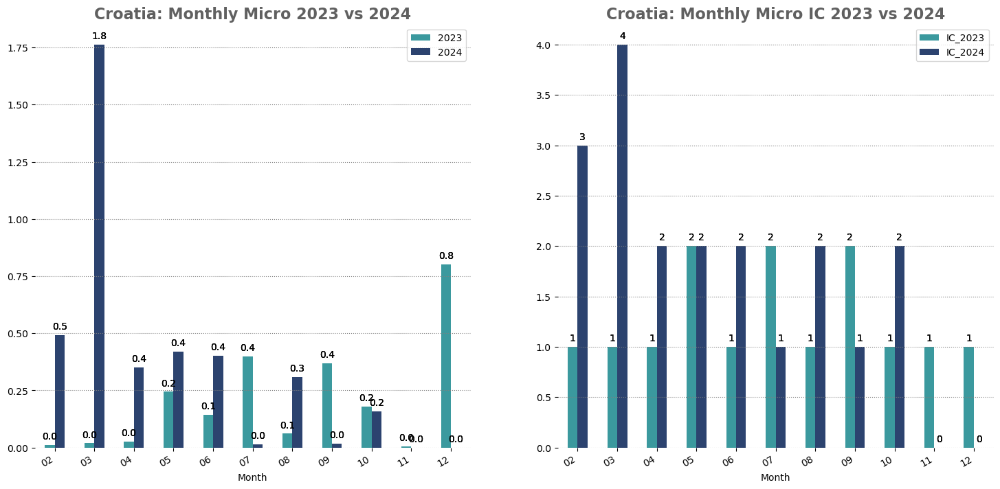

In [355]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Croatia: Monthly Micro 2023 vs 2024", "Croatia: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

In [356]:
# df_ST, df_IC = eda.YoYKWhr(df, Country)

# eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Croatia: Monthly Storage 2023 vs 2024", "Croatia: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

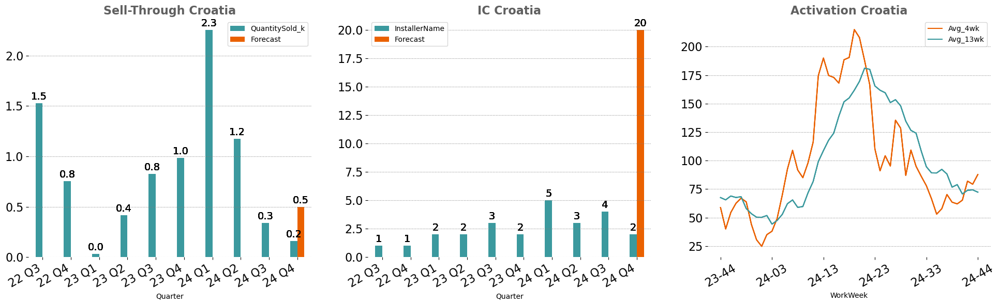

In [357]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == 'PL', 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == 'PL', 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Croatia", "IC Croatia", "Activation Croatia")

#### Storage

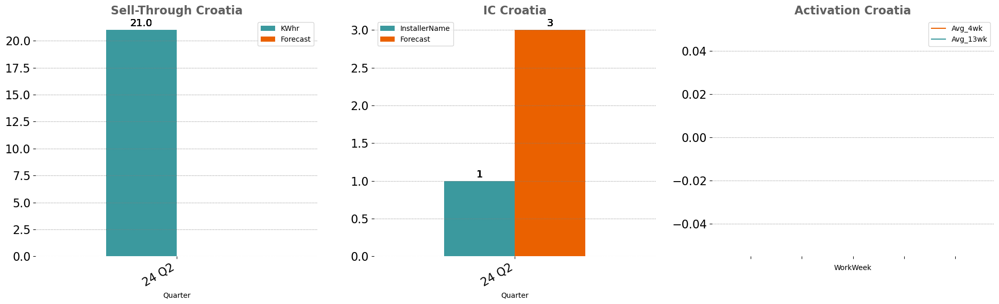

In [358]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == 'PL', 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == 'PL', 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Croatia", "IC Croatia", "Activation Croatia")

## Croatia Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [359]:
print("20 Biggest Installer Croatia (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Croatia (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9615,HR,Elena Tagliani,ENERGYCOM,2521705,2,0,378,777,980,"2,123","1,026",270,108,0,0,0,0,0,0,0,0,431,386,299,346,"1,117","1,744",784,276,"3,527",4,32,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9616,HR,Elena Tagliani,ENERGYCOM,2521705,2,0,378,777,980,"2,123","1,026",270,108,0,0,0,0,0,0,0,0,431,386,299,346,"1,117","1,744",784,276,"3,527",4,32,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9624,HR,Elena Tagliani,neteko.hr,4877686,1,0,0,0,0,0,0,38,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9623,HR,Elena Tagliani,Zenerg d.o.o.,3036063,1,12,36,38,0,10,0,18,0,0,0,0,0,0,0,0,0,12,34,62,21,25,24,12,0,28,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9618,HR,Boomi FullUser,Enteh energy of tomorrow d.o.o.,4536403,1,0,0,0,0,0,0,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,25,0,0,15,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9614,HR,Elena Tagliani,Draco Support jdoo,2856107,1,19,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,4,11,0,0,0,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9617,HR,Elena Tagliani,ENNA Opskrba d.o.o.,2310747,1,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,3,50,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9619,HR,NaN,"MONTSISTEMI D.O.O., KOPRIVNICA",0,NaN,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9620,HR,Elena Tagliani,SOLAR SUTRA d.o.o.,58046,2,0,0,0,0,0,35,0,0,0,0,0,0,0,21,0,0,0,9,15,0,27,12,10,0,35,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9621,HR,NaN,ZELENA ENERGETSKA ZADRUGA ZA USLUGE,0,NaN,0,0,13,6,33,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [360]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
HR,ENERGYCOM,Elena Tagliani,2521705,4,9524,44,3609,0,3609,24-44,108,-7,2123,1026,270,108,558,872,392,138,56,0,0,0,1
HR,All,All,All,4,9524,44,3609,0,3609,24-45,108,-7,2123,1026,270,108,558,872,392,138,56,0,0,0,1


In [361]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Croatia_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 1537 systems in Croatia.


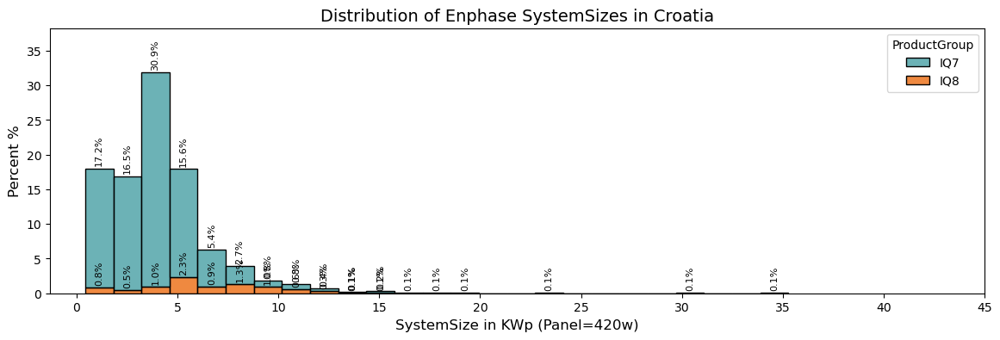

In [362]:
print('Since 2021 we activated {0} systems in Croatia.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Croatia')

## IC Activation

In [363]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Croatia", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
185,24-40,69,62,79
186,24-41,79,65,71
187,24-42,124,82,74
188,24-43,45,79,74
189,24-44,103,88,72


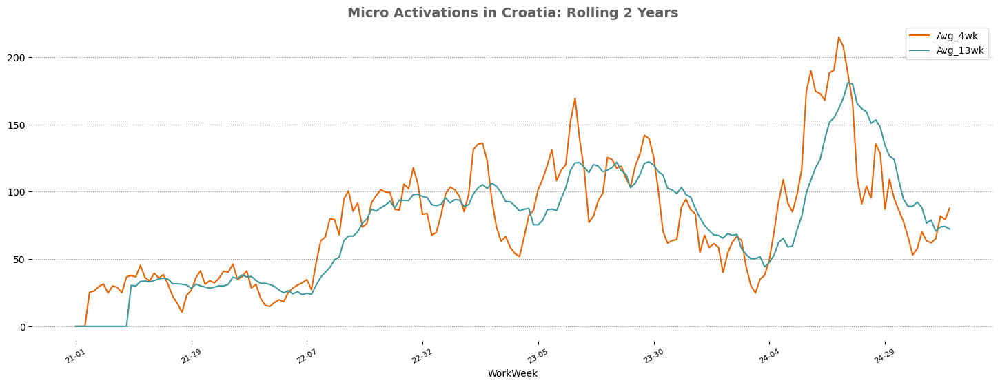

In [364]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Croatia: Rolling 2 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -200.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


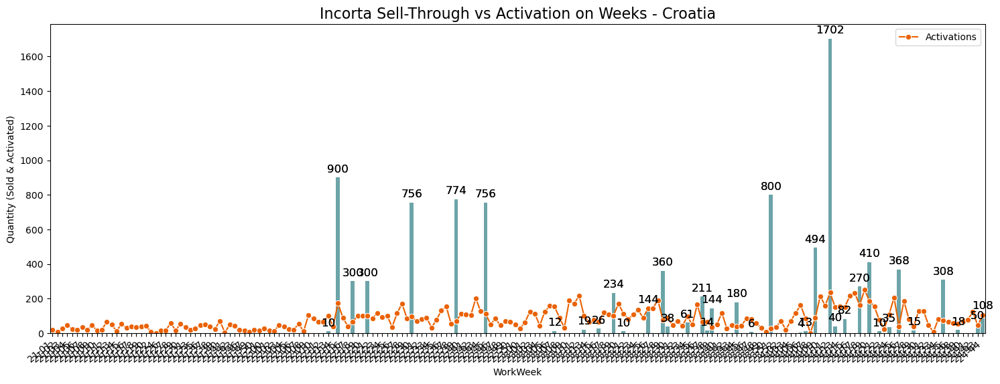

In [365]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left')

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Croatia', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,326,491
38,24-03,815,"1,762"
39,24-04,832,352
40,24-05,736,420
41,24-06,394,403
42,24-07,526,15
43,24-08,252,308
44,24-09,191,18
45,24-10,408,158
46,24-11,26,NaN


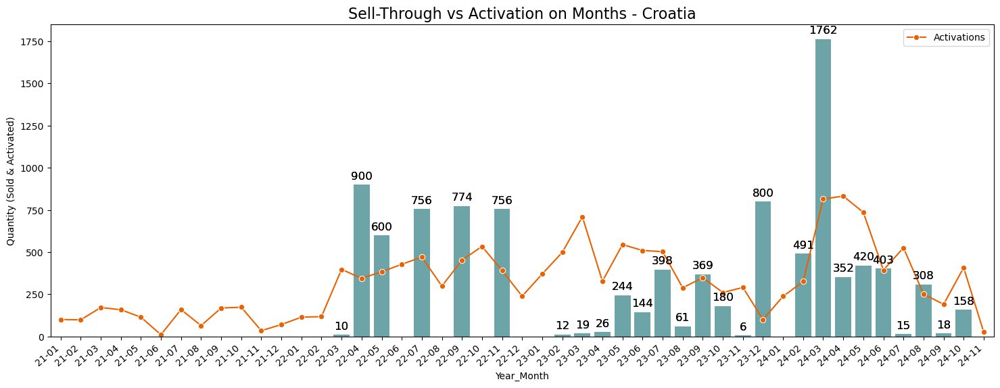

In [366]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Croatia', 'Year_Month', orange)

<a id='Spain'></a>
# 13. Spain

# Spain Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [367]:
Country = 'ES'

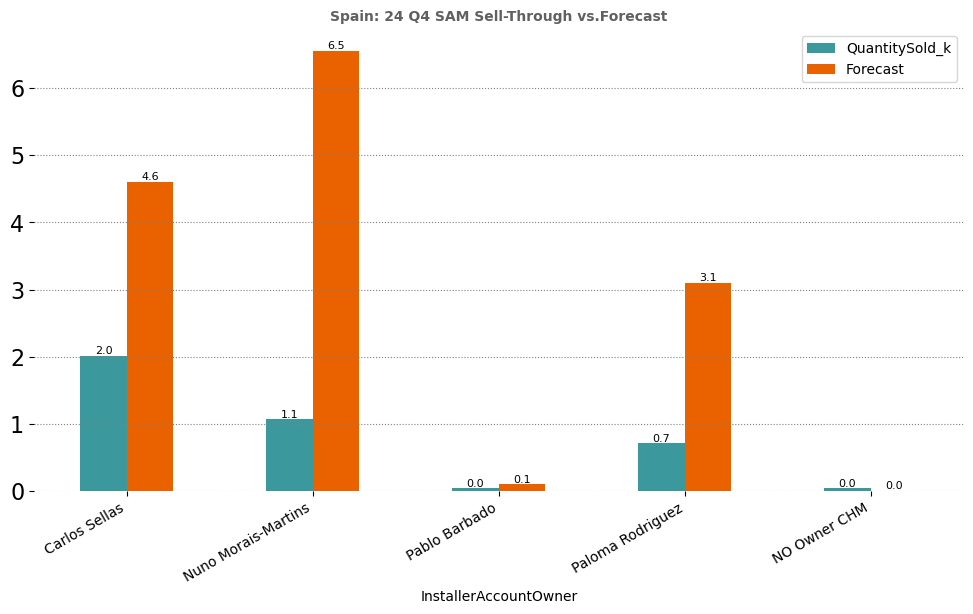

In [368]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Spain: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

By today Spain sold 4.01k micro units.
By today Spain is -1.55k units above/below the quarterly goal.
As a result Spain met 72.11% of its BOQ forecast for the recent quarter.


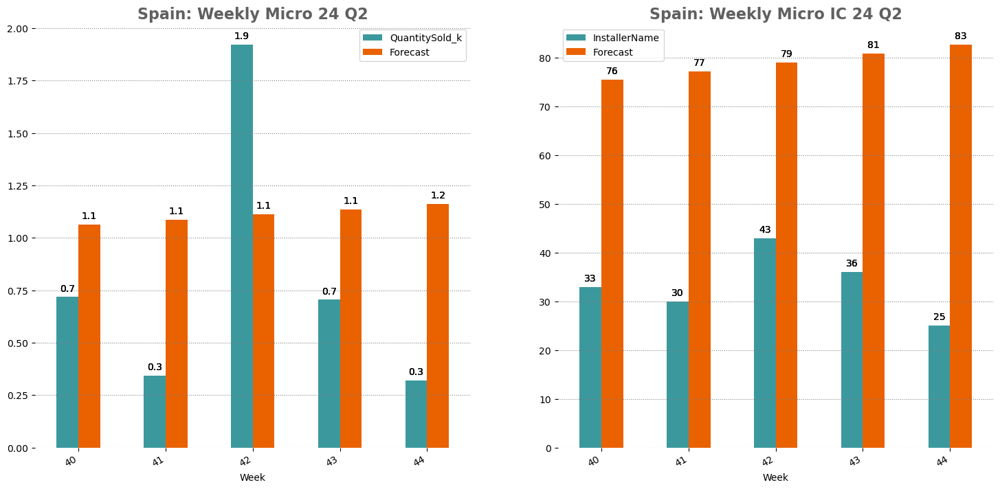

In [369]:
df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####

# Sell-Through Micro
df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Spain: Weekly Micro 24 Q2", "Spain: Weekly Micro IC 24 Q2", orangeteal)
print('By today Spain sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
print('By today Spain is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
print('As a result Spain met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

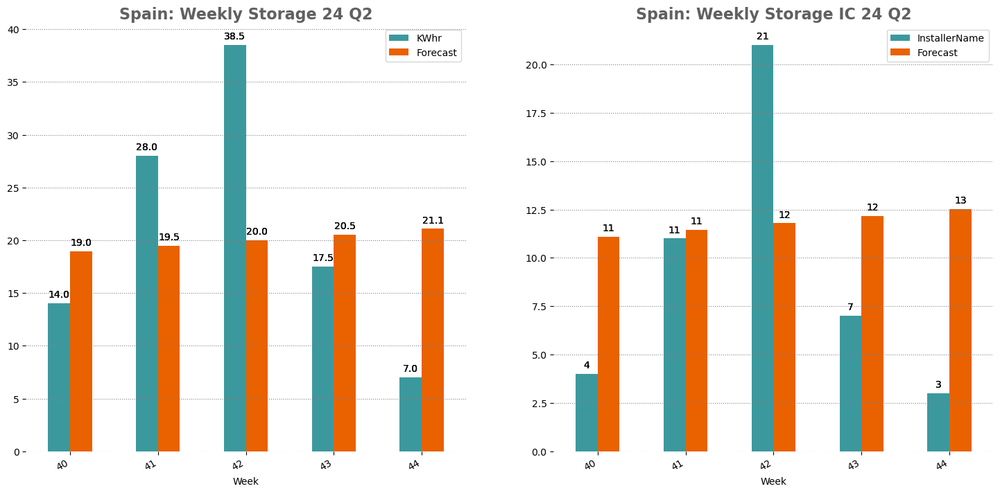

In [370]:
df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# Sell-Through Micro
df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
df_ST['Forecast'] = Forecast

#####IC####
# Sell-Through Micro
df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

#Exponential growth of forecast:
Forecast = []
for i in range(0, 13): 
    Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
                     (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
df_IC['Forecast'] = Forecast


eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Spain: Weekly Storage 24 Q2", "Spain: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

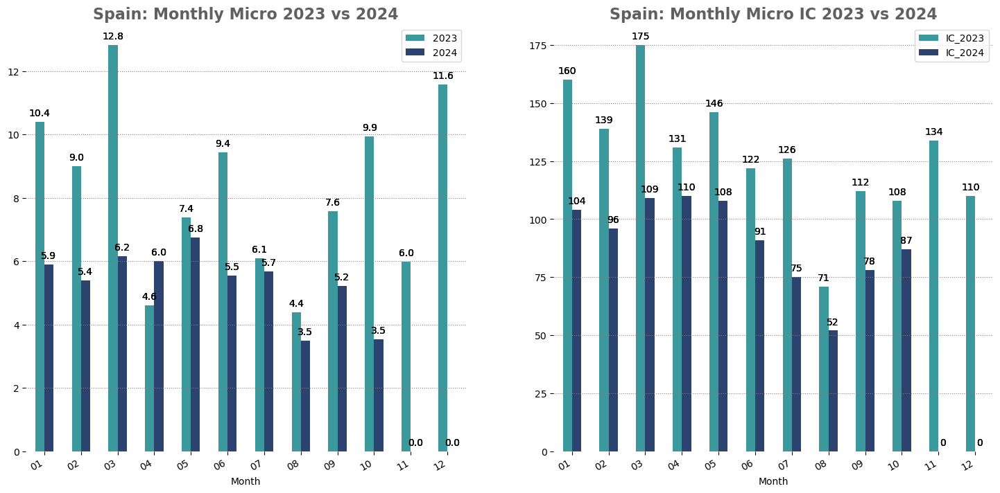

In [371]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Spain: Monthly Micro 2023 vs 2024", "Spain: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

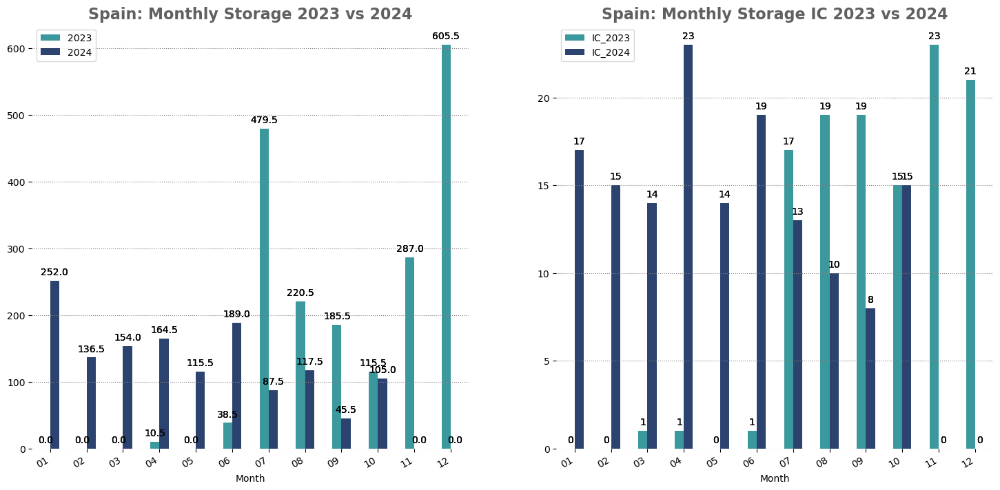

In [372]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Spain: Monthly Storage 2023 vs 2024", "Spain: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

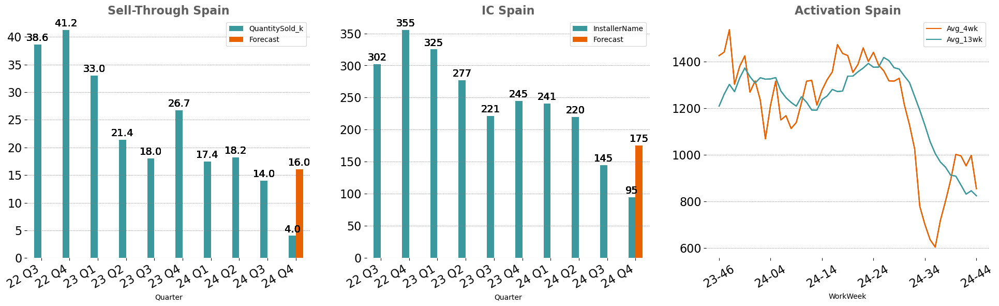

In [373]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Spain", "IC Spain", "Activation Spain")

#### Storage

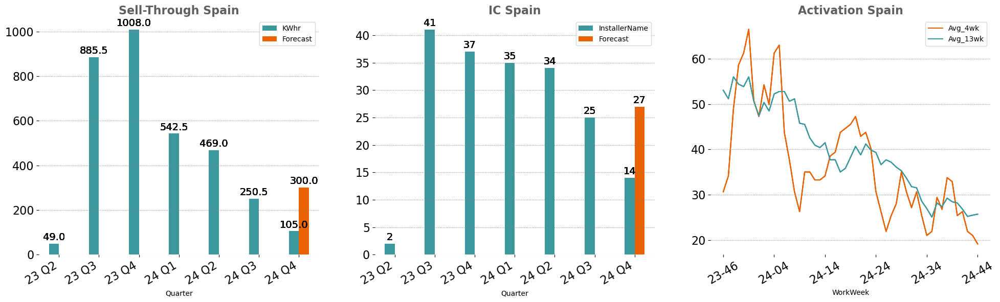

In [374]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Spain", "IC Spain", "Activation Spain")

## Spain Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [375]:
print("20 Biggest Installer Spain (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Spain (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
3973,ES,Carlos Sellas,1KOMMA5º,2403563,3,0,0,0,0,540,"1,370","4,620","1,332",0,0,0,0,18,24,0,0,0,0,0,0,383,"1,975","1,261",501,"7,862",15,19,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
4446,ES,Nuno Morais-Martins,HogarSolar,2528727,8,0,0,0,0,476,"1,976","2,007",109,0,0,0,0,0,0,0,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"4,568",5,35,1,nan%,NaN,NaN,NaN,NaN,NaN,NaN
4807,ES,Nuno Morais-Martins,SENERCO,1695155,3,"1,648",713,"1,349","2,214","1,934","3,027","1,278",0,0,0,10,28,49,32,10,0,"1,414","1,327",333,598,174,130,195,94,"6,239",12,19,0,232.36%,550,"3,000","3,000","2,000","3,000","3,000"
4374,ES,Nuno Morais-Martins,"GEESOL RENOVABLES, S.L.",1764647,1,"1,618",600,"1,018",0,600,"1,433",600,300,0,0,14,0,0,0,21,10,"2,228","1,095",817,"1,534","1,518","1,475",870,316,"2,933",5,22,1,52.17%,"1,150","1,200","1,600","1,600","1,600","1,600"
4977,ES,Paloma Rodriguez,TRESA ENERGIA S.L (PERFECTA ENERGÍA),1583200,5,"1,142",901,777,652,"1,012","1,057",546,232,0,0,24,49,56,91,7,28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"2,847",6,17,1,49.64%,"1,100","1,400","1,200","1,200","1,800","1,800"
4915,ES,Carlos Sellas,Solfy Renewables SL,2574974,2,278,359,168,506,357,346,466,128,0,0,10,46,0,10,18,0,325,349,247,404,375,321,455,141,"1,297",4,13,1,77.67%,600,800,"1,000",700,"1,000","1,000"
4227,ES,Carlos Sellas,"ELECTROFLUXE, SL",1809881,3,0,0,0,0,0,116,253,0,0,0,0,0,0,7,0,0,578,200,461,314,200,226,180,37,369,0,27,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
4593,ES,Nuno Morais-Martins,Lidera Comercializadora Energía S.L.,2898484,5,14,32,20,0,0,491,251,0,0,0,0,0,0,0,0,0,14,32,0,8,0,248,407,49,742,NaN,0,0,inf%,0,0,0,0,0,0
4753,ES,Nuno Morais-Martins,QUANTUM ENERGIA VERDE SLU,1754285,4,0,0,0,0,288,510,249,300,0,0,0,0,4,21,0,0,323,565,436,410,465,433,282,89,"1,347",6,8,1,inf%,0,0,0,0,0,0
4899,ES,Carlos Sellas,Solar in Spain,96102,1,0,0,0,0,0,190,236,111,0,0,0,0,10,0,42,0,10,0,0,44,54,185,226,56,537,2,13,1,78.67%,300,0,0,0,0,0


#### Customer Heatmap Spain:

In [376]:
EXTALL.query("InstallerCountry == @Country")

,InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
19,ES,Iberdrola España,Paloma Rodriguez,1713916,30,71429,0,0,0,0,24-03,800,0,800,0,0,0,0,0,0,0,0,0,0,0,0
29,ES,Octopus Energy (Spain),Carlos Sellas,3573030,24,57143,0,11,7,4,24-30,4,0,0,0,4,0,5,0,0,0,-100,200,200,0,0
33,ES,"SOTYSOLAR (BE ENERGY PART, S.L.)",Paloma Rodriguez,1714504,20,47619,2,2886,645,737,24-44,36,29,237,165,176,141,0,0,0,0,0,515,515,0,1
36,ES,Endesa,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
64,ES,MAS SOL ENERGÍA,0,0,15,35714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6348,ES,Integra Energia,0,0,0,952,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6373,ES,Electricitat Germans Puig,Carlos Sellas,2641866,0,952,3,24,0,24,24-21,24,0,0,24,0,0,0,0,0,0,0,0,0,0,0
6397,ES,"GEF GREEN, S.L.",0,0,0,952,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6449,ES,Instalaciones Eléctricas MAS,Paloma Rodriguez,2132926,0,952,1,12,0,12,24-39,12,-100,0,0,12,0,0,0,0,0,0,0,0,0,0


In [377]:
Country = 'ES'

In [378]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
ES,All,All,All,357,973046,6,102862,23754,37419,24-45,272,2,8850,14639,12236,3128,3143,4004,2769,909,82,7338,7338,0,1
ES,Iberdrola España,Paloma Rodriguez,1713916,30,71429,0,0,0,0,24-03,800,0,800,0,0,0,0,0,0,0,0,0,0,0,0
ES,Octopus Energy (Spain),Carlos Sellas,3573030,24,57143,0,11,7,4,24-30,4,0,0,0,4,0,5,0,0,0,-100,200,200,0,0
ES,"SOTYSOLAR (BE ENERGY PART, S.L.)",Paloma Rodriguez,1714504,20,47619,2,2886,645,737,24-44,36,29,237,165,176,141,0,0,0,0,0,515,515,0,1
ES,Endesa,0,0,20,47619,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ES,MAS SOL ENERGÍA,0,0,15,35714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ES,EDP España,Paloma Rodriguez,1713919,15,35714,0,130,0,0,23-10,14,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ES,1KOMMA5º,Carlos Sellas,2403563,15,35714,25,7880,0,7880,24-42,1332,26,540,1370,4620,1332,192,988,630,250,416,0,0,0,0
ES,SENERCO,Nuno Morais-Martins,1695155,12,28571,26,16527,5950,6321,24-39,504,-100,1934,3027,1278,0,87,65,98,47,-25,610,610,0,0
ES,Samara,0,0,10,23810,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


#### Customer Heatmap Carlos:

In [379]:
#EXTALL.query("InstallerAccountOwner == 'Carlos Sellas'").head(20).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

#### Customer Heatmap Nuno:

In [380]:
#EXTALL.query("InstallerAccountOwner == 'Nuno Morais-Martins'").head(20).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

#### Customer Heatmap Paloma:

In [381]:
#EXTALL.query("InstallerAccountOwner == 'Paloma Rodriguez'").head(20).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [382]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Spain_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 31870 systems in Spain.


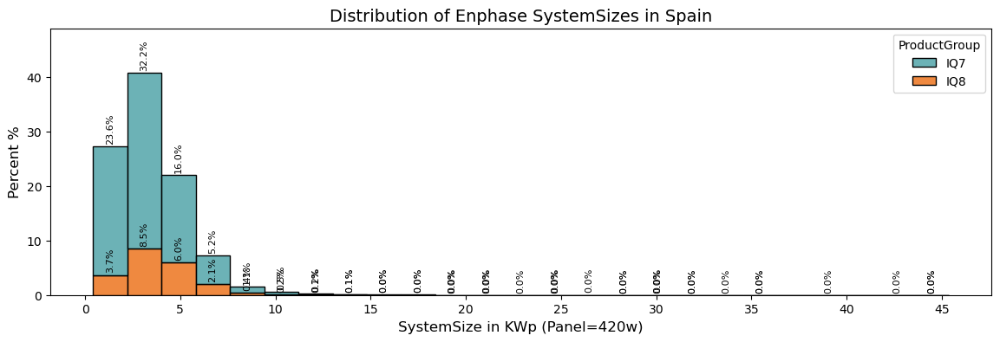

In [383]:
print('Since 2021 we activated {0} systems in Spain.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Spain')

## IC Activation

In [384]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Spain", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,1183,"1,002",908
197,24-41,790,995,870
198,24-42,837,952,831
199,24-43,1178,997,846
200,24-44,615,855,824


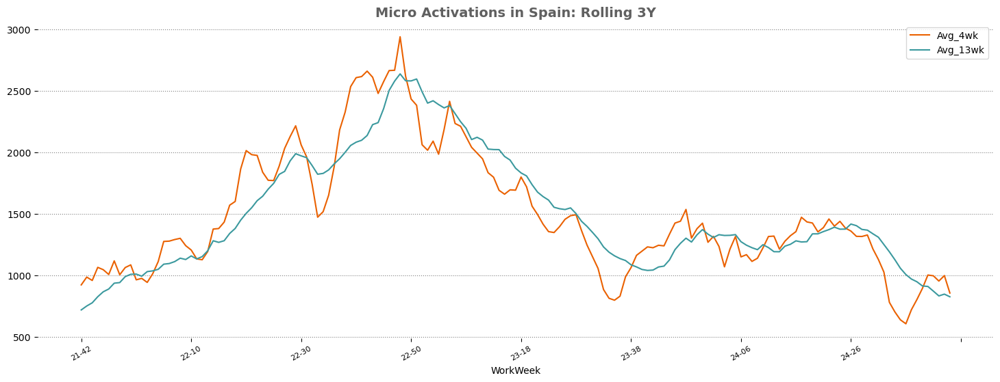

In [385]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Spain: Rolling 3Y", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -1802.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


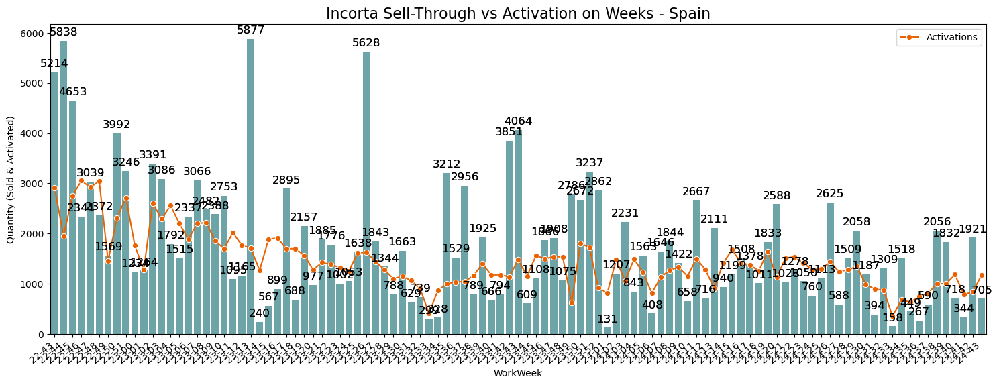

In [386]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Spain', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,4775,"5,393"
38,24-03,5259,"6,152"
39,24-04,6412,"6,008"
40,24-05,6489,"6,755"
41,24-06,5515,"5,548"
42,24-07,5393,"5,680"
43,24-08,2903,"3,490"
44,24-09,3887,"5,222"
45,24-10,4232,"3,532"
46,24-11,214,NaN


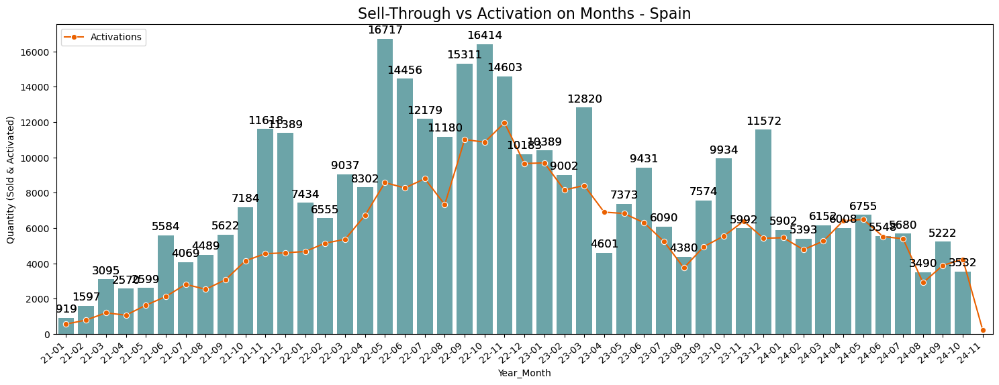

In [387]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Spain', 'Year_Month', orange)

In [388]:
InstallerActivation = dfA.query("Quarter >'24 Q1' & Country == @Country")
pd.crosstab(InstallerActivation.InstallerName, InstallerActivation.WorkWeek, values=InstallerActivation.Activations, aggfunc='sum', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False).head(30)

WorkWeek,24-14,24-15,24-16,24-17,24-18,24-19,24-20,24-21,24-22,24-23,24-24,24-25,24-26,24-27,24-28,24-29,24-30,24-31,24-32,24-33,24-34,24-35,24-36,24-37,24-38,24-39,24-40,24-41,24-42,24-43,24-44,24-45,Total
InstallerName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Total,"1,396","1,677","1,401","1,372","1,226","1,617","1,115","1,512","1,529","1,397","1,285","1,277","1,419","1,209","1,277","1,331",989,872,854,349,659,636,743,815,988,995,"1,173",790,828,"1,175",587,153,34646
1KOMMA5º,136,90,98,141,35,168,123,192,169,231,153,194,245,170,119,135,139,99,98,56,89,29,90,57,80,100,86,70,112,84,113,36,3737
Zerosolar,84,121,97,109,117,101,63,95,108,78,140,101,97,123,139,114,87,82,82,0,0,134,50,122,204,156,164,124,124,215,36,47,3314
"GEESOL RENOVABLES, S.L.",87,207,148,107,141,157,77,96,85,87,112,88,83,77,72,112,74,17,0,0,83,95,85,68,92,95,86,48,54,58,54,16,2661
F5 SOTOVOLTAICA - IDSUN,90,68,88,70,57,48,38,30,0,46,58,64,30,44,40,64,24,38,36,0,0,0,40,38,60,34,50,42,62,45,22,14,1340
Solfy Renewables SL,19,17,45,14,8,18,21,45,32,40,29,23,10,79,34,29,17,35,42,8,46,47,16,51,21,30,24,10,53,54,0,0,917
Zener,6,53,44,33,19,40,62,45,23,40,38,54,30,39,27,31,20,15,16,13,23,0,6,23,30,29,22,8,8,9,43,0,849
QUANTUM ENERGIA VERDE SLU,10,51,19,22,57,53,29,33,53,45,10,24,27,12,22,16,0,10,49,11,24,10,31,33,32,32,50,16,11,12,0,0,804
Lidera Comercializadora Energía S.L.,6,0,0,9,0,30,24,60,22,18,23,30,26,45,133,30,45,29,43,34,0,10,12,0,12,14,22,27,0,0,0,0,704


<a id='Portugal'></a>
# 14. Portugal

# Portugal Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [389]:
Country = 'PT'

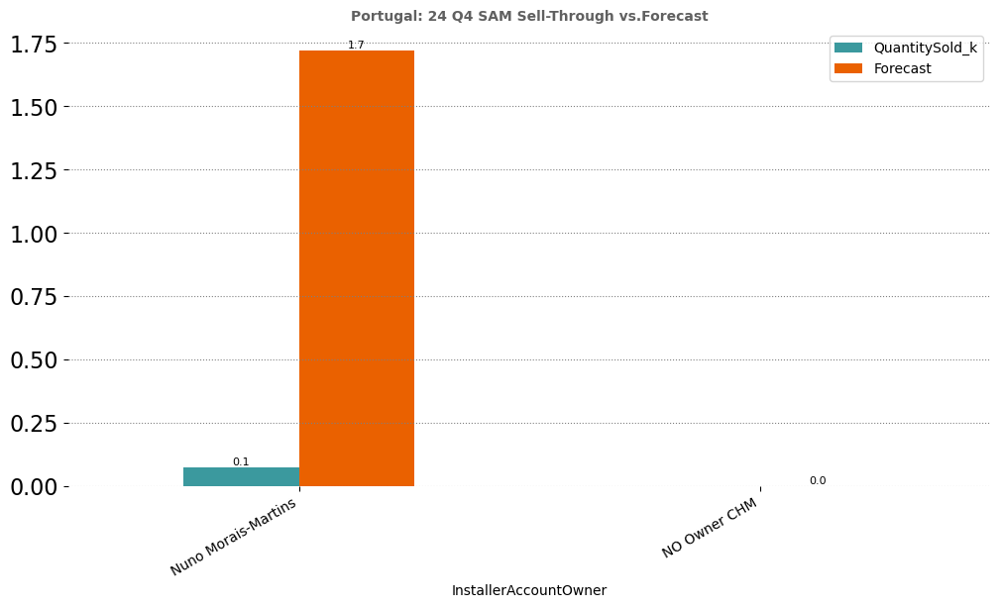

In [390]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Portugal: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

In [391]:
# df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# # Sell-Through Micro
# df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####

# # Sell-Through Micro
# df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Portugal: Weekly Micro 24 Q2", "Portugal: Weekly Micro IC 24 Q2", orangeteal)
# print('By today Portugal sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
# print('By today Portugal is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
# print('As a result Portugal met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

In [392]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Portugal: Weekly Storage 24 Q2", "Portugal: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

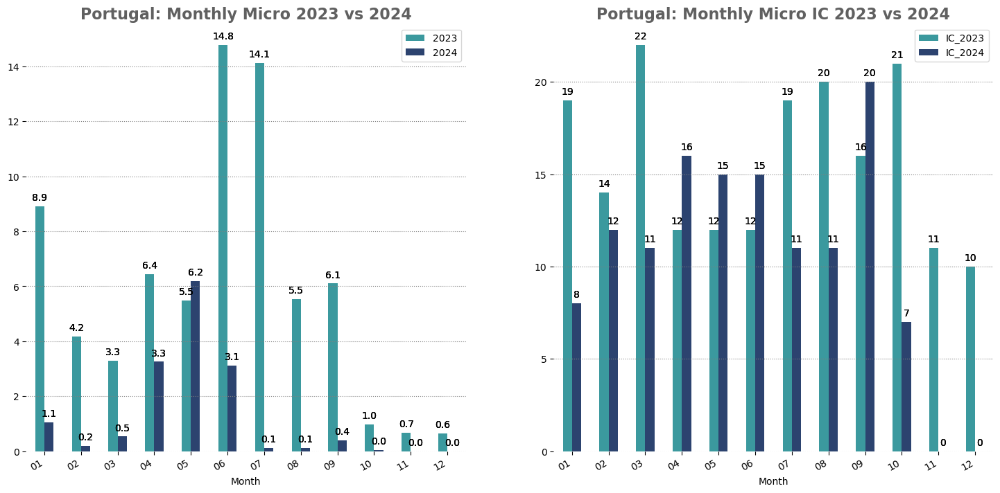

In [393]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Portugal: Monthly Micro 2023 vs 2024", "Portugal: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

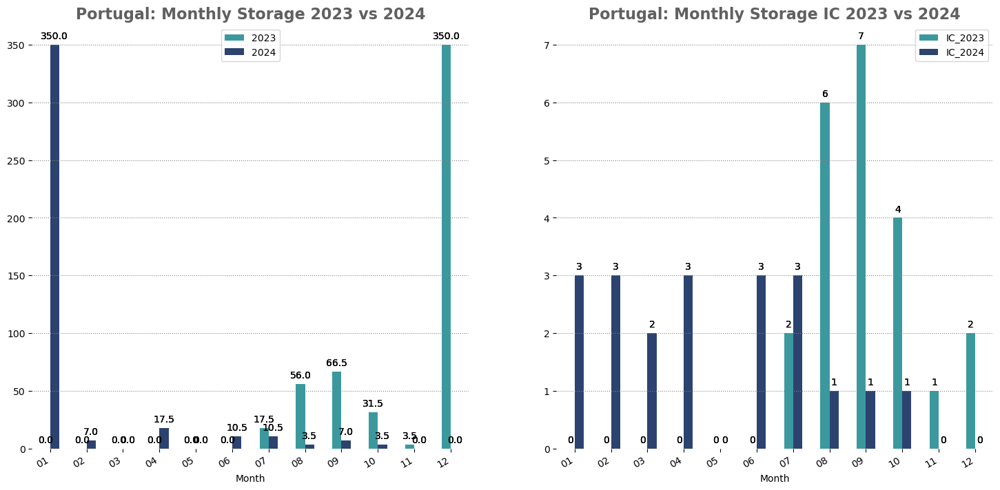

In [394]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Portugal: Monthly Storage 2023 vs 2024", "Portugal: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

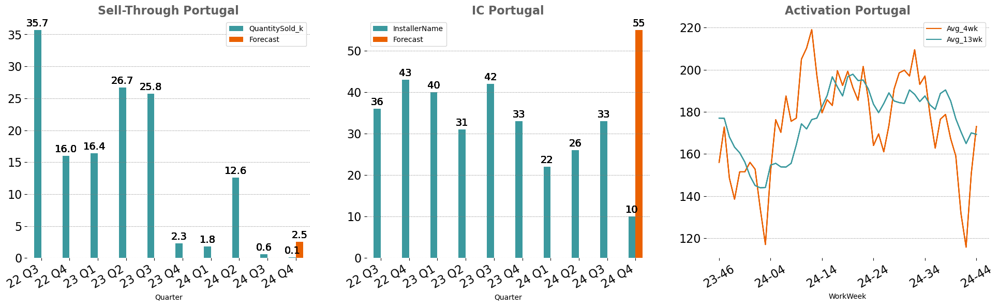

In [395]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Portugal", "IC Portugal", "Activation Portugal")

#### Storage

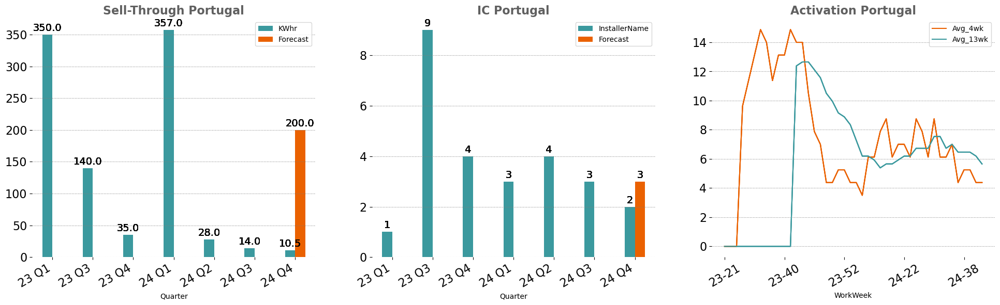

In [396]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Portugal", "IC Portugal", "Activation Portugal")

## Portugal Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [397]:
print("20 Biggest Installer Portugal (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Portugal (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
16703,PT,Nuno Morais-Martins,BRAGALUX,2100982,3,0,300,420,100,350,650,250,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,250",1,45,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16827,PT,Nuno Morais-Martins,"Sundeals - Energy Solutions, Lda",1351461,1,0,0,180,118,36,65,39,18,0,0,60,7,4,7,4,0,138,142,170,64,91,90,126,23,158,0,13,0,32.5%,120,150,150,150,150,150
16740,PT,Nuno Morais-Martins,Eficduarte unip. Lda,2919359,1,0,0,0,0,0,54,36,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16798,PT,NaN,Pedro Paiva,0,NaN,0,0,0,0,0,0,36,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16702,PT,Nuno Morais-Martins,"BORJA LOPEZ, UNIPESSOAL LDA",2458281,2,454,6,490,6,74,236,35,0,0,0,10,0,4,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,345,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16767,PT,Nuno Morais-Martins,HELIOLOGICS LDA,3072752,2,62,26,117,52,95,52,32,11,0,0,0,0,0,0,0,0,0,5,0,4,0,0,0,0,190,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16843,PT,Nuno Morais-Martins,Wondercom,2457712,2,0,0,0,0,0,86,25,0,0,0,0,0,0,0,0,0,377,202,77,21,0,0,0,0,111,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16704,PT,Nuno Morais-Martins,Bling Energy,4054750,3,0,0,0,6,3,6,19,4,0,0,0,0,0,0,0,0,0,0,0,6,0,0,0,0,32,2,1,0,inf%,0,0,0,0,0,0
16826,PT,Nuno Morais-Martins,Starenergy,3168880,1,0,0,0,0,0,0,18,0,0,0,0,0,0,0,4,0,49,83,44,2,0,0,0,0,18,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16694,PT,Nuno Morais-Martins,AZULAICO - COMERCIO DE MATERIAIS DE CONSTRUÇAO...,4761629,1,0,0,2,5,10,2,14,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [398]:
COUNTRYALL = EXTALL.query("InstallerCountry == @Country")

new_row = {'InstallerCountry': Country, 'InstallerName':'All', 'InstallerAccountOwner': 'All', 'InstallerKey':'All', 'PV_TAM': COUNTRYALL.PV_TAM.sum(), 'PV_TAM_Units': COUNTRYALL.PV_TAM_Units.sum(), 'Enph_SoW%':round(COUNTRYALL['Enph_SoW%'].mean(),0),
           'ST_Total':COUNTRYALL.ST_Total.sum(), 'ST_23':COUNTRYALL.ST_23.sum(), 'ST_24': COUNTRYALL.ST_24.sum(), 'LastOrderWk': CurrWW, 'LastOrderQty': COUNTRYALL.query("LastOrderWk == @LastWW").LastOrderQty.sum(), 'Wkly_Trend%':round(COUNTRYALL['Wkly_Trend%'].mean(),0), 
           'Q124_ST':COUNTRYALL.Q124_ST.sum(), 'Q224_ST':COUNTRYALL.Q224_ST.sum(), 'Q324_ST': COUNTRYALL.Q324_ST.sum(), 'Q424_ST': COUNTRYALL.Q424_ST.sum(), 
           '24Q1_Acti': COUNTRYALL['24Q1_Acti'].sum(), '24Q2_Acti': COUNTRYALL['24Q2_Acti'].sum(), '24Q3_Acti': COUNTRYALL['24Q3_Acti'].sum(), '24Q4_Acti': COUNTRYALL['24Q4_Acti'].sum(),
           'Activation_Trend%': COUNTRYALL['Activation_Trend%'].mean(), 'BOQ': COUNTRYALL.BOQ.sum(), 'EOQ': COUNTRYALL.EOQ.sum(), 'Delta': COUNTRYALL.Delta.sum(), 'SPA': COUNTRYALL.SPA.max()}

COUNTRYALL = COUNTRYALL.append(new_row, ignore_index=True)
COUNTRYALL['Enph_SoW%'] = COUNTRYALL['Enph_SoW%'].astype('int')
COUNTRYALL['Wkly_Trend%'] = COUNTRYALL['Wkly_Trend%'].astype('int')
COUNTRYALL['Activation_Trend%'] = COUNTRYALL['Activation_Trend%'].astype('int')
COUNTRYALL.sort_values('PV_TAM', ascending = False).head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
PT,All,All,All,56,137616,4,63283,642,12338,24-45,0,-16,1087,11902,314,33,58,50,68,12,-5,1768,1768,0,0
PT,EDP Portugal,Nuno Morais-Martins,1482705,40,95238,12,45720,0,10080,24-26,2520,0,0,10080,0,0,0,0,0,0,0,0,0,0,0
PT,Galp Portugal,Nuno Morais-Martins,1714780,8,17857,7,10057,0,1093,24-25,180,0,668,1093,0,0,0,0,0,0,0,1048,1048,0,0
PT,"Gold Energy - Comercializadora de Energia, S.A.",0,0,3,7143,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,600,600,0,0
PT,Bling Energy,Nuno Morais-Martins,4054750,2,3571,1,38,6,32,24-41,4,-13,3,6,19,4,0,0,0,0,0,0,0,0,0
PT,Iberdrola Portugal,Nuno Morais-Martins,1483282,2,4286,0,4544,0,0,23-26,6980,0,0,0,0,0,0,0,0,0,0,0,0,0,0
PT,BRAGALUX,Nuno Morais-Martins,2100982,1,2381,44,1700,0,900,24-36,250,-100,350,650,250,0,0,0,0,0,0,0,0,0,0
PT,"Elergone Energia, Lda.",0,0,0,238,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
PT,Ertec,Nuno Morais-Martins,2452003,0,476,0,222,120,0,23-30,80,0,0,0,0,0,0,0,0,0,0,0,0,0,0
PT,"SOLARCOMBO - UNIPESSOAL, LDA",0,0,0,476,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [399]:
#EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

In [400]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Portugal_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 13572 systems in Portugal.


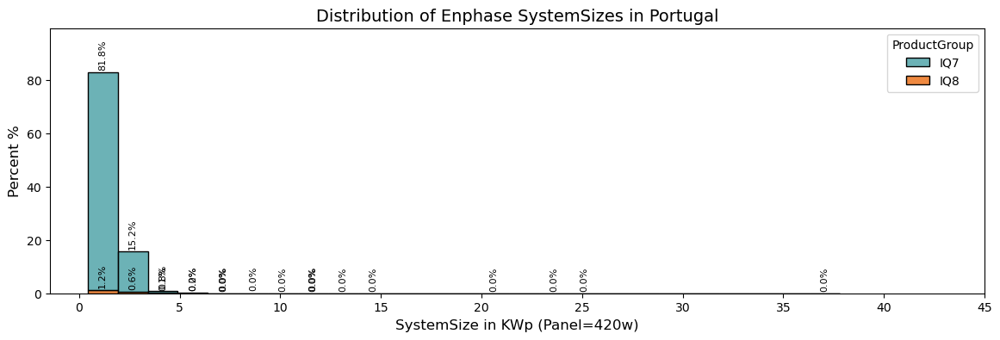

In [401]:
print('Since 2021 we activated {0} systems in Portugal.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Portugal')

## IC Activation

In [402]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Portugal", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
195,24-40,127,159,177
196,24-41,92,132,171
197,24-42,139,116,165
198,24-43,244,150,170
199,24-44,217,173,169


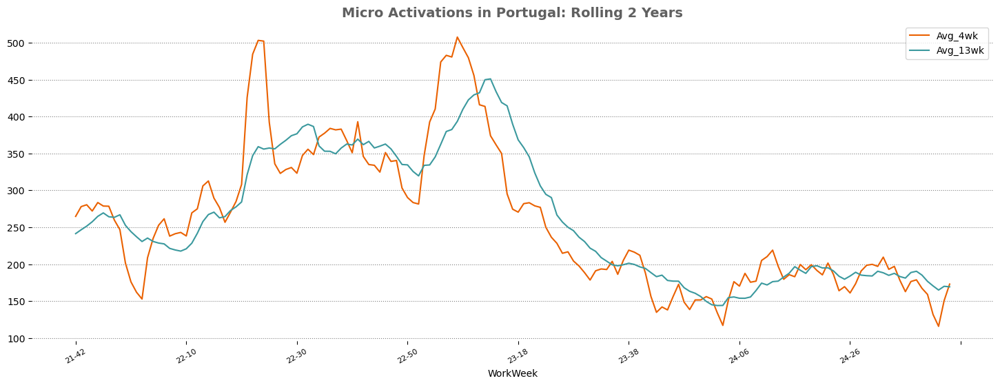

In [403]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Portugal: Rolling 2 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  852.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


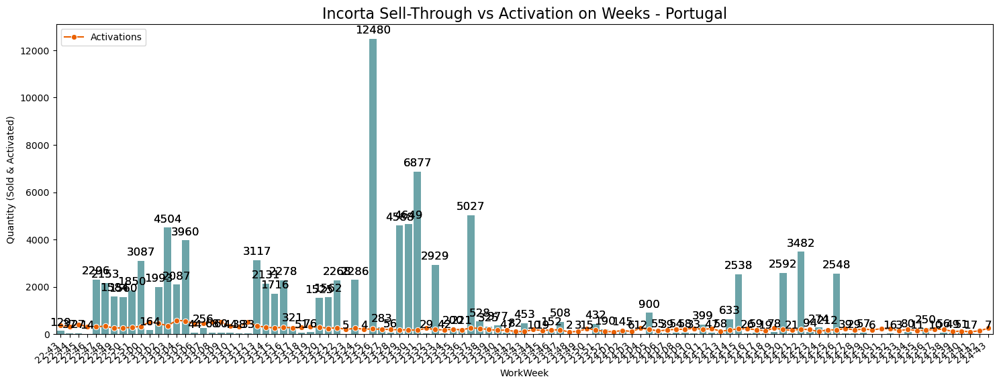

In [404]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Portugal', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,751,206
38,24-03,836,537
39,24-04,851,"3,257"
40,24-05,884,"6,191"
41,24-06,656,"3,128"
42,24-07,952,131
43,24-08,785,110
44,24-09,714,404
45,24-10,764,36
46,24-11,33,NaN


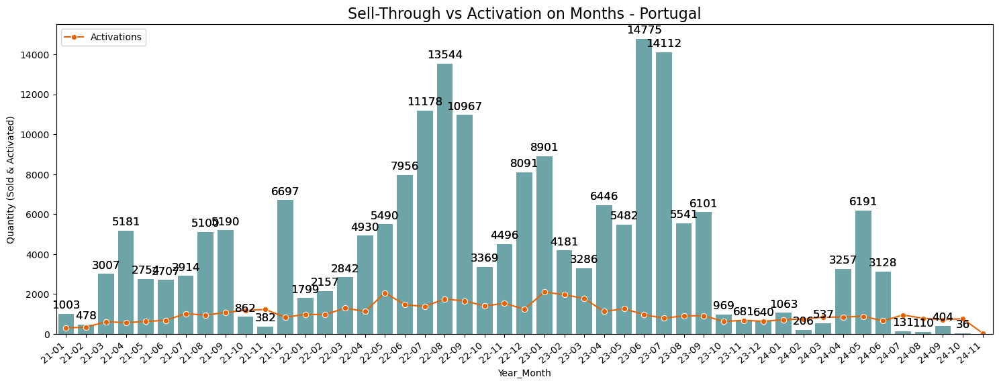

In [405]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Portugal', 'Year_Month', orange)

<a id='Sweden'></a>
# 15. Sweden

# Sweden Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [406]:
Country = 'SE'

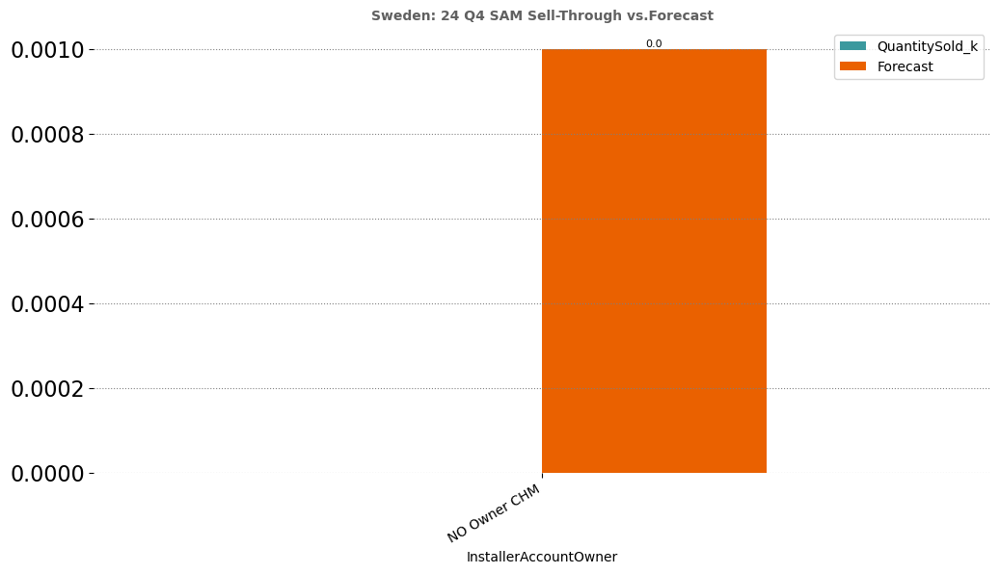

In [407]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Sweden: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

In [408]:
# df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# # Sell-Through Micro
# df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####

# # Sell-Through Micro
# df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Sweden: Weekly Micro 24 Q2", "Sweden: Weekly Micro IC 24 Q2", orangeteal)
# print('By today Sweden sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
# print('By today Sweden is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
# print('As a result Sweden met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

In [409]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Sweden: Weekly Storage 24 Q2", "Sweden: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

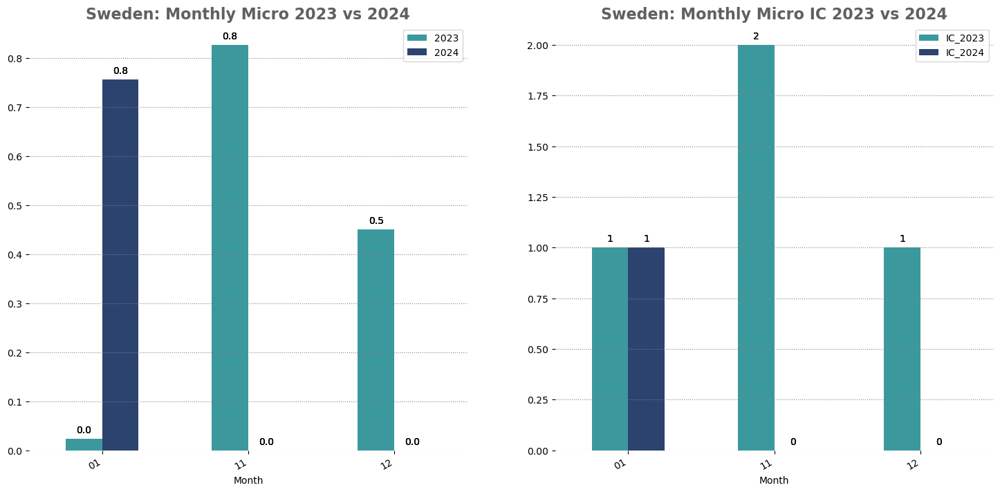

In [410]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Sweden: Monthly Micro 2023 vs 2024", "Sweden: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

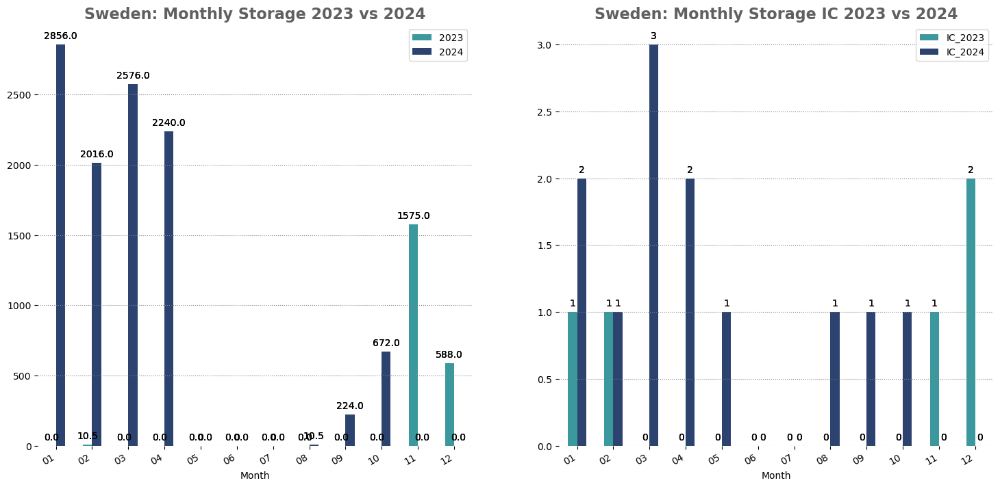

In [411]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Sweden: Monthly Storage 2023 vs 2024", "Sweden: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

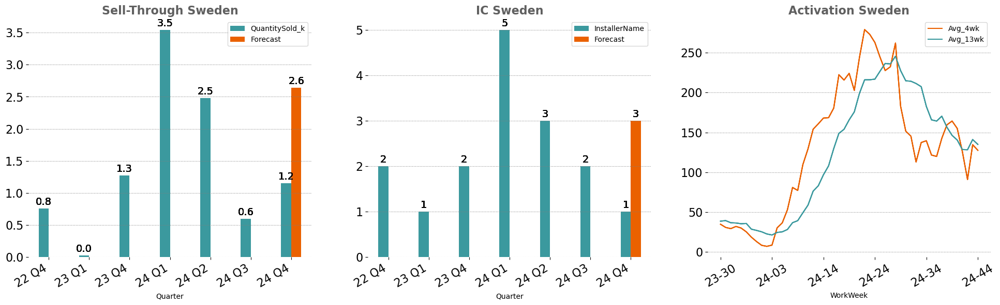

In [412]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Sweden", "IC Sweden", "Activation Sweden")

#### Storage

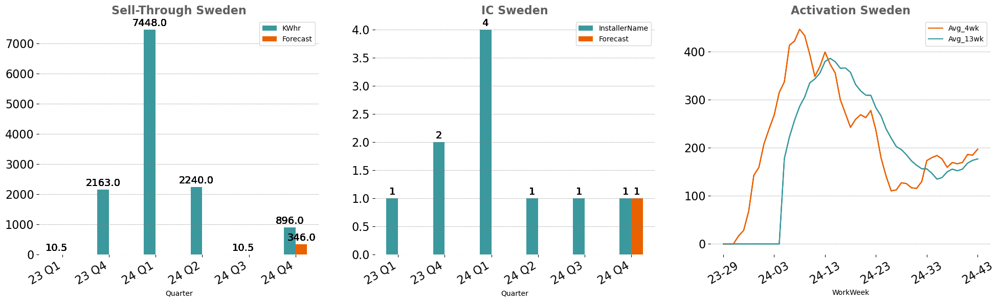

In [413]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Sweden", "IC Sweden", "Activation Sweden")

## Sweden Micro Ranking Tables:

Full Tables can be found on the Global CCO SharePoint in RankingsEMEA:  <br/> 
<br/> https://enphase.sharepoint.com/:f:/r/sites/CCOGroup730/Shared%20Documents/Sales%20Review%20Global

In [414]:
print("20 Biggest Installer Sweden (CQ)")
dfICIN.query("InstallerCountry == @Country").sort_values("Q324_ST", ascending = False).head(50)

20 Biggest Installer Sweden (CQ)


,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
16870,SE,Andreas Nicolet,1K5° Stockholm,0,NaN,0,0,0,"1,260","1,512","1,260",576,"1,152",0,0,0,"1,995","4,242",0,0,896,102,250,113,7,"1,066","3,052","1,840",594,"4,500",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16874,SE,Andreas Nicolet,Decasol AB,4544656,1,0,0,0,0,0,0,25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,25,0,25,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16868,SE,Jan Strecker,1K5° Hamburg,3967811,11,0,0,0,0,"1,260",0,0,0,0,0,0,0,"2,240",0,0,0,901,"1,285","1,924","1,932","3,123","3,365","2,004",831,"1,260",3,15,0,0.0%,450,450,450,450,450,450
16869,SE,NaN,1K5° Malmö,0,NaN,0,0,0,0,0,0,0,0,0,0,0,168,630,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16871,SE,Andreas Nicolet,1K5° Sweden,3967818,4,0,0,0,0,756,"1,188",0,0,0,0,0,0,336,"2,240",0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,944",NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16872,SE,NaN,AH ENERGY AB,0,NaN,0,0,0,16,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16873,SE,Andreas Nicolet,Belo Elektriska AB,592133,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16875,SE,NaN,"RS_SVEA RENEWABLE SOLAR AB, SOLLENTUNA, SE",0,NaN,24,0,0,0,0,0,0,0,10,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16876,SE,NaN,SOLELGROSSISTEN SVERIGE AB,4730673,1,0,0,0,0,0,32,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
16877,SE,Boomi FullUser,Solar Cellect AB,4809533,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,10,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


#### Customer Heatmap

In [415]:
EXTALL.query("InstallerCountry == @Country").head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100).hide()

InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
SE,Svea Solar AB,0,0,200,476190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Cell Solar Nordic AB,0,0,15,35714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Soltech Sales,0,0,5,11905,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Nordic Solar Sweden AB,0,0,4,9524,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Brael Norden AB,0,0,0,1190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,NP Gruppen AB,0,0,0,714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Enable Energy SVE,0,0,0,476,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SE,Sunny Future AB,0,0,0,1190,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [416]:
# SAM = list(df.query("InstallerCountry == @Country").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
# LAST = eda.CustHealth(df,df_TAM,SAM)
# CURR = eda.CurrCustHealth(df,SAM)
# EXT = eda.ExtCustHealthColour(CURR, LAST, dffInstaller, dfkeys, SAM, dfICIN, SPA)
# EXT.to_excel("EMEA/Sweden_CustomerHealth.xlsx",encoding='utf-8-sig',index=False)
# EXT.head(50).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100)

# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 438 systems in Sweden.


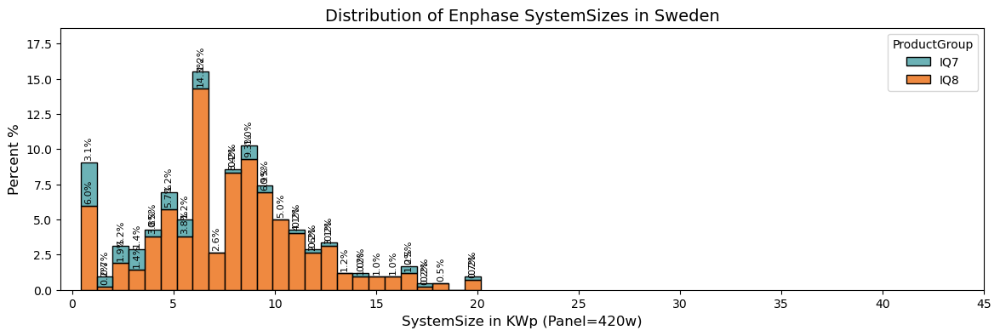

In [417]:
print('Since 2021 we activated {0} systems in Sweden.'.format(dfA.query("Country in @Country").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Sweden')

## IC Activation

In [418]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Sweden", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
74,24-40,101,155,140
75,24-41,119,126,128
76,24-42,44,91,128
77,24-43,274,134,141
78,24-44,73,128,135


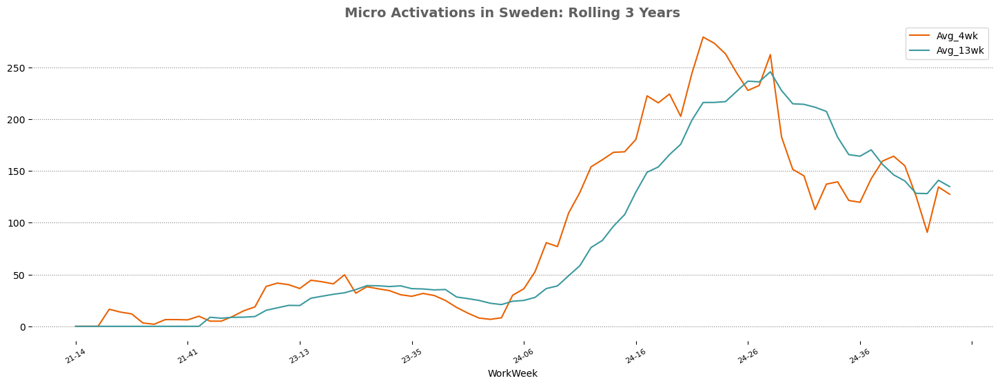

In [419]:
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Sweden: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -637.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


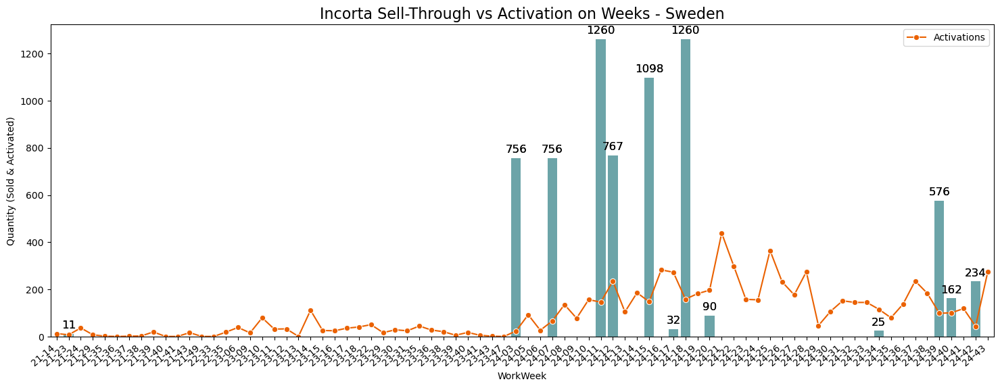

In [420]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Country")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Sweden', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
20,24-02,373,756
21,24-03,657,"2,027"
22,24-04,989,"2,390"
23,24-05,1176,90
24,24-06,912,NaN
25,24-07,674,NaN
26,24-08,570,25
27,24-09,696,738
28,24-10,572,990
29,24-11,19,NaN


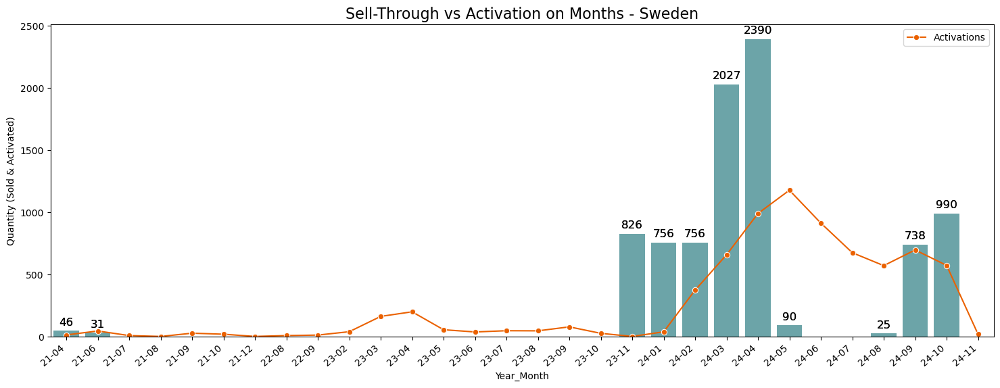

In [421]:
dfAC = dfA.query("Country == @Country").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Sweden', 'Year_Month', orange)

<a id='Denmark'></a>
# 16. Denmark

# Denmark Sell through cycles
SellThrough on weeks, months, quarters

### ST on weeks
#### Microinverter:

In [422]:
Country = 'DK'

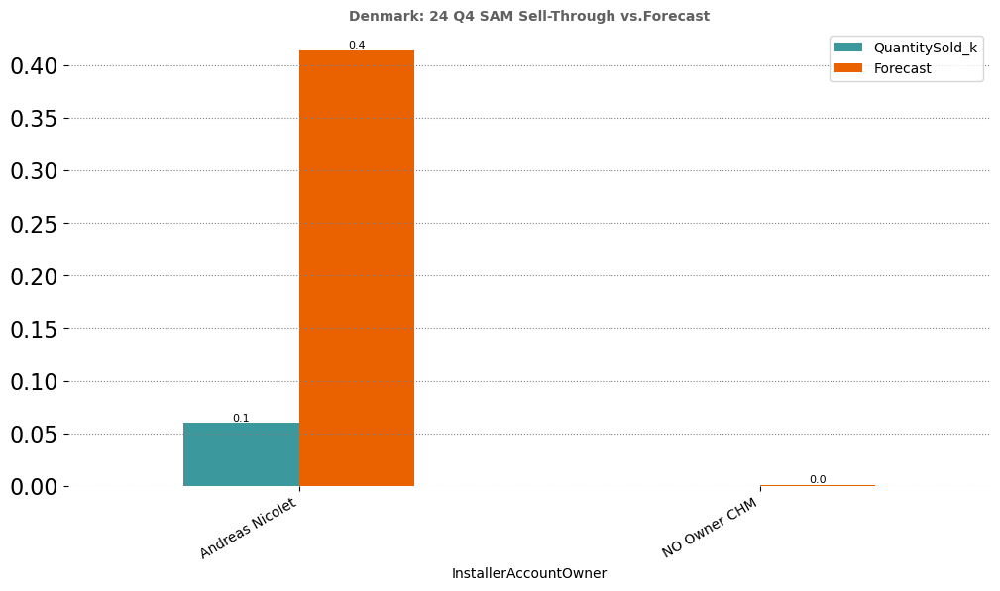

In [423]:
SAM = list(df.query("ProductType == 'Microinverter' & InstallerCountry == @Country & Quarter == @Current").groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().InstallerAccountOwner)
df_SAM = fcst.SAM_POS(df, dff, Country, 'Microinverter', SAM, Current)

new_row = {'InstallerAccountOwner':'NO Owner CHM', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'No Owner CHM' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}
#new_row2 = {'InstallerAccountOwner':'Jan Roschek', 'QuantitySold_k' : df.query("InstallerCountry == @Country & InstallerAccountOwner == 'Jan Roschek' & ProductType == 'Microinverter' & Quarter == @Current").QuantitySold_k.sum(), 'Forecast' : 0.001}

df_SAM = df_SAM.append(new_row, ignore_index=True)
#df_SAM = df_SAM.append(new_row2, ignore_index=True)

eda.SAM_barchart(df_SAM, 'QuantitySold_k', "Denmark: 24 Q4 SAM Sell-Through vs.Forecast", (12,6))

In [424]:
# df_m = df.query("ProductType == 'Microinverter' & Quarter == @Current & InstallerCountry == @Country")

# # Sell-Through Micro
# df_ST = df_m.groupby(["Week"], as_index=False)["QuantitySold_k"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0])/13))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
    
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####

# # Sell-Through Micro
# df_IC = df_m.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "QuantitySold_k", "Forecast", "InstallerName", "Forecast", "Denmark: Weekly Micro 24 Q2", "Denmark: Weekly Micro IC 24 Q2", orangeteal)
# print('By today Denmark sold {0}k micro units.'.format(round(sum(df_ST.QuantitySold_k),2)))
# print('By today Denmark is {0}k units above/below the quarterly goal.'.format(round(sum(df_ST.QuantitySold_k)-sum(df_ST.Forecast),2)))
# print('As a result Denmark met {0}% of its BOQ forecast for the recent quarter.'.format(round((sum(df_ST.QuantitySold_k)/sum(df_ST.Forecast))*100, 2)))

#### Storage:

In [425]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Denmark: Weekly Storage 24 Q2", "Denmark: Weekly Storage IC 24 Q2", orangeteal)


### SellThrough on months
#### Microinverter:

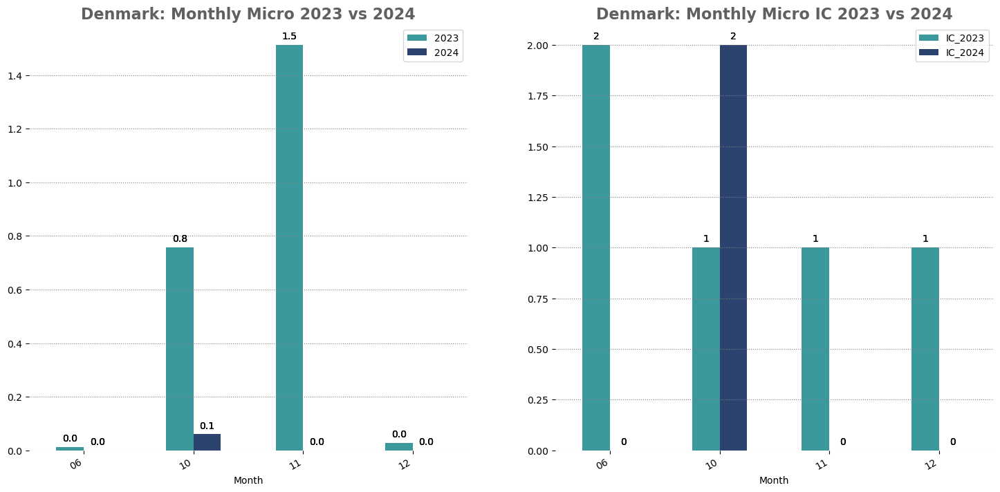

In [426]:
Countries 
df_ST, df_IC = eda.YoY(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Denmark: Monthly Micro 2023 vs 2024", "Denmark: Monthly Micro IC 2023 vs 2024", blues)

#### Storage:

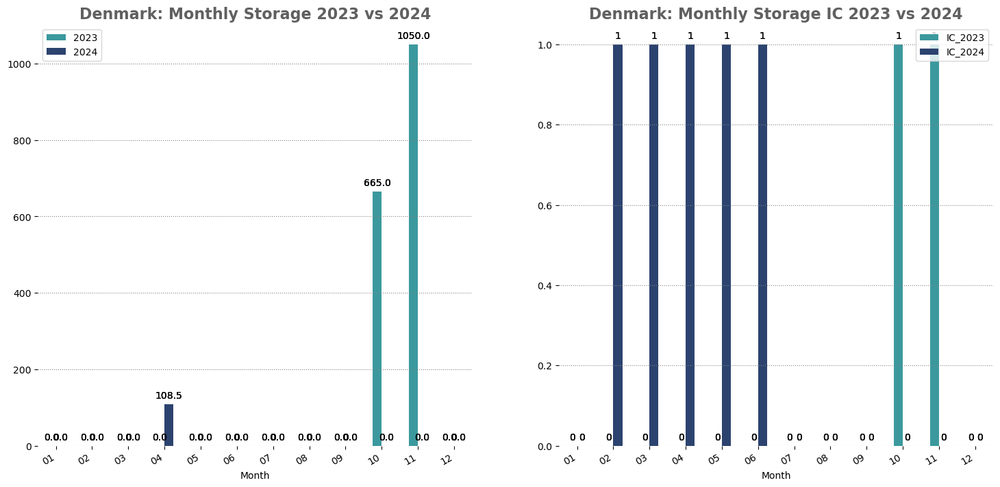

In [427]:
df_ST, df_IC = eda.YoYKWhr(df, Country)

eda.POS2Bar(df_ST, df_IC, "Month", "2023", "2024", "IC_2023", "IC_2024", "Denmark: Monthly Storage 2023 vs 2024", "Denmark: Monthly Storage IC 2023 vs 2024", blues)

### SellThrough on quarters:
#### Microinverter

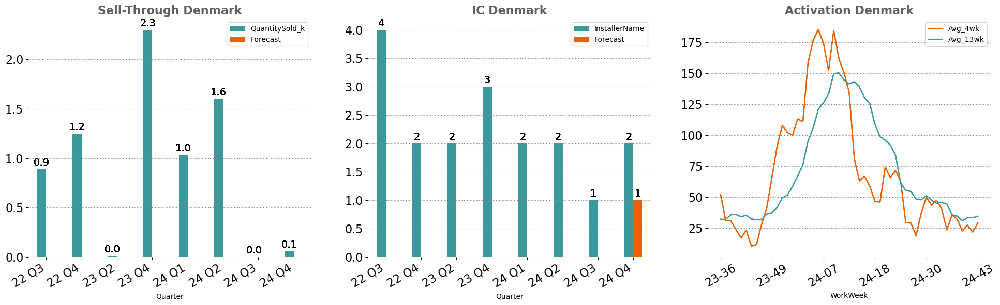

In [428]:
df_C = df.query("ProductType == 'Microinverter' & InstallerCountry == @Country")
df_C
# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["QuantitySold_k"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'POSSolarKu'].iloc[0]

# Installer Count Micro:
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# Activation Averages 
dfAC = dfA.query("Country == @Country")
dfAC = eda.Averages(dfAC, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfAC, 'Quarter', 'QuantitySold_k', 'InstallerName', "Sell-Through Denmark", "IC Denmark", "Activation Denmark")

#### Storage

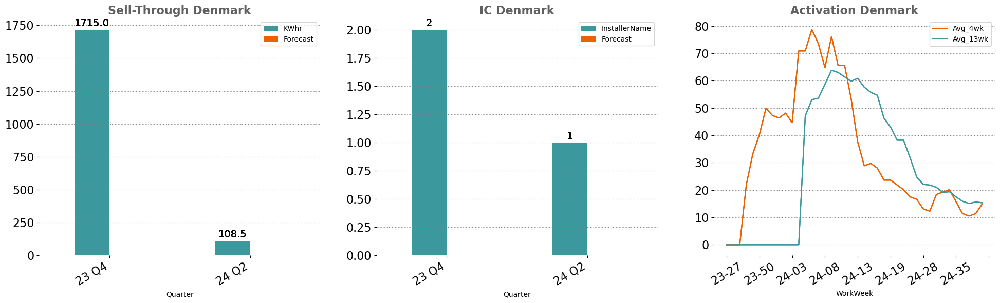

In [429]:
df_C = df.query("ProductType == 'Storage' & KWhr > 0 & InstallerCountry == @Country")

# Sell-Through Micro
df_ST = df_C.groupby(["Quarter"], as_index=False)["KWhr"].sum()

# Forecast from Indirect
df_ST['Forecast'] = 0
df_ST.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000

# Installer Count Storage
df_IC = df_C.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()
df_IC['Forecast'] = 0
df_IC.Forecast.iat[-1] =BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0]

# Activation Averages 
dfStEMEA = dfSt.query("InstallerCountry == @Country")
dfStEMEA = eda.Averages(dfStEMEA, "Activations").iloc[-52:-1]

# 3x1
eda.STICACT(df_ST, df_IC, dfStEMEA, 'Quarter', 'KWhr', 'InstallerName', "Sell-Through Denmark", "IC Denmark", "Activation Denmark")

In [440]:
# df_s = df.query("ProductType == 'Storage' & InstallerCountry == @Country & Quarter == @Current")

# # Sell-Through Micro
# df_ST = df_s.groupby(["Week"], as_index=False)["KWhr"].sum()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageMWh'].iloc[0]*1000)/13))/
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthM'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_ST)]
# df_ST['Forecast'] = Forecast

# #####IC####
# # Sell-Through Micro
# df_IC = df_s.groupby(["Week"], as_index=False)["InstallerName"].count()

# #Exponential growth of forecast:
# Forecast = []
# for i in range(0, 13): 
#     Forecast.append(((((BOQ.loc[BOQ['InstallerCountry'] == Country, 'StorageIC'].iloc[0])/2))/(1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(13-i) * 
#                      (1+(BOQ.loc[BOQ['InstallerCountry'] == Country, 'X_GrowthS'].iloc[0]/13))**(i)))
# Forecast = [x for index, x in enumerate(Forecast) if index < len(df_IC)]
# df_IC['Forecast'] = Forecast


# eda.POS2Bar(df_ST, df_IC, "Week", "KWhr", "Forecast", "InstallerName", "Forecast", "Poland: Weekly Storage 24 Q2", "Poland: Weekly Storage IC 24 Q2", orangeteal)


# Enlighten Stats: 
### Enphase Sys Sizes:

Since 2021 we activated 65598 systems in Rest of EMEA.


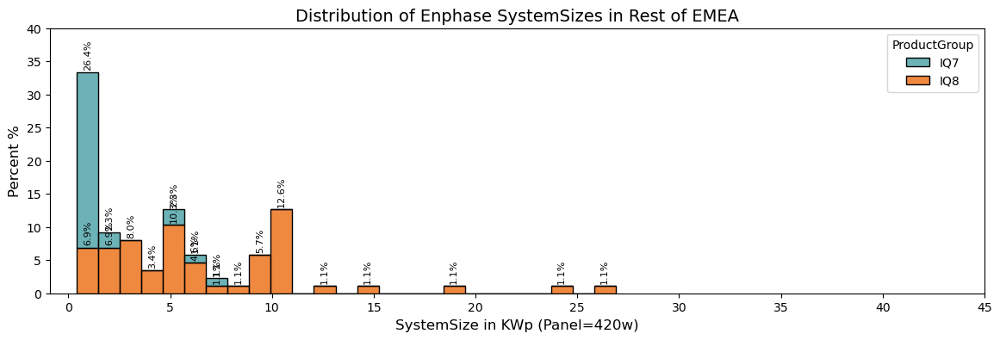

In [529]:
print('Since 2021 we activated {0} systems in Rest of EMEA.'.format(dfA.query("Country in @Countries").shape[0]))
eda.SysSizes(dfA, Country, 50, 25, 'Distribution of Enphase SystemSizes in Rest of EMEA')

## IC Activation

In [530]:
# dfAc = dfA.query("Country == @Country")
# df_I = dfAc.groupby(["Quarter"], as_index=False)["InstallerName"].nunique()

# # Installer Count Micro:
# df_I['Forecast'] = 0
# df_I.Forecast.iat[-1] = BOQ.loc[BOQ['InstallerCountry'] == Country, 'SolarIC'].iloc[0]

# eda.IC_barchart(df_I, "InstallerName", "IC Activations Rest of EMEA", "Quarter")

## Seasonality: 

4 and 13 weeks averages .


,WorkWeek,Activations,Avg_4wk,Avg_13wk
196,24-40,3574,"3,844","4,168"
197,24-41,3163,"3,550","4,064"
198,24-42,3554,"3,402","3,994"
199,24-43,4589,"3,720","4,039"
200,24-44,3656,"3,740","3,981"


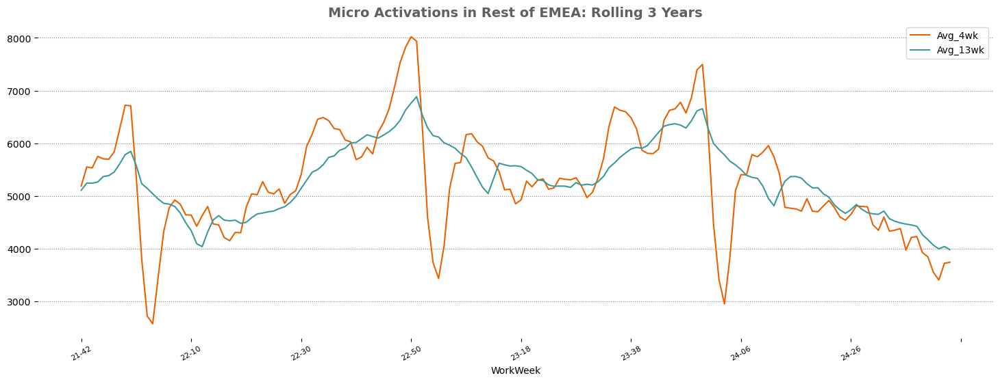

In [531]:
dfAC = dfA.query("Country == @Countries")
dfAC = eda.Averages(dfAC, "Activations").iloc[-160:-1]
eda.ActivationsWide(dfAC, "Micro Activations in Rest of EMEA: Rolling 3 Years", (18,6))
#dfAC.to_excel("EMEA/EMEA_Micro_Activation.xlsx",encoding='utf-8-sig',index=False)
print('4 and 13 weeks averages .'.format(dfAC.WorkWeek.iat[-1]))
dfAC.tail(5)

#### Activation vs. Sell-Through on weeks:

Since Incorta intro we activated  -48.0 micros more than we sold to installers.
Some possible explanations:
We could still be missing the reports to those transactions.
They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R


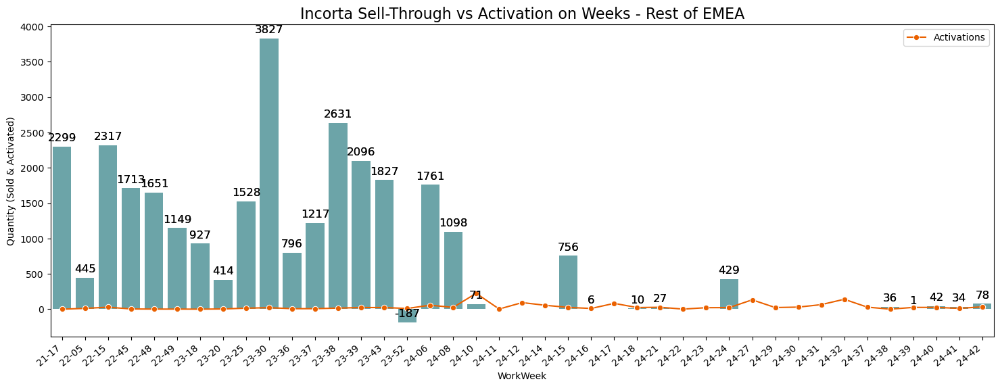

In [532]:
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerCountry == @Countries")

dfAC = dfA.query("Country == @Country & InvoiceDate > 2021 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left').iloc[-106:-1]

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Since Incorta intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-11:-1].Gap.sum()))
print('Some possible explanations:')
print('We could still be missing the reports to those transactions.')
print('They might not be loaded to incorta or we are reducing W.o.H. (Inventories). We could also have to many transactions flagged as R2R')

eda.Act_ST_Graphs(df_lag, 'Incorta Sell-Through vs Activation on Weeks - Rest of EMEA', (18,6), 1, "QuantitySold")

### Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
37,24-02,24542,"6,132"
38,24-03,22741,178
39,24-04,20543,772
40,24-05,22291,116
41,24-06,18773,429
42,24-07,20481,31
43,24-08,19138,66
44,24-09,16555,38
45,24-10,17004,154
46,24-11,1625,NaN


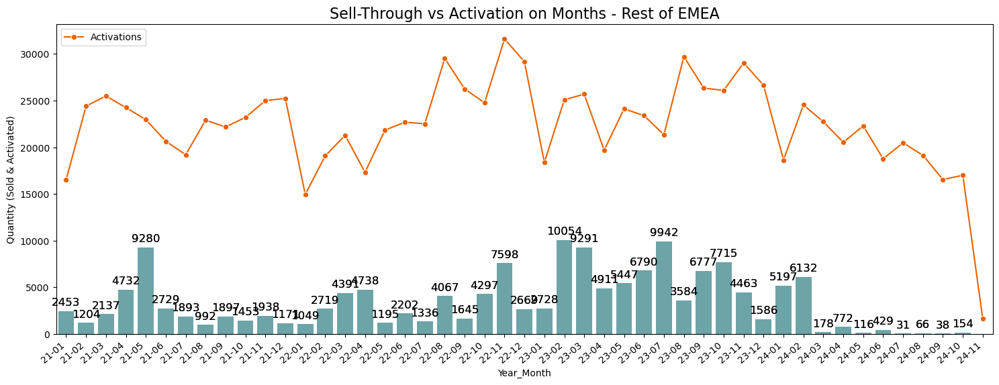

In [533]:
dfAC = dfA.query("Country == @Countries").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_C.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAC.merge(df_ActPOS, on= 'Year_Month', how='left')
eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Rest of EMEA', 'Year_Month', orange)

<a id='EMEA R2R'></a>
# A. EMEA R2R & Other dropped quantities

In [534]:
ALLR2R = dffull.query("ProductType == 'Microinverter' & Quarter >= '23 Q4' & ReporterToReporter == 1")
ALLR2R = ALLR2R.groupby(["InstallerCountry","PartnerName", "InstallerName"], as_index=False)["QuantitySold"].sum().sort_values('QuantitySold', ascending = False)

STORR2R = dffull.query("ProductType == 'Storage' & Quarter >= '23 Q4' & ReporterToReporter == 1")
STORR2R = STORR2R.groupby(["InstallerCountry","PartnerName", "InstallerName"], as_index=False)["KWhr"].sum().sort_values('KWhr', ascending = False)
STORR2R['KWhr'] = STORR2R['KWhr'].astype('int') 

#### R2R - Amounts dropped Micro & Storage

In [535]:
eda.display_side_by_side([ALLR2R, STORR2R], ['All R2R Microinverter(pcs) dropped in current quarter:', 'All R2R Storage (KWhr) dropped in current quarter:'])

InstallerCountry,PartnerName,InstallerName,QuantitySold
BE,"AMARA SOLAR RENOVABLES, S.L",POWERDEAL SRL,8386
FR,GROUPE SOLUTION ENERGIE INTEGRATION,AXDIS,8092
NL,4BLUE,Solar clarity,6048
NL,4BLUE,PVO INTERNATIONAL B.V.,5706
NL,TECHNISCHE UNIE B.V.,3012599,3780
GB,SEGEN LIMITED,GSE INTEGRATION,3024
NL,TECHNISCHE UNIE B.V.,2984002,3024
CH,SUNTASTIC.SOLAR HANDELS GMBH,SOLEXIS SA,3024
FR,BAYWA R.E. SOLAR SYSTEMS SP. Z O.O.,BAYWA-RE Solar Systems France,2825
FR,SYSTOSOLAR,POWERDEAL SRL,2581


In [536]:
dffull.query("PartnerName== 'KRANNICH SOLAR GMBH & CO.KG' & InstallerName == 'ESTG' & ProductType == 'Microinverter' & Quarter >= '23 Q4' & ReporterToReporter == 1").to_excel("AdHoc/KRA_R2R.xlsx",encoding='utf-8-sig',index=False)

#### Missing InstallerCountries:

In [537]:
INCORTA.query("InstallerCountry != InstallerCountry").groupby(["PartnerCountry","PartnerName", "InstallerName"], as_index=False)["QuantitySold"].sum().sort_values('QuantitySold', ascending = False).head(20)

,PartnerCountry,PartnerName,InstallerName,QuantitySold
101,CH,SOLARMARKT,PVT-Schweiz GmbH,1679
185,NL,LIBRA ENERGY BV,DueGS S.r.l.,756
95,CH,SOLARMARKT,Monnay électricité SA,351
135,CH,SOLARMARKT,Swiss-Green Engineering Sàrl,334
4,CH,SOLARMARKT,APAK energy GmbH,257
81,CH,SOLARMARKT,Home Intelligence,241
175,CH,SOLARMARKT,solduwal GmbH,227
28,CH,SOLARMARKT,EFISOL SA,190
130,CH,SOLARMARKT,Solstis SA,157
116,CH,SOLARMARKT,SSR Sanitär-Spenglerei AG,146


## Old Data Exports

In [538]:
#################################################################################
##############################    Old Data Exports:      ########################
#################################################################################

# INCORTA.query("InstallerCountry != InstallerCountry & PartnerCountry == 'CH'").to_excel("EMEA/EMEA_MissingInstallerCountries.xlsx",encoding='utf-8-sig',index=False)
# dfAInstaller.to_excel("EMEA/EMEA_All_Activation on Quarter.xlsx",encoding='utf-8-sig',index=False)
# df_TAM.to_excel("EMEA/EMEA_SOM_All_Installers&Owners.xlsx",encoding='utf-8-sig',index=False)
# dfA.query("Region == 'Not Available'").to_excel("RankingsEMEA/Global/GLOBAL_All_EnlightenRegions_NaN_RAW.xlsx",encoding='utf-8-sig',index=False)
# dfA.groupby(["Region", "Country"], as_index=False)["Activations"].sum().to_excel("RankingsEMEA/Global/GLOBAL_All_EnlightenRegions_Countries_Overview.xlsx",encoding='utf-8-sig',index=False)
# ALL_IC.to_excel("EMEA/EMEA_All_ICs.xlsx", encoding='utf-8-sig',index=False)
# dfq.groupby(["InstallerAccountOwner"], as_index=False)["QuantitySold"].sum().to_excel("EMEA/EMEA_InstallerAccountOwner_ActiveQ3.xlsx",encoding='utf-8-sig',index=False)
# NoOwner.to_excel("EMEA/EMEA_Installer_NoOwner.xlsx",encoding='utf-8-sig',index=False)

<a id='EMEA Key Accounts'></a>
# B. EMEA Key Accounts

### 1K5°

Rolling last 13 weeks intro we activated  444.0 micros more than we sold to installers.
Some possible explanations:
- We could still be missing the reports to those transactions.
- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).
- We could also have to many transactions flagged as R2R


,WorkWeek,Activations,QuantitySold,Gap,Gap%
138,24-35,1533,"2,606","-1,073",-70
139,24-36,1213,521,692,57
140,24-37,1486,"1,199",287,19
141,24-38,1602,165,"1,437",90
142,24-39,1654,902,752,45
143,24-40,898,753,145,16
144,24-41,1416,"3,784","-2,368",-167
145,24-42,1193,"3,529","-2,336",-196
146,24-43,1889,121,"1,768",94
147,24-44,1270,"4,076","-2,806",-221


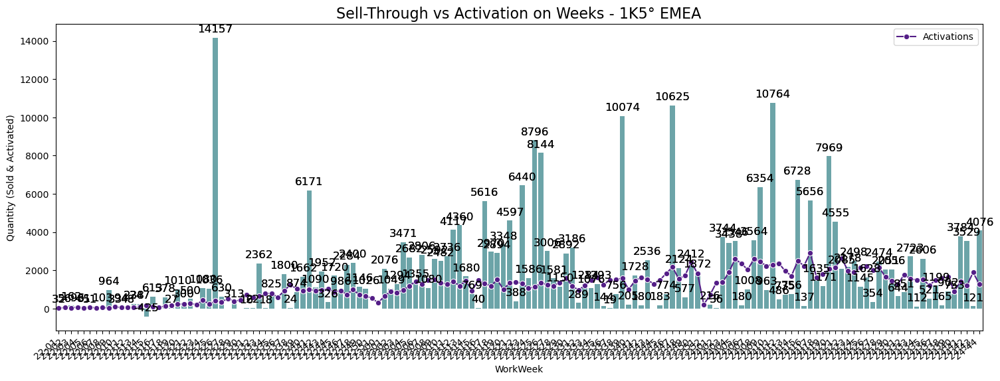

In [539]:
Eins = K5.InstallerName.tolist()
##### 1K5 Act vs ST
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerName == @Eins")

#dfAC = dfA.query("Country == @Country & InvoiceDate > 2023 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
dfAC = dfA.query("WorkWeek > '22-00' & WorkWeek < @CurrWW & InstallerName == @Eins").groupby(["WorkWeek"], as_index=False)["Activations"].sum()

df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left')

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Rolling last 13 weeks intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-13:-1].Gap.sum()))
print('Some possible explanations:')
print('- We could still be missing the reports to those transactions.')
print('- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).')
print('- We could also have to many transactions flagged as R2R')

eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Weeks - 1K5° EMEA', 'WorkWeek', '#541E87')

### 1K5° Activation vs. Sell-Through on months:

,Year_Month,Activations,QuantitySold
36,24-02,10075,"12,384"
37,24-03,9355,"12,948"
38,24-04,10262,"14,840"
39,24-05,9336,"15,852"
40,24-06,8229,"7,449"
41,24-07,7877,"7,579"
42,24-08,7023,"6,292"
43,24-09,6117,"3,423"
44,24-10,6366,"11,627"
45,24-11,500,NaN


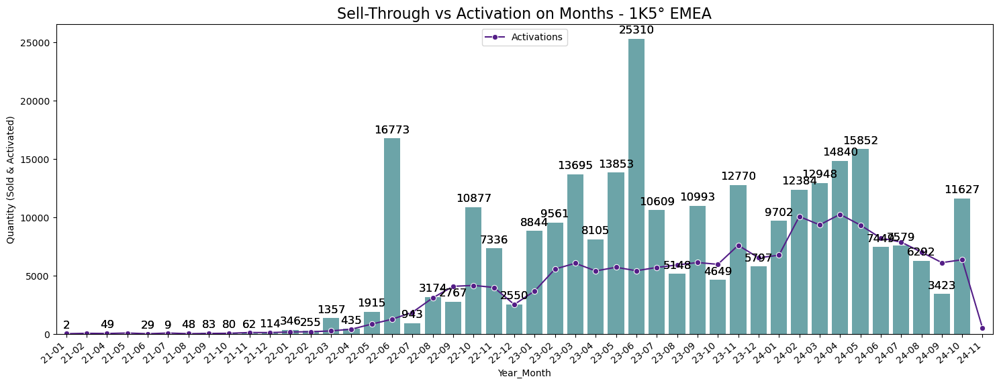

In [540]:
df_1k5 = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerName == @Eins")

dfAk5 = dfA.query("InstallerName == @Eins").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_1k5.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAk5.merge(df_ActPOS, on= 'Year_Month', how='left')

eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - 1K5° EMEA', 'Year_Month', '#541E87')

#### 1K5 Installer ranking current quarter

In [541]:
dfICIN.loc[dfICIN['InstallerName'].str.contains("k5", case=False, na=False)].sort_values("Q324_KWhr", ascending = False)

,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
2225,DE,Jan Strecker,1K5° Göttingen,3967806,4,"1,512","7,182","2,556","3,312",0,0,0,0,"1,068","2,366",756,420,0,"2,002","1,701",0,"2,719","2,505","2,811","2,309","2,553","2,918","2,147",703,0,4,0,0,0.0%,225,225,225,225,225,225
10671,NL,Pascal Broers,1K5° Deventer,0,NaN,"13,176","12,636","5,184","3,924","4,320","6,660",0,"2,808",0,0,0,21,192,"1,340","1,650",0,"3,625","3,883","1,511","1,960","2,706","3,373","1,412",496,"13,788",12,42,0,0.0%,"3,500","4,000","4,500","4,500","4,500","4,500"
2226,DE,Jan Strecker,1K5° Hamburg,3967811,11,"1,656","4,020","1,053",180,"3,384","3,559",472,"2,806",182,777,532,21,714,"1,351",973,368,901,"1,285","1,924","1,932","3,123","3,365","2,004",831,"10,221",3,124,0,104.89%,450,450,450,450,450,450
2240,DE,Martin Binzer,1K5° Rosenheim,1723263,2,0,0,900,0,432,"1,277","1,910",882,0,210,0,248,620,763,840,368,161,252,595,784,"1,743","2,037","1,695",564,"4,501",6,27,0,146.92%,"1,300",0,0,0,0,0
2217,DE,Kai Gehrke,1K5° Berlin,0,NaN,972,"1,664",648,"1,458",93,547,914,0,273,392,182,378,18,598,672,0,501,671,919,584,588,786,837,199,"1,554",2,28,0,182.8%,500,800,"1,000","1,000","1,000","1,000"
2218,DE,Jan Strecker,1K5° Bremen,3967258,4,0,414,288,720,468,"1,512","1,602",306,70,164,28,122,304,539,368,0,186,534,693,684,"1,292",929,890,205,"3,888",3,47,0,712.0%,225,0,0,0,0,0
2243,DE,Manfred Schmidt,1K5° Weimar,3948910,8,360,756,"1,326",0,"1,008","1,844",954,0,228,262,508,105,630,938,332,116,645,740,"1,076",968,"1,072","1,050",847,338,"3,806",2,77,0,106.0%,900,"1,140","1,350","1,650","1,650","1,800"
2241,DE,Kai Gehrke,1K5° Rostock,4038082,5,0,0,0,0,288,521,"1,048",108,0,0,0,0,178,452,326,70,0,0,0,218,"1,077","1,125",769,278,"1,965",NaN,0,0,inf%,0,0,0,0,0,0
2234,DE,Vahid Parma,1K5° Mittelhessen,0,NaN,846,313,160,558,900,"1,080",540,0,94,94,119,49,322,238,231,0,74,150,368,231,392,422,200,48,"2,520",4,23,0,108.0%,500,500,500,500,500,500
2216,DE,Martin Binzer,1K5° Augsburg,4429999,3,0,0,0,0,30,686,847,224,0,0,0,0,24,312,196,144,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"1,787",3,22,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN


###  1K5 Customer Heatmap

In [542]:
EXTALL.loc[EXTALL['InstallerName'].str.contains("k5°", case=False, na=False)].sort_values("PV_TAM", ascending = False).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100) #.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/EMEA/ST_ActivationTracking.xlsx",encoding='utf-8-sig',index=False)#.query("InstallerCountry in ['DE','AT','CH'] & InstallerName == '1K5° Münster'")#.groupby(["InstallerCountry","InstallerName"], as_index=False)["QuantitySold"].sum()

,InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
86,NL,1K5° Deventer,Pascal Broers,0,12,28571,74,67164,34929,18411,24-41,2808,225,3024,0,0,0,1353,1686,706,248,25,3500,3500,0,0
128,AU,1K5° Sydney,0,0,10,23810,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
209,DE,1K5° Rosenheim,Martin Binzer,1723263,6,14286,45,8158,1079,5567,24-42,216,2,432,1277,1910,882,872,1018,848,282,17,1307,1307,0,0
241,DE,1K5° Stuttgart,Anish Shah,3957592,5,11905,18,2133,248,1885,24-42,252,63,684,378,378,252,0,0,0,0,0,161,161,0,0
254,DE,1K5° Lingen,Jan Strecker,3967814,5,11905,27,8133,3236,2805,24-25,288,0,2268,288,0,0,239,136,53,46,-43,245,245,0,0
273,DE,1K5° Münster,Vahid Parma,3952755,5,11905,106,23918,11393,10899,24-42,486,225,5292,2557,0,486,1862,1492,1174,354,-20,0,0,0,0
402,DE,1K5° Göttingen,Jan Strecker,3967806,4,9524,24,19557,15620,1946,23-51,756,0,0,0,0,0,1276,1459,1074,352,14,245,245,0,0
464,DE,1K5° Mittelhessen,Vahid Parma,0,4,9524,34,5531,2118,2835,24-33,360,-100,900,1080,540,0,196,211,100,24,8,500,500,0,0
648,DE,1K5° Lüneburg,Jan Strecker,3967815,3,7143,19,4278,2514,1167,24-28,90,0,324,612,90,0,145,206,134,28,42,245,245,0,0
644,DE,1K5° Remscheid,Vahid Parma,3952760,3,7143,93,11094,3515,5758,24-41,396,225,1926,3024,0,396,536,386,465,174,-28,0,0,0,0


### Soly Europe

In [543]:
Soly = list(dfICIN.loc[dfICIN['InstallerName'].str.contains("soly", case=False, na=False)].sort_values("Q324_ST", ascending = False).InstallerName)

Rolling last 13 weeks intro we activated  -1692.0 micros more than we sold to installers.
Some possible explanations:
- We could still be missing the reports to those transactions.
- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).
- We could also have to many transactions flagged as R2R


,WorkWeek,Activations,QuantitySold,Gap,Gap%
94,24-35,213,687,-474,-223
95,24-36,181,64,117,65
96,24-37,147,606,-459,-312
97,24-38,260,448,-188,-72
98,24-39,242,707,-465,-192
99,24-40,293,125,168,57
100,24-41,329,349,-20,-6
101,24-42,163,405,-242,-148
102,24-43,174,284,-110,-63
103,24-44,230,237,-7,-3


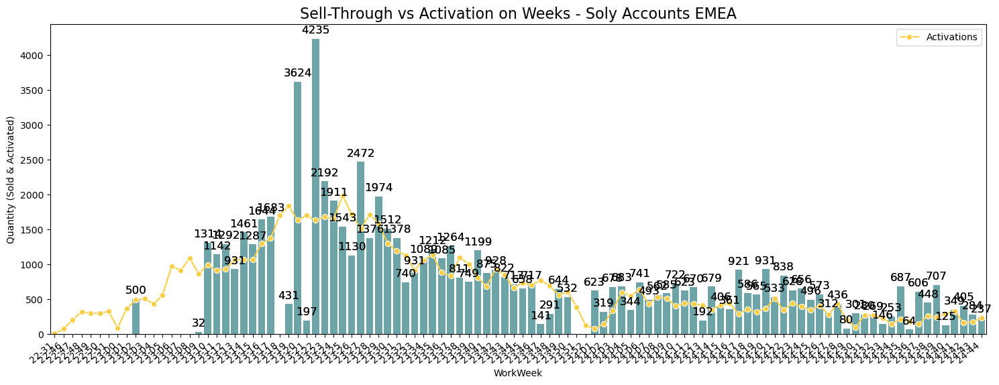

In [544]:
Soly = list(dfICIN.loc[dfICIN['InstallerName'].str.contains("soly", case=False, na=False)].sort_values("Q324_ST", ascending = False).InstallerName) ##### 1K5 Act vs ST
df_C = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerName == @Soly")

#dfAC = dfA.query("Country == @Country & InvoiceDate > 2023 & WorkWeek < @CurrWW").groupby(["WorkWeek"], as_index=False)["Activations"].sum()
dfAC = dfA.query("WorkWeek > '22-00' & WorkWeek < @CurrWW & InstallerName == @Soly").groupby(["WorkWeek"], as_index=False)["Activations"].sum()

df_ST = df_C.groupby(["WorkWeek"], as_index=False)["QuantitySold"].sum()

df_lag = dfAC.merge(df_ST, on= 'WorkWeek', how='left')

df_lag['Gap'] = df_lag['Activations'] - df_lag['QuantitySold']
df_lag['Gap%'] = df_lag['Gap']/df_lag['Activations'] * 100

print('Rolling last 13 weeks intro we activated  {0} micros more than we sold to installers.'.format(df_lag.iloc[-13:-1].Gap.sum()))
print('Some possible explanations:')
print('- We could still be missing the reports to those transactions.')
print('- They might not be loaded to incorta or we are reducing W.o.H. (Inventories).')
print('- We could also have to many transactions flagged as R2R')

eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Weeks - Soly Accounts EMEA', 'WorkWeek', '#F7CE46')

,Year_Month,Activations,QuantitySold
16,24-02,2201,"2,558"
17,24-03,1870,"2,243"
18,24-04,1702,"2,413"
19,24-05,1675,"3,407"
20,24-06,1615,"2,353"
21,24-07,1172,"1,258"
22,24-08,979,"1,506"
23,24-09,946,"1,825"
24,24-10,985,"1,400"
25,24-11,115,NaN


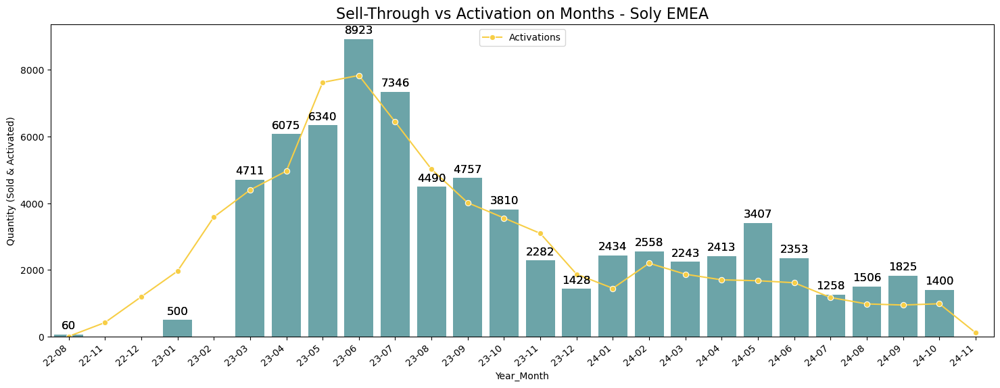

In [545]:
df_soly = dffull.query("ProductType == 'Microinverter' & ReporterToReporter == 0 & InstallerName == @Soly")

dfAk5 = dfA.query("InstallerName == @Soly").groupby(["Year_Month"], as_index=False)["Activations"].sum()
df_ActPOS = df_soly.groupby(["Year_Month"], as_index=False)["QuantitySold"].sum()
df_lag = dfAk5.merge(df_ActPOS, on= 'Year_Month', how='left')

eda.Act_POS_Graphs(df_lag, 'Sell-Through vs Activation on Months - Soly EMEA', 'Year_Month', '#F7CE46')

In [546]:
dfICIN.loc[dfICIN['InstallerName'].str.contains("soly", case=False, na=False)].sort_values("Q324_ST", ascending = False)

,InstallerCountry,InstallerAccountOwner,InstallerName,InstallerCustomerKey,Count_ReportedNames,Q123_ST,Q223_ST,Q323_ST,Q423_ST,Q124_ST,Q224_ST,Q324_ST,Q424_ST,Q123_KWhr,Q223_KWhr,Q323_KWhr,Q423_KWhr,Q124_KWhr,Q224_KWhr,Q324_KWhr,Q424_KWhr,23Q1_Activations,23Q2_Activations,23Q3_Activations,23Q4_Activations,24Q1_Activations,24Q2_Activations,24Q3_Activations,24Q4_Activations,ST_24,PV_TAM,Enph_SoW%,SPA,Micro_Achievement_CQ,MFCST,MFCST_Q1_25,MFCST_Q2_25,MFCST_Q3_25,MFCST_Q4_25,MFCST_Q1_26
9841,IT,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,117,"1,766","1,724",391,0,0,0,0,40,480,580,90,0,0,0,0,122,829,791,428,"3,998",NaN,0,0,inf%,0,0,0,0,0,0
9842,IT,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,117,"1,766","1,724",391,0,0,0,0,40,480,580,90,0,0,0,0,122,829,791,428,"3,998",NaN,0,0,inf%,0,0,0,0,0,0
15690,NL,Kay Crombag,Soly,114380,2,0,0,0,0,414,"1,582","1,089",270,0,0,0,0,28,133,35,21,"10,074","18,853","10,380","4,331","2,075","1,635","1,020",331,"3,355",0,inf,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9431,GB,Scott McDaniel,SOLY UK OPERATIONS LIMITED - Delete,4134207,3,0,0,0,24,"1,185","1,132","1,073",364,0,0,0,5,490,475,455,210,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"3,754",NaN,0,0,inf%,0,0,0,0,0,0
3569,DE,Vahid Parma,Soly Germany,3298724,5,161,"2,958","4,322","3,865","3,011","2,995",579,172,0,956,"1,110","1,232",994,826,220,119,0,"1,224","4,625","4,103","3,120","2,447","1,122",370,"6,757",8,31,0,57.9%,"1,000","1,500","2,500","3,000","3,500","3,500"
283,AT,Gerhard Pernusch,Soly Austria,4698871,2,0,0,0,0,0,0,109,77,0,0,0,0,0,0,46,21,0,0,0,0,0,0,41,85,186,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
17802,ZA,Ralph Berold,Soly South Africa,4212290,1,0,0,0,0,0,193,15,0,0,0,0,0,0,20,10,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,208,1,8,0,inf%,0,0,0,0,0,0
9821,IT,NaN,SOLY ITALY OPERATIONS S.R.L.,0,NaN,0,0,0,0,64,0,0,0,0,0,0,0,5,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64,NaN,0,0,nan%,NaN,NaN,NaN,NaN,NaN,NaN
9872,LO,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,122,829,791,428,100,NaN,0,0,nan%,0,0,0,0,0,0
9873,LO,Elena Tagliani,Soly Italy,4259582,2,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,122,829,791,428,100,NaN,0,0,nan%,0,0,0,0,0,0


In [547]:
EXTALL.loc[EXTALL['InstallerName'].str.contains("soly", case=False, na=False)].sort_values("PV_TAM", ascending = False).style.background_gradient(cmap="RdYlGn", subset = ['Enph_SoW%','Wkly_Trend%','Activation_Trend%'], vmin=-100, vmax=100) #.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/EMEA/ST_ActivationTracking.xlsx",encoding='utf-8-sig',index=False)#.query("InstallerCountry in ['DE','AT','CH'] & InstallerName == '1K5° Münster'")#.groupby(["InstallerCountry","InstallerName"], as_index=False)["QuantitySold"].sum()

,InstallerCountry,InstallerName,InstallerAccountOwner,InstallerKey,PV_TAM,PV_TAM_Units,Enph_SoW%,ST_Total,ST_23,ST_24,LastOrderWk,LastOrderQty,Wkly_Trend%,Q124_ST,Q224_ST,Q324_ST,Q424_ST,24Q1_Acti,24Q2_Acti,24Q3_Acti,24Q4_Acti,Activation_Trend%,BOQ,EOQ,Delta,SPA
157,DE,Soly Germany,Vahid Parma,3298724,8,19048,54,24321,15457,8864,24-43,82,-6,3011,2995,579,172,1560,1224,561,185,-22,1000,1000,0,0
182,GB,Soly United Kingdom,0,0,7,16667,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1441,ES,SOLY SOLAR (ESR ENERGY SOLUTIONS),Carlos Sellas,1753670,1,2381,7,1413,0,143,24-26,100,0,107,143,0,0,0,0,0,0,0,112,112,0,0
1908,ZA,Soly South Africa,Ralph Berold,4212290,1,2381,10,214,0,214,24-28,15,0,0,193,15,0,0,0,0,0,0,0,0,0,0
3589,NL,Soly,Kay Crombag,114380,0,0,999,3483,0,3483,24-44,72,-11,414,1582,1089,270,1038,818,510,166,-21,0,0,0,0
3747,BE,Soly België,Luc Dereu,3473192,0,238,213,1597,1158,439,24-24,36,0,288,126,0,0,101,40,4,0,-60,0,0,0,0


In [548]:
#df_TAM.loc[df_TAM['InstallerName'].str.contains("soly", case=False, na=False)].sort_values("PV_TAM", ascending = False)

# Ad Hoc

In [549]:
#ZIP.query("Country == 'DE'")

In [550]:
#df.loc[df['InstallerName'].str.contains("EDF ENR", case=False, na=False)].groupby(["InstallerName"], as_index=False)["QuantitySold"].sum()#.head(50)

In [551]:
# dfADE = dfA.query("InstallerCountry == 'DE'")
# dfADE = dfADE.loc[dfADE['SKUName'].str.contains("ACM", case=False, na=False)].groupby(["InstallerCountry","InstallerName", "InstallerSupportEmail","InstallerSupportPhone","InstallerZip"], as_index=False)["Activations"].sum()#.head(50)

# dfADE['Concat'] = dfADE["InstallerCountry"] + dfADE["InstallerZip"].astype(str)
# #dfADE.merge(ZIP[['Concat','InstallerAccountOwner']], on='Concat', how='left')#.to_excel("CH_ACM_InstallerActivation.xlsx",encoding='utf-8-sig',index=False)

In [552]:
# #substring search:
# RAWINC.loc[RAWINC['CHMReportedInstallerCustomerName'].str.contains("Ess k", case=False, na=False)]#.query("InstallerCountry in ['DE','AT','CH'] & InstallerName == '1K5° Münster'")#.groupby(["InstallerCountry","InstallerName"], as_index=False)["QuantitySold"].sum()

In [553]:
# #substring search:
# dfA.loc[dfA['InstallerCity'].str.contains("Stuttg", case=False, na=False)].head(50)#.query("InstallerCountry in ['DE','AT','CH'] & InstallerName == '1K5° Münster'")#.groupby(["InstallerCountry","InstallerName"], as_index=False)["QuantitySold"].sum()

In [554]:
dfINAO = df.groupby(["InstallerName", "InstallerAccountOwner", "AccountManager"], as_index=False)["QuantitySold"].count()
dfINAO.drop_duplicates(['InstallerName'], keep='first',  inplace=True)
dfINAO.head(10)

,InstallerName,InstallerAccountOwner,AccountManager,QuantitySold
0,"""G & K KOMPUTER"" SPÓ?KA Z OGRANICZON? ODPOWIED...",No Owner CHM,0,1
1,"""SKWYNET"" ?UKASZ FLISIKOWSKI",No Owner CHM,0,1
2,'t Park NV,Luc Dereu,0,7
4,(NO USAR) GALP ENERGIA ESPAÑA SA,No Owner CHM,0,2
5,-,Clément Trasfi,0,1
6,0,No Owner CHM,0,2
8,075 Installatietechniek,No Owner CHM,0,1
10,1 2 froid et climatisation,Nicolas Levavasseur,0,8
12,1.2.3NouvellesEnergies,Maaty Bouanane,Corinne Delerue,10
13,100% Duurzaam,No Owner CHM,0,3


In [555]:
def EIN_Output(df, installer):
        if df.query("InstallerName == @installer").AccountManager.iloc[-1] == 0:
            Name = df.query("InstallerName == @installer").InstallerAccountOwner.iloc[-1]
        else:
            Name = df.query("InstallerName == @installer").AccountManager.iloc[-1]
        return Name

In [556]:
EIN_Output(dfINAO, '1.2.3NouvellesEnergies')

'Corinne Delerue'

In [557]:
EIN_Output(dfINAO, '100% Duurzaam')

'No Owner CHM'

#### Late - Comission Relevant ST

In [558]:
# Late = RAWINC.query("CHMInvoiceQuarterYear == '2024-Q2' & CHMLastUpdatedDate >= '7/8/24'").sort_values("CHMLastUpdatedDate", ascending = False)

# Late['KWhr'] = Late['CHMReportedPartNumber'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' 
#                                                    or x=='B03-T01-INT00-1' 
#                                                    or x=='890-00023'
#                                                    or x=='ENCHARGE-3T-1P-INT' 
#                                                    else 0) + df['ProductName'].apply(lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0) + df['ProductName'].apply(lambda x:5 if x=='IQBATTERY-5P-1P-INT' or x== 'B05-T02-INT00-1-2' else 0)

# Late['KWhr1'] = Late['CHMReportedQuantity'] * Late['KWhr']
# #Late.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Q2_Late_SellThrough_DE.xlsx",encoding='utf-8-sig',index=False)
# Late
# #pd.crosstab(Late.CHMReportedInstallerCustomerName, Late.CHMInvoiceWeekDate, values=Late.KWhr1, aggfunc='sum', margins=True, margins_name="Total").fillna(0)

In [559]:
#df_TAM.query("InstallerName == '1K5° Deventer'")

In [560]:
### ANDERCORE outlier check

dfICIN['GROWTH_Q1'] = (dfICIN['Q124_ST'] / dfICIN['Q423_ST']-1)*100
dfICIN['GROWTH_Q2'] = (dfICIN['Q224_ST'] / dfICIN['Q124_ST']-1)*100
dfICIN['GROWTH_Q3'] = (dfICIN['Q324_ST'] / dfICIN['Q224_ST']-1)*100
#dfICIN['ST_SUM'] = dfICIN['Q423_ST'] + dfICIN['Q124_ST'] + dfICIN['Q224_ST'] + dfICIN['Q424_ST']
dfICIN['ACT_SUM'] = dfICIN['24Q1_Activations'] + dfICIN['24Q2_Activations'] + dfICIN['24Q3_Activations'] + dfICIN['24Q4_Activations']
dfICIN['ACT_ST_RATIO'] = ((dfICIN['ACT_SUM'] / dfICIN['ST_24'] )*100 ).fillna(0)

Eins = K5.InstallerName.tolist()

ANDERICIN = dfICIN.query("ST_24 > 500")
ANDERICIN = ANDERICIN.query("GROWTH_Q1 > 50 or GROWTH_Q2 > 50 or GROWTH_Q3 > 50")
ANDERICIN = ANDERICIN.query("ACT_ST_RATIO < 50").sort_values("GROWTH_Q3", ascending = False)
ANDERICIN.to_excel("AdHoc/EMEA_Andercore_Pot.xlsx",encoding='utf-8-sig',index=False)

In [562]:
######Combiner BOX check
ACC = pd.read_csv("/Users/sroetten/Python/Data/Accessoires.csv", encoding='utf-8', decimal='.')
ACC.columns = ACC.columns.str.replace(' ', '')

In [563]:
# Customized CHM:

ACC.rename(columns={
 'CHMPartnerNameOracle': 'PartnerName',
 'CHMDistributorCustomerKey':'PartnerCustomerKey',
 'CHMGeography':'PartnerRegion',  
 'CHMPartnerCountry':'PartnerCountry',   
 'CHMReportedInstallerCustomerName': 'ReportedInstallerName',
 'CHMInstallerName':'InstallerName',    
 'CHMReportedInstallerCountry': 'ReportedInstallerCountry',
 'CHMEnphaseInstallerCountry':'InstallerCountry',    
 'CHMInstallerCustomerKey':'InstallerCustomerKey',
 'CHMInstallerAccountOwner': 'InstallerAccountOwner',
 'CHMInstallerPrimaryAccountManager':'AccountManager',
 'CHMReportedInstallerStreetAddress': 'ReportedInstallerStreet1',
 'CHMReportedInstallerCity': 'ReportedInstallerCity',
 'CHMReportedInstallerState': 'ReportedInstallerState',    
# 'CHMReportedZipCode',
 'CHMReportedInstallerZipCode':'ReportedInstallerPostalCode',
 'CHMLineId': 'TransactionNumber',
# 'CHMBatchId',
# 'CHMSourceDb',
# 'CHMLineStatus',
# 'CHMInternalLineStatus',
 'CHMReportedInvoiceDate': 'InvoiceDate',
 'CHMInvoiceWeekDate': 'InvoiceWeekDate',
#                     'CHMInvoiceQuarterYear',
# 'CHMInvoiceQuarterYear',
 'CHMReportedInvoiceNumber': 'PartnerInvoiceNumber',
# 'CHMReportedInvoiceLineNumber',
 'CHMProductType': 'ProductType',
 'CHMProductFamily': 'ProductFamily',
 'CHMReportedPartNumber': 'ReportedProductName',
 'CHMPartNumber':'ProductName',
 'CHMProductDescription': 'ProductDescription',
 'CHMReportedQuantity':'QuantitySold',
#  'ListPrice',
#  'CHMReportedUom',
#  'CHMUom',
  'CHMReportedSpaNumber':'SpaNumber',
#  'CHMSpaNumber',
#  'CHMCreatedBy',
#  'CHMCreationDate',
#  'CHMLastUpdatedBy',
#  'CHMLastUpdatedDate',
#  'CHMFileRecordId',
 'CHMR2rFlag': 'ReporterToReporter'
                      }, inplace=True)   

In [564]:
ACC = ACC[['TransactionNumber','InvoiceWeekDate','InvoiceDate','PartnerRegion','PartnerCountry','PartnerName',
   'PartnerCustomerKey','QuantitySold','ProductType','ProductFamily','ProductName','ReportedProductName',
   'ProductDescription','ReportedInstallerName','InstallerName','InstallerCustomerKey','InstallerAccountOwner',
   'ReportedInstallerState', 'InstallerCountry','ReportedInstallerCountry', 'ReportedInstallerPostalCode',
   'ReportedInstallerStreet1','ReportedInstallerCity','PartnerInvoiceNumber','ReporterToReporter','SpaNumber','AccountManager']]

In [565]:
#df = ACC.query("InstallerCountry == @Country & 'InvoiceDate' >= '3/15/24'").sort_values("InvoiceDate", ascending=False)
# France SystoSolar Transactions are corrected
ACC['QuantitySold'] = ACC['QuantitySold'].apply(lambda x: x/1000000 if x >99999 else x) # temporary transformation until France KDI Solar Transactions are corrected
ACC['ReporterToReporter'] = ACC['ReporterToReporter'].apply(lambda x: 1 if x == 'Y' else 0) # temporary transformation until France KDI Solar Transactions are corrected

ACC['QuantitySold'] = ACC.QuantitySold.astype('int')
ACC['InvoiceDate']= pd.to_datetime(ACC['InvoiceDate'])
ACC['InvoiceWeekDate']= pd.to_datetime(ACC['InvoiceWeekDate'])

# # # Calendarly features:
# ACC['Month'] = pd.to_datetime(ACC.InvoiceDate).dt.strftime('%m')
# ACC['WorkWeek'] = pd.to_datetime(ACC.InvoiceDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
# ACC['Year'] = pd.to_datetime(ACC.InvoiceDate, dayfirst=False).dt.to_period('y').dt.strftime('%y')
# ACC['Year_Month'] = ACC['Year'] + '-' + ACC['Month']

# ACC.shape

In [566]:
ACC['QuantitySold'] = ACC['QuantitySold'].apply(lambda x: x/100 if x >999999 else x)# temporary transformation until France KDI Solar Transactions are corrected

In [567]:
#df = df.query("InvoiceWeekDate > '2024-03-13' & InvoiceWeekDate <= @Today")
ACC = ACC.query("InvoiceDate <= @Today")
#ACC.to_excel("EMEA/EMEA_ACC.xlsx",encoding='utf-8-sig',index=False)

In [568]:
#K5

In [569]:
ACC['Month'] = pd.to_datetime(ACC.InvoiceDate).dt.strftime('%m')

# #Calendarly features:
ACC['Month'] = pd.to_datetime(ACC.InvoiceDate).dt.strftime('%m')
ACC['WorkWeek'] = pd.to_datetime(ACC.InvoiceDate, dayfirst=False).dt.to_period('W').dt.strftime('%y-%W')
ACC['Year'] = pd.to_datetime(ACC.InvoiceDate, dayfirst=False).dt.to_period('y').dt.strftime('%y')
ACC['Year_Month'] = ACC['Year'] + '-' + ACC['Month']

#Enphase Quarters
ACC['InvoiceDate']= pd.to_datetime(ACC['InvoiceDate'])
ACC = ACC.merge(dfq[['Day','InvoiceDate','Week','Quarter']], on='InvoiceDate', how='left')

#Enphase formats
ACC['InstallerName'] = ACC['InstallerName'].astype('str')
ACC['ReportedInstallerName'] = ACC['ReportedInstallerName'].astype('str')


#FillNaN:
ACC['SpaNumber'] = ACC.SpaNumber.fillna(0)
ACC['AccountManager'] = ACC.AccountManager.fillna(0)


# Quantities in k Units:
ACC['QuantitySold_k'] = ACC['QuantitySold']/1000

# Storage Calulations
ACC['KWhr'] = ACC['ProductName'].apply(lambda x: 3.5 if x=='B03-T01-INT00-1-2' 
                                                   or x=='B03-T01-INT00-1' 
                                                   or x=='890-00023'
                                                   or x=='ENCHARGE-3T-1P-INT' 
                                                   else 0) + ACC['ProductName'].apply(lambda x:10.5 if x=='ENCHARGE-10T-1P-INT' else 0) + ACC['ProductName'].apply(lambda x:5 if x=='IQBATTERY-5P-1P-INT' or x== 'B05-T02-INT00-1-2' else 0)
ACC['KWhr'] = ACC['KWhr'] * ACC['QuantitySold']
ACC['MWhr'] = ACC['KWhr'] / 1000

In [570]:
ACC.InstallerName.replace(list(K5.ReportedInstallerName),list(K5.InstallerName), inplace=True)

In [571]:
Combiner = ACC.query("ReportedProductName == 'X-IQ-EURO-230-3P-4-1'")
Combiner = pd.crosstab(Combiner.InstallerName, Combiner.Quarter, values=Combiner.QuantitySold, aggfunc='sum', margins=True, margins_name="Total").sort_values("Total", ascending = False)#.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Combiner_Installers.xlsx",encoding='utf-8-sig',index=False)

In [572]:
dfSt.query("InstallerCountry == 'DE' & Activations == 7").to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Combiner_Installers.xlsx",encoding='utf-8-sig',index=False)

In [573]:
dfAInstCount = dfA.query("Quarter >= '23 Q4'")

#dfAInstCount = pd.crosstab(dfAInstCount.InstallerCustomerKey, dfAInstCount.Quarter, values=dfAInstCount.Activations, aggfunc='sum').reset_index().fillna(0)
dfAInstCount = pd.crosstab(dfAInstCount.InstallerName, dfAInstCount.Quarter, values=dfAInstCount.SiteID, aggfunc='count', margins=True, margins_name="Total").fillna('0').sort_values("Total", ascending=False)
dfAInstCount.columns = dfAInstCount.columns.str.replace(' ', '')

#all floats to int:
cols = dfAInstCount.select_dtypes(include=['float64','object'])
for col in cols:
    dfAInstCount[col] = dfAInstCount[col].apply(lambda x: int(x) if x == x else "")

AcM.rename(columns={'SFDC:AccountName' : 'InstallerName'}, inplace=True)

dfAInstCount = dfAInstCount.merge(AcM[['InstallerName','InstallerCustomerKey','SiteCount','SoW']], on='InstallerName' , how='left')
dfAInstCount = dfAInstCount[['InstallerName','InstallerCustomerKey','23Q4','24Q1','24Q2','24Q3','SoW']]

In [574]:
#dfAInstCount

In [575]:
Combiner = ACC.query("ReportedProductName == 'X-IQ-EURO-230-3P-4-1'")
Combiner = pd.crosstab(Combiner.InstallerName, Combiner.Quarter, values=Combiner.QuantitySold, aggfunc='sum', margins=True, margins_name="Total").sort_values("Total", ascending = False)#.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Combiner_Installers.xlsx",encoding='utf-8-sig',index=False)

In [576]:
Combiner.merge(dfAInstCount, on='InstallerName', how = 'left').to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Combiner_Installers+ActivationSiteCount.xlsx",encoding='utf-8-sig',index=False)

In [577]:
#  Lead Conversion:
leads = pd.read_excel("/Users/sroetten/Python/Data/LeadConversion.xlsx")
leads.columns = leads.columns.str.replace(' ', '')
leads.rename(columns={'ConvertedOpportunity:OpportunityOwner:FullName': 'OpportunityOwner',
                      'ConvertedAccount:AccountName': 'InstallerName',
                      'ConvertedOpportunity:OpportunityName': 'OpportunityName',
                      'ConvertedOpportunity:Stage': 'OpportunityStage'
                     }, inplace=True)


lead_converted = leads[['OpportunityOwner','InstallerName','CreatedDate','OpportunityStage']].merge(dfICIN, on='InstallerName', how = 'left').query("ST_24 > 0").sort_values('ST_24', ascending = False)
lead_converted['CreatedDate'] = pd.to_datetime(lead_converted['CreatedDate'])

converted = list(lead_converted.InstallerName)

firstorder = eda.FirstOrderWk(df, converted)

lead_converted = lead_converted.merge(firstorder, on='InstallerName', how = 'left')
lead_converted['Days_Diff'] = lead_converted['InvoiceDate'] - lead_converted['CreatedDate']

lead_converted.rename(columns={'InvoiceDate': 'FirstOrderDate',
                               'QuantitySold': 'FirstOrderQty',
                              }, inplace=True)

lead_converted.to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/LeadConversion.xlsx",encoding='utf-8-sig',index=False)

In [578]:
#Spain Selection:
SpainSelect = pd.read_excel("/Users/sroetten/Python/Data/SpainSelection.xlsx")

SpainSelect.columns = SpainSelect.columns.str.replace(' ', '')
SpainSelect.rename(columns={'ELECTRICALSHOP(NONOFICIALDISTRIBUTOR)': 'InstallerName',
                            'customerkey':'InstallerCustomerKey'
                     }, inplace=True)
SpainSelect[['InstallerName']].merge(dfICIN, on='InstallerName', how = 'left').to_excel("/Users/sroetten/Python/RevenueTaskforceEMEA/AdHoc/Spain_AlmacenesElectricos.xlsx",encoding='utf-8-sig',index=False)